<a href="https://colab.research.google.com/github/AndreiAf02/STAT561_Project/blob/main/Bank_Marketing_Transductive_TL.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

##STAT 561 Project Extension - Bank Marketing


In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

from time import perf_counter



from sklearn.preprocessing import StandardScaler, MinMaxScaler
from imblearn.over_sampling import SMOTE
from imblearn.combine import SMOTETomek
from imblearn.under_sampling import RandomUnderSampler
from imblearn.over_sampling import RandomOverSampler
from sklearn.model_selection import train_test_split
from sklearn.metrics import precision_recall_curve
from sklearn.metrics import roc_curve, roc_auc_score, confusion_matrix, ConfusionMatrixDisplay, classification_report
import matplotlib.pyplot as plt
# !pip install pytorch-tabnet

# from pytorch_tabnet.tab_model import TabNetClassifier
import tensorflow as tf
from tensorflow.keras import layers, models
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay



## Data taken from the UCI Machine Learning repository [here](https://doi.org/10.24432/C5K306):

In [2]:
pip install ucimlrepo

In [48]:
from ucimlrepo import fetch_ucirepo

# fetch dataset
bank_marketing = fetch_ucirepo(id=222)

# data (as pandas dataframes)
X = bank_marketing.data.features
y = bank_marketing.data.targets

# metadata
print(bank_marketing.metadata)

# variable information
print(bank_marketing.variables)



{'uci_id': 222, 'name': 'Bank Marketing', 'repository_url': 'https://archive.ics.uci.edu/dataset/222/bank+marketing', 'data_url': 'https://archive.ics.uci.edu/static/public/222/data.csv', 'abstract': 'The data is related with direct marketing campaigns (phone calls) of a Portuguese banking institution. The classification goal is to predict if the client will subscribe a term deposit (variable y).', 'area': 'Business', 'tasks': ['Classification'], 'characteristics': ['Multivariate'], 'num_instances': 45211, 'num_features': 16, 'feature_types': ['Categorical', 'Integer'], 'demographics': ['Age', 'Occupation', 'Marital Status', 'Education Level'], 'target_col': ['y'], 'index_col': None, 'has_missing_values': 'yes', 'missing_values_symbol': 'NaN', 'year_of_dataset_creation': 2014, 'last_updated': 'Fri Aug 18 2023', 'dataset_doi': '10.24432/C5K306', 'creators': ['S. Moro', 'P. Rita', 'P. Cortez'], 'intro_paper': {'ID': 277, 'type': 'NATIVE', 'title': 'A data-driven approach to predict the s

In [49]:
X

,age,job,marital,education,default,balance,housing,loan,contact,day_of_week,month,duration,campaign,pdays,previous,poutcome
0,58,management,married,tertiary,no,2143,yes,no,NaN,5,may,261,1,-1,0,NaN
1,44,technician,single,secondary,no,29,yes,no,NaN,5,may,151,1,-1,0,NaN
2,33,entrepreneur,married,secondary,no,2,yes,yes,NaN,5,may,76,1,-1,0,NaN
3,47,blue-collar,married,NaN,no,1506,yes,no,NaN,5,may,92,1,-1,0,NaN
4,33,NaN,single,NaN,no,1,no,no,NaN,5,may,198,1,-1,0,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
45206,51,technician,married,tertiary,no,825,no,no,cellular,17,nov,977,3,-1,0,NaN
45207,71,retired,divorced,primary,no,1729,no,no,cellular,17,nov,456,2,-1,0,NaN
45208,72,retired,married,secondary,no,5715,no,no,cellular,17,nov,1127,5,184,3,success
45209,57,blue-collar,married,secondary,no,668,no,no,telephone,17,nov,508,4,-1,0,NaN


In [50]:
y

,y
0,no
1,no
2,no
3,no
4,no
...,...
45206,yes
45207,yes
45208,yes
45209,no


In [51]:
for i in range(len(X.columns)):
  print(X.columns[i])
  print(X.iloc[:, i].unique())
  print('------------------')

age
[58 44 33 47 35 28 42 43 41 29 53 57 51 45 60 56 32 25 40 39 52 46 36 49
 59 37 50 54 55 48 24 38 31 30 27 34 23 26 61 22 21 20 66 62 83 75 67 70
 65 68 64 69 72 71 19 76 85 63 90 82 73 74 78 80 94 79 77 86 95 81 18 89
 84 87 92 93 88]
------------------
job
['management' 'technician' 'entrepreneur' 'blue-collar' nan 'retired'
 'admin.' 'services' 'self-employed' 'unemployed' 'housemaid' 'student']
------------------
marital
['married' 'single' 'divorced']
------------------
education
['tertiary' 'secondary' nan 'primary']
------------------
default
['no' 'yes']
------------------
balance
[ 2143    29     2 ...  8205 14204 16353]
------------------
housing
['yes' 'no']
------------------
loan
['no' 'yes']
------------------
contact
[nan 'cellular' 'telephone']
------------------
day_of_week
[ 5  6  7  8  9 12 13 14 15 16 19 20 21 23 26 27 28 29 30  2  3  4 11 17
 18 24 25  1 10 22 31]
------------------
month
['may' 'jun' 'jul' 'aug' 'oct' 'nov' 'dec' 'jan' 'feb' 'mar' 'apr' 'sep']

In [52]:
y['y'].unique()

array(['no', 'yes'], dtype=object)

In [53]:
X_numeric = pd.DataFrame()

## Age:
X_numeric['age'] = X['age']

## Working class:
X_numeric['job'] = X['job']
X_numeric['job'].replace(['management', 'technician', 'entrepreneur', 'blue-collar', 'retired',
 'admin.', 'services', 'self-employed', 'unemployed', 'housemaid', 'student'],
                                [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10], inplace=True)


## Marital:
X_numeric['marital'] = X['marital']
X_numeric['marital'].replace(['single', 'married', 'divorced'],
                                    [0, 1, 2], inplace=True)

## Education:
X_numeric['education'] = X['education']
X_numeric['education'].replace(['primary', 'secondary', 'tertiary'],
                                    [0, 1, 2], inplace=True)


## Credit Default:
X_numeric['default'] = X['default']
X_numeric['default'].replace(['no', 'yes'],
                                    [0, 1], inplace=True)



## Balance:
X_numeric['balance'] = X['balance']


## Housing:
X_numeric['housing'] = X['housing']
X_numeric['housing'].replace(['no', 'yes'],
                                    [0, 1], inplace=True)


## Loan:
X_numeric['loan'] = X['loan']
X_numeric['loan'].replace(['no', 'yes'],
                                    [0, 1], inplace=True)



## Contact:
X_numeric['contact'] = X['contact']
X_numeric['contact'].replace([np.nan, 'cellular', 'telephone'],
                                    [0, 1, 2], inplace=True)


## Day of week:
X_numeric['day_of_week'] = X['day_of_week']


## Month:
X_numeric['month'] = X['month']
X_numeric['month'].replace(['jan', 'feb', 'mar', 'apr', 'may', 'jun', 'jul', 'aug', 'sep', 'oct', 'nov', 'dec'],
                                    [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11], inplace=True)


## Duration:
X_numeric['duration'] = X['duration']

## Campaign:
X_numeric['campaign'] = X['campaign']


## Pdays:
X_numeric['pdays'] = X['pdays']
# X_numeric['pdays'].replace([-1], [np.nan], inplace=True)

## Previous:
X_numeric['previous'] = X['previous']

## Poutcome:
X_numeric['poutcome'] = X['poutcome']
X_numeric['poutcome'].replace([np.nan, 'failure', 'success', 'other'],
                                    [0, 1, 2, 3], inplace=True)





## ---------------------- Response variable y: --------------------

## Income:
y_numeric = pd.DataFrame()
y_numeric['Y'] = y['y']
y_numeric['Y'].replace(['no', 'yes'],
                          [0, 1], inplace=True)

X_numeric





<ipython-input-53-ece2c1f564e2>:8: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  X_numeric['job'].replace(['management', 'technician', 'entrepreneur', 'blue-collar', 'retired',
<ipython-input-53-ece2c1f564e2>:8: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  X_numeric['job'].replace(['management', 't

,age,job,marital,education,default,balance,housing,loan,contact,day_of_week,month,duration,campaign,pdays,previous,poutcome
0,58,0.0,1,2.0,0,2143,1,0,0,5,4,261,1,-1,0,0
1,44,1.0,0,1.0,0,29,1,0,0,5,4,151,1,-1,0,0
2,33,2.0,1,1.0,0,2,1,1,0,5,4,76,1,-1,0,0
3,47,3.0,1,NaN,0,1506,1,0,0,5,4,92,1,-1,0,0
4,33,NaN,0,NaN,0,1,0,0,0,5,4,198,1,-1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
45206,51,1.0,1,2.0,0,825,0,0,1,17,10,977,3,-1,0,0
45207,71,4.0,2,0.0,0,1729,0,0,1,17,10,456,2,-1,0,0
45208,72,4.0,1,1.0,0,5715,0,0,1,17,10,1127,5,184,3,2
45209,57,3.0,1,1.0,0,668,0,0,2,17,10,508,4,-1,0,0


In [54]:
y_numeric['Y']

,Y
0,0
1,0
2,0
3,0
4,0
...,...
45206,1
45207,1
45208,1
45209,0


In [55]:
y_numeric['Y'].value_counts()

,count
Y,
0,39922
1,5289


In [56]:
data_total = pd.concat([X_numeric, y_numeric], axis=1)

data_total = data_total.dropna().reset_index(drop=True)


data_total

,age,job,marital,education,default,balance,housing,loan,contact,day_of_week,month,duration,campaign,pdays,previous,poutcome,Y
0,58,0.0,1,2.0,0,2143,1,0,0,5,4,261,1,-1,0,0,0
1,44,1.0,0,1.0,0,29,1,0,0,5,4,151,1,-1,0,0,0
2,33,2.0,1,1.0,0,2,1,1,0,5,4,76,1,-1,0,0,0
3,35,0.0,1,2.0,0,231,1,0,0,5,4,139,1,-1,0,0,0
4,28,0.0,0,2.0,0,447,1,1,0,5,4,217,1,-1,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
43188,51,1.0,1,2.0,0,825,0,0,1,17,10,977,3,-1,0,0,1
43189,71,4.0,2,0.0,0,1729,0,0,1,17,10,456,2,-1,0,0,1
43190,72,4.0,1,1.0,0,5715,0,0,1,17,10,1127,5,184,3,2,1
43191,57,3.0,1,1.0,0,668,0,0,2,17,10,508,4,-1,0,0,0


In [57]:
X = data_total.iloc[:, :-1]
y = data_total.iloc[:,-1]
y

,Y
0,0
1,0
2,0
3,0
4,0
...,...
43188,1
43189,1
43190,1
43191,0


In [58]:
## Scaling the predictive data

scaler = MinMaxScaler()
scaler.fit(X)
X_scaled = scaler.transform(X)
X_scaled = pd.DataFrame(X_scaled)

In [59]:
data2 = pd.concat([X_scaled, y], axis=1)
data2

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,Y
0,0.519481,0.0,0.5,1.0,0.0,0.092259,1.0,0.0,0.0,0.133333,0.363636,0.053070,0.000000,0.000000,0.000000,0.000000,0
1,0.337662,0.1,0.0,0.5,0.0,0.073067,1.0,0.0,0.0,0.133333,0.363636,0.030704,0.000000,0.000000,0.000000,0.000000,0
2,0.194805,0.2,0.5,0.5,0.0,0.072822,1.0,1.0,0.0,0.133333,0.363636,0.015453,0.000000,0.000000,0.000000,0.000000,0
3,0.220779,0.0,0.5,1.0,0.0,0.074901,1.0,0.0,0.0,0.133333,0.363636,0.028264,0.000000,0.000000,0.000000,0.000000,0
4,0.129870,0.0,0.0,1.0,0.0,0.076862,1.0,1.0,0.0,0.133333,0.363636,0.044124,0.000000,0.000000,0.000000,0.000000,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
43188,0.428571,0.1,0.5,1.0,0.0,0.080293,0.0,0.0,0.5,0.533333,0.909091,0.198658,0.035088,0.000000,0.000000,0.000000,1
43189,0.688312,0.4,1.0,0.0,0.0,0.088501,0.0,0.0,0.5,0.533333,0.909091,0.092721,0.017544,0.000000,0.000000,0.000000,1
43190,0.701299,0.4,0.5,0.5,0.0,0.124689,0.0,0.0,0.5,0.533333,0.909091,0.229158,0.070175,0.212156,0.010909,0.666667,1
43191,0.506494,0.3,0.5,0.5,0.0,0.078868,0.0,0.0,1.0,0.533333,0.909091,0.103294,0.052632,0.000000,0.000000,0.000000,0


In [60]:
y.value_counts()

,count
Y,
0,38172
1,5021


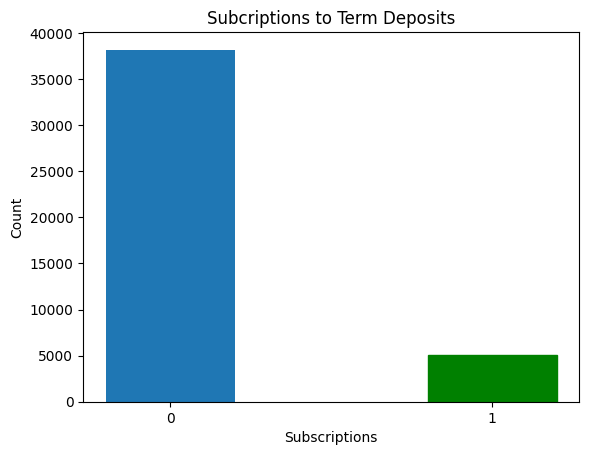

In [61]:
barlist = plt.bar([str(0),str(1)], y.value_counts(), width = 0.4)
barlist[1].set_color('g')

plt.xlabel("Subscriptions")
plt.ylabel("Count")
plt.title("Subcriptions to Term Deposits")
plt.show()

In [62]:
data_total

,age,job,marital,education,default,balance,housing,loan,contact,day_of_week,month,duration,campaign,pdays,previous,poutcome,Y
0,58,0.0,1,2.0,0,2143,1,0,0,5,4,261,1,-1,0,0,0
1,44,1.0,0,1.0,0,29,1,0,0,5,4,151,1,-1,0,0,0
2,33,2.0,1,1.0,0,2,1,1,0,5,4,76,1,-1,0,0,0
3,35,0.0,1,2.0,0,231,1,0,0,5,4,139,1,-1,0,0,0
4,28,0.0,0,2.0,0,447,1,1,0,5,4,217,1,-1,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
43188,51,1.0,1,2.0,0,825,0,0,1,17,10,977,3,-1,0,0,1
43189,71,4.0,2,0.0,0,1729,0,0,1,17,10,456,2,-1,0,0,1
43190,72,4.0,1,1.0,0,5715,0,0,1,17,10,1127,5,184,3,2,1
43191,57,3.0,1,1.0,0,668,0,0,2,17,10,508,4,-1,0,0,0


In [63]:
data_total.iloc[:, 3].value_counts()

,count
education,
1.0,23131
2.0,13262
0.0,6800


In [64]:
data2.iloc[:, 3].value_counts()

,count
3,
0.5,23131
1.0,13262
0.0,6800


# Splitting for Source and Target Domains:


# Full Dataset:

Grouping by 'International': domestic students are source data, international students are target data

In [67]:
data_S = data2[data2.iloc[:,3] > 0.4].reset_index(drop=True)  ## Source domain and classification - Secondary/Tertiary education
data_T = data2[data2.iloc[:,3] <= 0.4].reset_index(drop=True)  ## Target domain and classification - Primary education

In [68]:
data_S

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,Y
0,0.519481,0.0,0.5,1.0,0.0,0.092259,1.0,0.0,0.0,0.133333,0.363636,0.053070,0.000000,0.000000,0.000000,0.000000,0
1,0.337662,0.1,0.0,0.5,0.0,0.073067,1.0,0.0,0.0,0.133333,0.363636,0.030704,0.000000,0.000000,0.000000,0.000000,0
2,0.194805,0.2,0.5,0.5,0.0,0.072822,1.0,1.0,0.0,0.133333,0.363636,0.015453,0.000000,0.000000,0.000000,0.000000,0
3,0.220779,0.0,0.5,1.0,0.0,0.074901,1.0,0.0,0.0,0.133333,0.363636,0.028264,0.000000,0.000000,0.000000,0.000000,0
4,0.129870,0.0,0.0,1.0,0.0,0.076862,1.0,1.0,0.0,0.133333,0.363636,0.044124,0.000000,0.000000,0.000000,0.000000,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
36388,0.090909,0.1,0.0,0.5,0.0,0.077388,0.0,1.0,0.5,0.533333,0.909091,0.078487,0.017544,0.000000,0.000000,0.000000,1
36389,0.428571,0.1,0.5,1.0,0.0,0.080293,0.0,0.0,0.5,0.533333,0.909091,0.198658,0.035088,0.000000,0.000000,0.000000,1
36390,0.701299,0.4,0.5,0.5,0.0,0.124689,0.0,0.0,0.5,0.533333,0.909091,0.229158,0.070175,0.212156,0.010909,0.666667,1
36391,0.506494,0.3,0.5,0.5,0.0,0.078868,0.0,0.0,1.0,0.533333,0.909091,0.103294,0.052632,0.000000,0.000000,0.000000,0


In [69]:
data_T

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,Y
0,0.519481,0.4,0.5,0.0,0.0,0.073902,1.0,0.0,0.0,0.133333,0.363636,0.010167,0.000000,0.000000,0.000000,0.000000,0
1,0.428571,0.4,0.5,0.0,0.0,0.074882,1.0,0.0,0.0,0.133333,0.363636,0.071777,0.000000,0.000000,0.000000,0.000000,0
2,0.506494,0.3,0.5,0.0,0.0,0.073275,1.0,0.0,0.0,0.133333,0.363636,0.007727,0.000000,0.000000,0.000000,0.000000,0
3,0.545455,0.4,0.5,0.0,0.0,0.073348,1.0,0.0,0.0,0.133333,0.363636,0.044530,0.000000,0.000000,0.000000,0.000000,0
4,0.181818,0.3,0.0,0.0,0.0,0.073012,1.0,1.0,0.0,0.133333,0.363636,0.032534,0.000000,0.000000,0.000000,0.000000,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6795,0.558442,0.9,0.5,0.0,0.0,0.074456,0.0,0.0,0.5,0.266667,0.909091,0.068117,0.000000,0.106651,0.047273,0.333333,0
6796,0.584416,0.4,0.5,0.0,0.0,0.106740,0.0,0.0,1.0,0.266667,0.909091,0.061204,0.000000,0.524083,0.014545,0.333333,0
6797,0.012987,1.0,0.0,0.0,0.0,0.075028,0.0,0.0,1.0,0.300000,0.909091,0.019927,0.017544,0.127294,0.007273,1.000000,0
6798,0.675325,0.4,0.5,0.0,0.0,0.075745,0.0,0.0,0.5,0.466667,0.909091,0.015860,0.000000,0.111239,0.025455,0.666667,0


## Source domain and task labels:

In [70]:
X_S_full = data_S.iloc[:, :-1]
X_S_full       ## Source domain


y_S_full = data_S.iloc[:, -1]
y_S_full       ## Source classification (response)

,Y
0,0
1,0
2,0
3,0
4,0
...,...
36388,1
36389,1
36390,1
36391,0


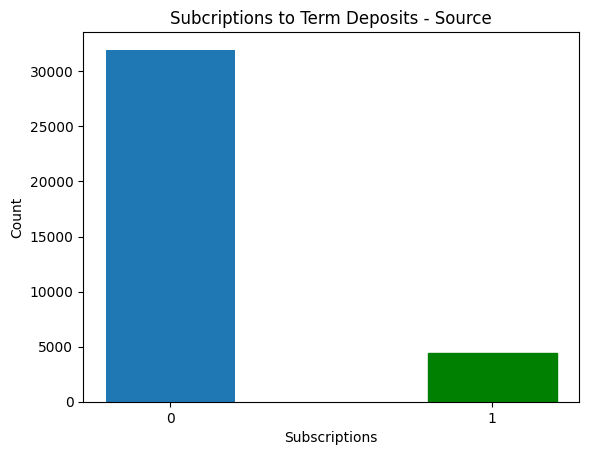

In [71]:
barlist_S = plt.bar([str(0),str(1)], y_S_full.value_counts(), width = 0.4)
barlist_S[1].set_color('g')

plt.xlabel("Subscriptions")
plt.ylabel("Count")
plt.title("Subcriptions to Term Deposits - Source")
plt.show()

## Target domain and task labels:

In [74]:
X_T_full = data_T.iloc[:, :-1]
X_T_full       ## Target domain


y_T_full = data_T.iloc[:, -1]
y_T_full       ## Target classification (response)

,Y
0,0
1,0
2,0
3,0
4,0
...,...
6795,0
6796,0
6797,0
6798,0


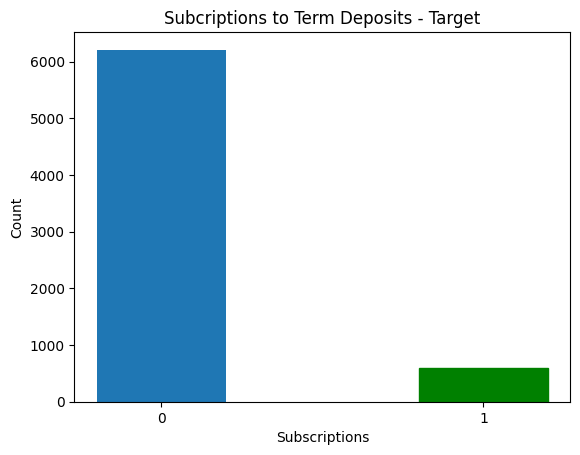

In [75]:
barlist_T = plt.bar([str(0),str(1)], y_T_full.value_counts(), width = 0.4)
barlist_T[1].set_color('g')

plt.xlabel("Subscriptions")
plt.ylabel("Count")
plt.title("Subcriptions to Term Deposits - Target")
plt.show()

## Updated Code (Modified from Shreya's code):

In [76]:
def create_dnn_model(input_shape):
  model = models.Sequential([layers.Dense(64, activation='relu', input_dim=input_shape),
        layers.Dense(32, activation='relu'),
        layers.Dense(1, activation='sigmoid')  # For binary classification (yes/no diabetes)
    ])

  model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['AUC'])

  return model



def train_and_evaluate(model, X_train, X_test, y_train, y_test, domain):

    time_start = perf_counter()

    # Training and validation
    model.fit(X_train, y_train, epochs=10, batch_size=32, validation_split=0.2)

    # Predict probabilities and calculate AUC
    y_pred_prob = model.predict(X_test).ravel()
    auc = roc_auc_score(y_test, y_pred_prob)
    print(f"AUC-ROC: {auc}")

    # Compute ROC curve
    fpr, tpr, _ = roc_curve(y_test, y_pred_prob)

    # Convert probabilities to binary predictions for confusion matrix
    y_pred_class = (y_pred_prob >= 0.5).astype(int)

    # Compute and print classification report
    class_report = classification_report(y_test, y_pred_class)
    print("Classification Report:")
    print(class_report)

    # Compute confusion matrix
    conf_matrix = confusion_matrix(y_test, y_pred_class)
    # conf_disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix)

    # Plot ROC curve and Confusion Matrix side by side
    # fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 5))

    # # ROC Curve
    # ax1.plot(fpr, tpr, color='blue', label=f'AUC-ROC = {auc:.2f}')
    # ax1.plot([0, 1], [0, 1], color='gray', linestyle='--')
    # ax1.set_xlabel('False Positive Rate')
    # ax1.set_ylabel('True Positive Rate')
    # ax1.set_title('Receiver Operating Characteristic (ROC) Curve')
    # ax1.legend(loc='lower right')
    # ax1.grid()

    # # Confusion Matrix
    # conf_disp.plot(ax=ax2, cmap='Blues')
    # ax2.set_title('Confusion Matrix')
    # plt.tight_layout()
    # plt.show()

    # Calculate precision and recall for different thresholds
    precision, recall, thresholds = precision_recall_curve(y_test, y_pred_prob)

    # Find the threshold where precision and recall are balanced
    f1_scores = 2 * (precision * recall) / (precision + recall)
    best_threshold = thresholds[f1_scores.argmax()]

    print(f"Best threshold based on F1-score: {best_threshold}")

    time_stop = perf_counter()

    time_elapsed = time_stop-time_start

    print('Time elapsed (performance):', time_elapsed)
    return time_elapsed


In [77]:
def Transductive_TL(model, X_test, y_test, domain):

    time_start = perf_counter()

    # Predict probabilities and calculate AUC
    y_pred_prob = model.predict(X_test).ravel()
    auc = roc_auc_score(y_test, y_pred_prob)
    print(f"AUC-ROC: {auc}")

    # Compute ROC curve
    fpr, tpr, _ = roc_curve(y_test, y_pred_prob)

    # Convert probabilities to binary predictions for confusion matrix
    y_pred_class = (y_pred_prob >= 0.5).astype(int)

    # Compute and print classification report
    class_report = classification_report(y_test, y_pred_class)
    print("Classification Report:")
    print(class_report)

    # Compute confusion matrix
    conf_matrix = confusion_matrix(y_test, y_pred_class)
    conf_disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix)

    # Plot ROC curve and Confusion Matrix side by side
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 5))

    # ROC Curve
    ax1.plot(fpr, tpr, color='blue', label=f'AUC-ROC = {auc:.2f}')
    ax1.plot([0, 1], [0, 1], color='gray', linestyle='--')
    ax1.set_xlabel('False Positive Rate')
    ax1.set_ylabel('True Positive Rate')
    ax1.set_title('Receiver Operating Characteristic (ROC) Curve')
    ax1.legend(loc='lower right')
    ax1.grid()

    # Confusion Matrix
    # print('Confusion matrix:', conf_matrix)
    fpr = conf_matrix[0][1]/(conf_matrix[0][0]+conf_matrix[0][1])
    tnr = 1-fpr

    fnr = conf_matrix[1][0]/(conf_matrix[1][0] + conf_matrix[1][1])
    tpr = 1 - fnr
    print('FPR', fpr, 'TPR:', tpr, 'FNR:', fnr, 'TNR:', tnr)
    conf_disp.plot(ax=ax2, cmap='Blues')
    ax2.set_title('Confusion Matrix')
    plt.tight_layout()
    plt.show()

    # Calculate precision and recall for different thresholds
    precision, recall, thresholds = precision_recall_curve(y_test, y_pred_prob)

    # Find the threshold where precision and recall are balanced
    f1_scores = 2 * (precision * recall) / (precision + recall)
    best_threshold = thresholds[f1_scores.argmax()]

    print(f"Best threshold based on F1-score: {best_threshold}")
    print('False Negative Rate:', fnr)

    time_stop = perf_counter()

    time_elapsed = time_stop-time_start

    print('Time elapsed (performance):', time_elapsed)

    return fpr, tnr, fnr, tpr, time_elapsed

In [78]:
X_S_train, X_S_test, y_S_train, y_S_test = train_test_split(X_S_full, y_S_full, test_size=0.20, random_state=0)

In [79]:
print('X_S_train:',np.shape(X_S_train))
print('y_S_train:',np.shape(y_S_train))
print('X_S_test:',np.shape(X_S_test))
print('y_S_test:',np.shape(y_S_test))

X_S_train: (29114, 16)
y_S_train: (29114,)
X_S_test: (7279, 16)
y_S_test: (7279,)


In [80]:
model_source = create_dnn_model(X_S_train.shape[1])

/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.6644 - loss: 0.3747 - val_AUC: 0.8693 - val_loss: 0.2754
Epoch 2/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8692 - loss: 0.2633 - val_AUC: 0.8803 - val_loss: 0.2618
Epoch 3/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8795 - loss: 0.2519 - val_AUC: 0.8826 - val_loss: 0.2599
Epoch 4/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8784 - loss: 0.2561 - val_AUC: 0.8844 - val_loss: 0.2565
Epoch 5/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - AUC: 0.8890 - loss: 0.2417 - val_AUC: 0.8850 - val_loss: 0.2630
Epoch 6/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8854 - loss: 0.2462 - val_AUC: 0.8864 - val_loss: 0.2576
Epoch 7/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8887 - loss: 0.2410 - val_AUC: 0.8865 - val_loss: 0.2627
Epoch 8/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8913 - loss: 0.2432 - val_AUC: 0.8908 - val_loss: 0.2541
Epoch 9/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8910 -

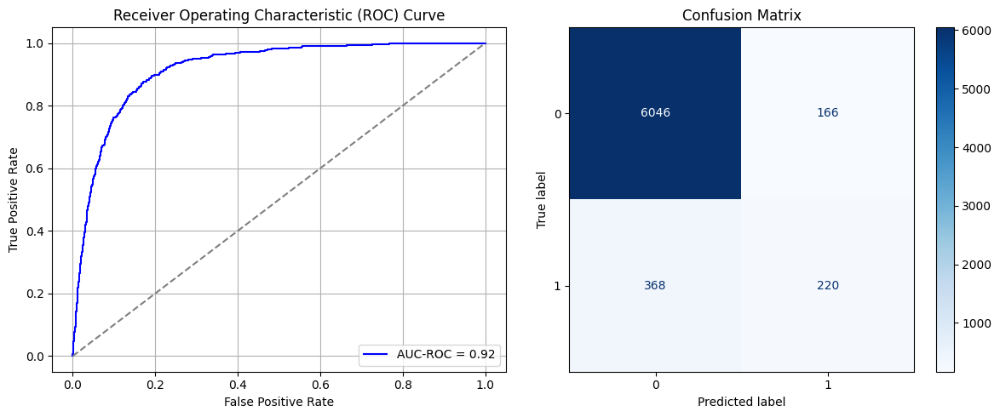

Best threshold based on F1-score: 0.2876892387866974
False Negative Rate: 0.6258503401360545
Time elapsed (performance): 0.7681197259998953
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.6673 - loss: 0.3677 - val_AUC: 0.8712 - val_loss: 0.2748
Epoch 2/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8721 - loss: 0.2585 - val_AUC: 0.8810 - val_loss: 0.2618
Epoch 3/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8839 - loss: 0.2514 - val_AUC: 0.8839 - val_loss: 0.2640
Epoch 4/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - AUC: 0.8864 - loss: 0.2485 - val_AUC: 0.8836 - val_loss: 0.2578
Epoch 5/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8828 - loss: 0.2471 - val_AUC: 0.8883 - val_loss: 0.2528
Epoch 6/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8882 - loss: 0.2428 - val_AUC: 0.8870 - val_loss: 0.2666
Epoch 7/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 2ms/step - AUC: 0.8900 - loss: 0.2437 - val_AUC: 0.8906 - val_loss: 0.2512
Epoch 8/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8968 - loss: 0.2373 - val_AUC: 0.8917 - val_loss: 0.2496
Epoch 9/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8940 -

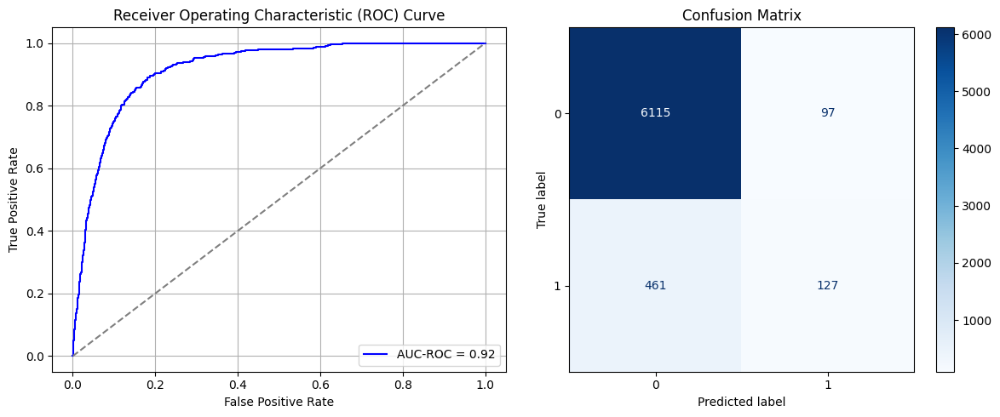

Best threshold based on F1-score: 0.6961430311203003
False Negative Rate: 0.7840136054421769
Time elapsed (performance): 0.7529927349996797
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.6635 - loss: 0.3653 - val_AUC: 0.8649 - val_loss: 0.2811
Epoch 2/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8667 - loss: 0.2646 - val_AUC: 0.8797 - val_loss: 0.2663
Epoch 3/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8824 - loss: 0.2506 - val_AUC: 0.8823 - val_loss: 0.2581
Epoch 4/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8799 - loss: 0.2464 - val_AUC: 0.8833 - val_loss: 0.2566
Epoch 5/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8845 - loss: 0.2520 - val_AUC: 0.8841 - val_loss: 0.2584
Epoch 6/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8828 - loss: 0.2445 - val_AUC: 0.8860 - val_loss: 0.2559
Epoch 7/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8861 - loss: 0.2478 - val_AUC: 0.8859 - val_loss: 0.2542
Epoch 8/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8873 - loss: 0.2474 - val_AUC: 0.8878 - val_loss: 0.2555
Epoch 9/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8906 -

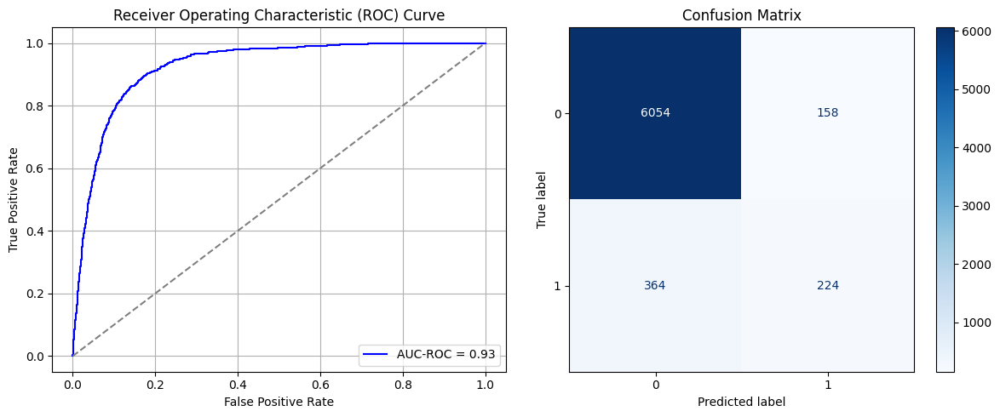

Best threshold based on F1-score: 0.24760444462299347
False Negative Rate: 0.6190476190476191
Time elapsed (performance): 1.2188715789998241
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.6531 - loss: 0.3762 - val_AUC: 0.8691 - val_loss: 0.2773
Epoch 2/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8653 - loss: 0.2673 - val_AUC: 0.8796 - val_loss: 0.2613
Epoch 3/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8803 - loss: 0.2519 - val_AUC: 0.8829 - val_loss: 0.2723
Epoch 4/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8745 - loss: 0.2536 - val_AUC: 0.8879 - val_loss: 0.2535
Epoch 5/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8838 - loss: 0.2464 - val_AUC: 0.8867 - val_loss: 0.2546
Epoch 6/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8921 - loss: 0.2397 - val_AUC: 0.8889 - val_loss: 0.2532
Epoch 7/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8841 - loss: 0.2447 - val_AUC: 0.8902 - val_loss: 0.2543
Epoch 8/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8906 - loss: 0.2381 - val_AUC: 0.8920 - val_loss: 0.2500
Epoch 9/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8914 -

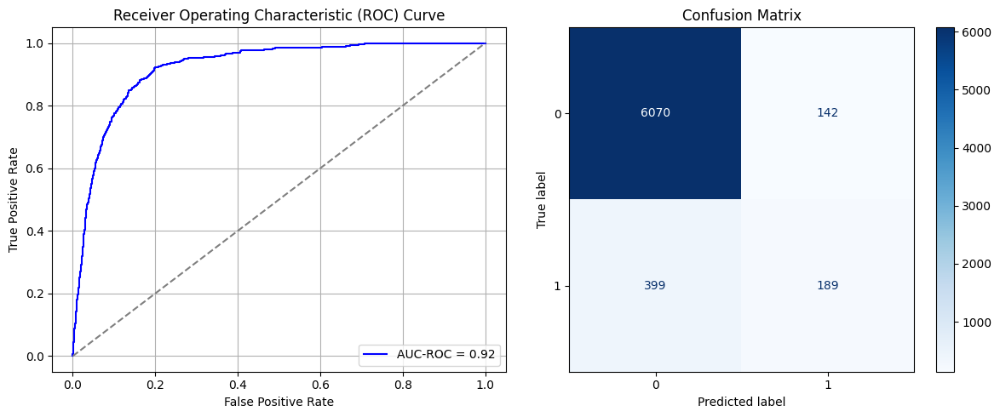

Best threshold based on F1-score: 0.20501965284347534
False Negative Rate: 0.6785714285714286
Time elapsed (performance): 0.7807783490006841
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.6584 - loss: 0.3593 - val_AUC: 0.8723 - val_loss: 0.2713
Epoch 2/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8754 - loss: 0.2572 - val_AUC: 0.8806 - val_loss: 0.2678
Epoch 3/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8793 - loss: 0.2526 - val_AUC: 0.8826 - val_loss: 0.2581
Epoch 4/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8736 - loss: 0.2535 - val_AUC: 0.8856 - val_loss: 0.2555
Epoch 5/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8816 - loss: 0.2494 - val_AUC: 0.8822 - val_loss: 0.2604
Epoch 6/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8840 - loss: 0.2493 - val_AUC: 0.8869 - val_loss: 0.2538
Epoch 7/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8878 - loss: 0.2438 - val_AUC: 0.8889 - val_loss: 0.2573
Epoch 8/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8913 - loss: 0.2384 - val_AUC: 0.8907 - val_loss: 0.2546
Epoch 9/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8901 -

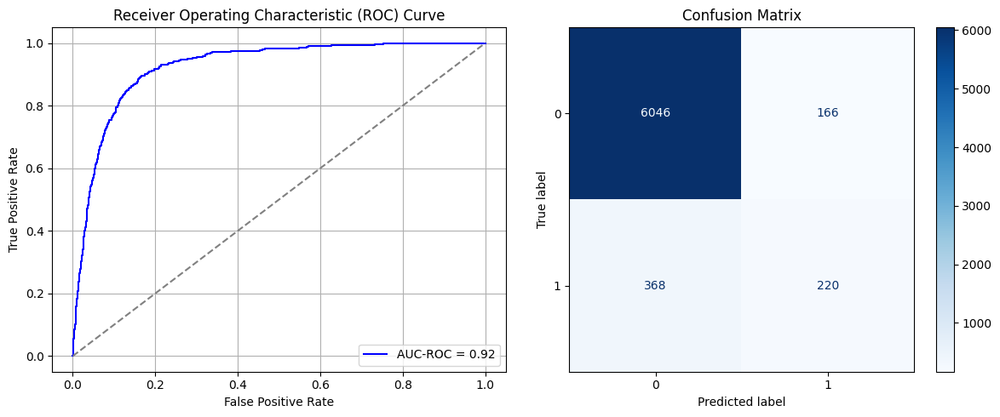

Best threshold based on F1-score: 0.7696195244789124
False Negative Rate: 0.6258503401360545
Time elapsed (performance): 0.7535509789995558
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.6280 - loss: 0.3912 - val_AUC: 0.8675 - val_loss: 0.2765
Epoch 2/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8565 - loss: 0.2674 - val_AUC: 0.8817 - val_loss: 0.2600
Epoch 3/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8798 - loss: 0.2520 - val_AUC: 0.8837 - val_loss: 0.2574
Epoch 4/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8777 - loss: 0.2588 - val_AUC: 0.8822 - val_loss: 0.2631
Epoch 5/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8811 - loss: 0.2494 - val_AUC: 0.8879 - val_loss: 0.2536
Epoch 6/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8868 - loss: 0.2440 - val_AUC: 0.8890 - val_loss: 0.2518
Epoch 7/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8991 - loss: 0.2384 - val_AUC: 0.8931 - val_loss: 0.2505
Epoch 8/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8943 - loss: 0.2417 - val_AUC: 0.8937 - val_loss: 0.2475
Epoch 9/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8967 -

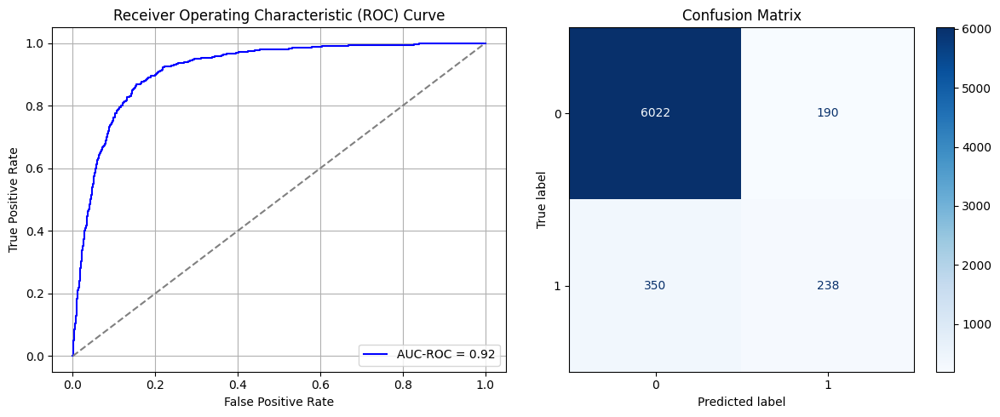

Best threshold based on F1-score: 0.7956492304801941
False Negative Rate: 0.5952380952380952
Time elapsed (performance): 1.220174809999662
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.6634 - loss: 0.3707 - val_AUC: 0.8754 - val_loss: 0.2748
Epoch 2/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8607 - loss: 0.2651 - val_AUC: 0.8781 - val_loss: 0.2631
Epoch 3/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8769 - loss: 0.2575 - val_AUC: 0.8834 - val_loss: 0.2583
Epoch 4/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8831 - loss: 0.2495 - val_AUC: 0.8856 - val_loss: 0.2562
Epoch 5/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8863 - loss: 0.2438 - val_AUC: 0.8853 - val_loss: 0.2589
Epoch 6/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8801 - loss: 0.2501 - val_AUC: 0.8857 - val_loss: 0.2557
Epoch 7/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8873 - loss: 0.2427 - val_AUC: 0.8892 - val_loss: 0.2515
Epoch 8/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8889 - loss: 0.2443 - val_AUC: 0.8909 - val_loss: 0.2513
Epoch 9/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8941 -

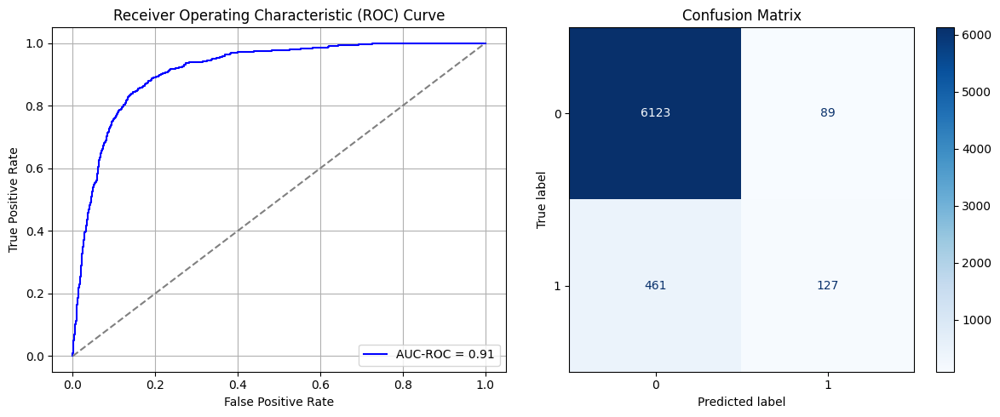

Best threshold based on F1-score: 0.231759175658226
False Negative Rate: 0.7840136054421769
Time elapsed (performance): 0.7741447870002958
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.6532 - loss: 0.3781 - val_AUC: 0.8650 - val_loss: 0.2801
Epoch 2/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8680 - loss: 0.2645 - val_AUC: 0.8798 - val_loss: 0.2608
Epoch 3/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8813 - loss: 0.2533 - val_AUC: 0.8833 - val_loss: 0.2605
Epoch 4/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8854 - loss: 0.2478 - val_AUC: 0.8878 - val_loss: 0.2532
Epoch 5/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8906 - loss: 0.2402 - val_AUC: 0.8868 - val_loss: 0.2536
Epoch 6/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8864 - loss: 0.2466 - val_AUC: 0.8873 - val_loss: 0.2544
Epoch 7/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8902 - loss: 0.2436 - val_AUC: 0.8910 - val_loss: 0.2495
Epoch 8/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8905 - loss: 0.2442 - val_AUC: 0.8902 - val_loss: 0.2531
Epoch 9/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8931 -

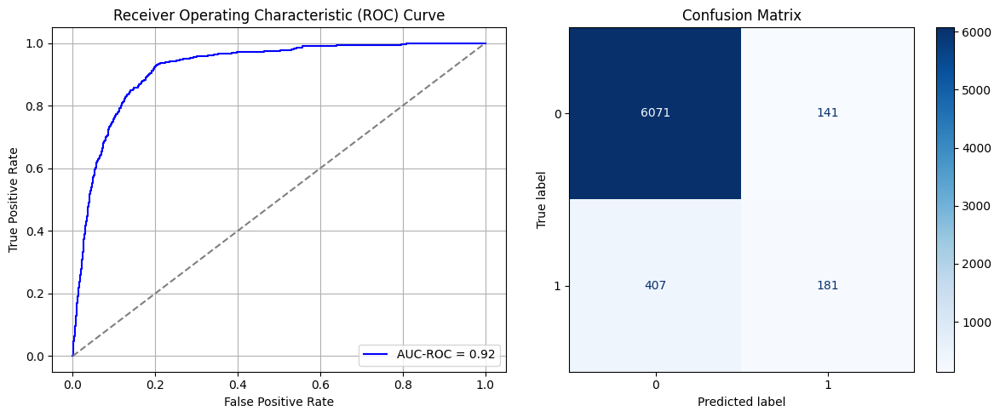

Best threshold based on F1-score: 0.2863699495792389
False Negative Rate: 0.6921768707482994
Time elapsed (performance): 0.7645667110000431
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


728/728 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.6388 - loss: 0.3724 - val_AUC: 0.8566 - val_loss: 0.2888
Epoch 2/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8599 - loss: 0.2656 - val_AUC: 0.8769 - val_loss: 0.2629
Epoch 3/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8723 - loss: 0.2582 - val_AUC: 0.8781 - val_loss: 0.2621
Epoch 4/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8796 - loss: 0.2488 - val_AUC: 0.8826 - val_loss: 0.2626
Epoch 5/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8841 - loss: 0.2474 - val_AUC: 0.8856 - val_loss: 0.2552
Epoch 6/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8879 - loss: 0.2403 - val_AUC: 0.8873 - val_loss: 0.2541
Epoch 7/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8906 - loss: 0.2419 - val_AUC: 0.8880 - val_loss: 0.2541
Epoch 8/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8900 - loss: 0.2463 - val_AUC: 0.8891 - val_loss: 0.2560
Epoch 9/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8907 -

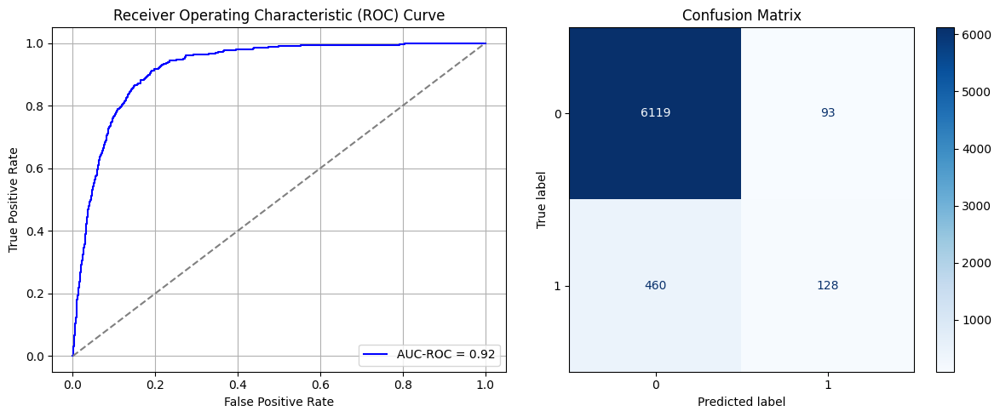

Best threshold based on F1-score: 0.15675806999206543
False Negative Rate: 0.782312925170068
Time elapsed (performance): 0.7886995349999779
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.6364 - loss: 0.3810 - val_AUC: 0.8671 - val_loss: 0.2843
Epoch 2/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8596 - loss: 0.2709 - val_AUC: 0.8830 - val_loss: 0.2597
Epoch 3/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8788 - loss: 0.2512 - val_AUC: 0.8853 - val_loss: 0.2564
Epoch 4/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8792 - loss: 0.2467 - val_AUC: 0.8867 - val_loss: 0.2555
Epoch 5/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8906 - loss: 0.2442 - val_AUC: 0.8902 - val_loss: 0.2529
Epoch 6/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8889 - loss: 0.2435 - val_AUC: 0.8892 - val_loss: 0.2527
Epoch 7/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8898 - loss: 0.2403 - val_AUC: 0.8941 - val_loss: 0.2488
Epoch 8/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8936 - loss: 0.2313 - val_AUC: 0.8957 - val_loss: 0.2467
Epoch 9/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8973 -

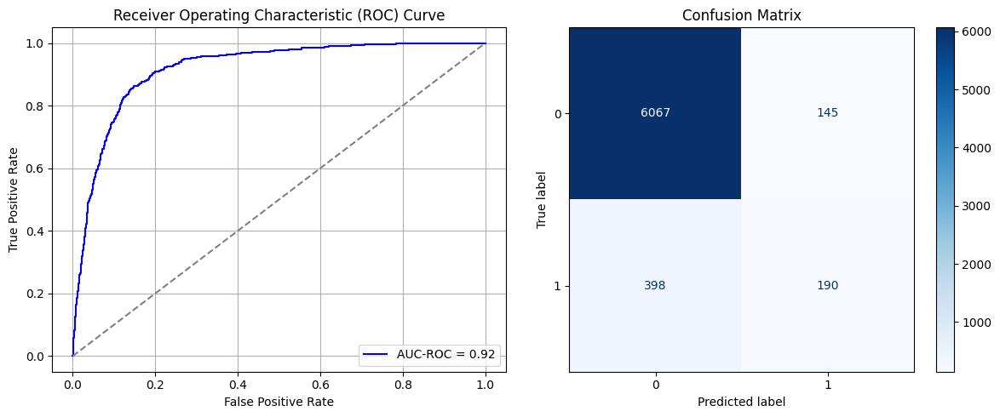

Best threshold based on F1-score: 0.8369070887565613
False Negative Rate: 0.6768707482993197
Time elapsed (performance): 1.2323788270005025
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


728/728 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.6274 - loss: 0.3703 - val_AUC: 0.8667 - val_loss: 0.2760
Epoch 2/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8621 - loss: 0.2638 - val_AUC: 0.8773 - val_loss: 0.2776
Epoch 3/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8790 - loss: 0.2519 - val_AUC: 0.8818 - val_loss: 0.2588
Epoch 4/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8821 - loss: 0.2508 - val_AUC: 0.8817 - val_loss: 0.2681
Epoch 5/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8851 - loss: 0.2463 - val_AUC: 0.8823 - val_loss: 0.2582
Epoch 6/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8884 - loss: 0.2432 - val_AUC: 0.8860 - val_loss: 0.2556
Epoch 7/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8879 - loss: 0.2455 - val_AUC: 0.8890 - val_loss: 0.2638
Epoch 8/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8885 - loss: 0.2381 - val_AUC: 0.8902 - val_loss: 0.2542
Epoch 9/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8910 -

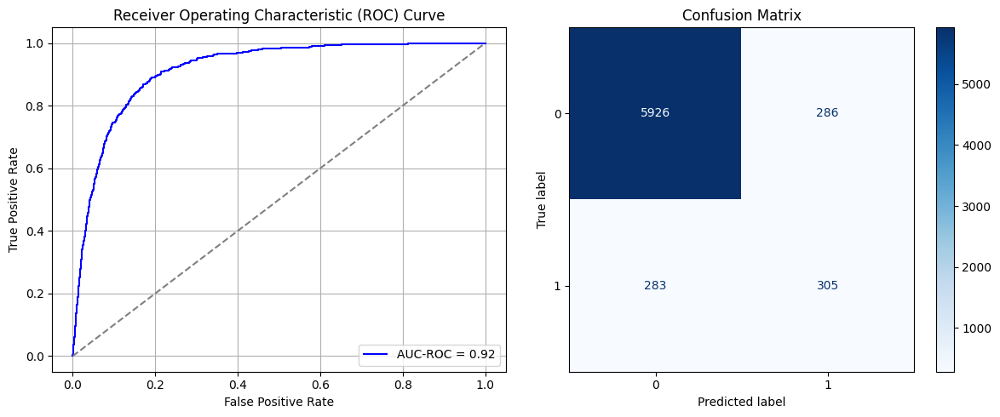

Best threshold based on F1-score: 0.3753108084201813
False Negative Rate: 0.4812925170068027
Time elapsed (performance): 0.7958145879993026
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.6831 - loss: 0.3559 - val_AUC: 0.8761 - val_loss: 0.2744
Epoch 2/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8759 - loss: 0.2558 - val_AUC: 0.8815 - val_loss: 0.2592
Epoch 3/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8833 - loss: 0.2481 - val_AUC: 0.8840 - val_loss: 0.2586
Epoch 4/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8780 - loss: 0.2534 - val_AUC: 0.8865 - val_loss: 0.2578
Epoch 5/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8888 - loss: 0.2467 - val_AUC: 0.8872 - val_loss: 0.2530
Epoch 6/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8857 - loss: 0.2490 - val_AUC: 0.8887 - val_loss: 0.2512
Epoch 7/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8883 - loss: 0.2460 - val_AUC: 0.8918 - val_loss: 0.2502
Epoch 8/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8896 - loss: 0.2415 - val_AUC: 0.8933 - val_loss: 0.2482
Epoch 9/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8986 -

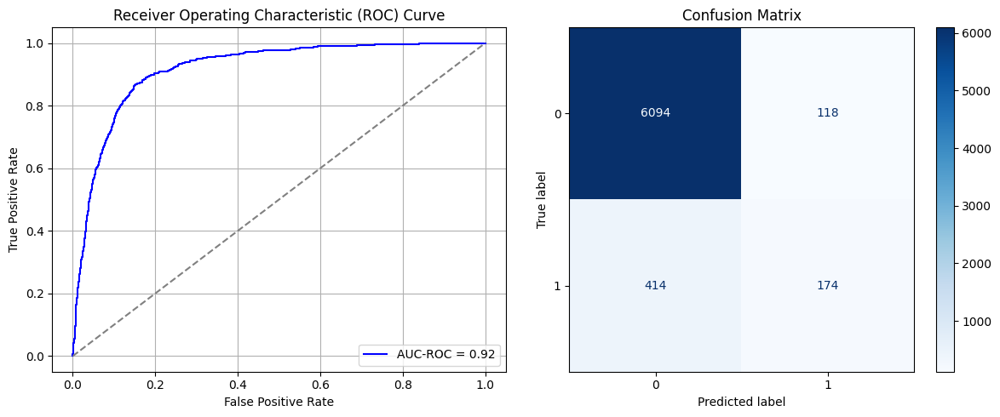

Best threshold based on F1-score: 0.2864660918712616
False Negative Rate: 0.7040816326530612
Time elapsed (performance): 1.0429415240005255
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


728/728 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - AUC: 0.6522 - loss: 0.3747 - val_AUC: 0.8656 - val_loss: 0.2809
Epoch 2/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8578 - loss: 0.2713 - val_AUC: 0.8799 - val_loss: 0.2654
Epoch 3/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8801 - loss: 0.2530 - val_AUC: 0.8774 - val_loss: 0.2642
Epoch 4/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8770 - loss: 0.2587 - val_AUC: 0.8839 - val_loss: 0.2584
Epoch 5/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8843 - loss: 0.2466 - val_AUC: 0.8833 - val_loss: 0.2583
Epoch 6/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8817 - loss: 0.2493 - val_AUC: 0.8872 - val_loss: 0.2540
Epoch 7/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8892 - loss: 0.2476 - val_AUC: 0.8828 - val_loss: 0.2576
Epoch 8/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8906 - loss: 0.2413 - val_AUC: 0.8898 - val_loss: 0.2517
Epoch 9/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8908 -

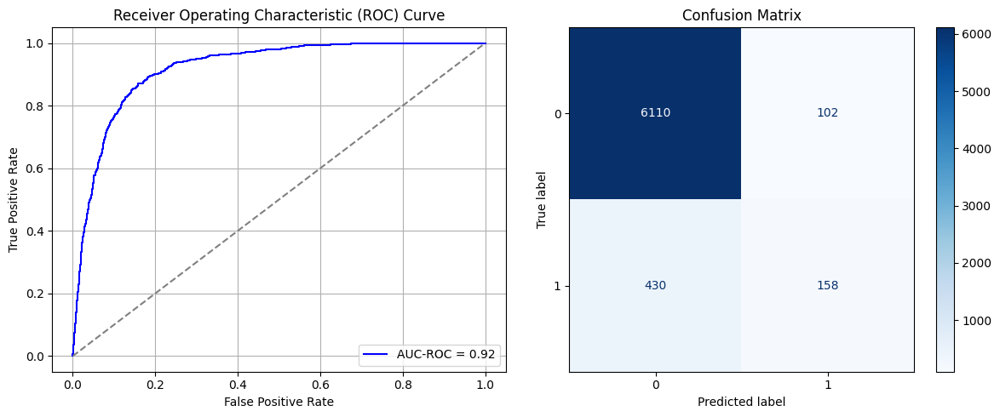

Best threshold based on F1-score: 0.20677576959133148
False Negative Rate: 0.7312925170068028
Time elapsed (performance): 1.076840467000693
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.6475 - loss: 0.3806 - val_AUC: 0.8646 - val_loss: 0.2813
Epoch 2/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8633 - loss: 0.2626 - val_AUC: 0.8786 - val_loss: 0.2647
Epoch 3/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8804 - loss: 0.2479 - val_AUC: 0.8828 - val_loss: 0.2610
Epoch 4/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8799 - loss: 0.2486 - val_AUC: 0.8840 - val_loss: 0.2625
Epoch 5/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8863 - loss: 0.2484 - val_AUC: 0.8824 - val_loss: 0.2594
Epoch 6/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8903 - loss: 0.2454 - val_AUC: 0.8874 - val_loss: 0.2543
Epoch 7/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8998 - loss: 0.2367 - val_AUC: 0.8913 - val_loss: 0.2499
Epoch 8/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8949 - loss: 0.2389 - val_AUC: 0.8919 - val_loss: 0.2536
Epoch 9/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8862 -

<ipython-input-76-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
AUC-ROC: 0.9174099614089037
Classification Report:
              precision    recall  f1-score   support

           0       0.94      0.98      0.96      6212
           1       0.58      0.30      0.40       588

    accuracy                           0.92      6800
   macro avg       0.76      0.64      0.68      6800
weighted avg       0.91      0.92      0.91      6800

FPR 0.020766258853831293 TPR: 0.30272108843537415 FNR: 0.6972789115646258 TNR: 0.9792337411461687


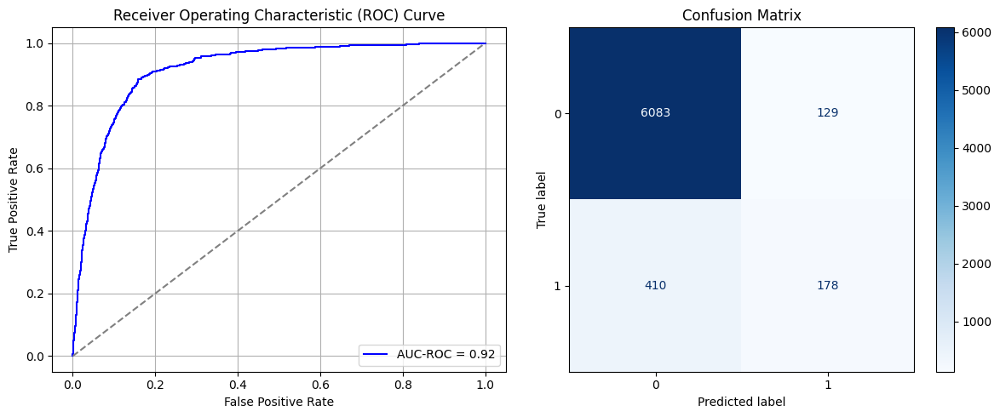

Best threshold based on F1-score: 0.22998186945915222
False Negative Rate: 0.6972789115646258
Time elapsed (performance): 0.7683382770001117
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.6498 - loss: 0.3735 - val_AUC: 0.8739 - val_loss: 0.2741
Epoch 2/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8712 - loss: 0.2623 - val_AUC: 0.8825 - val_loss: 0.2616
Epoch 3/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8742 - loss: 0.2577 - val_AUC: 0.8847 - val_loss: 0.2690
Epoch 4/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8892 - loss: 0.2447 - val_AUC: 0.8833 - val_loss: 0.2599
Epoch 5/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8836 - loss: 0.2495 - val_AUC: 0.8881 - val_loss: 0.2522
Epoch 6/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8850 - loss: 0.2479 - val_AUC: 0.8881 - val_loss: 0.2521
Epoch 7/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8932 - loss: 0.2380 - val_AUC: 0.8922 - val_loss: 0.2588
Epoch 8/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8951 - loss: 0.2366 - val_AUC: 0.8938 - val_loss: 0.2487
Epoch 9/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8946 -

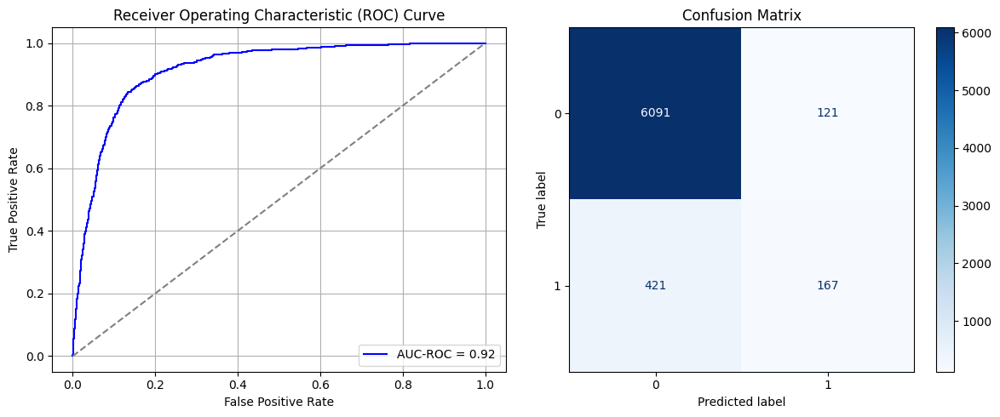

Best threshold based on F1-score: 0.16910462081432343
False Negative Rate: 0.7159863945578231
Time elapsed (performance): 1.2309093600006236
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.6449 - loss: 0.3813 - val_AUC: 0.8629 - val_loss: 0.2826
Epoch 2/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8683 - loss: 0.2660 - val_AUC: 0.8771 - val_loss: 0.2672
Epoch 3/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8764 - loss: 0.2601 - val_AUC: 0.8818 - val_loss: 0.2673
Epoch 4/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8831 - loss: 0.2500 - val_AUC: 0.8834 - val_loss: 0.2589
Epoch 5/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8872 - loss: 0.2418 - val_AUC: 0.8851 - val_loss: 0.2706
Epoch 6/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8809 - loss: 0.2492 - val_AUC: 0.8859 - val_loss: 0.2552
Epoch 7/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8881 - loss: 0.2422 - val_AUC: 0.8834 - val_loss: 0.2610
Epoch 8/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8906 - loss: 0.2425 - val_AUC: 0.8895 - val_loss: 0.2514
Epoch 9/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8907 -

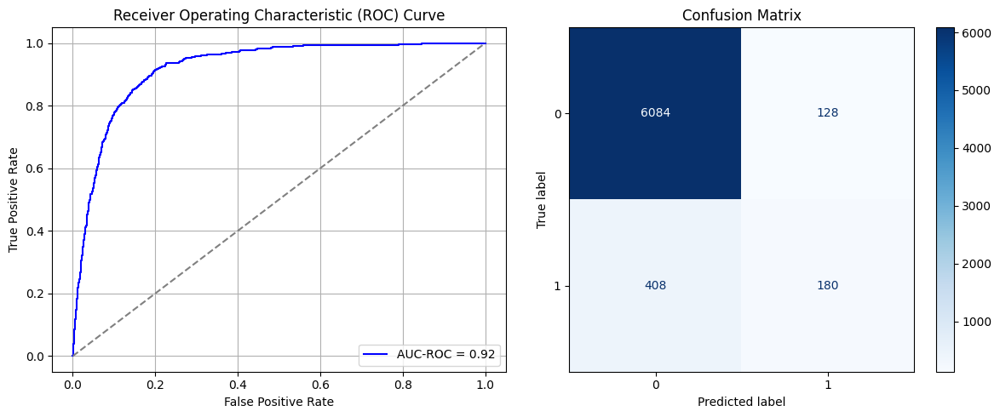

Best threshold based on F1-score: 0.7975811958312988
False Negative Rate: 0.6938775510204082
Time elapsed (performance): 1.0450743149995105
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


728/728 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.6494 - loss: 0.3738 - val_AUC: 0.8671 - val_loss: 0.2762
Epoch 2/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8614 - loss: 0.2700 - val_AUC: 0.8800 - val_loss: 0.2613
Epoch 3/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8777 - loss: 0.2501 - val_AUC: 0.8829 - val_loss: 0.2586
Epoch 4/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8817 - loss: 0.2474 - val_AUC: 0.8836 - val_loss: 0.2584
Epoch 5/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8829 - loss: 0.2498 - val_AUC: 0.8861 - val_loss: 0.2565
Epoch 6/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8890 - loss: 0.2453 - val_AUC: 0.8888 - val_loss: 0.2533
Epoch 7/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8884 - loss: 0.2427 - val_AUC: 0.8894 - val_loss: 0.2536
Epoch 8/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8934 - loss: 0.2447 - val_AUC: 0.8932 - val_loss: 0.2486
Epoch 9/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8939 -

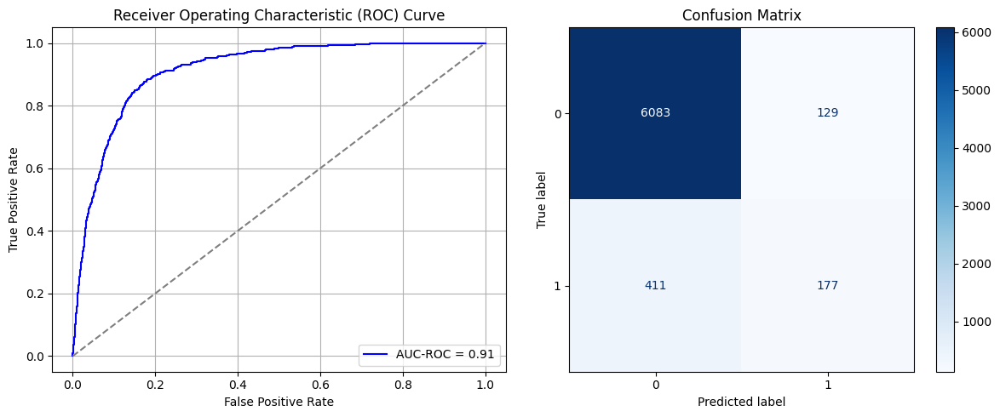

Best threshold based on F1-score: 0.20468568801879883
False Negative Rate: 0.6989795918367347
Time elapsed (performance): 1.0273728279998977
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


728/728 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.6651 - loss: 0.3559 - val_AUC: 0.8719 - val_loss: 0.2710
Epoch 2/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8640 - loss: 0.2675 - val_AUC: 0.8806 - val_loss: 0.2617
Epoch 3/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8826 - loss: 0.2472 - val_AUC: 0.8815 - val_loss: 0.2683
Epoch 4/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8785 - loss: 0.2536 - val_AUC: 0.8860 - val_loss: 0.2548
Epoch 5/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8808 - loss: 0.2482 - val_AUC: 0.8855 - val_loss: 0.2554
Epoch 6/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8863 - loss: 0.2473 - val_AUC: 0.8822 - val_loss: 0.2597
Epoch 7/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8868 - loss: 0.2410 - val_AUC: 0.8896 - val_loss: 0.2577
Epoch 8/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8895 - loss: 0.2462 - val_AUC: 0.8912 - val_loss: 0.2503
Epoch 9/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8990 -

<ipython-input-76-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
AUC-ROC: 0.9200721338116703
Classification Report:
              precision    recall  f1-score   support

           0       0.94      0.98      0.96      6212
           1       0.58      0.35      0.43       588

    accuracy                           0.92      6800
   macro avg       0.76      0.66      0.70      6800
weighted avg       0.91      0.92      0.91      6800

FPR 0.02414681262073406 TPR: 0.3486394557823129 FNR: 0.6513605442176871 TNR: 0.975853187379266


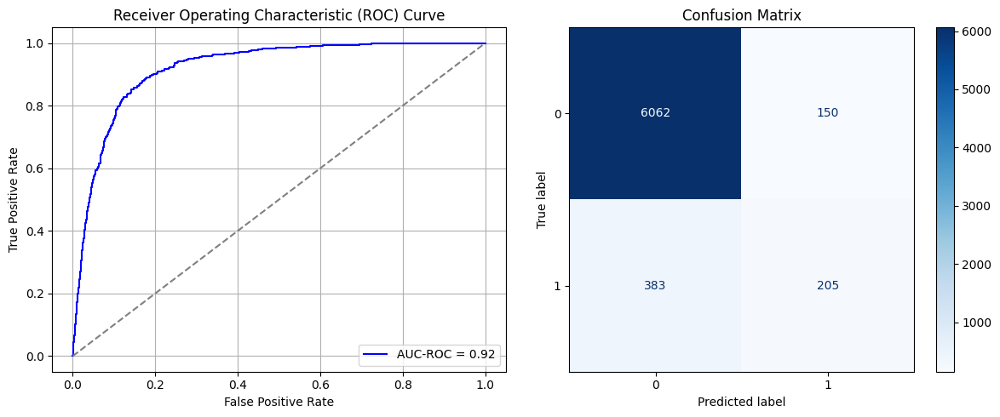

Best threshold based on F1-score: 0.22713294625282288
False Negative Rate: 0.6513605442176871
Time elapsed (performance): 0.8372718600003282
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.6631 - loss: 0.3670 - val_AUC: 0.8639 - val_loss: 0.2793
Epoch 2/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8653 - loss: 0.2663 - val_AUC: 0.8797 - val_loss: 0.2636
Epoch 3/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8726 - loss: 0.2577 - val_AUC: 0.8810 - val_loss: 0.2629
Epoch 4/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8867 - loss: 0.2439 - val_AUC: 0.8827 - val_loss: 0.2628
Epoch 5/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8887 - loss: 0.2466 - val_AUC: 0.8857 - val_loss: 0.2560
Epoch 6/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8859 - loss: 0.2500 - val_AUC: 0.8857 - val_loss: 0.2559
Epoch 7/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8910 - loss: 0.2428 - val_AUC: 0.8877 - val_loss: 0.2537
Epoch 8/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8916 - loss: 0.2446 - val_AUC: 0.8890 - val_loss: 0.2519
Epoch 9/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8932 -

<ipython-input-76-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
AUC-ROC: 0.9207568410493625
Classification Report:
              precision    recall  f1-score   support

           0       0.94      0.98      0.96      6212
           1       0.58      0.34      0.43       588

    accuracy                           0.92      6800
   macro avg       0.76      0.66      0.69      6800
weighted avg       0.91      0.92      0.91      6800

FPR 0.02350289761751449 TPR: 0.34353741496598644 FNR: 0.6564625850340136 TNR: 0.9764971023824855


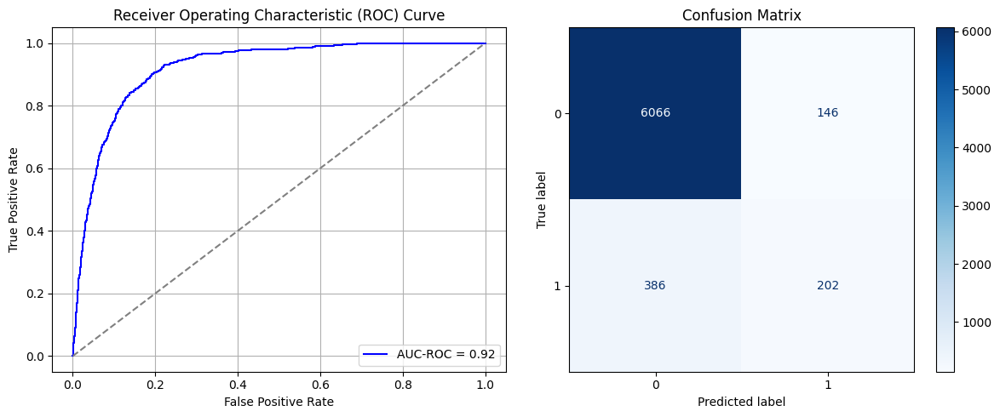

Best threshold based on F1-score: 0.2535787522792816
False Negative Rate: 0.6564625850340136
Time elapsed (performance): 1.2255231429999185
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.6806 - loss: 0.3612 - val_AUC: 0.8705 - val_loss: 0.2733
Epoch 2/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8709 - loss: 0.2617 - val_AUC: 0.8797 - val_loss: 0.2664
Epoch 3/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8730 - loss: 0.2554 - val_AUC: 0.8814 - val_loss: 0.2610
Epoch 4/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8770 - loss: 0.2545 - val_AUC: 0.8860 - val_loss: 0.2580
Epoch 5/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8839 - loss: 0.2497 - val_AUC: 0.8873 - val_loss: 0.2565
Epoch 6/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8871 - loss: 0.2409 - val_AUC: 0.8900 - val_loss: 0.2510
Epoch 7/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8935 - loss: 0.2455 - val_AUC: 0.8909 - val_loss: 0.2543
Epoch 8/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8979 - loss: 0.2338 - val_AUC: 0.8953 - val_loss: 0.2469
Epoch 9/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8941 -

<ipython-input-76-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
AUC-ROC: 0.9229191032497996
Classification Report:
              precision    recall  f1-score   support

           0       0.94      0.98      0.96      6212
           1       0.57      0.32      0.41       588

    accuracy                           0.92      6800
   macro avg       0.76      0.65      0.69      6800
weighted avg       0.91      0.92      0.91      6800

FPR 0.022858982614294913 TPR: 0.3248299319727891 FNR: 0.6751700680272109 TNR: 0.9771410173857051


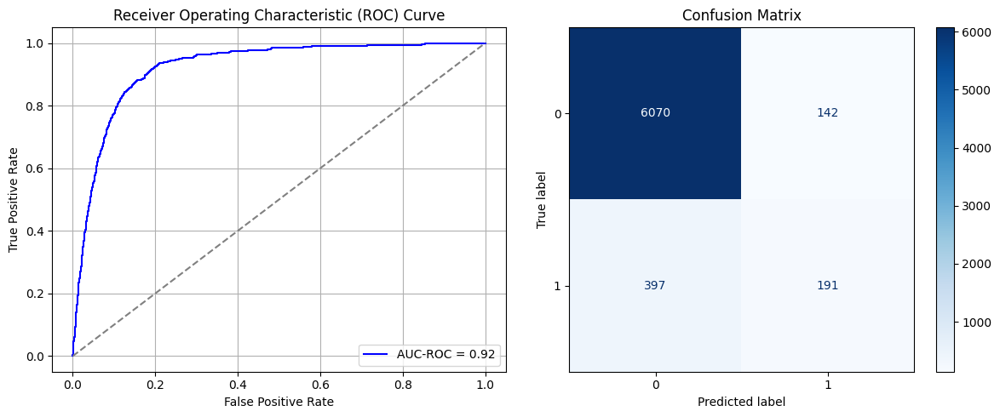

Best threshold based on F1-score: 0.21305619180202484
False Negative Rate: 0.6751700680272109
Time elapsed (performance): 0.8790322209997612
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


728/728 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - AUC: 0.6429 - loss: 0.3938 - val_AUC: 0.8536 - val_loss: 0.2925
Epoch 2/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8639 - loss: 0.2666 - val_AUC: 0.8812 - val_loss: 0.2626
Epoch 3/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8760 - loss: 0.2568 - val_AUC: 0.8812 - val_loss: 0.2599
Epoch 4/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8794 - loss: 0.2549 - val_AUC: 0.8810 - val_loss: 0.2600
Epoch 5/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8822 - loss: 0.2472 - val_AUC: 0.8842 - val_loss: 0.2571
Epoch 6/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8811 - loss: 0.2487 - val_AUC: 0.8885 - val_loss: 0.2518
Epoch 7/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8936 - loss: 0.2404 - val_AUC: 0.8886 - val_loss: 0.2547
Epoch 8/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8964 - loss: 0.2365 - val_AUC: 0.8882 - val_loss: 0.2538
Epoch 9/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9000 -

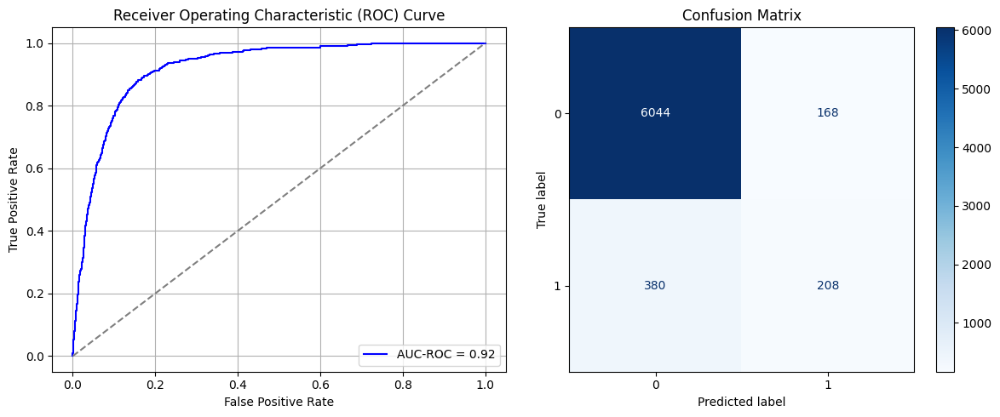

Best threshold based on F1-score: 0.20356762409210205
False Negative Rate: 0.6462585034013606
Time elapsed (performance): 1.0414234599993506
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.6348 - loss: 0.3924 - val_AUC: 0.8610 - val_loss: 0.2822
Epoch 2/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8648 - loss: 0.2711 - val_AUC: 0.8804 - val_loss: 0.2690
Epoch 3/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8737 - loss: 0.2592 - val_AUC: 0.8800 - val_loss: 0.2619
Epoch 4/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8771 - loss: 0.2554 - val_AUC: 0.8765 - val_loss: 0.2649
Epoch 5/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8809 - loss: 0.2487 - val_AUC: 0.8852 - val_loss: 0.2574
Epoch 6/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8838 - loss: 0.2454 - val_AUC: 0.8864 - val_loss: 0.2539
Epoch 7/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8892 - loss: 0.2449 - val_AUC: 0.8837 - val_loss: 0.2570
Epoch 8/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8885 - loss: 0.2467 - val_AUC: 0.8889 - val_loss: 0.2522
Epoch 9/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8923 -

<ipython-input-76-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
AUC-ROC: 0.9153777415666845
Classification Report:
              precision    recall  f1-score   support

           0       0.94      0.98      0.96      6212
           1       0.57      0.34      0.42       588

    accuracy                           0.92      6800
   macro avg       0.75      0.66      0.69      6800
weighted avg       0.91      0.92      0.91      6800

FPR 0.02398583386992917 TPR: 0.33503401360544216 FNR: 0.6649659863945578 TNR: 0.9760141661300709


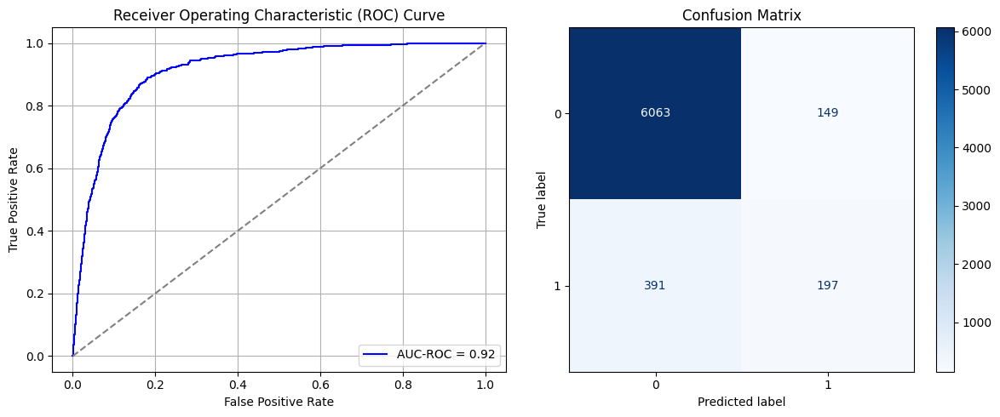

Best threshold based on F1-score: 0.24412162601947784
False Negative Rate: 0.6649659863945578
Time elapsed (performance): 1.0380154640006367
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


728/728 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - AUC: 0.6461 - loss: 0.3810 - val_AUC: 0.8659 - val_loss: 0.2776
Epoch 2/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8702 - loss: 0.2589 - val_AUC: 0.8728 - val_loss: 0.2658
Epoch 3/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8782 - loss: 0.2524 - val_AUC: 0.8809 - val_loss: 0.2603
Epoch 4/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8820 - loss: 0.2495 - val_AUC: 0.8837 - val_loss: 0.2572
Epoch 5/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8861 - loss: 0.2444 - val_AUC: 0.8884 - val_loss: 0.2526
Epoch 6/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8899 - loss: 0.2429 - val_AUC: 0.8898 - val_loss: 0.2517
Epoch 7/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8923 - loss: 0.2398 - val_AUC: 0.8910 - val_loss: 0.2511
Epoch 8/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8922 - loss: 0.2381 - val_AUC: 0.8919 - val_loss: 0.2508
Epoch 9/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8957 -

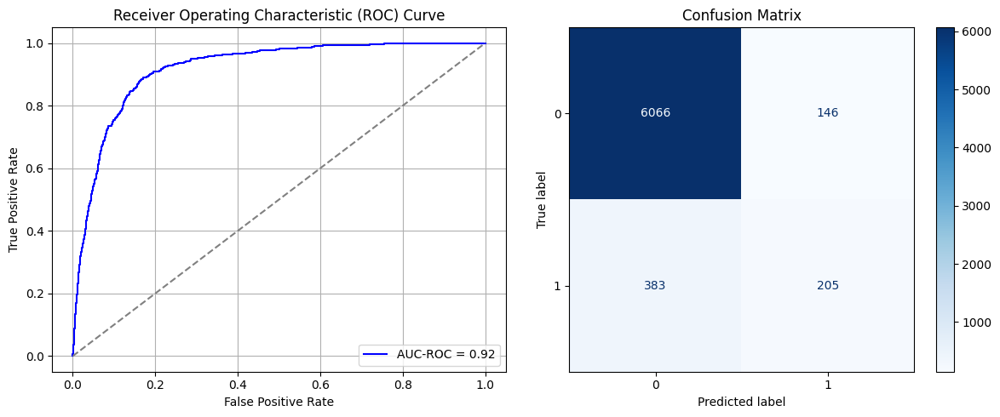

Best threshold based on F1-score: 0.19840748608112335
False Negative Rate: 0.6513605442176871
Time elapsed (performance): 1.0671158029999788
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.6514 - loss: 0.3821 - val_AUC: 0.8652 - val_loss: 0.2817
Epoch 2/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8713 - loss: 0.2573 - val_AUC: 0.8814 - val_loss: 0.2614
Epoch 3/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8722 - loss: 0.2512 - val_AUC: 0.8835 - val_loss: 0.2580
Epoch 4/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8864 - loss: 0.2480 - val_AUC: 0.8859 - val_loss: 0.2567
Epoch 5/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8967 - loss: 0.2345 - val_AUC: 0.8895 - val_loss: 0.2533
Epoch 6/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8859 - loss: 0.2477 - val_AUC: 0.8904 - val_loss: 0.2593
Epoch 7/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8923 - loss: 0.2386 - val_AUC: 0.8921 - val_loss: 0.2512
Epoch 8/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8962 - loss: 0.2401 - val_AUC: 0.8942 - val_loss: 0.2470
Epoch 9/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8972 -

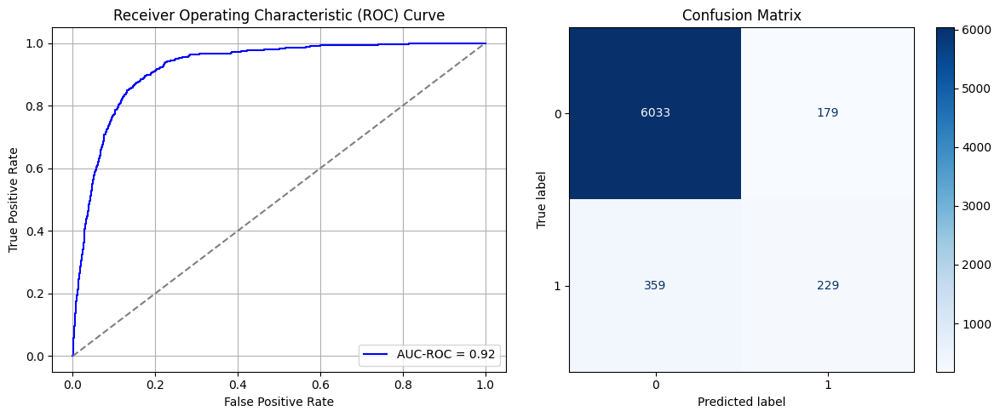

Best threshold based on F1-score: 0.8582732677459717
False Negative Rate: 0.6105442176870748
Time elapsed (performance): 1.0166568909999114
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


728/728 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.6459 - loss: 0.3770 - val_AUC: 0.8530 - val_loss: 0.2860
Epoch 2/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8649 - loss: 0.2638 - val_AUC: 0.8794 - val_loss: 0.2640
Epoch 3/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8721 - loss: 0.2593 - val_AUC: 0.8819 - val_loss: 0.2601
Epoch 4/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8793 - loss: 0.2543 - val_AUC: 0.8809 - val_loss: 0.2592
Epoch 5/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8753 - loss: 0.2549 - val_AUC: 0.8854 - val_loss: 0.2555
Epoch 6/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8804 - loss: 0.2516 - val_AUC: 0.8851 - val_loss: 0.2587
Epoch 7/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8882 - loss: 0.2477 - val_AUC: 0.8850 - val_loss: 0.2685
Epoch 8/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8840 - loss: 0.2482 - val_AUC: 0.8885 - val_loss: 0.2532
Epoch 9/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8870 -

<ipython-input-76-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
AUC-ROC: 0.9232646052625815
Classification Report:
              precision    recall  f1-score   support

           0       0.94      0.97      0.96      6212
           1       0.56      0.35      0.43       588

    accuracy                           0.92      6800
   macro avg       0.75      0.66      0.70      6800
weighted avg       0.91      0.92      0.91      6800

FPR 0.025756600128783 TPR: 0.3520408163265306 FNR: 0.6479591836734694 TNR: 0.974243399871217


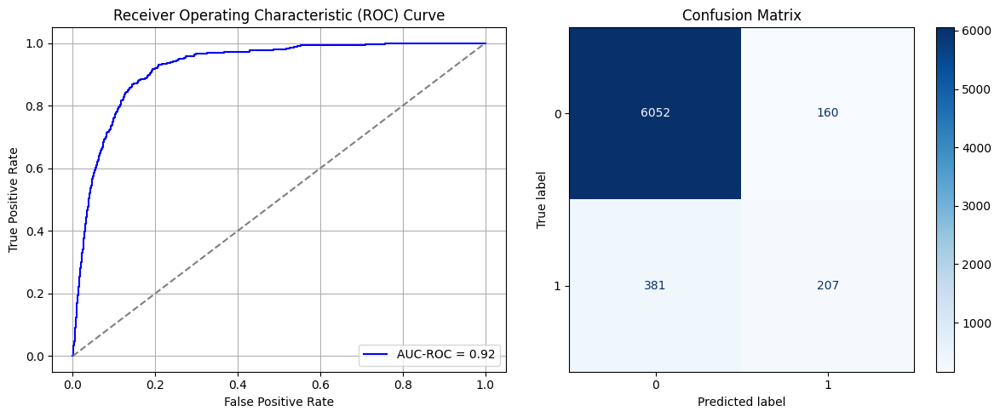

Best threshold based on F1-score: 0.795956015586853
False Negative Rate: 0.6479591836734694
Time elapsed (performance): 0.8673238710007354
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.6321 - loss: 0.3876 - val_AUC: 0.8597 - val_loss: 0.2828
Epoch 2/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8561 - loss: 0.2620 - val_AUC: 0.8771 - val_loss: 0.2751
Epoch 3/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8724 - loss: 0.2606 - val_AUC: 0.8808 - val_loss: 0.2685
Epoch 4/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8886 - loss: 0.2448 - val_AUC: 0.8814 - val_loss: 0.2613
Epoch 5/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8852 - loss: 0.2503 - val_AUC: 0.8861 - val_loss: 0.2563
Epoch 6/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8842 - loss: 0.2545 - val_AUC: 0.8889 - val_loss: 0.2562
Epoch 7/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8916 - loss: 0.2399 - val_AUC: 0.8906 - val_loss: 0.2508
Epoch 8/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8941 - loss: 0.2367 - val_AUC: 0.8881 - val_loss: 0.2578
Epoch 9/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8892 -

<ipython-input-76-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
AUC-ROC: 0.9223500652675751
Classification Report:
              precision    recall  f1-score   support

           0       0.94      0.98      0.96      6212
           1       0.61      0.28      0.38       588

    accuracy                           0.92      6800
   macro avg       0.77      0.63      0.67      6800
weighted avg       0.91      0.92      0.91      6800

FPR 0.01706374758531874 TPR: 0.2789115646258503 FNR: 0.7210884353741497 TNR: 0.9829362524146813


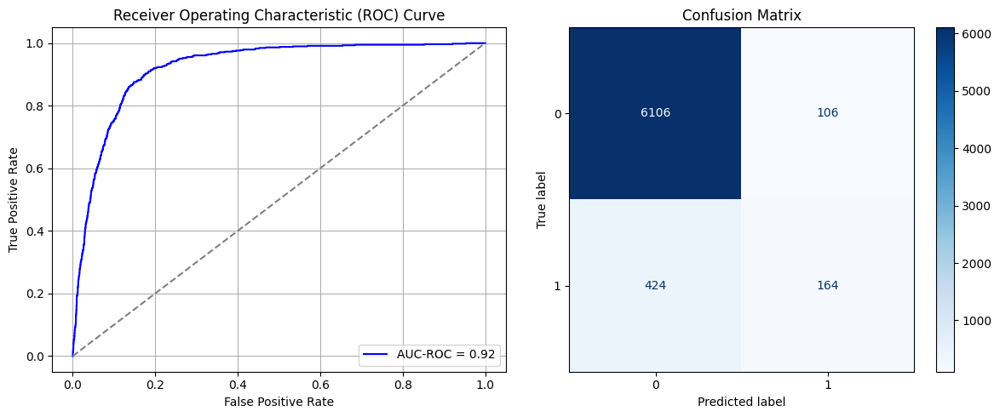

Best threshold based on F1-score: 0.18862517178058624
False Negative Rate: 0.7210884353741497
Time elapsed (performance): 0.8677100509994489
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.6538 - loss: 0.3559 - val_AUC: 0.8624 - val_loss: 0.2868
Epoch 2/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8658 - loss: 0.2675 - val_AUC: 0.8828 - val_loss: 0.2594
Epoch 3/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8759 - loss: 0.2579 - val_AUC: 0.8828 - val_loss: 0.2617
Epoch 4/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8772 - loss: 0.2527 - val_AUC: 0.8851 - val_loss: 0.2557
Epoch 5/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8839 - loss: 0.2475 - val_AUC: 0.8838 - val_loss: 0.2605
Epoch 6/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8821 - loss: 0.2454 - val_AUC: 0.8872 - val_loss: 0.2551
Epoch 7/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8813 - loss: 0.2497 - val_AUC: 0.8876 - val_loss: 0.2554
Epoch 8/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8890 - loss: 0.2393 - val_AUC: 0.8908 - val_loss: 0.2523
Epoch 9/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8939 -

<ipython-input-76-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
AUC-ROC: 0.9127752517620055
Classification Report:
              precision    recall  f1-score   support

           0       0.93      0.99      0.96      6212
           1       0.59      0.23      0.33       588

    accuracy                           0.92      6800
   macro avg       0.76      0.61      0.64      6800
weighted avg       0.90      0.92      0.90      6800

FPR 0.01497102382485512 TPR: 0.22619047619047616 FNR: 0.7738095238095238 TNR: 0.9850289761751448


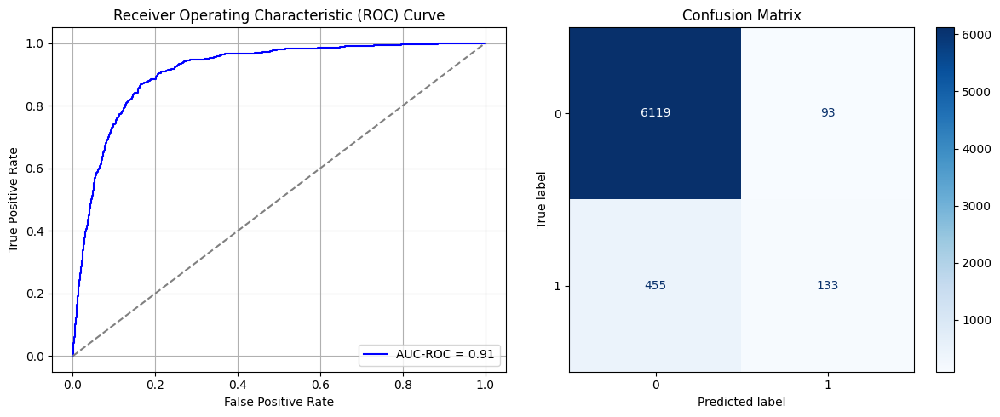

Best threshold based on F1-score: 0.09148749709129333
False Negative Rate: 0.7738095238095238
Time elapsed (performance): 1.087744126999496
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


728/728 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.6475 - loss: 0.3688 - val_AUC: 0.8699 - val_loss: 0.2725
Epoch 2/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8702 - loss: 0.2651 - val_AUC: 0.8814 - val_loss: 0.2662
Epoch 3/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8827 - loss: 0.2504 - val_AUC: 0.8830 - val_loss: 0.2589
Epoch 4/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8818 - loss: 0.2496 - val_AUC: 0.8851 - val_loss: 0.2575
Epoch 5/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8897 - loss: 0.2438 - val_AUC: 0.8858 - val_loss: 0.2630
Epoch 6/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8850 - loss: 0.2468 - val_AUC: 0.8900 - val_loss: 0.2517
Epoch 7/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8928 - loss: 0.2432 - val_AUC: 0.8916 - val_loss: 0.2503
Epoch 8/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8895 - loss: 0.2408 - val_AUC: 0.8919 - val_loss: 0.2535
Epoch 9/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8928 -

<ipython-input-76-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
AUC-ROC: 0.9192352085715163
Classification Report:
              precision    recall  f1-score   support

           0       0.93      0.98      0.96      6212
           1       0.59      0.25      0.35       588

    accuracy                           0.92      6800
   macro avg       0.76      0.62      0.65      6800
weighted avg       0.90      0.92      0.90      6800

FPR 0.016097875080489377 TPR: 0.2465986394557823 FNR: 0.7534013605442177 TNR: 0.9839021249195106


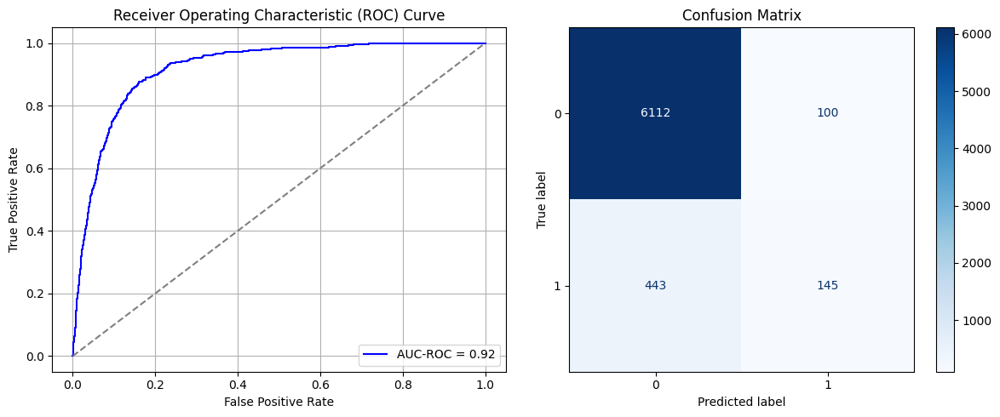

Best threshold based on F1-score: 0.740402340888977
False Negative Rate: 0.7534013605442177
Time elapsed (performance): 1.051612665999528
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.6443 - loss: 0.3963 - val_AUC: 0.8705 - val_loss: 0.2775
Epoch 2/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8640 - loss: 0.2709 - val_AUC: 0.8804 - val_loss: 0.2691
Epoch 3/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8725 - loss: 0.2618 - val_AUC: 0.8828 - val_loss: 0.2591
Epoch 4/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8781 - loss: 0.2571 - val_AUC: 0.8831 - val_loss: 0.2566
Epoch 5/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8776 - loss: 0.2493 - val_AUC: 0.8865 - val_loss: 0.2548
Epoch 6/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8850 - loss: 0.2499 - val_AUC: 0.8879 - val_loss: 0.2540
Epoch 7/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8908 - loss: 0.2464 - val_AUC: 0.8866 - val_loss: 0.2548
Epoch 8/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8896 - loss: 0.2449 - val_AUC: 0.8898 - val_loss: 0.2509
Epoch 9/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8971 -

<ipython-input-76-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
AUC-ROC: 0.9157492520511102
Classification Report:
              precision    recall  f1-score   support

           0       0.93      0.98      0.96      6212
           1       0.58      0.23      0.33       588

    accuracy                           0.92      6800
   macro avg       0.76      0.61      0.64      6800
weighted avg       0.90      0.92      0.90      6800

FPR 0.01593689632968448 TPR: 0.23299319727891155 FNR: 0.7670068027210885 TNR: 0.9840631036703156


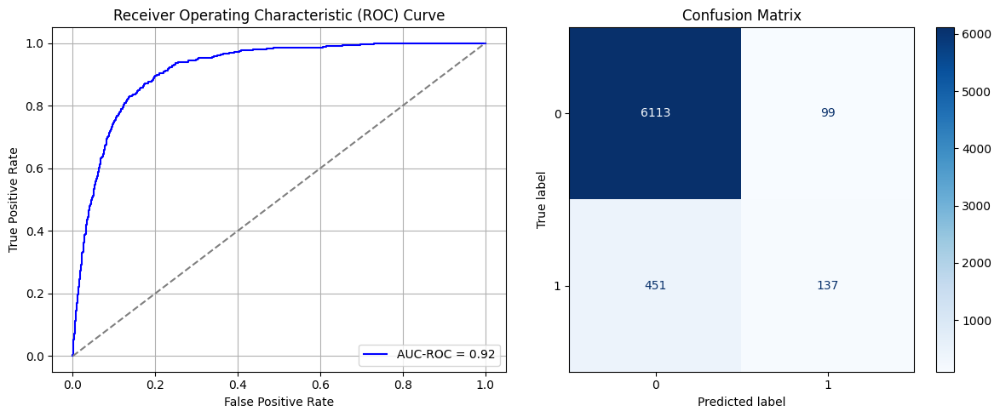

Best threshold based on F1-score: 0.1684115082025528
False Negative Rate: 0.7670068027210885
Time elapsed (performance): 1.0541744459997062
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


728/728 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.6488 - loss: 0.3710 - val_AUC: 0.8687 - val_loss: 0.2786
Epoch 2/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8726 - loss: 0.2629 - val_AUC: 0.8794 - val_loss: 0.2622
Epoch 3/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8757 - loss: 0.2545 - val_AUC: 0.8823 - val_loss: 0.2592
Epoch 4/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8779 - loss: 0.2519 - val_AUC: 0.8836 - val_loss: 0.2581
Epoch 5/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8879 - loss: 0.2451 - val_AUC: 0.8860 - val_loss: 0.2553
Epoch 6/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8849 - loss: 0.2487 - val_AUC: 0.8867 - val_loss: 0.2599
Epoch 7/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8919 - loss: 0.2419 - val_AUC: 0.8901 - val_loss: 0.2512
Epoch 8/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8877 - loss: 0.2449 - val_AUC: 0.8879 - val_loss: 0.2534
Epoch 9/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8914 -

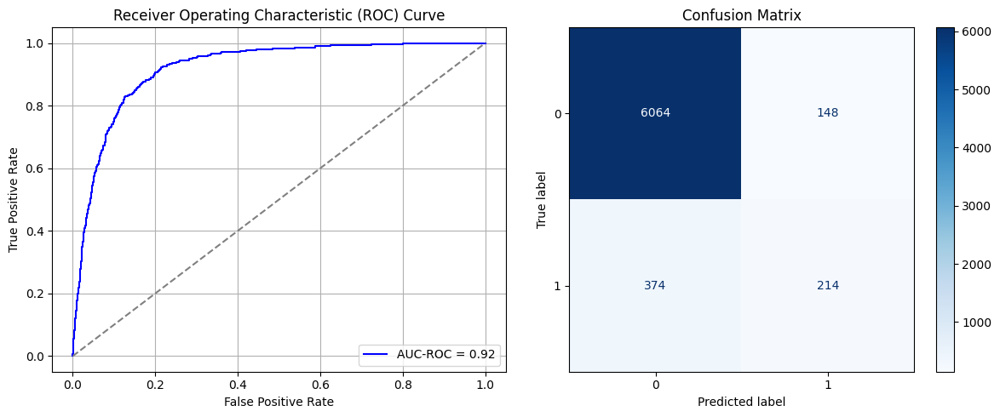

Best threshold based on F1-score: 0.20101068913936615
False Negative Rate: 0.6360544217687075
Time elapsed (performance): 1.048432712000249
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.6473 - loss: 0.3719 - val_AUC: 0.8671 - val_loss: 0.2781
Epoch 2/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8672 - loss: 0.2652 - val_AUC: 0.8800 - val_loss: 0.2753
Epoch 3/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8773 - loss: 0.2503 - val_AUC: 0.8824 - val_loss: 0.2576
Epoch 4/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8793 - loss: 0.2522 - val_AUC: 0.8855 - val_loss: 0.2563
Epoch 5/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8905 - loss: 0.2441 - val_AUC: 0.8881 - val_loss: 0.2537
Epoch 6/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8847 - loss: 0.2438 - val_AUC: 0.8909 - val_loss: 0.2501
Epoch 7/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8939 - loss: 0.2385 - val_AUC: 0.8912 - val_loss: 0.2502
Epoch 8/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8917 - loss: 0.2457 - val_AUC: 0.8918 - val_loss: 0.2531
Epoch 9/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8923 -

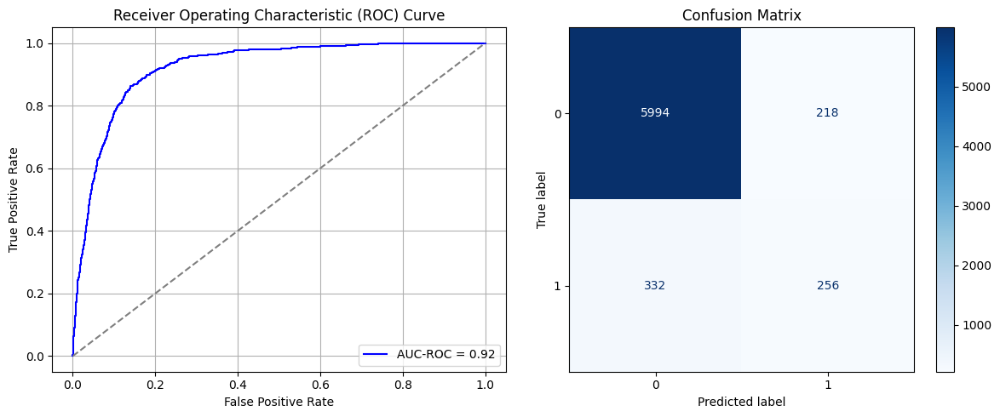

Best threshold based on F1-score: 0.38426268100738525
False Negative Rate: 0.564625850340136
Time elapsed (performance): 1.0361685600000783
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.6421 - loss: 0.4002 - val_AUC: 0.8660 - val_loss: 0.2813
Epoch 2/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8619 - loss: 0.2654 - val_AUC: 0.8805 - val_loss: 0.2623
Epoch 3/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8731 - loss: 0.2603 - val_AUC: 0.8801 - val_loss: 0.2626
Epoch 4/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8816 - loss: 0.2500 - val_AUC: 0.8863 - val_loss: 0.2554
Epoch 5/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8806 - loss: 0.2501 - val_AUC: 0.8852 - val_loss: 0.2578
Epoch 6/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8846 - loss: 0.2456 - val_AUC: 0.8877 - val_loss: 0.2533
Epoch 7/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8851 - loss: 0.2461 - val_AUC: 0.8898 - val_loss: 0.2516
Epoch 8/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8867 - loss: 0.2469 - val_AUC: 0.8899 - val_loss: 0.2532
Epoch 9/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8894 -

<ipython-input-76-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
AUC-ROC: 0.9151606392718066
Classification Report:
              precision    recall  f1-score   support

           0       0.94      0.97      0.96      6212
           1       0.57      0.38      0.46       588

    accuracy                           0.92      6800
   macro avg       0.76      0.68      0.71      6800
weighted avg       0.91      0.92      0.91      6800

FPR 0.027366387636831937 TPR: 0.38265306122448983 FNR: 0.6173469387755102 TNR: 0.972633612363168


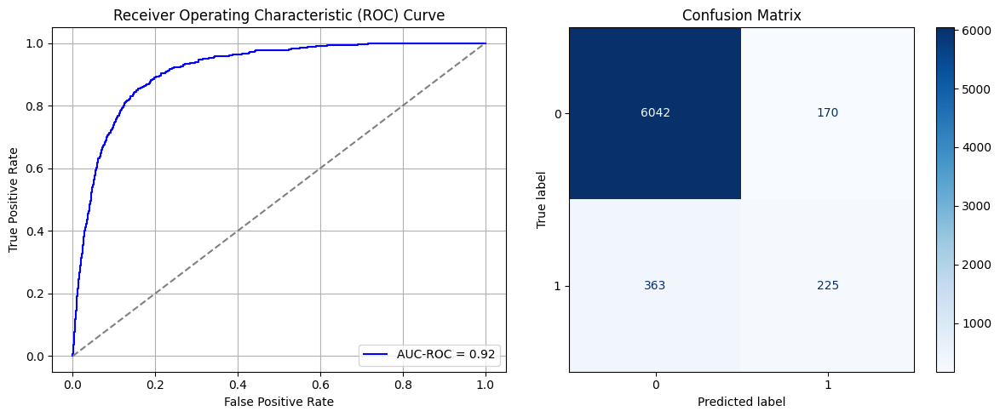

Best threshold based on F1-score: 0.35249629616737366
False Negative Rate: 0.6173469387755102
Time elapsed (performance): 1.0533195990001332
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.6551 - loss: 0.3644 - val_AUC: 0.8649 - val_loss: 0.2789
Epoch 2/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8645 - loss: 0.2668 - val_AUC: 0.8760 - val_loss: 0.2710
Epoch 3/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8800 - loss: 0.2524 - val_AUC: 0.8863 - val_loss: 0.2560
Epoch 4/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8861 - loss: 0.2434 - val_AUC: 0.8858 - val_loss: 0.2659
Epoch 5/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8887 - loss: 0.2422 - val_AUC: 0.8880 - val_loss: 0.2564
Epoch 6/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8915 - loss: 0.2400 - val_AUC: 0.8888 - val_loss: 0.2515
Epoch 7/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8930 - loss: 0.2432 - val_AUC: 0.8911 - val_loss: 0.2498
Epoch 8/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8876 - loss: 0.2453 - val_AUC: 0.8889 - val_loss: 0.2519
Epoch 9/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8892 -

<ipython-input-76-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
AUC-ROC: 0.9227917986254386
Classification Report:
              precision    recall  f1-score   support

           0       0.95      0.97      0.96      6212
           1       0.57      0.42      0.48       588

    accuracy                           0.92      6800
   macro avg       0.76      0.69      0.72      6800
weighted avg       0.91      0.92      0.92      6800

FPR 0.02994204764971024 TPR: 0.41666666666666663 FNR: 0.5833333333333334 TNR: 0.9700579523502898


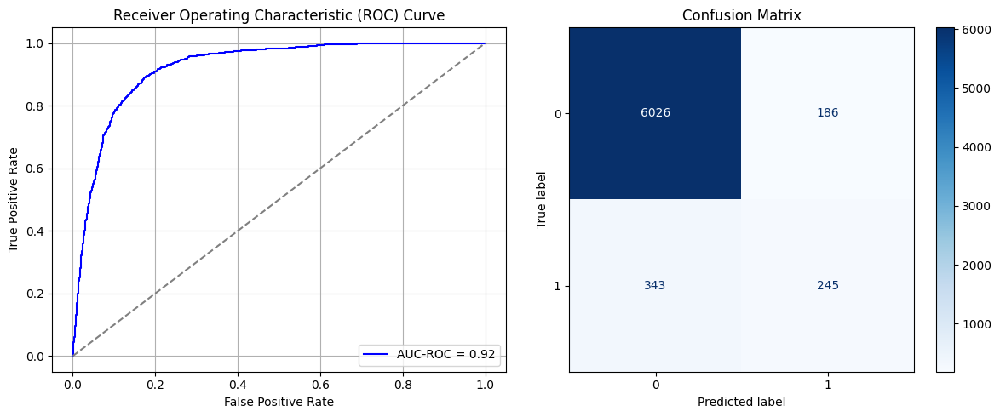

Best threshold based on F1-score: 0.2708874046802521
False Negative Rate: 0.5833333333333334
Time elapsed (performance): 1.9054101159999846
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


728/728 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - AUC: 0.6626 - loss: 0.3631 - val_AUC: 0.8630 - val_loss: 0.2827
Epoch 2/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8648 - loss: 0.2659 - val_AUC: 0.8743 - val_loss: 0.2702
Epoch 3/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8715 - loss: 0.2612 - val_AUC: 0.8819 - val_loss: 0.2587
Epoch 4/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - AUC: 0.8770 - loss: 0.2511 - val_AUC: 0.8837 - val_loss: 0.2564
Epoch 5/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8840 - loss: 0.2493 - val_AUC: 0.8843 - val_loss: 0.2563
Epoch 6/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8799 - loss: 0.2530 - val_AUC: 0.8855 - val_loss: 0.2634
Epoch 7/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8849 - loss: 0.2436 - val_AUC: 0.8881 - val_loss: 0.2550
Epoch 8/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8896 - loss: 0.2410 - val_AUC: 0.8918 - val_loss: 0.2494
Epoch 9/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8914 -

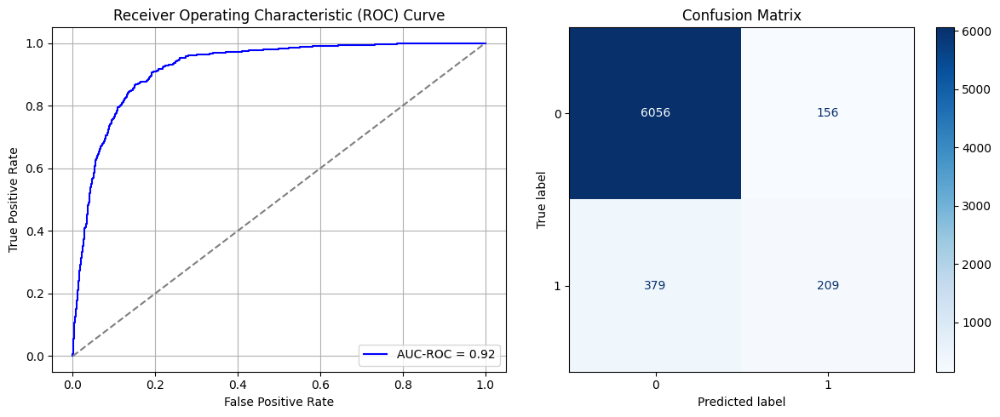

Best threshold based on F1-score: 0.3049010932445526
False Negative Rate: 0.6445578231292517
Time elapsed (performance): 0.9202922539998326
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


728/728 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.6780 - loss: 0.3480 - val_AUC: 0.8706 - val_loss: 0.2759
Epoch 2/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - AUC: 0.8744 - loss: 0.2604 - val_AUC: 0.8821 - val_loss: 0.2602
Epoch 3/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8819 - loss: 0.2507 - val_AUC: 0.8863 - val_loss: 0.2564
Epoch 4/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8822 - loss: 0.2473 - val_AUC: 0.8878 - val_loss: 0.2540
Epoch 5/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8902 - loss: 0.2409 - val_AUC: 0.8863 - val_loss: 0.2549
Epoch 6/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8905 - loss: 0.2385 - val_AUC: 0.8872 - val_loss: 0.2603
Epoch 7/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8894 - loss: 0.2405 - val_AUC: 0.8909 - val_loss: 0.2523
Epoch 8/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8920 - loss: 0.2400 - val_AUC: 0.8956 - val_loss: 0.2558
Epoch 9/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8947 -

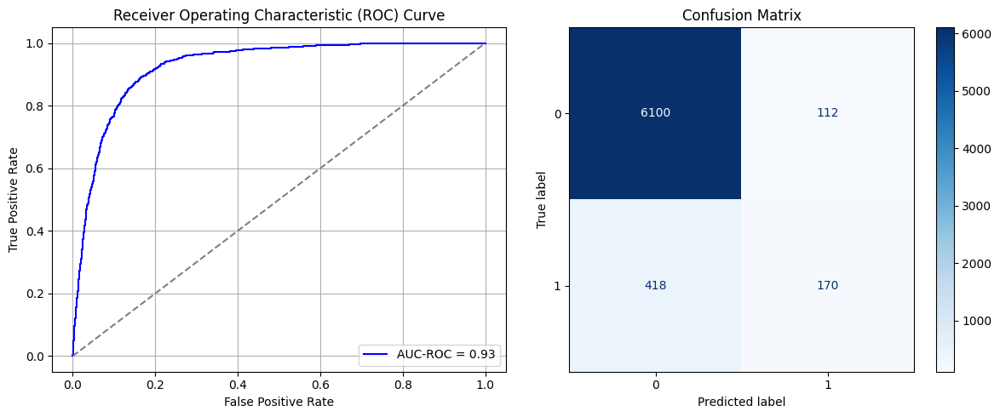

Best threshold based on F1-score: 0.20465554296970367
False Negative Rate: 0.7108843537414966
Time elapsed (performance): 0.9227792279998539
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


728/728 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - AUC: 0.6353 - loss: 0.3911 - val_AUC: 0.8544 - val_loss: 0.2864
Epoch 2/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8659 - loss: 0.2676 - val_AUC: 0.8796 - val_loss: 0.2663
Epoch 3/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8788 - loss: 0.2545 - val_AUC: 0.8825 - val_loss: 0.2607
Epoch 4/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8814 - loss: 0.2491 - val_AUC: 0.8833 - val_loss: 0.2592
Epoch 5/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8818 - loss: 0.2516 - val_AUC: 0.8852 - val_loss: 0.2582
Epoch 6/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8846 - loss: 0.2461 - val_AUC: 0.8852 - val_loss: 0.2558
Epoch 7/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8867 - loss: 0.2433 - val_AUC: 0.8845 - val_loss: 0.2562
Epoch 8/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8868 - loss: 0.2476 - val_AUC: 0.8863 - val_loss: 0.2549
Epoch 9/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8847 -

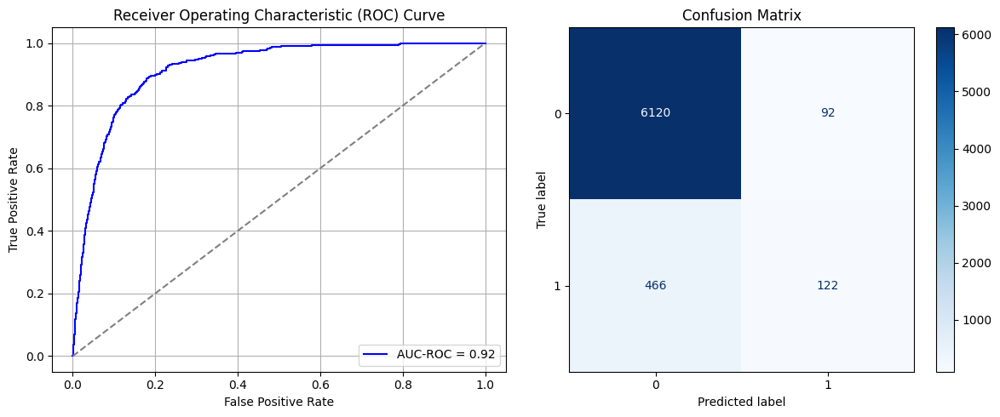

Best threshold based on F1-score: 0.7411230206489563
False Negative Rate: 0.7925170068027211
Time elapsed (performance): 1.728386629999477
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


728/728 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - AUC: 0.6417 - loss: 0.3857 - val_AUC: 0.8694 - val_loss: 0.2809
Epoch 2/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8636 - loss: 0.2709 - val_AUC: 0.8787 - val_loss: 0.2631
Epoch 3/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8737 - loss: 0.2596 - val_AUC: 0.8827 - val_loss: 0.2644
Epoch 4/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8799 - loss: 0.2525 - val_AUC: 0.8823 - val_loss: 0.2620
Epoch 5/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8803 - loss: 0.2538 - val_AUC: 0.8844 - val_loss: 0.2558
Epoch 6/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8851 - loss: 0.2512 - val_AUC: 0.8864 - val_loss: 0.2621
Epoch 7/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8899 - loss: 0.2431 - val_AUC: 0.8863 - val_loss: 0.2589
Epoch 8/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8928 - loss: 0.2426 - val_AUC: 0.8883 - val_loss: 0.2520
Epoch 9/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8905 -

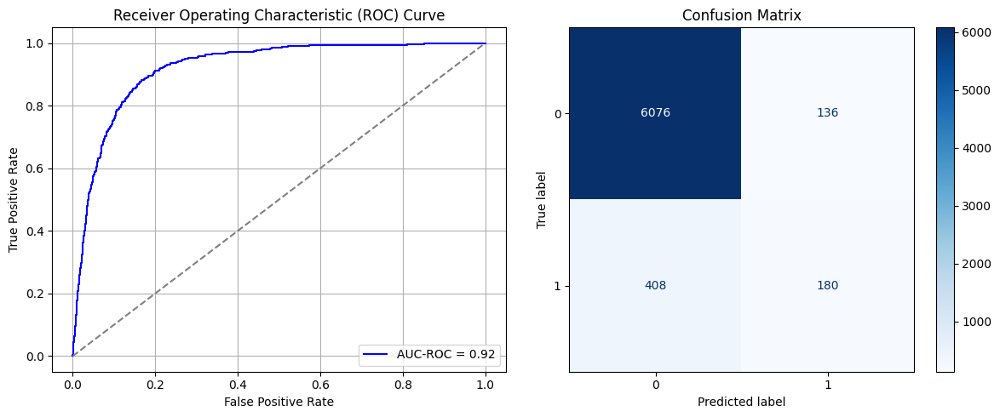

Best threshold based on F1-score: 0.23983901739120483
False Negative Rate: 0.6938775510204082
Time elapsed (performance): 1.0482402130000992
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.6459 - loss: 0.3721 - val_AUC: 0.8669 - val_loss: 0.2782
Epoch 2/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8663 - loss: 0.2655 - val_AUC: 0.8810 - val_loss: 0.2608
Epoch 3/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8796 - loss: 0.2537 - val_AUC: 0.8804 - val_loss: 0.2603
Epoch 4/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8827 - loss: 0.2521 - val_AUC: 0.8838 - val_loss: 0.2577
Epoch 5/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8869 - loss: 0.2445 - val_AUC: 0.8850 - val_loss: 0.2558
Epoch 6/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8838 - loss: 0.2458 - val_AUC: 0.8862 - val_loss: 0.2556
Epoch 7/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8881 - loss: 0.2431 - val_AUC: 0.8871 - val_loss: 0.2538
Epoch 8/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8885 - loss: 0.2466 - val_AUC: 0.8880 - val_loss: 0.2556
Epoch 9/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8912 -

<ipython-input-76-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
AUC-ROC: 0.9240445856385054
Classification Report:
              precision    recall  f1-score   support

           0       0.95      0.97      0.96      6212
           1       0.56      0.47      0.51       588

    accuracy                           0.92      6800
   macro avg       0.76      0.72      0.73      6800
weighted avg       0.92      0.92      0.92      6800

FPR 0.03461043142305216 TPR: 0.467687074829932 FNR: 0.532312925170068 TNR: 0.9653895685769478


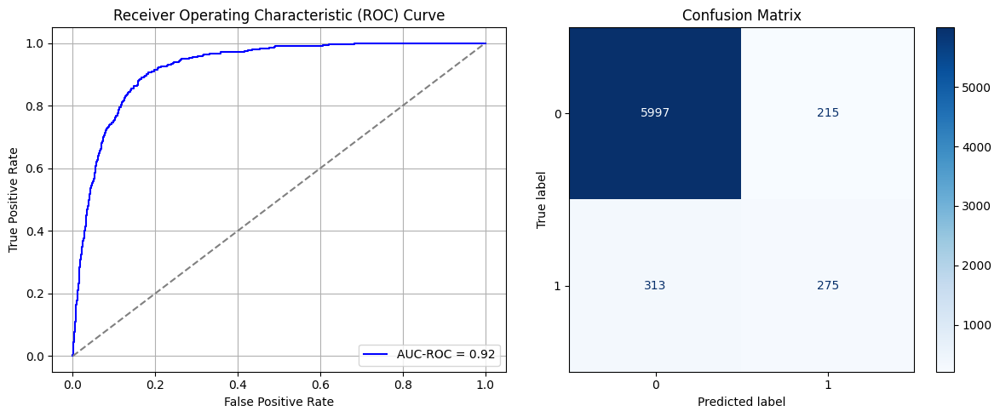

Best threshold based on F1-score: 0.3187078535556793
False Negative Rate: 0.532312925170068
Time elapsed (performance): 0.9470698699997229
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.6596 - loss: 0.3738 - val_AUC: 0.8621 - val_loss: 0.2774
Epoch 2/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8617 - loss: 0.2682 - val_AUC: 0.8792 - val_loss: 0.2648
Epoch 3/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8766 - loss: 0.2576 - val_AUC: 0.8817 - val_loss: 0.2746
Epoch 4/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8810 - loss: 0.2533 - val_AUC: 0.8830 - val_loss: 0.2596
Epoch 5/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8806 - loss: 0.2515 - val_AUC: 0.8849 - val_loss: 0.2561
Epoch 6/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8892 - loss: 0.2473 - val_AUC: 0.8868 - val_loss: 0.2540
Epoch 7/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8924 - loss: 0.2403 - val_AUC: 0.8914 - val_loss: 0.2508
Epoch 8/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8897 - loss: 0.2374 - val_AUC: 0.8929 - val_loss: 0.2487
Epoch 9/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8937 -

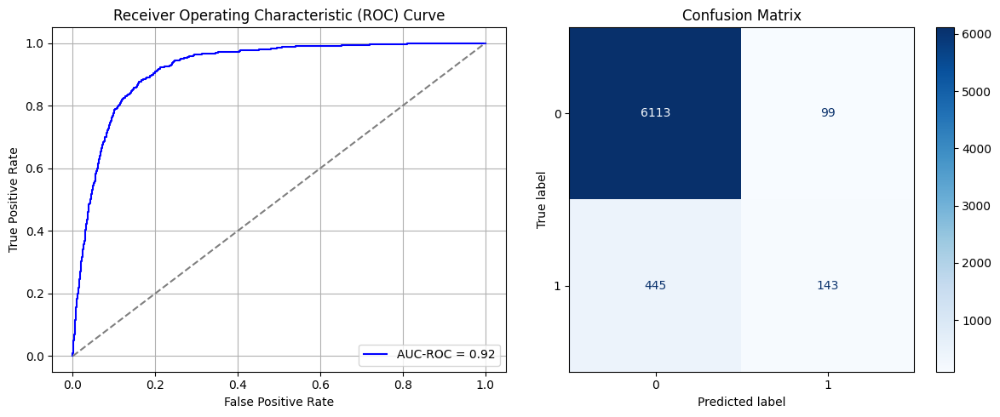

Best threshold based on F1-score: 0.19612529873847961
False Negative Rate: 0.7568027210884354
Time elapsed (performance): 1.7498287510006776
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.6715 - loss: 0.3626 - val_AUC: 0.8680 - val_loss: 0.2817
Epoch 2/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8727 - loss: 0.2576 - val_AUC: 0.8798 - val_loss: 0.2612
Epoch 3/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8788 - loss: 0.2528 - val_AUC: 0.8824 - val_loss: 0.2639
Epoch 4/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8745 - loss: 0.2581 - val_AUC: 0.8819 - val_loss: 0.2592
Epoch 5/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8895 - loss: 0.2395 - val_AUC: 0.8833 - val_loss: 0.2587
Epoch 6/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8910 - loss: 0.2417 - val_AUC: 0.8861 - val_loss: 0.2539
Epoch 7/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8874 - loss: 0.2397 - val_AUC: 0.8868 - val_loss: 0.2539
Epoch 8/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8945 - loss: 0.2382 - val_AUC: 0.8878 - val_loss: 0.2531
Epoch 9/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8876 -

<ipython-input-76-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
AUC-ROC: 0.922353213661511
Classification Report:
              precision    recall  f1-score   support

           0       0.94      0.98      0.96      6212
           1       0.58      0.28      0.38       588

    accuracy                           0.92      6800
   macro avg       0.76      0.63      0.67      6800
weighted avg       0.90      0.92      0.91      6800

FPR 0.019478428847392145 TPR: 0.2840136054421769 FNR: 0.7159863945578231 TNR: 0.9805215711526079


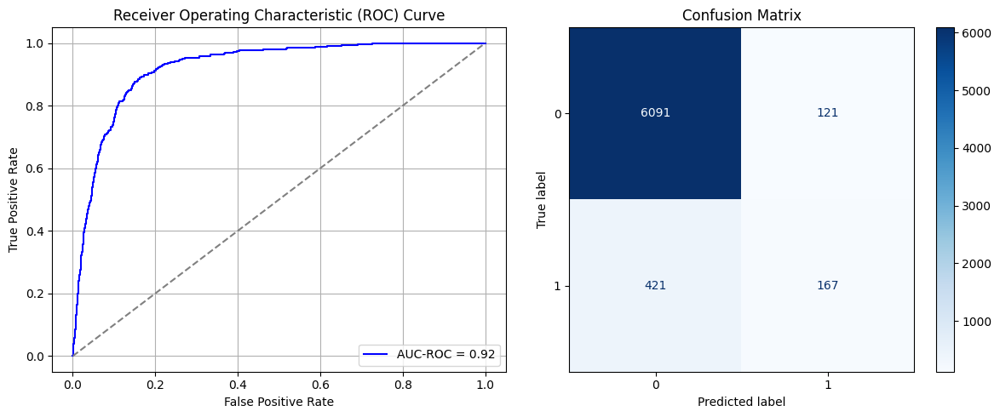

Best threshold based on F1-score: 0.7636622786521912
False Negative Rate: 0.7159863945578231
Time elapsed (performance): 1.079833083000267
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.6433 - loss: 0.3824 - val_AUC: 0.8736 - val_loss: 0.2759
Epoch 2/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8637 - loss: 0.2671 - val_AUC: 0.8790 - val_loss: 0.2625
Epoch 3/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8829 - loss: 0.2475 - val_AUC: 0.8798 - val_loss: 0.2625
Epoch 4/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8852 - loss: 0.2450 - val_AUC: 0.8797 - val_loss: 0.2624
Epoch 5/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8836 - loss: 0.2486 - val_AUC: 0.8835 - val_loss: 0.2659
Epoch 6/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8852 - loss: 0.2478 - val_AUC: 0.8843 - val_loss: 0.2561
Epoch 7/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8874 - loss: 0.2419 - val_AUC: 0.8859 - val_loss: 0.2621
Epoch 8/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8874 - loss: 0.2483 - val_AUC: 0.8889 - val_loss: 0.2540
Epoch 9/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8926 -

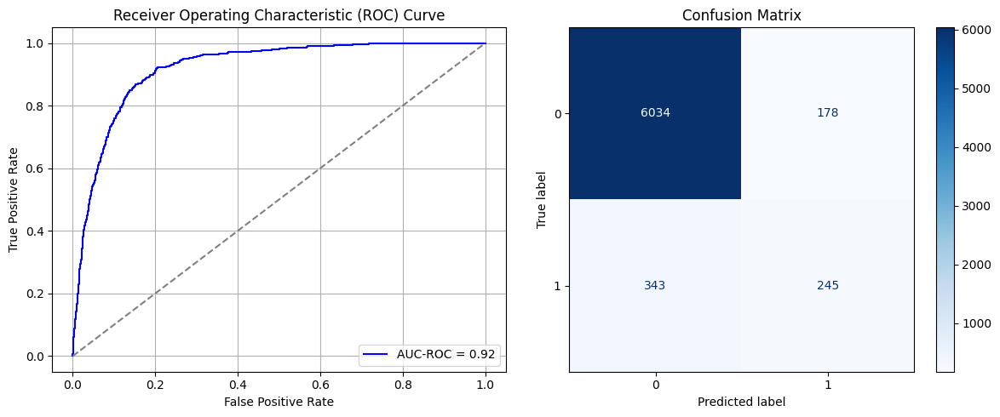

Best threshold based on F1-score: 0.23569275438785553
False Negative Rate: 0.5833333333333334
Time elapsed (performance): 1.1977260459998433
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


728/728 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.6517 - loss: 0.3835 - val_AUC: 0.8655 - val_loss: 0.2838
Epoch 2/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8555 - loss: 0.2745 - val_AUC: 0.8805 - val_loss: 0.2639
Epoch 3/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8776 - loss: 0.2505 - val_AUC: 0.8838 - val_loss: 0.2586
Epoch 4/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - AUC: 0.8764 - loss: 0.2510 - val_AUC: 0.8845 - val_loss: 0.2731
Epoch 5/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8844 - loss: 0.2471 - val_AUC: 0.8858 - val_loss: 0.2617
Epoch 6/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8877 - loss: 0.2485 - val_AUC: 0.8892 - val_loss: 0.2585
Epoch 7/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8874 - loss: 0.2476 - val_AUC: 0.8888 - val_loss: 0.2525
Epoch 8/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8930 - loss: 0.2413 - val_AUC: 0.8925 - val_loss: 0.2500
Epoch 9/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8935 -

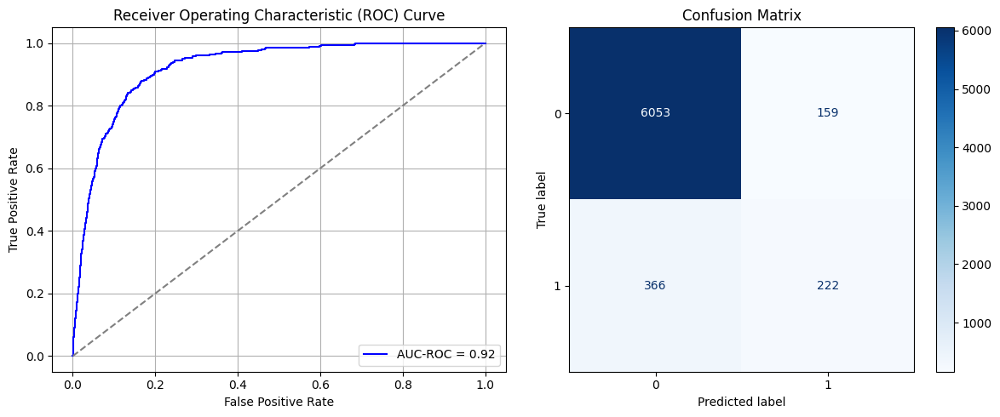

Best threshold based on F1-score: 0.8687293529510498
False Negative Rate: 0.6224489795918368
Time elapsed (performance): 0.9017265630000111
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


728/728 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - AUC: 0.6443 - loss: 0.3642 - val_AUC: 0.8664 - val_loss: 0.2837
Epoch 2/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8640 - loss: 0.2634 - val_AUC: 0.8807 - val_loss: 0.2624
Epoch 3/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8781 - loss: 0.2556 - val_AUC: 0.8842 - val_loss: 0.2565
Epoch 4/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8796 - loss: 0.2489 - val_AUC: 0.8795 - val_loss: 0.2627
Epoch 5/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - AUC: 0.8802 - loss: 0.2490 - val_AUC: 0.8853 - val_loss: 0.2579
Epoch 6/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8847 - loss: 0.2458 - val_AUC: 0.8862 - val_loss: 0.2660
Epoch 7/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8853 - loss: 0.2467 - val_AUC: 0.8881 - val_loss: 0.2561
Epoch 8/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8903 - loss: 0.2414 - val_AUC: 0.8878 - val_loss: 0.2538
Epoch 9/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8902 -

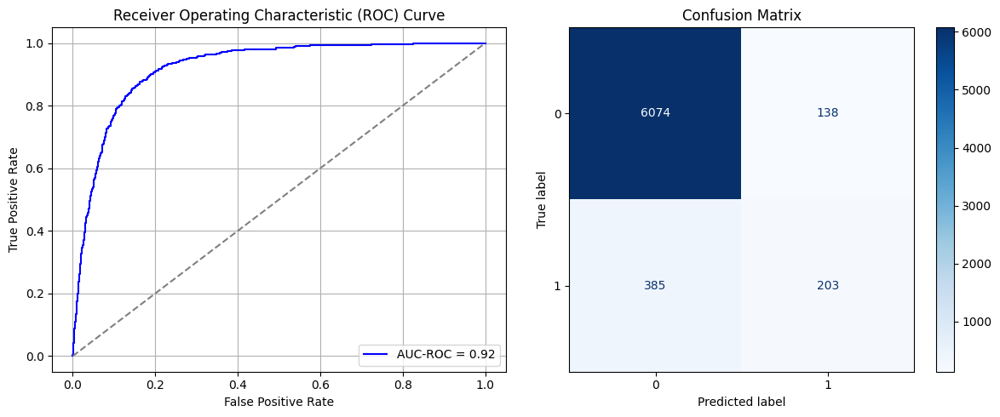

Best threshold based on F1-score: 0.21716156601905823
False Negative Rate: 0.6547619047619048
Time elapsed (performance): 1.1321390940001947
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


728/728 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.6623 - loss: 0.3675 - val_AUC: 0.8691 - val_loss: 0.2811
Epoch 2/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8636 - loss: 0.2636 - val_AUC: 0.8800 - val_loss: 0.2626
Epoch 3/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8789 - loss: 0.2505 - val_AUC: 0.8862 - val_loss: 0.2567
Epoch 4/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8905 - loss: 0.2411 - val_AUC: 0.8858 - val_loss: 0.2582
Epoch 5/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8885 - loss: 0.2462 - val_AUC: 0.8893 - val_loss: 0.2520
Epoch 6/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8893 - loss: 0.2430 - val_AUC: 0.8915 - val_loss: 0.2659
Epoch 7/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8913 - loss: 0.2427 - val_AUC: 0.8916 - val_loss: 0.2532
Epoch 8/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8950 - loss: 0.2375 - val_AUC: 0.8946 - val_loss: 0.2471
Epoch 9/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - AUC: 0.8980 -

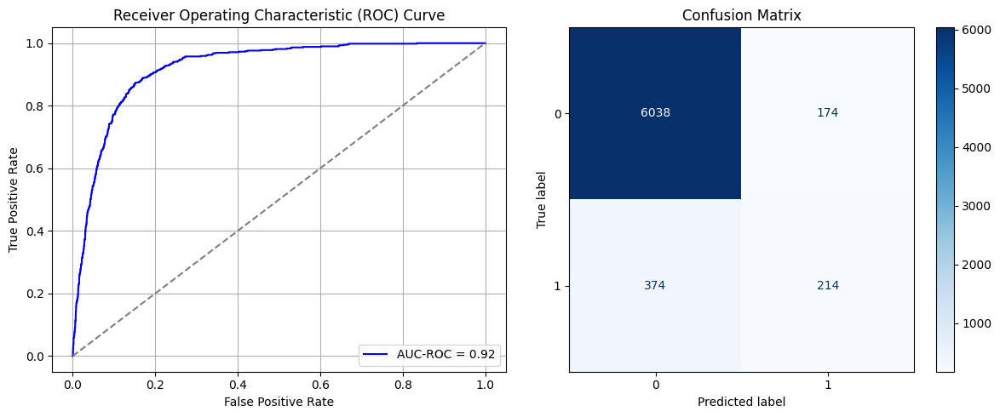

Best threshold based on F1-score: 0.7778947353363037
False Negative Rate: 0.6360544217687075
Time elapsed (performance): 1.0912991529994542
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


728/728 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - AUC: 0.6653 - loss: 0.3702 - val_AUC: 0.8702 - val_loss: 0.2731
Epoch 2/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8717 - loss: 0.2634 - val_AUC: 0.8749 - val_loss: 0.2653
Epoch 3/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8749 - loss: 0.2558 - val_AUC: 0.8820 - val_loss: 0.2586
Epoch 4/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8817 - loss: 0.2514 - val_AUC: 0.8844 - val_loss: 0.2566
Epoch 5/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - AUC: 0.8822 - loss: 0.2516 - val_AUC: 0.8860 - val_loss: 0.2601
Epoch 6/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8849 - loss: 0.2448 - val_AUC: 0.8883 - val_loss: 0.2533
Epoch 7/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8884 - loss: 0.2418 - val_AUC: 0.8875 - val_loss: 0.2542
Epoch 8/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8935 - loss: 0.2418 - val_AUC: 0.8903 - val_loss: 0.2517
Epoch 9/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8912 -

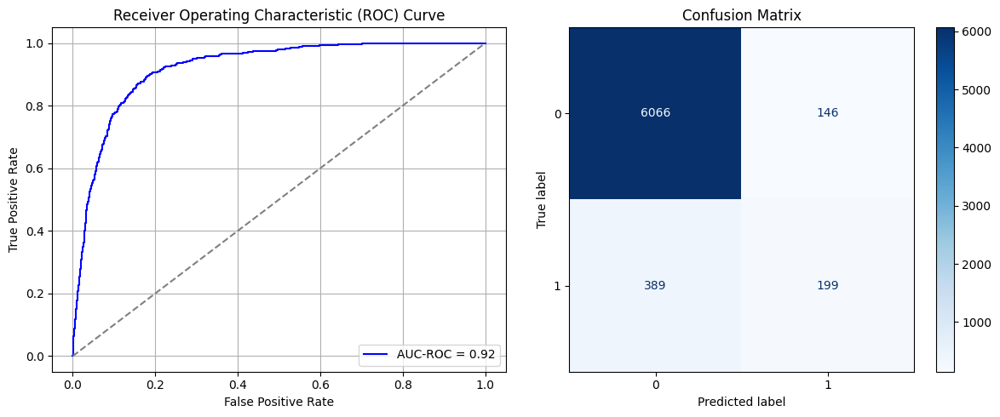

Best threshold based on F1-score: 0.7927728295326233
False Negative Rate: 0.6615646258503401
Time elapsed (performance): 0.962576990999878
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


728/728 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.6638 - loss: 0.3704 - val_AUC: 0.8654 - val_loss: 0.2802
Epoch 2/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8640 - loss: 0.2675 - val_AUC: 0.8796 - val_loss: 0.2624
Epoch 3/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - AUC: 0.8752 - loss: 0.2567 - val_AUC: 0.8816 - val_loss: 0.2605
Epoch 4/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8791 - loss: 0.2503 - val_AUC: 0.8808 - val_loss: 0.2629
Epoch 5/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8827 - loss: 0.2495 - val_AUC: 0.8834 - val_loss: 0.2615
Epoch 6/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8828 - loss: 0.2482 - val_AUC: 0.8834 - val_loss: 0.2603
Epoch 7/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8886 - loss: 0.2448 - val_AUC: 0.8899 - val_loss: 0.2516
Epoch 8/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8925 - loss: 0.2393 - val_AUC: 0.8937 - val_loss: 0.2478
Epoch 9/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8977 -

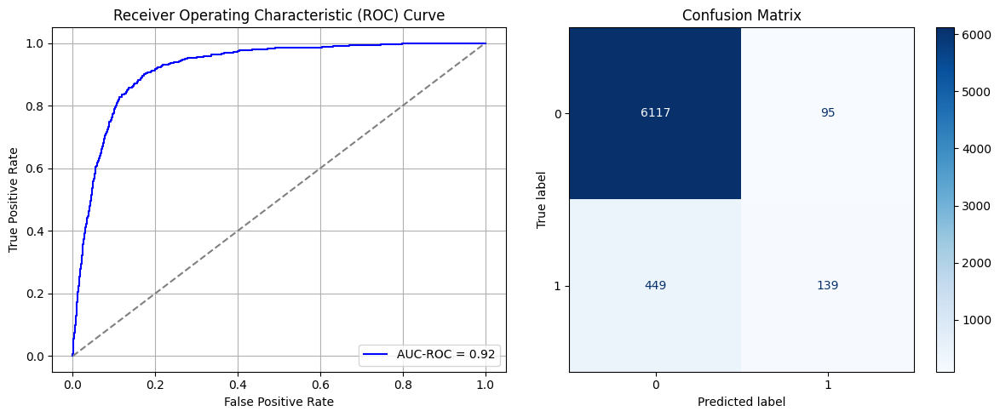

Best threshold based on F1-score: 0.14936181902885437
False Negative Rate: 0.7636054421768708
Time elapsed (performance): 1.0925813399999242
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


728/728 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.6385 - loss: 0.3898 - val_AUC: 0.8652 - val_loss: 0.2866
Epoch 2/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8601 - loss: 0.2682 - val_AUC: 0.8777 - val_loss: 0.2637
Epoch 3/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8784 - loss: 0.2499 - val_AUC: 0.8813 - val_loss: 0.2645
Epoch 4/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8780 - loss: 0.2508 - val_AUC: 0.8831 - val_loss: 0.2581
Epoch 5/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8827 - loss: 0.2494 - val_AUC: 0.8871 - val_loss: 0.2541
Epoch 6/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8884 - loss: 0.2493 - val_AUC: 0.8890 - val_loss: 0.2631
Epoch 7/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8901 - loss: 0.2417 - val_AUC: 0.8888 - val_loss: 0.2529
Epoch 8/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - AUC: 0.8934 - loss: 0.2401 - val_AUC: 0.8924 - val_loss: 0.2495
Epoch 9/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8904 -

<ipython-input-76-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
AUC-ROC: 0.9199527686154954
Classification Report:
              precision    recall  f1-score   support

           0       0.93      0.99      0.96      6212
           1       0.61      0.21      0.31       588

    accuracy                           0.92      6800
   macro avg       0.77      0.60      0.63      6800
weighted avg       0.90      0.92      0.90      6800

FPR 0.0128783000643915 TPR: 0.2091836734693877 FNR: 0.7908163265306123 TNR: 0.9871216999356085


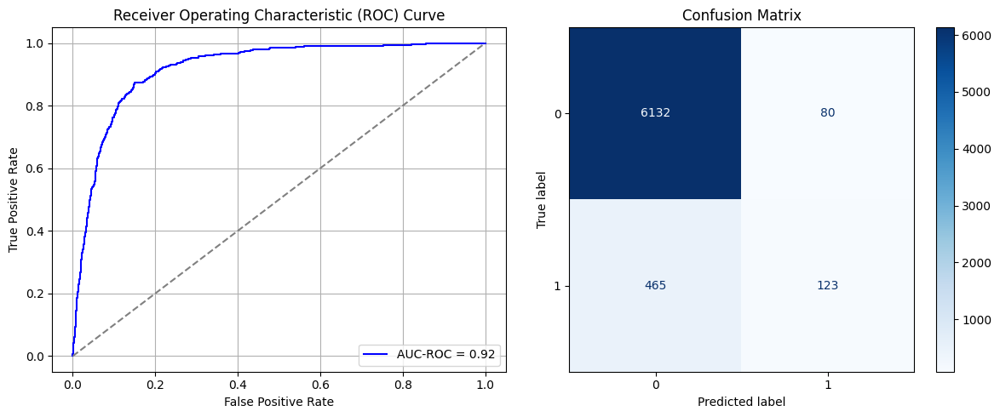

Best threshold based on F1-score: 0.2551555335521698
False Negative Rate: 0.7908163265306123
Time elapsed (performance): 0.9716499539999859
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


728/728 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.6650 - loss: 0.3563 - val_AUC: 0.8715 - val_loss: 0.2795
Epoch 2/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - AUC: 0.8716 - loss: 0.2602 - val_AUC: 0.8798 - val_loss: 0.2631
Epoch 3/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8832 - loss: 0.2497 - val_AUC: 0.8845 - val_loss: 0.2581
Epoch 4/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8805 - loss: 0.2524 - val_AUC: 0.8831 - val_loss: 0.2593
Epoch 5/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - AUC: 0.8846 - loss: 0.2494 - val_AUC: 0.8833 - val_loss: 0.2701
Epoch 6/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8796 - loss: 0.2526 - val_AUC: 0.8856 - val_loss: 0.2674
Epoch 7/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8902 - loss: 0.2402 - val_AUC: 0.8908 - val_loss: 0.2512
Epoch 8/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8921 - loss: 0.2467 - val_AUC: 0.8917 - val_loss: 0.2550
Epoch 9/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - AUC: 0.8968 -

<ipython-input-76-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
AUC-ROC: 0.9162087806790457
Classification Report:
              precision    recall  f1-score   support

           0       0.93      0.98      0.96      6212
           1       0.57      0.24      0.33       588

    accuracy                           0.92      6800
   macro avg       0.75      0.61      0.64      6800
weighted avg       0.90      0.92      0.90      6800

FPR 0.01722472633612363 TPR: 0.23639455782312924 FNR: 0.7636054421768708 TNR: 0.9827752736638764


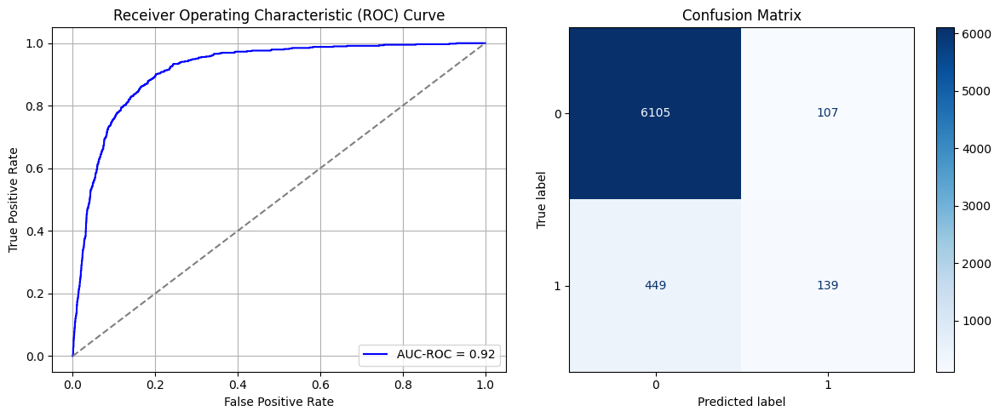

Best threshold based on F1-score: 0.7606868147850037
False Negative Rate: 0.7636054421768708
Time elapsed (performance): 1.12603370800025
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


728/728 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - AUC: 0.6692 - loss: 0.3640 - val_AUC: 0.8721 - val_loss: 0.2765
Epoch 2/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8675 - loss: 0.2666 - val_AUC: 0.8776 - val_loss: 0.2642
Epoch 3/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8739 - loss: 0.2525 - val_AUC: 0.8819 - val_loss: 0.2588
Epoch 4/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8806 - loss: 0.2493 - val_AUC: 0.8828 - val_loss: 0.2611
Epoch 5/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - AUC: 0.8847 - loss: 0.2494 - val_AUC: 0.8846 - val_loss: 0.2613
Epoch 6/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8800 - loss: 0.2515 - val_AUC: 0.8867 - val_loss: 0.2629
Epoch 7/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - AUC: 0.8917 - loss: 0.2440 - val_AUC: 0.8890 - val_loss: 0.2543
Epoch 8/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8856 - loss: 0.2443 - val_AUC: 0.8884 - val_loss: 0.2517
Epoch 9/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8939 -

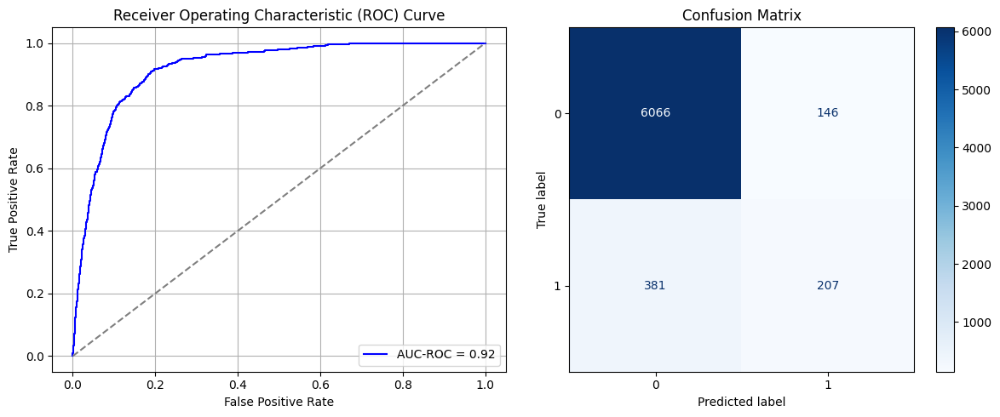

Best threshold based on F1-score: 0.23668143153190613
False Negative Rate: 0.6479591836734694
Time elapsed (performance): 1.274469054000292
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


728/728 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.6685 - loss: 0.3599 - val_AUC: 0.8691 - val_loss: 0.2732
Epoch 2/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8710 - loss: 0.2576 - val_AUC: 0.8809 - val_loss: 0.2643
Epoch 3/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8788 - loss: 0.2526 - val_AUC: 0.8797 - val_loss: 0.2604
Epoch 4/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8847 - loss: 0.2482 - val_AUC: 0.8785 - val_loss: 0.2802
Epoch 5/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8859 - loss: 0.2466 - val_AUC: 0.8843 - val_loss: 0.2569
Epoch 6/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8828 - loss: 0.2473 - val_AUC: 0.8857 - val_loss: 0.2563
Epoch 7/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8844 - loss: 0.2463 - val_AUC: 0.8862 - val_loss: 0.2541
Epoch 8/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8838 - loss: 0.2479 - val_AUC: 0.8864 - val_loss: 0.2542
Epoch 9/10
728/728 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - AUC: 0.8891 -

<ipython-input-76-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
AUC-ROC: 0.920562735718885
Classification Report:
              precision    recall  f1-score   support

           0       0.93      0.98      0.96      6212
           1       0.58      0.23      0.33       588

    accuracy                           0.92      6800
   macro avg       0.76      0.61      0.64      6800
weighted avg       0.90      0.92      0.90      6800

FPR 0.015453960077269801 TPR: 0.22619047619047616 FNR: 0.7738095238095238 TNR: 0.9845460399227302


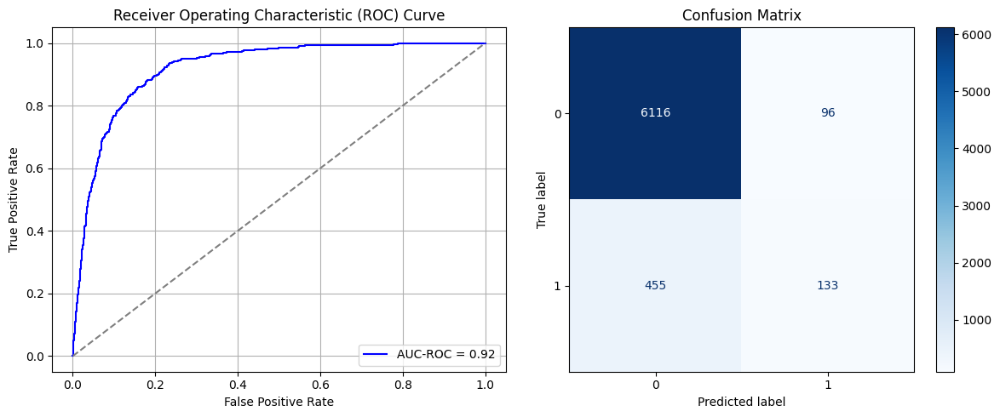

Best threshold based on F1-score: 0.7318742275238037
False Negative Rate: 0.7738095238095238
Time elapsed (performance): 1.066424134999579


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


In [83]:
times = 50

Training_time = []
FPR = []
TPR = []
FNR = []
TNR = []
TL_time = []


for i in range(times):
    X_S_train, X_S_test, y_S_train, y_S_test = train_test_split(X_S_full, y_S_full, test_size=0.20, random_state=0)
    model_source = create_dnn_model(X_S_train.shape[1])
    result_imbalanced = train_and_evaluate(model_source, X_S_train, X_S_test, y_S_train, y_S_test, "Source")
    result_TL_imbalanced = Transductive_TL(model_source, X_T_full, y_T_full, "Target")

    Training_time.append(result_imbalanced)
    FPR.append(result_TL_imbalanced[0])
    TNR.append(result_TL_imbalanced[1])
    FNR.append(result_TL_imbalanced[2])
    TPR.append(result_TL_imbalanced[3])
    TL_time.append(result_TL_imbalanced[4])

ParamFit = pd.DataFrame([Training_time, FPR, TPR, FNR, TNR, TL_time]).T
ParamFit.columns=['Source time', 'FPR', 'TPR', 'FNR', 'TNR', 'Target time']
# print(ParamFit)

In [84]:
print(ParamFit)
ParamFit.to_csv('Imbalanced.csv')

## Remember that TPR is actually TNR and TNR is actually TPR!!!

    Source time       FPR       TPR       FNR       TNR  Target time
0     26.506123  0.026722  0.374150  0.625850  0.973278     0.768120
1     30.963898  0.015615  0.215986  0.784014  0.984385     0.752993
2     28.215100  0.025435  0.380952  0.619048  0.974565     1.218872
3     32.379692  0.022859  0.321429  0.678571  0.977141     0.780778
4     30.922417  0.026722  0.374150  0.625850  0.973278     0.753551
5     28.924978  0.030586  0.404762  0.595238  0.969414     1.220175
6     28.202156  0.014327  0.215986  0.784014  0.985673     0.774145
7     31.741728  0.022698  0.307823  0.692177  0.977302     0.764567
8     31.215696  0.014971  0.217687  0.782313  0.985029     0.788700
9     32.178942  0.023342  0.323129  0.676871  0.976658     1.232379
10    30.544496  0.046040  0.518707  0.481293  0.953960     0.795815
11    29.241668  0.018995  0.295918  0.704082  0.981005     1.042942
12    30.311694  0.016420  0.268707  0.731293  0.983580     1.076840
13    28.920525  0.020766  0.30272

# Random Undersampling (RUS) to balance Dataset:

## SRS Sample without Replacement:

In [85]:
data_S

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,Y
0,0.519481,0.0,0.5,1.0,0.0,0.092259,1.0,0.0,0.0,0.133333,0.363636,0.053070,0.000000,0.000000,0.000000,0.000000,0
1,0.337662,0.1,0.0,0.5,0.0,0.073067,1.0,0.0,0.0,0.133333,0.363636,0.030704,0.000000,0.000000,0.000000,0.000000,0
2,0.194805,0.2,0.5,0.5,0.0,0.072822,1.0,1.0,0.0,0.133333,0.363636,0.015453,0.000000,0.000000,0.000000,0.000000,0
3,0.220779,0.0,0.5,1.0,0.0,0.074901,1.0,0.0,0.0,0.133333,0.363636,0.028264,0.000000,0.000000,0.000000,0.000000,0
4,0.129870,0.0,0.0,1.0,0.0,0.076862,1.0,1.0,0.0,0.133333,0.363636,0.044124,0.000000,0.000000,0.000000,0.000000,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
36388,0.090909,0.1,0.0,0.5,0.0,0.077388,0.0,1.0,0.5,0.533333,0.909091,0.078487,0.017544,0.000000,0.000000,0.000000,1
36389,0.428571,0.1,0.5,1.0,0.0,0.080293,0.0,0.0,0.5,0.533333,0.909091,0.198658,0.035088,0.000000,0.000000,0.000000,1
36390,0.701299,0.4,0.5,0.5,0.0,0.124689,0.0,0.0,0.5,0.533333,0.909091,0.229158,0.070175,0.212156,0.010909,0.666667,1
36391,0.506494,0.3,0.5,0.5,0.0,0.078868,0.0,0.0,1.0,0.533333,0.909091,0.103294,0.052632,0.000000,0.000000,0.000000,0


In [86]:
data_S
data_S_majority = data_S[data_S['Y'].isin([0])]
data_S_minority = data_S[data_S['Y'].isin([1])]

undersample_size = data_S_minority['Y'].size
oversample_size = data_S_majority['Y'].size

print(undersample_size)
print(oversample_size)

4433
31960


Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 6s 9ms/step - AUC: 0.6659 - loss: 0.6586 - val_AUC: 0.7626 - val_loss: 0.5909
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7759 - loss: 0.5763 - val_AUC: 0.8517 - val_loss: 0.5045
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8489 - loss: 0.5023 - val_AUC: 0.8817 - val_loss: 0.4501
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8733 - loss: 0.4564 - val_AUC: 0.8842 - val_loss: 0.4390
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8785 - loss: 0.4424 - val_AUC: 0.8869 - val_loss: 0.4423
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8696 - loss: 0.4605 - val_AUC: 0.8896 - val_loss: 0.4252
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8803 - loss: 0.4408 - val_AUC: 0.8896 - val_loss: 0.4261
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8771 - loss: 0.4478 - val_AUC: 0.8914 - val_loss: 0.4618
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8888 -

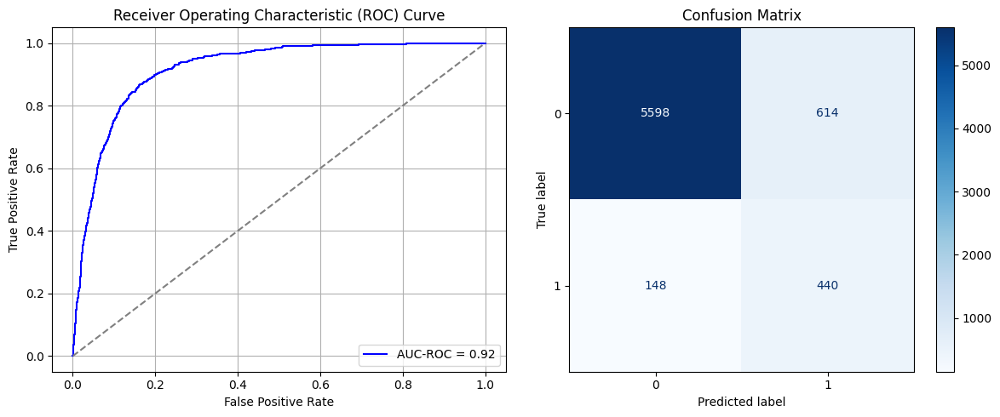

Best threshold based on F1-score: 0.9977640509605408
False Negative Rate: 0.25170068027210885
Time elapsed (performance): 0.764573430999917
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 5s 8ms/step - AUC: 0.6682 - loss: 0.6535 - val_AUC: 0.7758 - val_loss: 0.5841
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.7964 - loss: 0.5591 - val_AUC: 0.8452 - val_loss: 0.5073
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8511 - loss: 0.4934 - val_AUC: 0.8743 - val_loss: 0.4595
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8721 - loss: 0.4562 - val_AUC: 0.8792 - val_loss: 0.4751
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8719 - loss: 0.4520 - val_AUC: 0.8815 - val_loss: 0.4395
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8735 - loss: 0.4521 - val_AUC: 0.8819 - val_loss: 0.4362
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8825 - loss: 0.4340 - val_AUC: 0.8821 - val_loss: 0.4423
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8894 - loss: 0.4251 - val_AUC: 0.8816 - val_loss: 0.4341
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8841 -

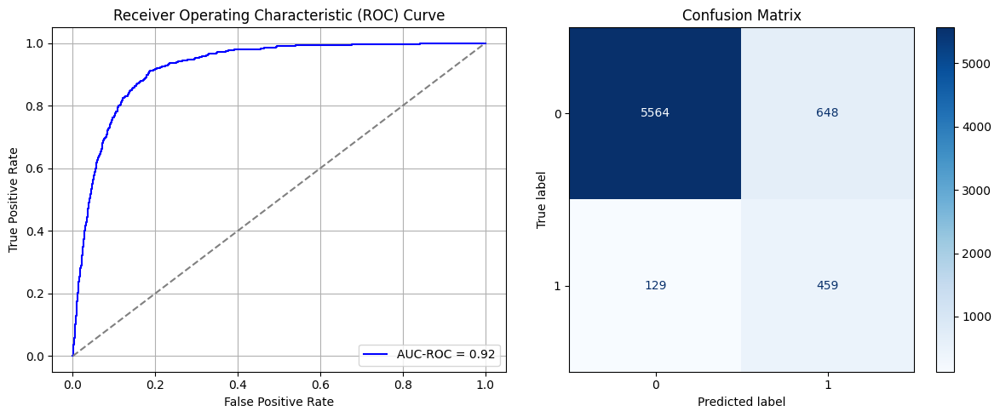

Best threshold based on F1-score: 0.6056663990020752
False Negative Rate: 0.2193877551020408
Time elapsed (performance): 0.9841851150004004
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.6308 - loss: 0.6637 - val_AUC: 0.7626 - val_loss: 0.5868
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7829 - loss: 0.5672 - val_AUC: 0.8578 - val_loss: 0.5038
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8501 - loss: 0.4945 - val_AUC: 0.8731 - val_loss: 0.4657
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8731 - loss: 0.4574 - val_AUC: 0.8738 - val_loss: 0.4608
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8775 - loss: 0.4485 - val_AUC: 0.8807 - val_loss: 0.4638
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8742 - loss: 0.4556 - val_AUC: 0.8781 - val_loss: 0.4570
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8789 - loss: 0.4427 - val_AUC: 0.8778 - val_loss: 0.4534
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8780 - loss: 0.4474 - val_AUC: 0.8791 - val_loss: 0.4484
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8745 -

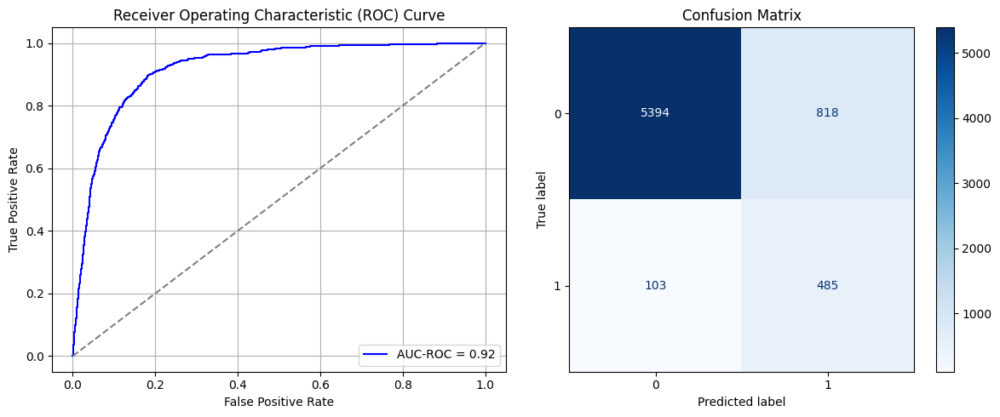

Best threshold based on F1-score: 0.9995802640914917
False Negative Rate: 0.17517006802721088
Time elapsed (performance): 0.7727369869999166
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - AUC: 0.6664 - loss: 0.6541 - val_AUC: 0.7791 - val_loss: 0.5752
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7847 - loss: 0.5643 - val_AUC: 0.8743 - val_loss: 0.4840
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8630 - loss: 0.4794 - val_AUC: 0.8838 - val_loss: 0.4446
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8771 - loss: 0.4485 - val_AUC: 0.8906 - val_loss: 0.4308
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8792 - loss: 0.4433 - val_AUC: 0.8889 - val_loss: 0.4277
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8817 - loss: 0.4362 - val_AUC: 0.8931 - val_loss: 0.4213
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8837 - loss: 0.4320 - val_AUC: 0.8949 - val_loss: 0.4162
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8889 - loss: 0.4234 - val_AUC: 0.8937 - val_loss: 0.4173
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8853 -

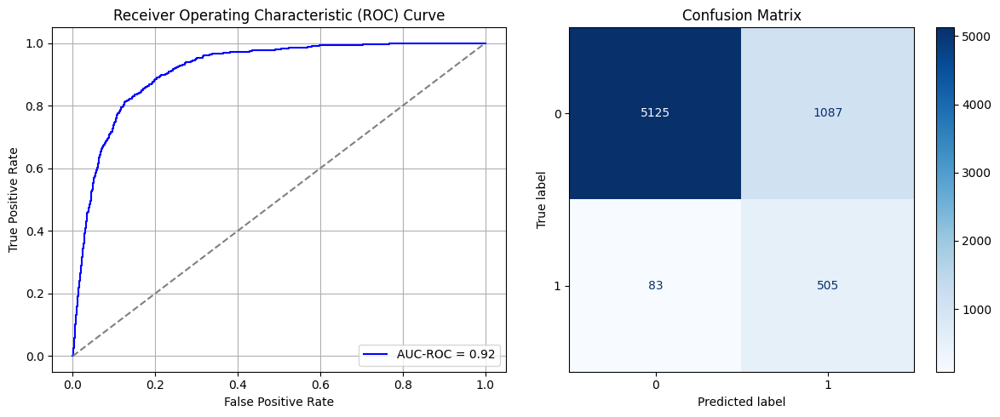

Best threshold based on F1-score: 0.9969419240951538
False Negative Rate: 0.141156462585034
Time elapsed (performance): 0.7899266209997222
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - AUC: 0.6233 - loss: 0.6654 - val_AUC: 0.7744 - val_loss: 0.5798
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.7989 - loss: 0.5537 - val_AUC: 0.8633 - val_loss: 0.4929
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8530 - loss: 0.4903 - val_AUC: 0.8794 - val_loss: 0.4652
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8709 - loss: 0.4612 - val_AUC: 0.8899 - val_loss: 0.4292
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8746 - loss: 0.4503 - val_AUC: 0.8902 - val_loss: 0.4241
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8779 - loss: 0.4433 - val_AUC: 0.8912 - val_loss: 0.4188
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8886 - loss: 0.4244 - val_AUC: 0.8935 - val_loss: 0.4230
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8934 - loss: 0.4178 - val_AUC: 0.8945 - val_loss: 0.4152
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8902 -

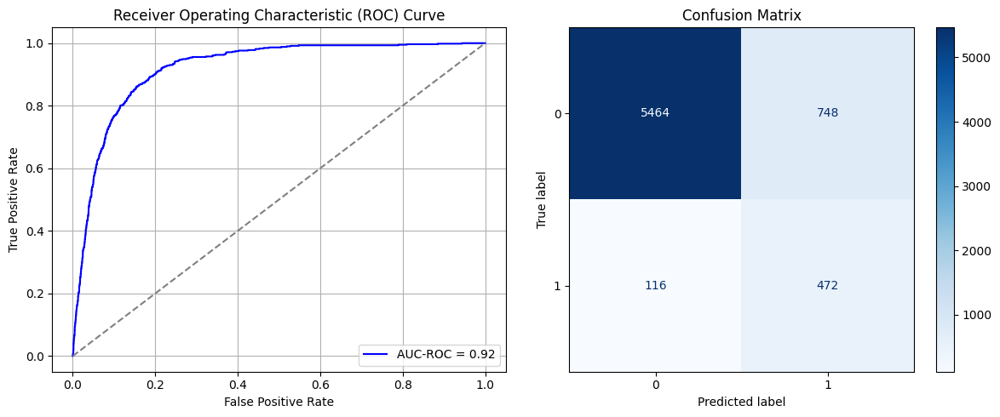

Best threshold based on F1-score: 0.999199628829956
False Negative Rate: 0.19727891156462585
Time elapsed (performance): 0.7673229510000965
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - AUC: 0.6242 - loss: 0.6673 - val_AUC: 0.7610 - val_loss: 0.5882
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.7921 - loss: 0.5574 - val_AUC: 0.8547 - val_loss: 0.4994
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8527 - loss: 0.4906 - val_AUC: 0.8720 - val_loss: 0.4720
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8745 - loss: 0.4549 - val_AUC: 0.8778 - val_loss: 0.4583
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8818 - loss: 0.4407 - val_AUC: 0.8809 - val_loss: 0.4448
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8838 - loss: 0.4346 - val_AUC: 0.8788 - val_loss: 0.4606
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8801 - loss: 0.4406 - val_AUC: 0.8833 - val_loss: 0.4406
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8782 - loss: 0.4424 - val_AUC: 0.8847 - val_loss: 0.4400
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8927 -

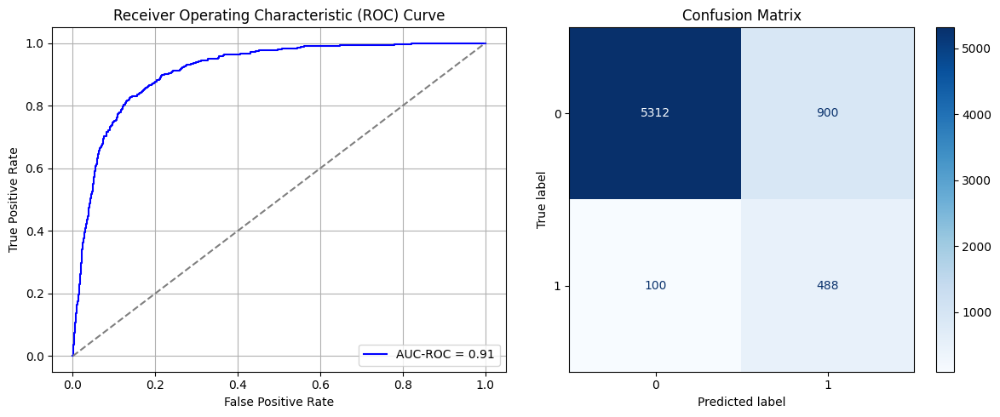

Best threshold based on F1-score: 0.9992345571517944
False Negative Rate: 0.17006802721088435
Time elapsed (performance): 0.7891484150004544
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6104 - loss: 0.6688 - val_AUC: 0.7634 - val_loss: 0.5907
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.7751 - loss: 0.5752 - val_AUC: 0.8553 - val_loss: 0.5090
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8560 - loss: 0.4906 - val_AUC: 0.8721 - val_loss: 0.4661
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8724 - loss: 0.4560 - val_AUC: 0.8744 - val_loss: 0.4554
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8735 - loss: 0.4537 - val_AUC: 0.8760 - val_loss: 0.4491
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8831 - loss: 0.4376 - val_AUC: 0.8758 - val_loss: 0.4518
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8824 - loss: 0.4365 - val_AUC: 0.8757 - val_loss: 0.4458
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8777 - loss: 0.4436 - val_AUC: 0.8757 - val_loss: 0.4441
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8742 -

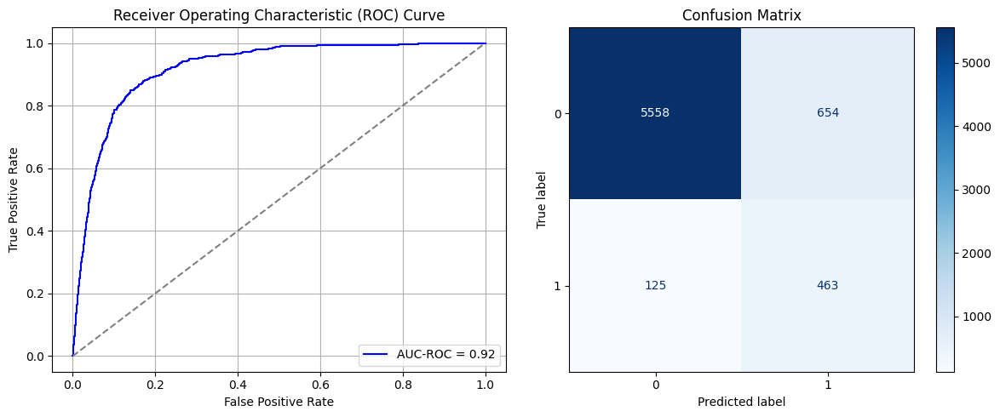

Best threshold based on F1-score: 0.6139071583747864
False Negative Rate: 0.21258503401360543
Time elapsed (performance): 0.7850749229992289
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6733 - loss: 0.6548 - val_AUC: 0.7787 - val_loss: 0.5803
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7776 - loss: 0.5759 - val_AUC: 0.8533 - val_loss: 0.5072
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8460 - loss: 0.5044 - val_AUC: 0.8770 - val_loss: 0.4593
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8633 - loss: 0.4710 - val_AUC: 0.8805 - val_loss: 0.4439
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8744 - loss: 0.4510 - val_AUC: 0.8814 - val_loss: 0.4411
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8719 - loss: 0.4528 - val_AUC: 0.8804 - val_loss: 0.4397
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8799 - loss: 0.4385 - val_AUC: 0.8787 - val_loss: 0.4512
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8772 - loss: 0.4394 - val_AUC: 0.8835 - val_loss: 0.4286
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8813 -

<ipython-input-76-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
AUC-ROC: 0.9201717873240731
Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.85      0.91      6212
           1       0.35      0.86      0.49       588

    accuracy                           0.85      6800
   macro avg       0.67      0.85      0.70      6800
weighted avg       0.93      0.85      0.87      6800

FPR 0.15405666452028333 TPR: 0.8639455782312925 FNR: 0.1360544217687075 TNR: 0.8459433354797167


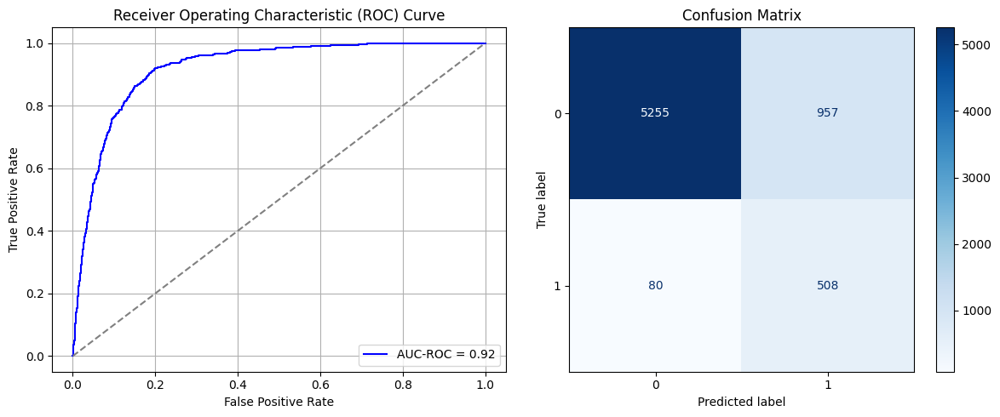

Best threshold based on F1-score: 0.6869889497756958
False Negative Rate: 0.1360544217687075
Time elapsed (performance): 1.042167607999545
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6460 - loss: 0.6615 - val_AUC: 0.7729 - val_loss: 0.5863
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7980 - loss: 0.5571 - val_AUC: 0.8561 - val_loss: 0.5018
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8606 - loss: 0.4854 - val_AUC: 0.8739 - val_loss: 0.4644
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8750 - loss: 0.4550 - val_AUC: 0.8811 - val_loss: 0.4527
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8844 - loss: 0.4411 - val_AUC: 0.8850 - val_loss: 0.4438
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8821 - loss: 0.4388 - val_AUC: 0.8826 - val_loss: 0.4449
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8831 - loss: 0.4350 - val_AUC: 0.8866 - val_loss: 0.4365
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8809 - loss: 0.4406 - val_AUC: 0.8867 - val_loss: 0.4453
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8779 -

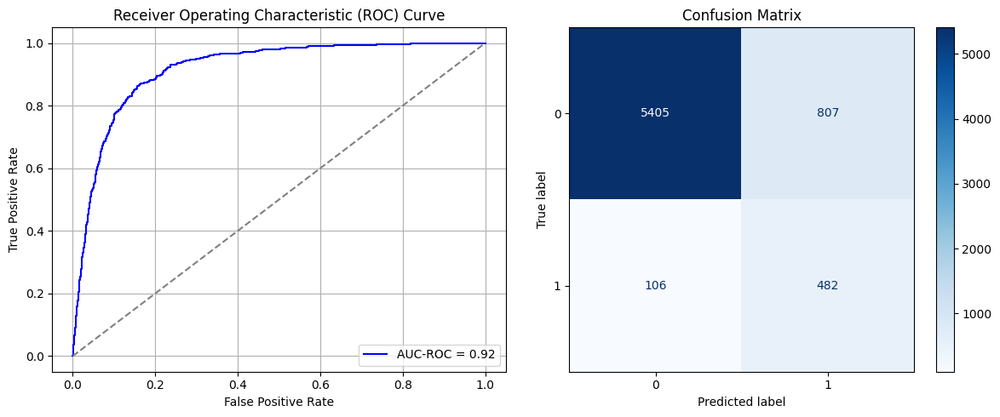

Best threshold based on F1-score: 0.661580502986908
False Negative Rate: 0.18027210884353742
Time elapsed (performance): 1.0468699240000205
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6605 - loss: 0.6608 - val_AUC: 0.7638 - val_loss: 0.5862
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7842 - loss: 0.5662 - val_AUC: 0.8478 - val_loss: 0.5054
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8479 - loss: 0.4970 - val_AUC: 0.8674 - val_loss: 0.4691
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8609 - loss: 0.4770 - val_AUC: 0.8724 - val_loss: 0.4647
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8776 - loss: 0.4477 - val_AUC: 0.8735 - val_loss: 0.4536
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8761 - loss: 0.4482 - val_AUC: 0.8735 - val_loss: 0.4505
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8696 - loss: 0.4542 - val_AUC: 0.8747 - val_loss: 0.4455
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8726 - loss: 0.4482 - val_AUC: 0.8756 - val_loss: 0.4522
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8806 -

<ipython-input-76-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
AUC-ROC: 0.9203122330709489
Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.86      0.92      6212
           1       0.36      0.84      0.51       588

    accuracy                           0.86      6800
   macro avg       0.67      0.85      0.71      6800
weighted avg       0.93      0.86      0.88      6800

FPR 0.1387636831938184 TPR: 0.8367346938775511 FNR: 0.16326530612244897 TNR: 0.8612363168061816


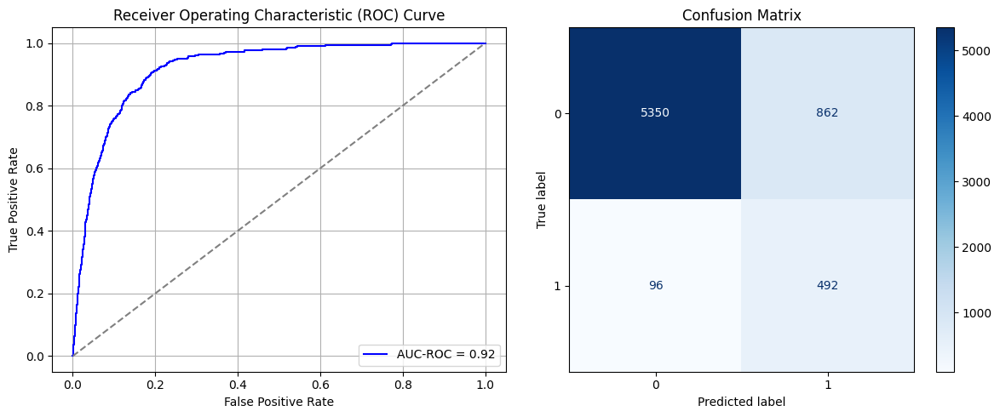

Best threshold based on F1-score: 0.6506974697113037
False Negative Rate: 0.16326530612244897
Time elapsed (performance): 0.7814161539999986
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6681 - loss: 0.6578 - val_AUC: 0.7473 - val_loss: 0.5976
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7696 - loss: 0.5765 - val_AUC: 0.8334 - val_loss: 0.5286
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8481 - loss: 0.4974 - val_AUC: 0.8733 - val_loss: 0.4759
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8663 - loss: 0.4637 - val_AUC: 0.8772 - val_loss: 0.4533
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8813 - loss: 0.4373 - val_AUC: 0.8764 - val_loss: 0.4531
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8752 - loss: 0.4457 - val_AUC: 0.8826 - val_loss: 0.4433
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8845 - loss: 0.4289 - val_AUC: 0.8805 - val_loss: 0.4447
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8860 - loss: 0.4263 - val_AUC: 0.8807 - val_loss: 0.4408
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8911 -

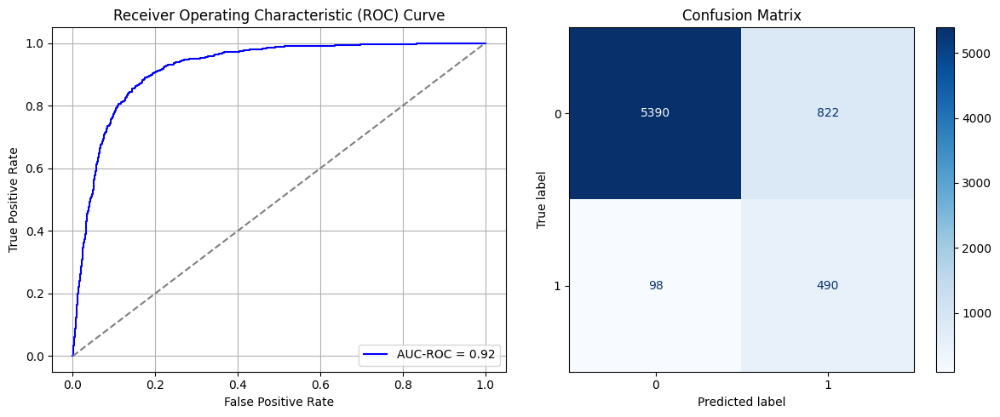

Best threshold based on F1-score: 0.9989022016525269
False Negative Rate: 0.16666666666666666
Time elapsed (performance): 0.9747855759997037
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6514 - loss: 0.6617 - val_AUC: 0.7706 - val_loss: 0.5843
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7817 - loss: 0.5708 - val_AUC: 0.8662 - val_loss: 0.5008
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8547 - loss: 0.4915 - val_AUC: 0.8762 - val_loss: 0.4574
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8768 - loss: 0.4516 - val_AUC: 0.8845 - val_loss: 0.4402
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8716 - loss: 0.4551 - val_AUC: 0.8852 - val_loss: 0.4434
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8755 - loss: 0.4532 - val_AUC: 0.8836 - val_loss: 0.4469
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8803 - loss: 0.4416 - val_AUC: 0.8849 - val_loss: 0.4396
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8799 - loss: 0.4407 - val_AUC: 0.8862 - val_loss: 0.4291
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8837 -

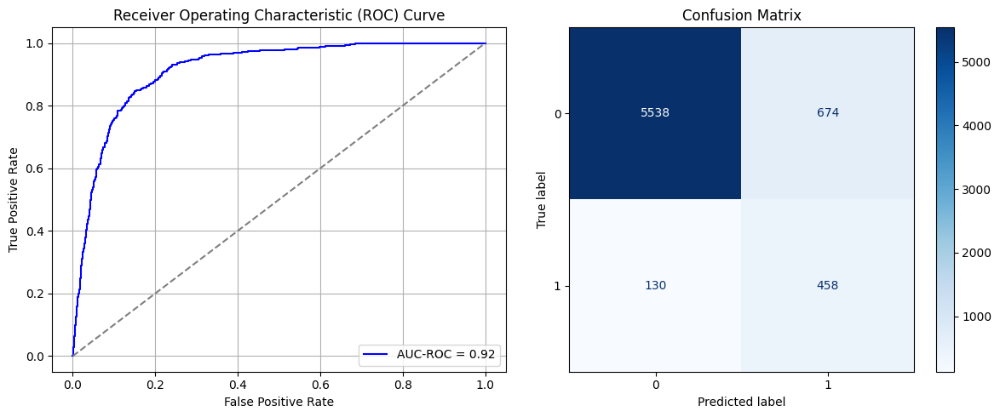

Best threshold based on F1-score: 0.998874306678772
False Negative Rate: 0.22108843537414966
Time elapsed (performance): 0.9266217209997194
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.6231 - loss: 0.6704 - val_AUC: 0.7548 - val_loss: 0.5979
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7807 - loss: 0.5697 - val_AUC: 0.8443 - val_loss: 0.5134
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8573 - loss: 0.4898 - val_AUC: 0.8716 - val_loss: 0.4605
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8699 - loss: 0.4594 - val_AUC: 0.8766 - val_loss: 0.4572
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8834 - loss: 0.4332 - val_AUC: 0.8809 - val_loss: 0.4478
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8791 - loss: 0.4412 - val_AUC: 0.8839 - val_loss: 0.4402
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8794 - loss: 0.4393 - val_AUC: 0.8832 - val_loss: 0.4390
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8847 - loss: 0.4320 - val_AUC: 0.8848 - val_loss: 0.4350
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8804 -

<ipython-input-76-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
AUC-ROC: 0.9213963756784105
Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.87      0.92      6212
           1       0.37      0.83      0.52       588

    accuracy                           0.86      6800
   macro avg       0.68      0.85      0.72      6800
weighted avg       0.93      0.86      0.89      6800

FPR 0.1320025756600129 TPR: 0.8316326530612245 FNR: 0.1683673469387755 TNR: 0.8679974243399871


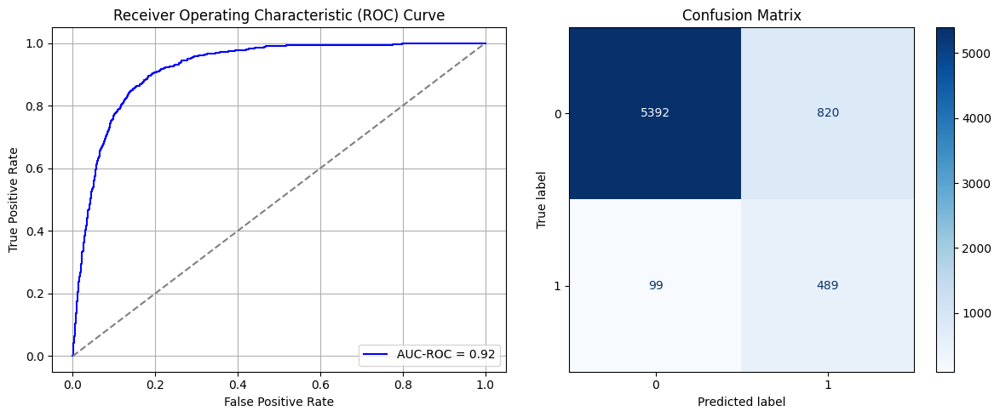

Best threshold based on F1-score: 0.9974637627601624
False Negative Rate: 0.1683673469387755
Time elapsed (performance): 0.8015382539997518
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - AUC: 0.6667 - loss: 0.6566 - val_AUC: 0.7535 - val_loss: 0.5921
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7855 - loss: 0.5668 - val_AUC: 0.8503 - val_loss: 0.5063
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8483 - loss: 0.4978 - val_AUC: 0.8715 - val_loss: 0.4665
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8671 - loss: 0.4672 - val_AUC: 0.8750 - val_loss: 0.4565
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8771 - loss: 0.4468 - val_AUC: 0.8755 - val_loss: 0.4523
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8726 - loss: 0.4546 - val_AUC: 0.8781 - val_loss: 0.4468
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8819 - loss: 0.4386 - val_AUC: 0.8772 - val_loss: 0.4448
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8713 - loss: 0.4539 - val_AUC: 0.8772 - val_loss: 0.4494
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8873 -

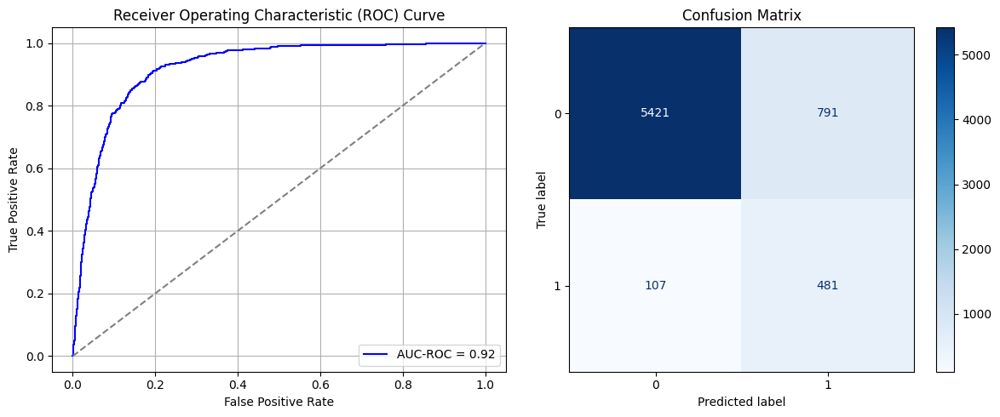

Best threshold based on F1-score: 0.579166054725647
False Negative Rate: 0.18197278911564627
Time elapsed (performance): 2.0981053430004977
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.6524 - loss: 0.6553 - val_AUC: 0.7726 - val_loss: 0.5773
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7836 - loss: 0.5665 - val_AUC: 0.8479 - val_loss: 0.5077
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8468 - loss: 0.5016 - val_AUC: 0.8648 - val_loss: 0.4708
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8658 - loss: 0.4653 - val_AUC: 0.8734 - val_loss: 0.4621
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8772 - loss: 0.4476 - val_AUC: 0.8757 - val_loss: 0.4503
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8772 - loss: 0.4443 - val_AUC: 0.8737 - val_loss: 0.4596
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8781 - loss: 0.4407 - val_AUC: 0.8755 - val_loss: 0.4529
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8772 - loss: 0.4404 - val_AUC: 0.8769 - val_loss: 0.4457
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8755 -

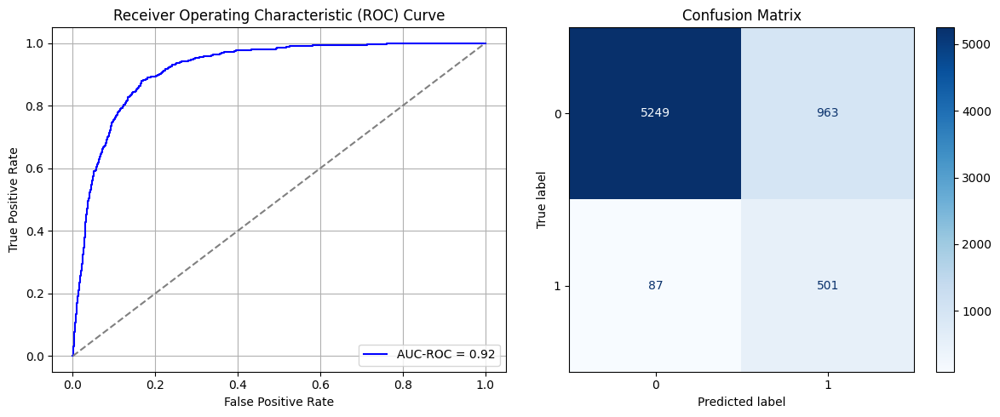

Best threshold based on F1-score: 0.997678816318512
False Negative Rate: 0.14795918367346939
Time elapsed (performance): 1.2424444649996076
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.6995 - loss: 0.6459 - val_AUC: 0.8066 - val_loss: 0.5564
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8122 - loss: 0.5441 - val_AUC: 0.8795 - val_loss: 0.4717
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8692 - loss: 0.4721 - val_AUC: 0.8900 - val_loss: 0.4311
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8794 - loss: 0.4488 - val_AUC: 0.8879 - val_loss: 0.4383
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8825 - loss: 0.4394 - val_AUC: 0.8951 - val_loss: 0.4198
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8913 - loss: 0.4264 - val_AUC: 0.8963 - val_loss: 0.4160
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8881 - loss: 0.4267 - val_AUC: 0.8959 - val_loss: 0.4147
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8972 - loss: 0.4115 - val_AUC: 0.8966 - val_loss: 0.4228
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8886 -

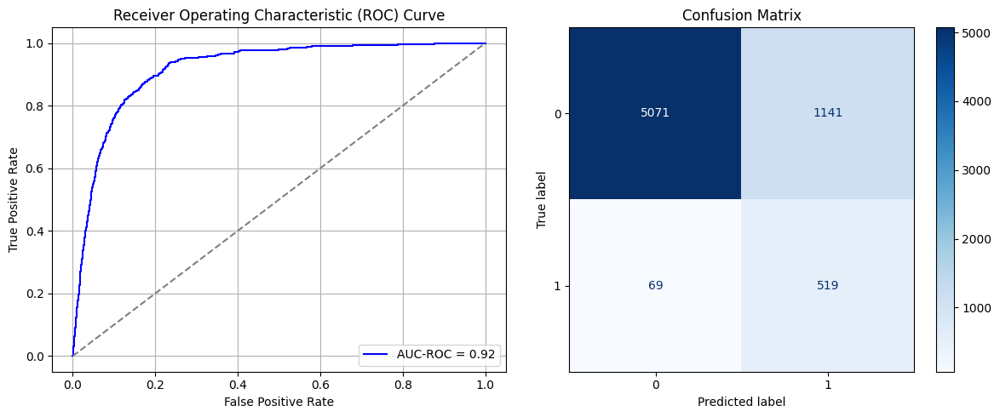

Best threshold based on F1-score: 0.7557430267333984
False Negative Rate: 0.11734693877551021
Time elapsed (performance): 0.8493811459993594
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6595 - loss: 0.6590 - val_AUC: 0.7320 - val_loss: 0.6043
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7605 - loss: 0.5837 - val_AUC: 0.8193 - val_loss: 0.5276
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8416 - loss: 0.5031 - val_AUC: 0.8702 - val_loss: 0.4669
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8743 - loss: 0.4544 - val_AUC: 0.8788 - val_loss: 0.4570
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8692 - loss: 0.4573 - val_AUC: 0.8783 - val_loss: 0.4446
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8823 - loss: 0.4352 - val_AUC: 0.8805 - val_loss: 0.4450
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8792 - loss: 0.4383 - val_AUC: 0.8840 - val_loss: 0.4355
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8922 - loss: 0.4173 - val_AUC: 0.8842 - val_loss: 0.4364
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.8896 -

<ipython-input-76-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
AUC-ROC: 0.9159258358849014
Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.86      0.92      6212
           1       0.36      0.82      0.50       588

    accuracy                           0.86      6800
   macro avg       0.67      0.84      0.71      6800
weighted avg       0.93      0.86      0.88      6800

FPR 0.13860270444301354 TPR: 0.8197278911564626 FNR: 0.18027210884353742 TNR: 0.8613972955569864


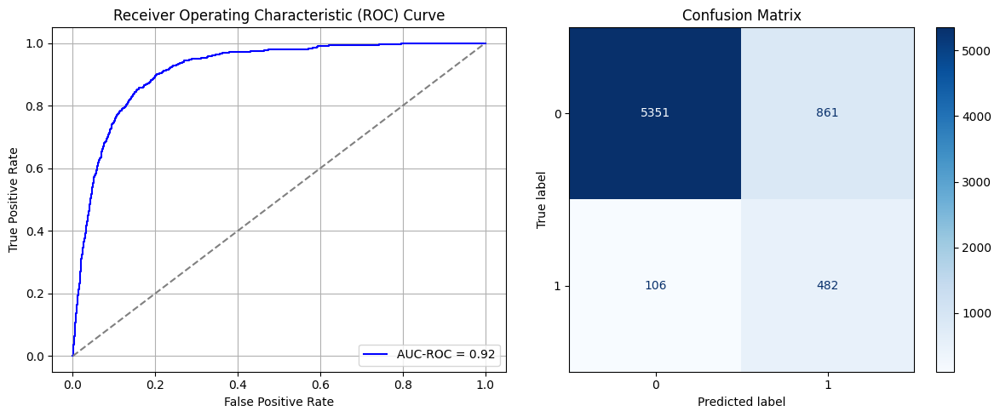

Best threshold based on F1-score: 0.9991215467453003
False Negative Rate: 0.18027210884353742
Time elapsed (performance): 0.832491588999801
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6494 - loss: 0.6631 - val_AUC: 0.7527 - val_loss: 0.5953
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7695 - loss: 0.5751 - val_AUC: 0.8409 - val_loss: 0.5115
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8440 - loss: 0.5039 - val_AUC: 0.8718 - val_loss: 0.4894
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8665 - loss: 0.4731 - val_AUC: 0.8717 - val_loss: 0.5057
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8652 - loss: 0.4703 - val_AUC: 0.8751 - val_loss: 0.4517
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8723 - loss: 0.4570 - val_AUC: 0.8783 - val_loss: 0.4463
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8725 - loss: 0.4540 - val_AUC: 0.8811 - val_loss: 0.4439
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8811 - loss: 0.4391 - val_AUC: 0.8832 - val_loss: 0.4383
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8780 -

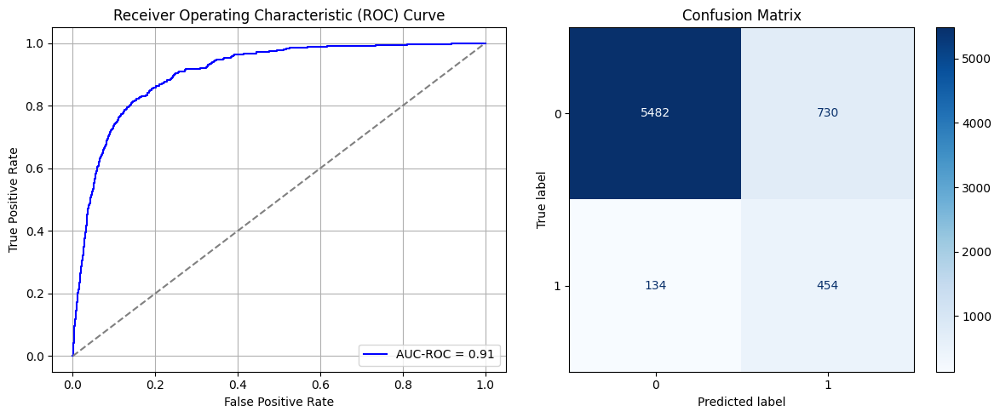

Best threshold based on F1-score: 0.999826192855835
False Negative Rate: 0.22789115646258504
Time elapsed (performance): 0.8095920870000555
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6358 - loss: 0.6611 - val_AUC: 0.7845 - val_loss: 0.5673
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7884 - loss: 0.5624 - val_AUC: 0.8591 - val_loss: 0.4902
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8565 - loss: 0.4859 - val_AUC: 0.8826 - val_loss: 0.4477
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8674 - loss: 0.4631 - val_AUC: 0.8841 - val_loss: 0.4374
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8745 - loss: 0.4516 - val_AUC: 0.8886 - val_loss: 0.4307
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8811 - loss: 0.4367 - val_AUC: 0.8873 - val_loss: 0.4265
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8822 - loss: 0.4348 - val_AUC: 0.8876 - val_loss: 0.4238
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8740 - loss: 0.4480 - val_AUC: 0.8896 - val_loss: 0.4193
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8900 -

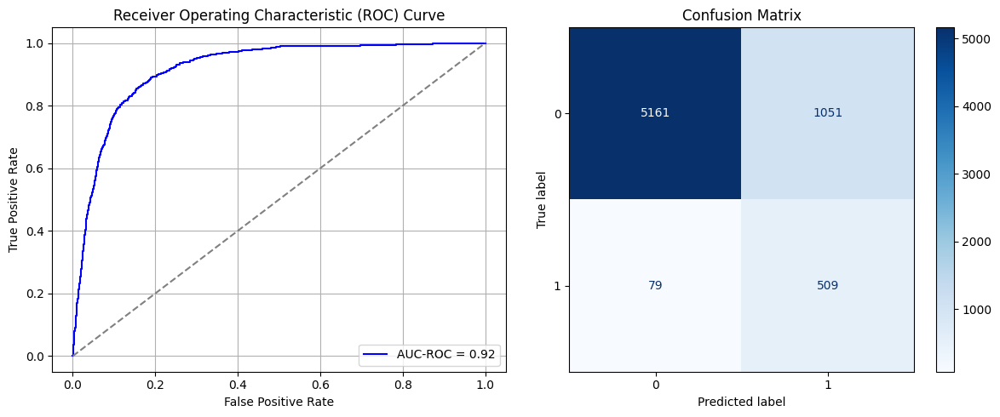

Best threshold based on F1-score: 0.9975010752677917
False Negative Rate: 0.13435374149659865
Time elapsed (performance): 1.0485811170001398
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6274 - loss: 0.6636 - val_AUC: 0.7708 - val_loss: 0.5821
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7834 - loss: 0.5666 - val_AUC: 0.8540 - val_loss: 0.5029
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8510 - loss: 0.4922 - val_AUC: 0.8765 - val_loss: 0.4554
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8650 - loss: 0.4686 - val_AUC: 0.8779 - val_loss: 0.4510
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - AUC: 0.8807 - loss: 0.4391 - val_AUC: 0.8817 - val_loss: 0.4402
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8804 - loss: 0.4391 - val_AUC: 0.8818 - val_loss: 0.4471
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8801 - loss: 0.4383 - val_AUC: 0.8834 - val_loss: 0.4343
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8819 - loss: 0.4387 - val_AUC: 0.8848 - val_loss: 0.4368
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8892 -

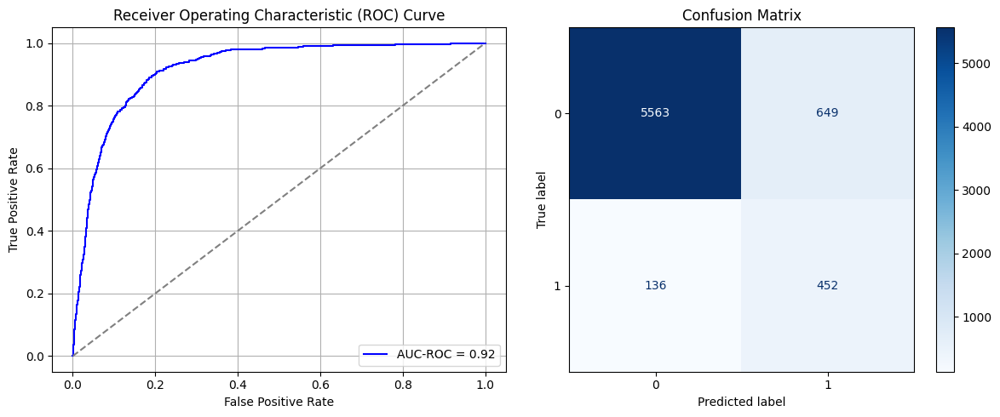

Best threshold based on F1-score: 0.9917824268341064
False Negative Rate: 0.23129251700680273
Time elapsed (performance): 1.0479997749998802
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6903 - loss: 0.6491 - val_AUC: 0.7724 - val_loss: 0.5755
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7926 - loss: 0.5570 - val_AUC: 0.8541 - val_loss: 0.5066
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8564 - loss: 0.4853 - val_AUC: 0.8731 - val_loss: 0.4696
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8701 - loss: 0.4580 - val_AUC: 0.8762 - val_loss: 0.4534
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8765 - loss: 0.4480 - val_AUC: 0.8784 - val_loss: 0.4491
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8741 - loss: 0.4462 - val_AUC: 0.8782 - val_loss: 0.4486
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8723 - loss: 0.4501 - val_AUC: 0.8807 - val_loss: 0.4426
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8845 - loss: 0.4291 - val_AUC: 0.8819 - val_loss: 0.4500
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8859 -

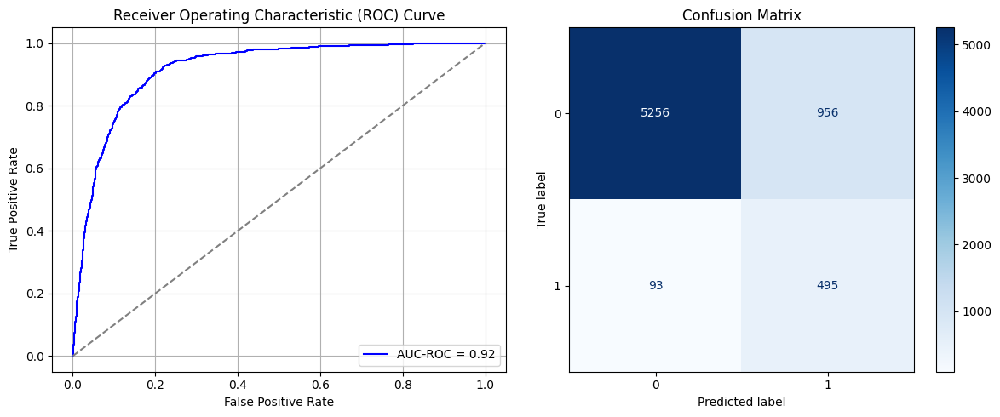

Best threshold based on F1-score: 0.9987816214561462
False Negative Rate: 0.15816326530612246
Time elapsed (performance): 1.0489130470004966
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6830 - loss: 0.6496 - val_AUC: 0.7670 - val_loss: 0.5977
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7997 - loss: 0.5557 - val_AUC: 0.8420 - val_loss: 0.5081
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8623 - loss: 0.4791 - val_AUC: 0.8686 - val_loss: 0.4625
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8793 - loss: 0.4419 - val_AUC: 0.8724 - val_loss: 0.4549
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8725 - loss: 0.4497 - val_AUC: 0.8730 - val_loss: 0.4574
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8862 - loss: 0.4262 - val_AUC: 0.8756 - val_loss: 0.4437
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8802 - loss: 0.4330 - val_AUC: 0.8767 - val_loss: 0.4456
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8789 - loss: 0.4371 - val_AUC: 0.8773 - val_loss: 0.4609
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8769 -

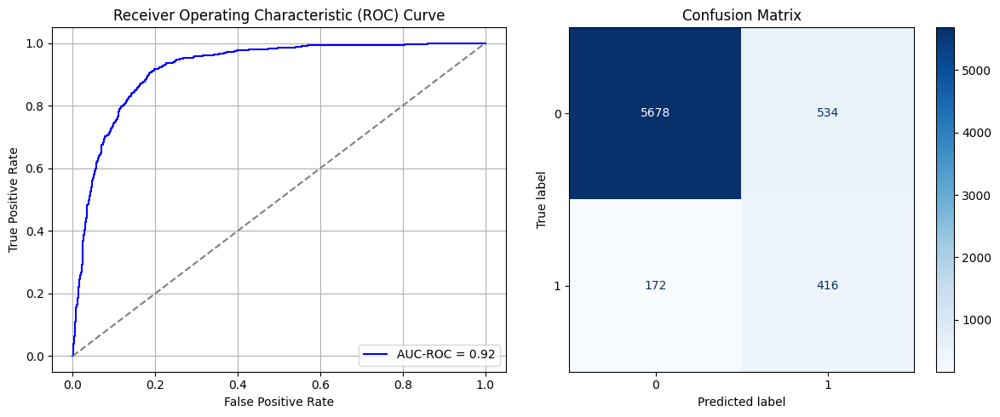

Best threshold based on F1-score: 0.9923360347747803
False Negative Rate: 0.2925170068027211
Time elapsed (performance): 0.820797002999825
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6110 - loss: 0.6699 - val_AUC: 0.7579 - val_loss: 0.5916
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7793 - loss: 0.5713 - val_AUC: 0.8459 - val_loss: 0.5088
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8475 - loss: 0.4969 - val_AUC: 0.8826 - val_loss: 0.4562
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8693 - loss: 0.4602 - val_AUC: 0.8871 - val_loss: 0.4420
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8770 - loss: 0.4467 - val_AUC: 0.8873 - val_loss: 0.4337
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8823 - loss: 0.4352 - val_AUC: 0.8877 - val_loss: 0.4327
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8785 - loss: 0.4403 - val_AUC: 0.8900 - val_loss: 0.4307
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8869 - loss: 0.4260 - val_AUC: 0.8896 - val_loss: 0.4262
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8877 -

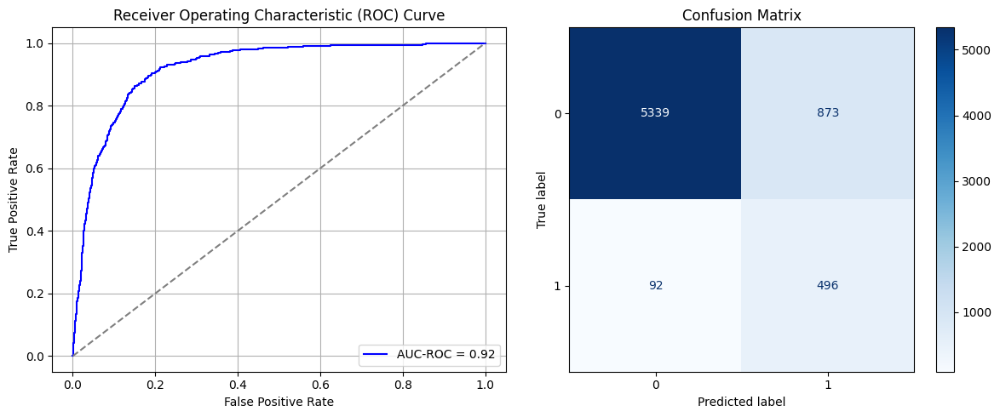

Best threshold based on F1-score: 0.9985368847846985
False Negative Rate: 0.1564625850340136
Time elapsed (performance): 0.8371220680000988
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6415 - loss: 0.6633 - val_AUC: 0.7815 - val_loss: 0.5810
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8010 - loss: 0.5515 - val_AUC: 0.8510 - val_loss: 0.5042
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8535 - loss: 0.4897 - val_AUC: 0.8616 - val_loss: 0.4846
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8697 - loss: 0.4550 - val_AUC: 0.8757 - val_loss: 0.4539
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8790 - loss: 0.4410 - val_AUC: 0.8779 - val_loss: 0.4498
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8802 - loss: 0.4393 - val_AUC: 0.8782 - val_loss: 0.4605
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8749 - loss: 0.4450 - val_AUC: 0.8817 - val_loss: 0.4381
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8849 - loss: 0.4282 - val_AUC: 0.8819 - val_loss: 0.4342
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8809 -

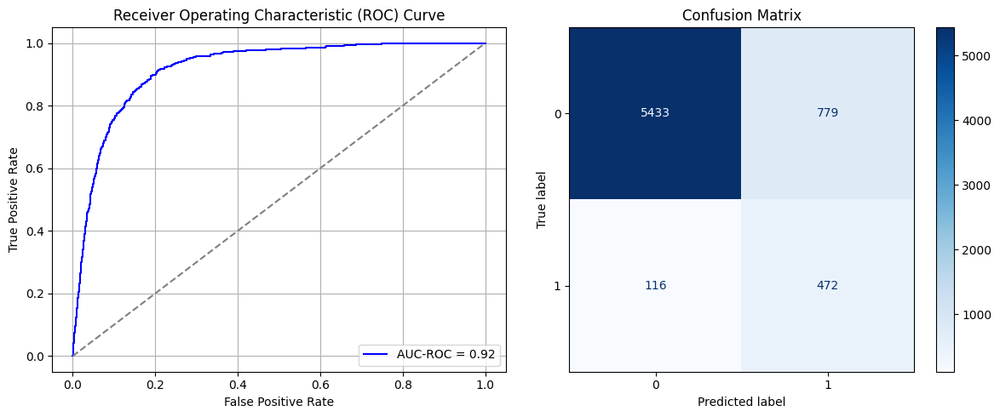

Best threshold based on F1-score: 0.9984270334243774
False Negative Rate: 0.19727891156462585
Time elapsed (performance): 0.8497265289997813
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - AUC: 0.6680 - loss: 0.6565 - val_AUC: 0.7676 - val_loss: 0.5871
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.7786 - loss: 0.5703 - val_AUC: 0.8520 - val_loss: 0.4943
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8620 - loss: 0.4750 - val_AUC: 0.8806 - val_loss: 0.4447
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8699 - loss: 0.4589 - val_AUC: 0.8809 - val_loss: 0.4403
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8783 - loss: 0.4440 - val_AUC: 0.8884 - val_loss: 0.4287
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8850 - loss: 0.4289 - val_AUC: 0.8907 - val_loss: 0.4302
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8784 - loss: 0.4398 - val_AUC: 0.8909 - val_loss: 0.4390
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8806 - loss: 0.4359 - val_AUC: 0.8889 - val_loss: 0.4230
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8840 -

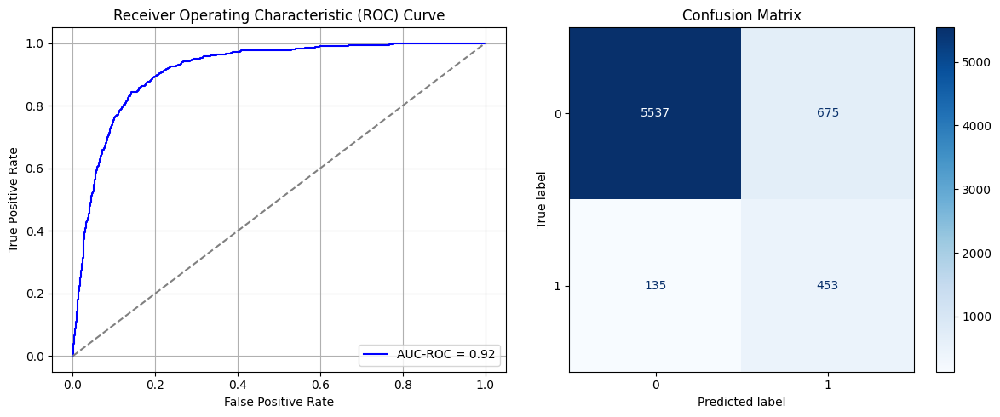

Best threshold based on F1-score: 0.565644383430481
False Negative Rate: 0.22959183673469388
Time elapsed (performance): 1.3098442430000432
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.6334 - loss: 0.6641 - val_AUC: 0.7454 - val_loss: 0.5993
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7811 - loss: 0.5691 - val_AUC: 0.8265 - val_loss: 0.5267
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8551 - loss: 0.4850 - val_AUC: 0.8579 - val_loss: 0.4880
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8619 - loss: 0.4680 - val_AUC: 0.8631 - val_loss: 0.4712
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8811 - loss: 0.4390 - val_AUC: 0.8635 - val_loss: 0.4725
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8831 - loss: 0.4328 - val_AUC: 0.8679 - val_loss: 0.4682
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8770 - loss: 0.4430 - val_AUC: 0.8679 - val_loss: 0.4704
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8877 - loss: 0.4249 - val_AUC: 0.8709 - val_loss: 0.4544
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8845 -

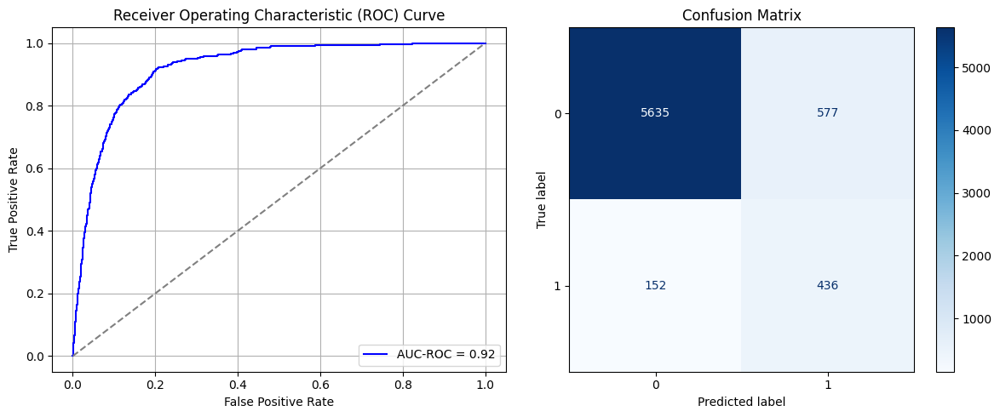

Best threshold based on F1-score: 0.997634768486023
False Negative Rate: 0.2585034013605442
Time elapsed (performance): 1.7280263339998783
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6580 - loss: 0.6590 - val_AUC: 0.7682 - val_loss: 0.5834
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7892 - loss: 0.5616 - val_AUC: 0.8484 - val_loss: 0.5007
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8542 - loss: 0.4884 - val_AUC: 0.8727 - val_loss: 0.4678
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8719 - loss: 0.4562 - val_AUC: 0.8772 - val_loss: 0.4463
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8876 - loss: 0.4286 - val_AUC: 0.8794 - val_loss: 0.4381
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8801 - loss: 0.4373 - val_AUC: 0.8810 - val_loss: 0.4347
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8770 - loss: 0.4419 - val_AUC: 0.8820 - val_loss: 0.4317
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8907 - loss: 0.4185 - val_AUC: 0.8815 - val_loss: 0.4368
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8912 -

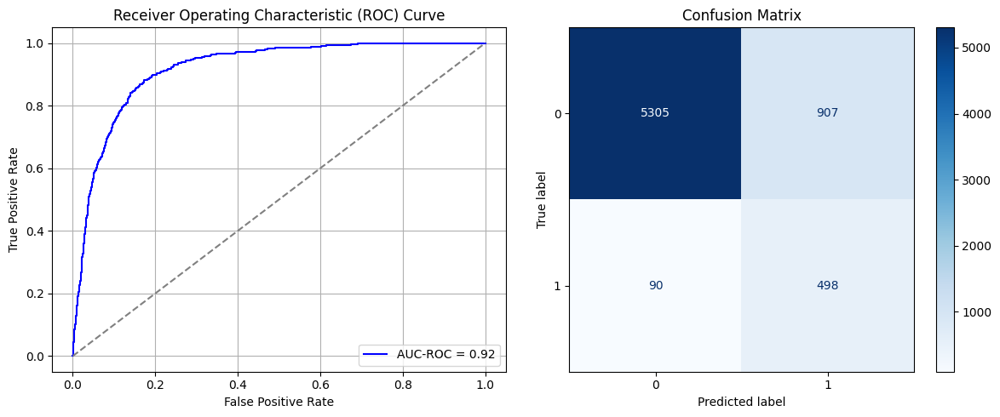

Best threshold based on F1-score: 0.9972148537635803
False Negative Rate: 0.15306122448979592
Time elapsed (performance): 1.0677802640002483
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - AUC: 0.6740 - loss: 0.6549 - val_AUC: 0.8069 - val_loss: 0.5501
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7947 - loss: 0.5587 - val_AUC: 0.8658 - val_loss: 0.4774
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8506 - loss: 0.4917 - val_AUC: 0.8825 - val_loss: 0.4562
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8668 - loss: 0.4673 - val_AUC: 0.8854 - val_loss: 0.4506
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8768 - loss: 0.4480 - val_AUC: 0.8848 - val_loss: 0.4452
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8798 - loss: 0.4416 - val_AUC: 0.8864 - val_loss: 0.4406
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.8769 - loss: 0.4486 - val_AUC: 0.8865 - val_loss: 0.4393
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8855 - loss: 0.4301 - val_AUC: 0.8871 - val_loss: 0.4359
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8882 -

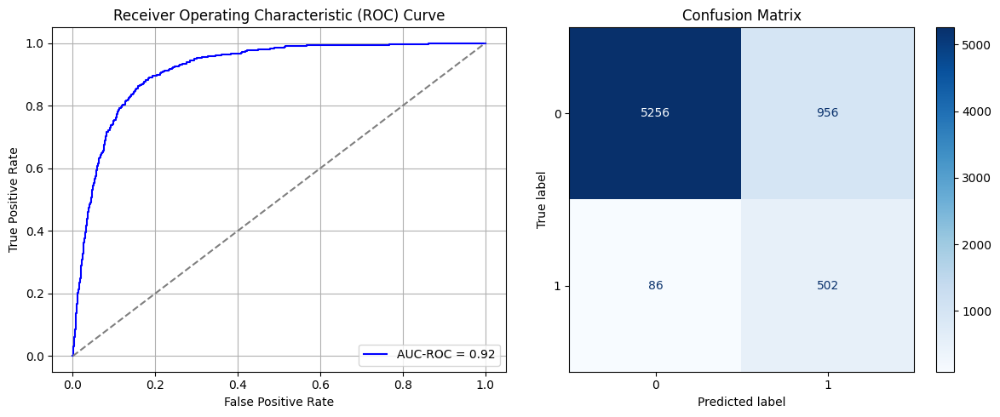

Best threshold based on F1-score: 0.9986928105354309
False Negative Rate: 0.14625850340136054
Time elapsed (performance): 0.8651566689995889
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6284 - loss: 0.6644 - val_AUC: 0.7597 - val_loss: 0.5861
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7689 - loss: 0.5787 - val_AUC: 0.8370 - val_loss: 0.5117
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8568 - loss: 0.4850 - val_AUC: 0.8643 - val_loss: 0.4647
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8754 - loss: 0.4538 - val_AUC: 0.8716 - val_loss: 0.4704
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8796 - loss: 0.4426 - val_AUC: 0.8728 - val_loss: 0.4500
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8846 - loss: 0.4344 - val_AUC: 0.8739 - val_loss: 0.4485
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8859 - loss: 0.4306 - val_AUC: 0.8721 - val_loss: 0.4510
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8890 - loss: 0.4219 - val_AUC: 0.8721 - val_loss: 0.4443
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8904 -

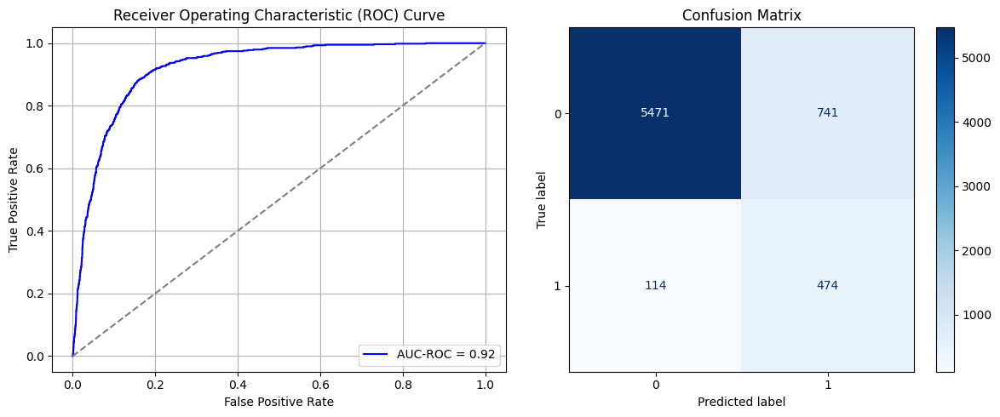

Best threshold based on F1-score: 0.9938935041427612
False Negative Rate: 0.19387755102040816
Time elapsed (performance): 0.8898650769997403
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6600 - loss: 0.6575 - val_AUC: 0.7760 - val_loss: 0.5803
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8044 - loss: 0.5483 - val_AUC: 0.8493 - val_loss: 0.4986
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8551 - loss: 0.4838 - val_AUC: 0.8713 - val_loss: 0.4614
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - AUC: 0.8710 - loss: 0.4552 - val_AUC: 0.8739 - val_loss: 0.4489
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8669 - loss: 0.4601 - val_AUC: 0.8793 - val_loss: 0.4405
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8779 - loss: 0.4414 - val_AUC: 0.8796 - val_loss: 0.4383
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8712 - loss: 0.4466 - val_AUC: 0.8805 - val_loss: 0.4631
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8860 - loss: 0.4289 - val_AUC: 0.8813 - val_loss: 0.4346
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8866 -

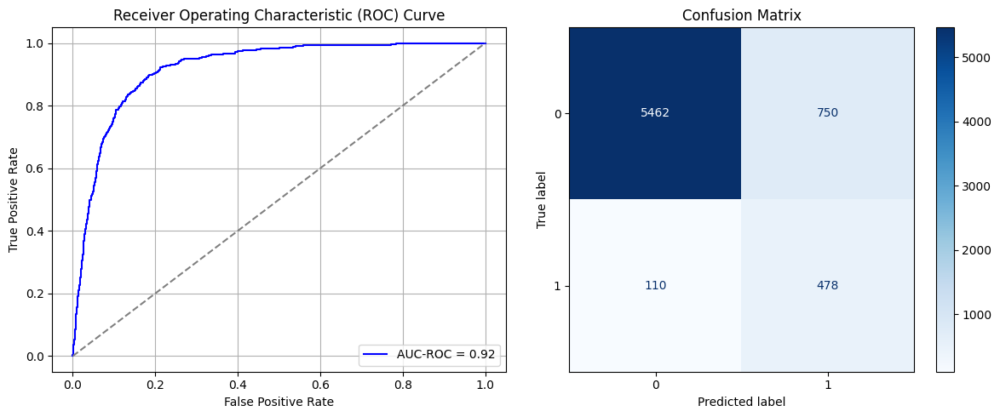

Best threshold based on F1-score: 0.6543695330619812
False Negative Rate: 0.1870748299319728
Time elapsed (performance): 0.8839495990005162
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.6437 - loss: 0.6640 - val_AUC: 0.7596 - val_loss: 0.5888
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.7822 - loss: 0.5675 - val_AUC: 0.8456 - val_loss: 0.5011
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8483 - loss: 0.4915 - val_AUC: 0.8797 - val_loss: 0.4562
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8675 - loss: 0.4580 - val_AUC: 0.8869 - val_loss: 0.4314
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8752 - loss: 0.4446 - val_AUC: 0.8889 - val_loss: 0.4476
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8821 - loss: 0.4334 - val_AUC: 0.8917 - val_loss: 0.4252
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8800 - loss: 0.4355 - val_AUC: 0.8917 - val_loss: 0.4235
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8813 - loss: 0.4323 - val_AUC: 0.8948 - val_loss: 0.4247
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8815 -

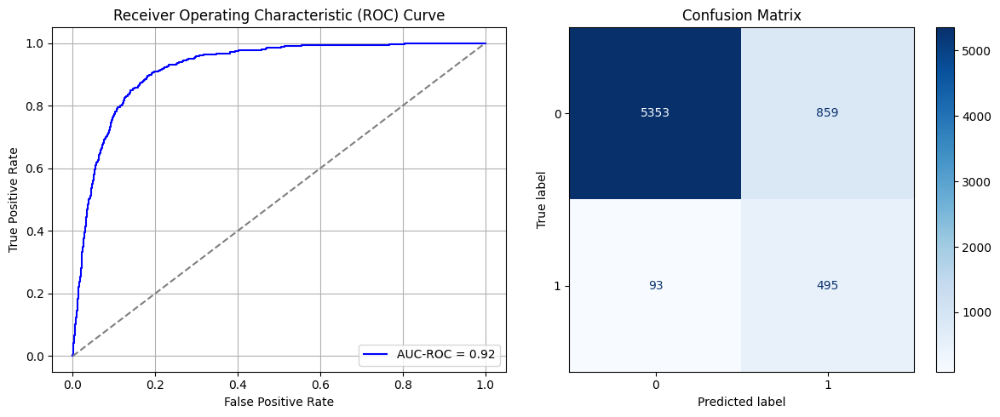

Best threshold based on F1-score: 0.6992613673210144
False Negative Rate: 0.15816326530612246
Time elapsed (performance): 0.861217681999733
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6644 - loss: 0.6537 - val_AUC: 0.7719 - val_loss: 0.5853
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7824 - loss: 0.5702 - val_AUC: 0.8507 - val_loss: 0.4981
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - AUC: 0.8448 - loss: 0.4995 - val_AUC: 0.8856 - val_loss: 0.4517
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.8700 - loss: 0.4636 - val_AUC: 0.8870 - val_loss: 0.4353
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8728 - loss: 0.4520 - val_AUC: 0.8887 - val_loss: 0.4293
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8773 - loss: 0.4449 - val_AUC: 0.8871 - val_loss: 0.4315
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8821 - loss: 0.4343 - val_AUC: 0.8902 - val_loss: 0.4319
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8792 - loss: 0.4386 - val_AUC: 0.8908 - val_loss: 0.4280
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8816 -

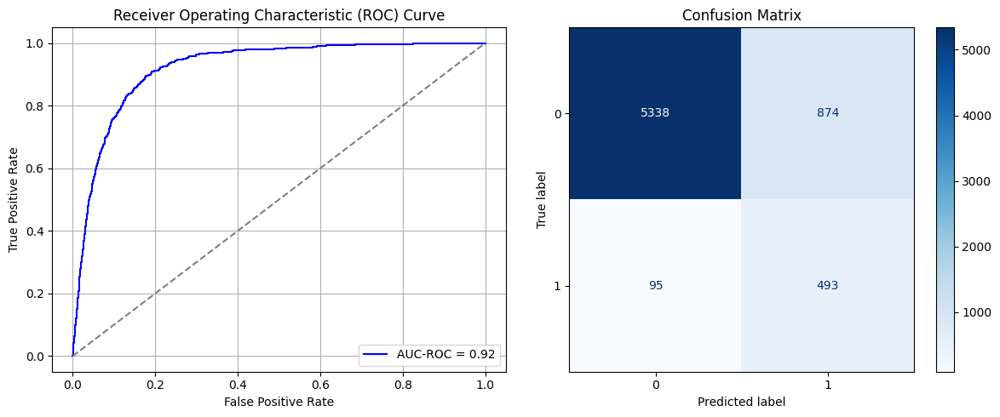

Best threshold based on F1-score: 0.9971227049827576
False Negative Rate: 0.16156462585034015
Time elapsed (performance): 0.8643514540008255
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - AUC: 0.6581 - loss: 0.6633 - val_AUC: 0.7568 - val_loss: 0.5900
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.7822 - loss: 0.5681 - val_AUC: 0.8491 - val_loss: 0.5076
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.8518 - loss: 0.4965 - val_AUC: 0.8754 - val_loss: 0.4670
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8832 - loss: 0.4398 - val_AUC: 0.8872 - val_loss: 0.4419
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8866 - loss: 0.4321 - val_AUC: 0.8882 - val_loss: 0.4296
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8844 - loss: 0.4331 - val_AUC: 0.8923 - val_loss: 0.4217
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8887 - loss: 0.4263 - val_AUC: 0.8923 - val_loss: 0.4174
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8865 - loss: 0.4267 - val_AUC: 0.8901 - val_loss: 0.4211
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8969 -

<ipython-input-76-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
AUC-ROC: 0.912374995072079
Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.86      0.92      6212
           1       0.36      0.81      0.50       588

    accuracy                           0.86      6800
   macro avg       0.67      0.84      0.71      6800
weighted avg       0.93      0.86      0.88      6800

FPR 0.13602704443013522 TPR: 0.8112244897959184 FNR: 0.18877551020408162 TNR: 0.8639729555698648


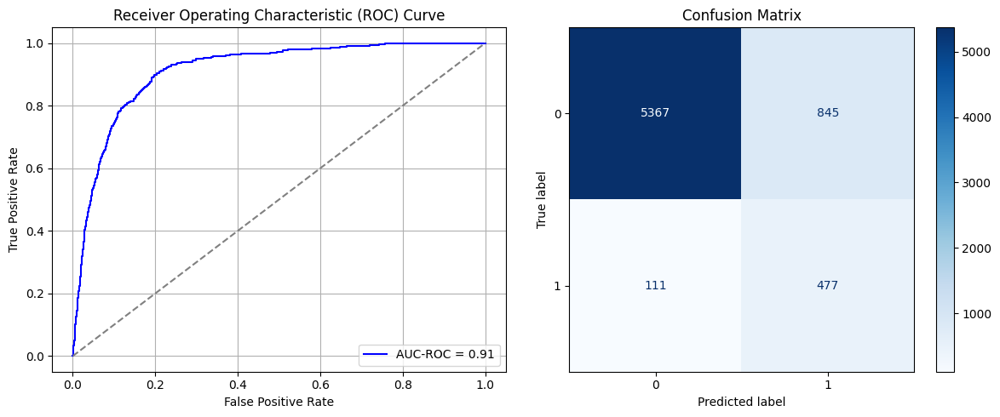

Best threshold based on F1-score: 0.7138993740081787
False Negative Rate: 0.18877551020408162
Time elapsed (performance): 0.9004480479998165
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - AUC: 0.6857 - loss: 0.6509 - val_AUC: 0.7816 - val_loss: 0.5737
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.7905 - loss: 0.5600 - val_AUC: 0.8574 - val_loss: 0.4985
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8664 - loss: 0.4727 - val_AUC: 0.8750 - val_loss: 0.4645
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8781 - loss: 0.4496 - val_AUC: 0.8774 - val_loss: 0.4597
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8779 - loss: 0.4452 - val_AUC: 0.8802 - val_loss: 0.4517
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8813 - loss: 0.4396 - val_AUC: 0.8812 - val_loss: 0.4423
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8876 - loss: 0.4315 - val_AUC: 0.8824 - val_loss: 0.4381
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8996 - loss: 0.4057 - val_AUC: 0.8817 - val_loss: 0.4378
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8987 -

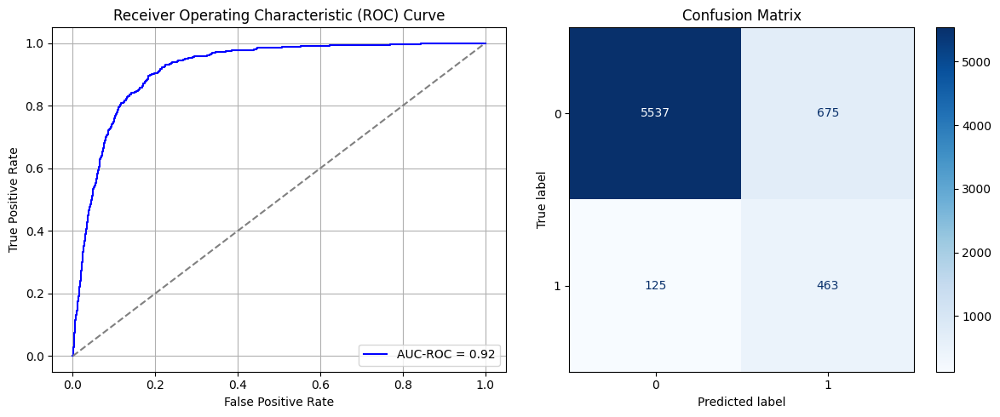

Best threshold based on F1-score: 0.9996978044509888
False Negative Rate: 0.21258503401360543
Time elapsed (performance): 1.3193921279998904
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6680 - loss: 0.6573 - val_AUC: 0.7841 - val_loss: 0.5752
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7775 - loss: 0.5694 - val_AUC: 0.8663 - val_loss: 0.4892
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8583 - loss: 0.4846 - val_AUC: 0.8815 - val_loss: 0.4470
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8782 - loss: 0.4486 - val_AUC: 0.8827 - val_loss: 0.4389
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8854 - loss: 0.4305 - val_AUC: 0.8833 - val_loss: 0.4324
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8809 - loss: 0.4366 - val_AUC: 0.8847 - val_loss: 0.4354
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8798 - loss: 0.4385 - val_AUC: 0.8883 - val_loss: 0.4287
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8822 - loss: 0.4318 - val_AUC: 0.8859 - val_loss: 0.4264
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8778 -

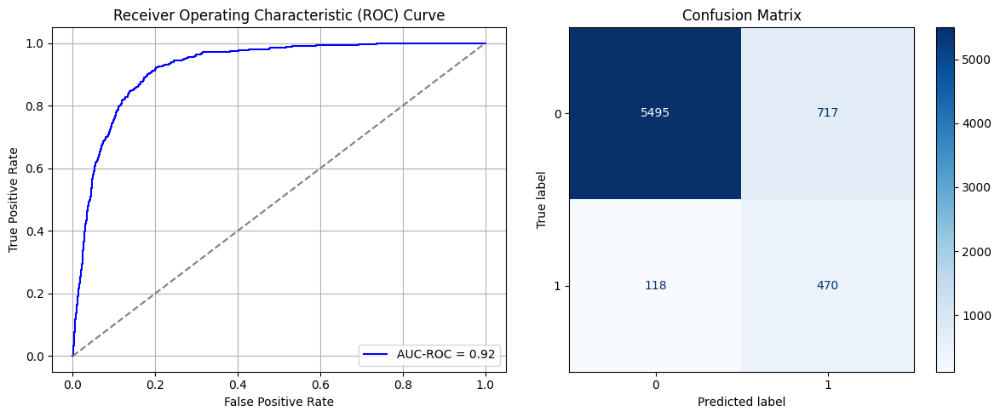

Best threshold based on F1-score: 0.9985036849975586
False Negative Rate: 0.20068027210884354
Time elapsed (performance): 1.7360378729999866
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.6486 - loss: 0.6605 - val_AUC: 0.7340 - val_loss: 0.6055
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7664 - loss: 0.5825 - val_AUC: 0.8373 - val_loss: 0.5146
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8445 - loss: 0.5016 - val_AUC: 0.8693 - val_loss: 0.4670
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8724 - loss: 0.4555 - val_AUC: 0.8754 - val_loss: 0.4471
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8828 - loss: 0.4333 - val_AUC: 0.8825 - val_loss: 0.4319
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8901 - loss: 0.4201 - val_AUC: 0.8814 - val_loss: 0.4317
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8846 - loss: 0.4293 - val_AUC: 0.8850 - val_loss: 0.4268
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8890 - loss: 0.4197 - val_AUC: 0.8841 - val_loss: 0.4269
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8833 -

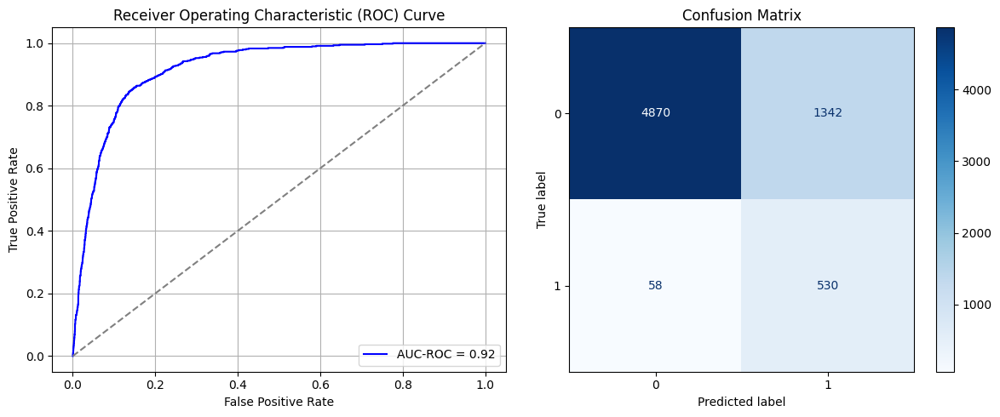

Best threshold based on F1-score: 0.7956234812736511
False Negative Rate: 0.09863945578231292
Time elapsed (performance): 1.2215108290001808
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6454 - loss: 0.6608 - val_AUC: 0.7674 - val_loss: 0.6003
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7940 - loss: 0.5589 - val_AUC: 0.8560 - val_loss: 0.4979
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8600 - loss: 0.4837 - val_AUC: 0.8715 - val_loss: 0.4602
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8763 - loss: 0.4504 - val_AUC: 0.8769 - val_loss: 0.4484
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8740 - loss: 0.4501 - val_AUC: 0.8812 - val_loss: 0.4574
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8857 - loss: 0.4314 - val_AUC: 0.8823 - val_loss: 0.4464
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8890 - loss: 0.4246 - val_AUC: 0.8847 - val_loss: 0.4312
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - AUC: 0.8811 - loss: 0.4333 - val_AUC: 0.8834 - val_loss: 0.4393
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8821 -

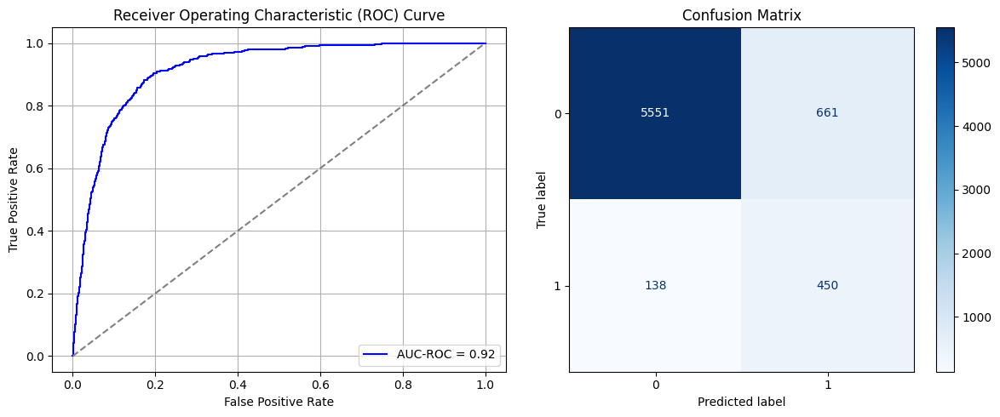

Best threshold based on F1-score: 0.9977902173995972
False Negative Rate: 0.23469387755102042
Time elapsed (performance): 1.0805395220004357
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6633 - loss: 0.6553 - val_AUC: 0.7639 - val_loss: 0.5856
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7877 - loss: 0.5657 - val_AUC: 0.8446 - val_loss: 0.5110
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8596 - loss: 0.4894 - val_AUC: 0.8697 - val_loss: 0.4679
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8756 - loss: 0.4521 - val_AUC: 0.8718 - val_loss: 0.4602
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8860 - loss: 0.4320 - val_AUC: 0.8730 - val_loss: 0.4669
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8780 - loss: 0.4431 - val_AUC: 0.8736 - val_loss: 0.4597
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8821 - loss: 0.4360 - val_AUC: 0.8760 - val_loss: 0.4487
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8789 - loss: 0.4410 - val_AUC: 0.8752 - val_loss: 0.4515
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8828 -

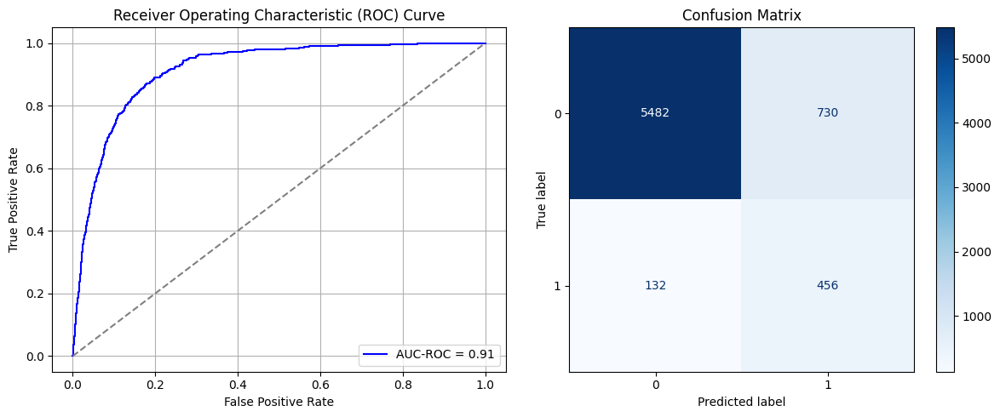

Best threshold based on F1-score: 0.6045418381690979
False Negative Rate: 0.22448979591836735
Time elapsed (performance): 0.9165129510001861
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6502 - loss: 0.6573 - val_AUC: 0.7689 - val_loss: 0.5829
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7938 - loss: 0.5597 - val_AUC: 0.8464 - val_loss: 0.5269
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8480 - loss: 0.4916 - val_AUC: 0.8659 - val_loss: 0.4692
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8730 - loss: 0.4536 - val_AUC: 0.8678 - val_loss: 0.4616
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8827 - loss: 0.4346 - val_AUC: 0.8724 - val_loss: 0.4607
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8805 - loss: 0.4393 - val_AUC: 0.8738 - val_loss: 0.4621
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8801 - loss: 0.4382 - val_AUC: 0.8743 - val_loss: 0.4506
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8844 - loss: 0.4284 - val_AUC: 0.8770 - val_loss: 0.4641
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8867 -

<ipython-input-76-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
AUC-ROC: 0.919315424173533
Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.83      0.90      6212
           1       0.33      0.87      0.47       588

    accuracy                           0.83      6800
   macro avg       0.66      0.85      0.69      6800
weighted avg       0.93      0.83      0.86      6800

FPR 0.1704764971023825 TPR: 0.8673469387755102 FNR: 0.1326530612244898 TNR: 0.8295235028976176


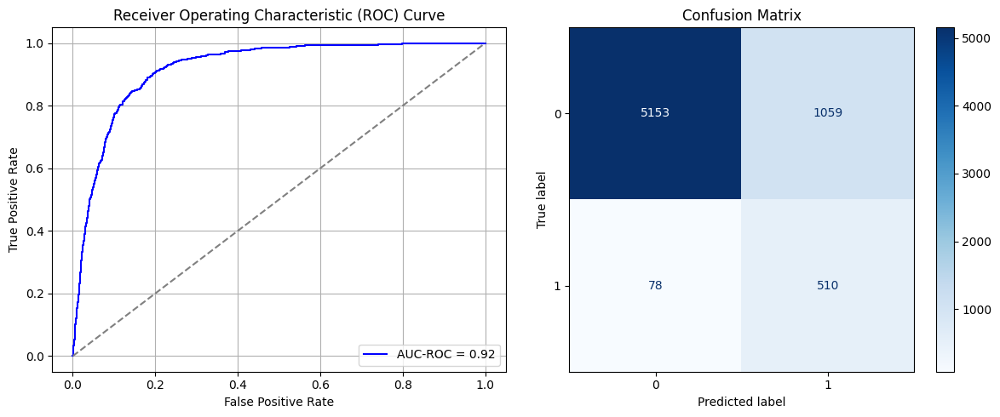

Best threshold based on F1-score: 0.9985914826393127
False Negative Rate: 0.1326530612244898
Time elapsed (performance): 1.1182748320006795
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6918 - loss: 0.6505 - val_AUC: 0.7829 - val_loss: 0.5699
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7810 - loss: 0.5667 - val_AUC: 0.8641 - val_loss: 0.4885
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8696 - loss: 0.4744 - val_AUC: 0.8834 - val_loss: 0.4571
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8733 - loss: 0.4567 - val_AUC: 0.8866 - val_loss: 0.4393
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8721 - loss: 0.4589 - val_AUC: 0.8886 - val_loss: 0.4332
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8841 - loss: 0.4371 - val_AUC: 0.8877 - val_loss: 0.4327
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8856 - loss: 0.4322 - val_AUC: 0.8905 - val_loss: 0.4261
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8794 - loss: 0.4420 - val_AUC: 0.8893 - val_loss: 0.4350
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8884 -

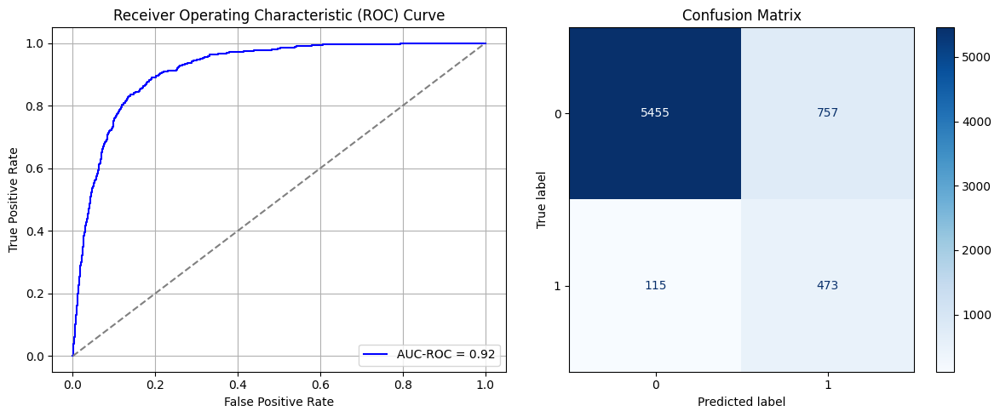

Best threshold based on F1-score: 0.6073389649391174
False Negative Rate: 0.195578231292517
Time elapsed (performance): 0.8907336540005417
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6489 - loss: 0.6569 - val_AUC: 0.7941 - val_loss: 0.5652
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8053 - loss: 0.5451 - val_AUC: 0.8618 - val_loss: 0.4827
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8635 - loss: 0.4775 - val_AUC: 0.8747 - val_loss: 0.4809
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8683 - loss: 0.4614 - val_AUC: 0.8817 - val_loss: 0.4479
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8782 - loss: 0.4438 - val_AUC: 0.8832 - val_loss: 0.4395
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8758 - loss: 0.4453 - val_AUC: 0.8837 - val_loss: 0.4408
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8816 - loss: 0.4364 - val_AUC: 0.8855 - val_loss: 0.4382
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8843 - loss: 0.4311 - val_AUC: 0.8857 - val_loss: 0.4318
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8809 -

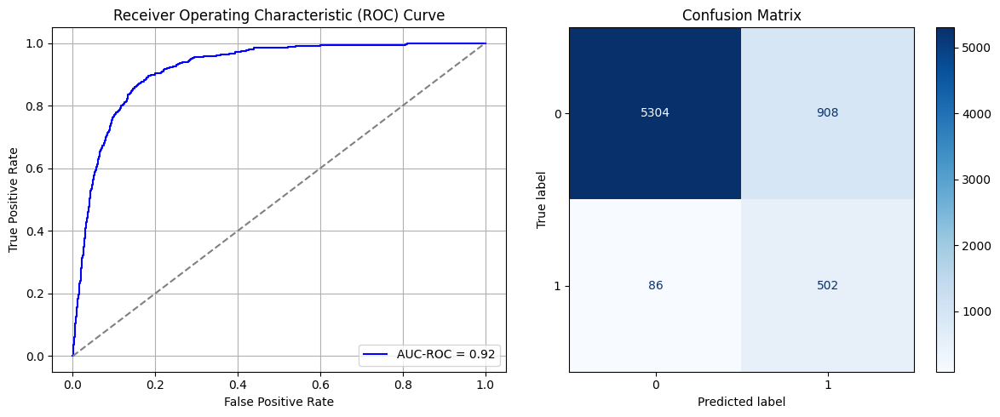

Best threshold based on F1-score: 0.998008131980896
False Negative Rate: 0.14625850340136054
Time elapsed (performance): 1.0731309230004626
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6329 - loss: 0.6640 - val_AUC: 0.7584 - val_loss: 0.5918
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.7868 - loss: 0.5645 - val_AUC: 0.8646 - val_loss: 0.5001
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8530 - loss: 0.4917 - val_AUC: 0.8751 - val_loss: 0.4546
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8735 - loss: 0.4526 - val_AUC: 0.8795 - val_loss: 0.4457
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8863 - loss: 0.4310 - val_AUC: 0.8819 - val_loss: 0.4386
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8790 - loss: 0.4417 - val_AUC: 0.8804 - val_loss: 0.4371
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8804 - loss: 0.4375 - val_AUC: 0.8829 - val_loss: 0.4421
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8821 - loss: 0.4362 - val_AUC: 0.8842 - val_loss: 0.4382
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8823 -

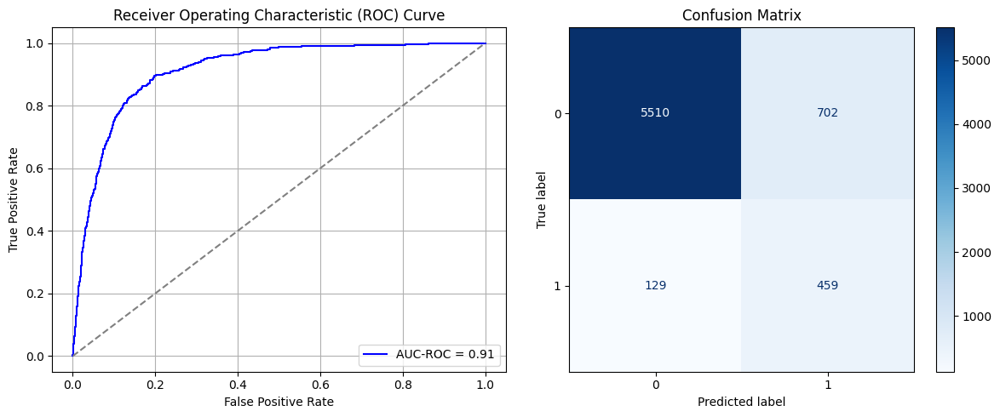

Best threshold based on F1-score: 0.6266550421714783
False Negative Rate: 0.2193877551020408
Time elapsed (performance): 1.0640587810003126
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 5s 8ms/step - AUC: 0.6697 - loss: 0.6509 - val_AUC: 0.7825 - val_loss: 0.5778
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.7924 - loss: 0.5607 - val_AUC: 0.8576 - val_loss: 0.4996
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8507 - loss: 0.4913 - val_AUC: 0.8731 - val_loss: 0.4661
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8689 - loss: 0.4581 - val_AUC: 0.8778 - val_loss: 0.4558
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8816 - loss: 0.4382 - val_AUC: 0.8800 - val_loss: 0.4426
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8885 - loss: 0.4236 - val_AUC: 0.8818 - val_loss: 0.4508
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8895 - loss: 0.4211 - val_AUC: 0.8826 - val_loss: 0.4358
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8866 - loss: 0.4243 - val_AUC: 0.8819 - val_loss: 0.4385
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8902 -

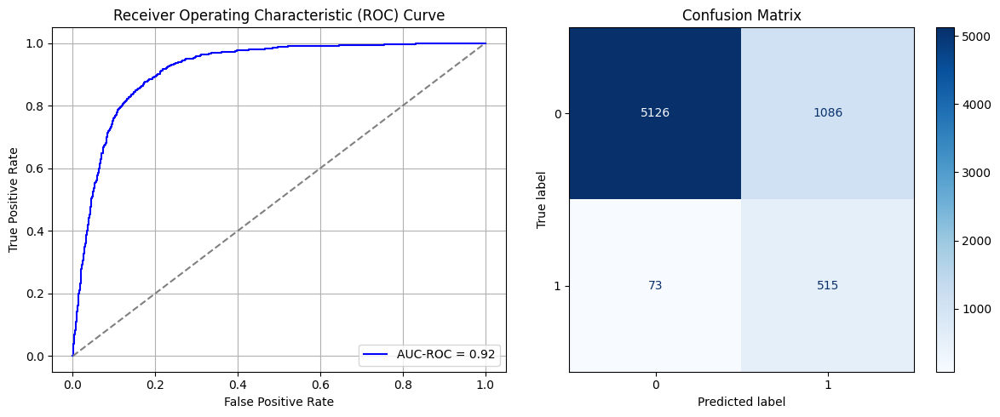

Best threshold based on F1-score: 0.9961090683937073
False Negative Rate: 0.12414965986394558
Time elapsed (performance): 1.483911261000685
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6325 - loss: 0.6691 - val_AUC: 0.7633 - val_loss: 0.5888
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.7954 - loss: 0.5569 - val_AUC: 0.8498 - val_loss: 0.5055
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8575 - loss: 0.4880 - val_AUC: 0.8716 - val_loss: 0.4641
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8778 - loss: 0.4448 - val_AUC: 0.8757 - val_loss: 0.4502
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8731 - loss: 0.4485 - val_AUC: 0.8795 - val_loss: 0.4433
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8842 - loss: 0.4288 - val_AUC: 0.8777 - val_loss: 0.4503
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8866 - loss: 0.4259 - val_AUC: 0.8796 - val_loss: 0.4383
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8865 - loss: 0.4236 - val_AUC: 0.8771 - val_loss: 0.4459
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8885 -

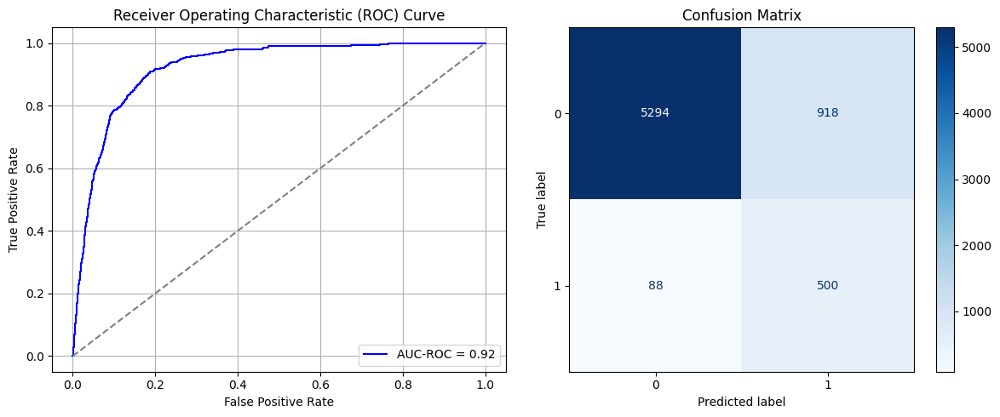

Best threshold based on F1-score: 0.9943692684173584
False Negative Rate: 0.14965986394557823
Time elapsed (performance): 0.9739845799995237
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6541 - loss: 0.6630 - val_AUC: 0.7637 - val_loss: 0.5848
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.7829 - loss: 0.5642 - val_AUC: 0.8547 - val_loss: 0.4944
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8605 - loss: 0.4772 - val_AUC: 0.8763 - val_loss: 0.4576
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8836 - loss: 0.4382 - val_AUC: 0.8765 - val_loss: 0.4597
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8831 - loss: 0.4352 - val_AUC: 0.8798 - val_loss: 0.4443
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8903 - loss: 0.4208 - val_AUC: 0.8773 - val_loss: 0.4597
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8888 - loss: 0.4241 - val_AUC: 0.8819 - val_loss: 0.4488
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8918 - loss: 0.4166 - val_AUC: 0.8814 - val_loss: 0.4390
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.8911 -

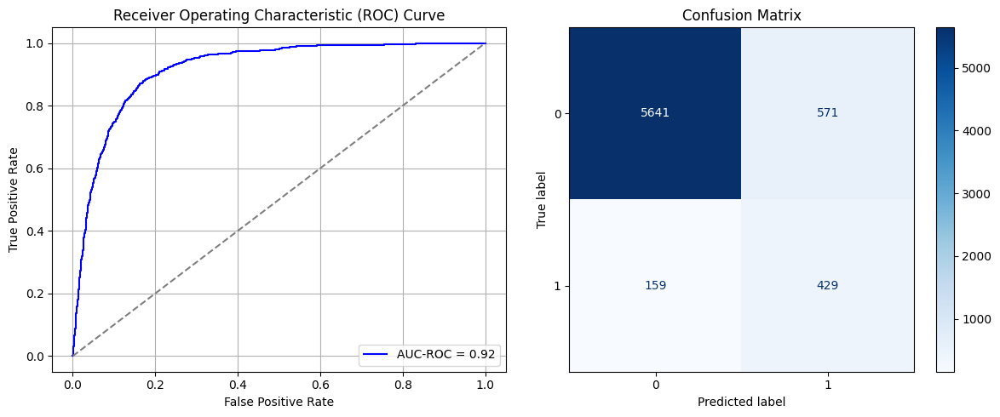

Best threshold based on F1-score: 0.9971553683280945
False Negative Rate: 0.27040816326530615
Time elapsed (performance): 1.0763709880002352
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6514 - loss: 0.6619 - val_AUC: 0.7674 - val_loss: 0.5883
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.7928 - loss: 0.5598 - val_AUC: 0.8472 - val_loss: 0.5068
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8421 - loss: 0.5027 - val_AUC: 0.8646 - val_loss: 0.5011
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8780 - loss: 0.4479 - val_AUC: 0.8743 - val_loss: 0.4542
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8839 - loss: 0.4341 - val_AUC: 0.8735 - val_loss: 0.4544
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8739 - loss: 0.4500 - val_AUC: 0.8770 - val_loss: 0.4445
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8882 - loss: 0.4241 - val_AUC: 0.8785 - val_loss: 0.4496
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8922 - loss: 0.4180 - val_AUC: 0.8781 - val_loss: 0.4426
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - AUC: 0.8870 -

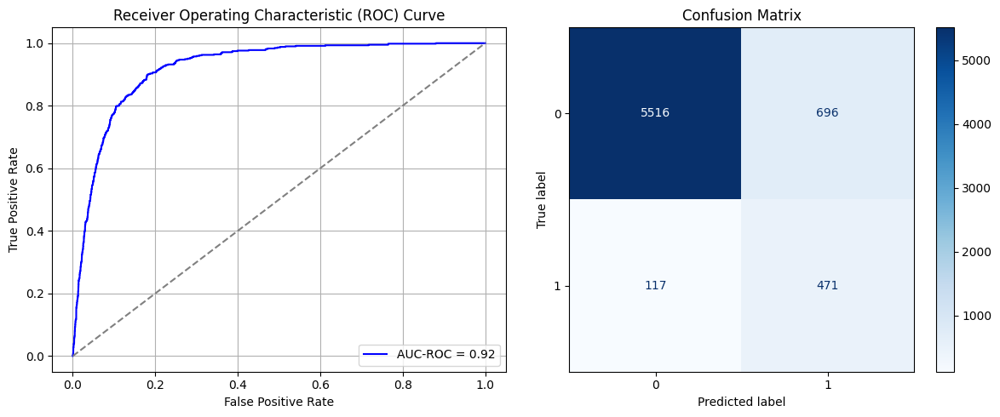

Best threshold based on F1-score: 0.9977167844772339
False Negative Rate: 0.1989795918367347
Time elapsed (performance): 0.9582399380005882
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6699 - loss: 0.6557 - val_AUC: 0.7461 - val_loss: 0.6036
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.7547 - loss: 0.5958 - val_AUC: 0.8298 - val_loss: 0.5346
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8334 - loss: 0.5213 - val_AUC: 0.8700 - val_loss: 0.4931
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8688 - loss: 0.4702 - val_AUC: 0.8719 - val_loss: 0.4545
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - AUC: 0.8703 - loss: 0.4644 - val_AUC: 0.8775 - val_loss: 0.4453
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8745 - loss: 0.4546 - val_AUC: 0.8786 - val_loss: 0.4419
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.8838 - loss: 0.4399 - val_AUC: 0.8794 - val_loss: 0.4400
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8789 - loss: 0.4486 - val_AUC: 0.8817 - val_loss: 0.4343
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8863 -

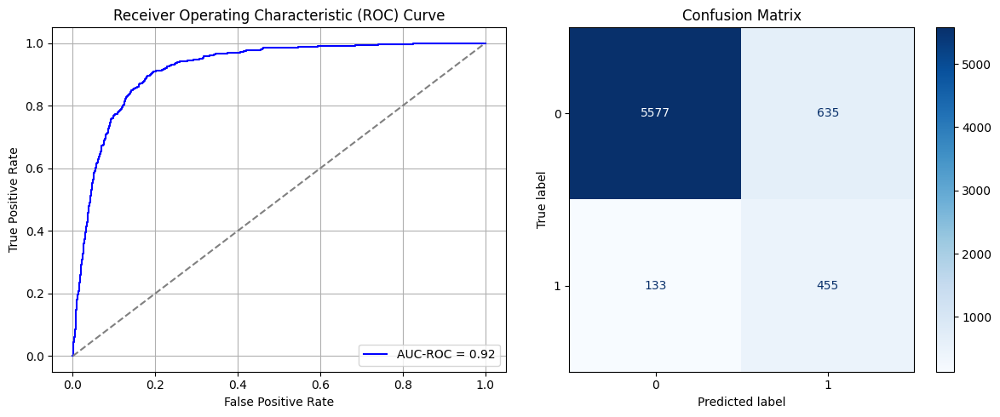

Best threshold based on F1-score: 0.9997881650924683
False Negative Rate: 0.2261904761904762
Time elapsed (performance): 0.957489058999272
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.5979 - loss: 0.6698 - val_AUC: 0.7684 - val_loss: 0.5899
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.7748 - loss: 0.5766 - val_AUC: 0.8360 - val_loss: 0.5165
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8488 - loss: 0.4955 - val_AUC: 0.8740 - val_loss: 0.4619
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8657 - loss: 0.4668 - val_AUC: 0.8776 - val_loss: 0.4494
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8767 - loss: 0.4461 - val_AUC: 0.8802 - val_loss: 0.4487
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8765 - loss: 0.4441 - val_AUC: 0.8803 - val_loss: 0.4399
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8811 - loss: 0.4351 - val_AUC: 0.8836 - val_loss: 0.4521
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8886 - loss: 0.4245 - val_AUC: 0.8858 - val_loss: 0.4326
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8810 -

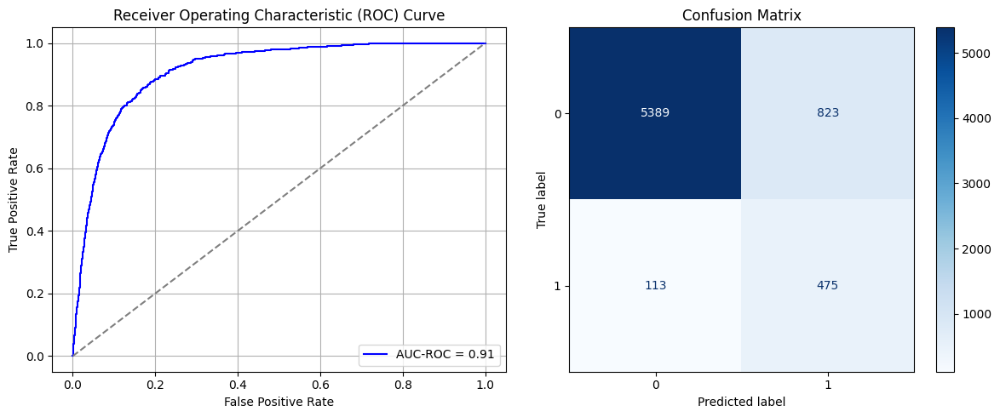

Best threshold based on F1-score: 0.6624525785446167
False Negative Rate: 0.1921768707482993
Time elapsed (performance): 1.082572648999303
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6469 - loss: 0.6617 - val_AUC: 0.7872 - val_loss: 0.5795
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.7982 - loss: 0.5574 - val_AUC: 0.8770 - val_loss: 0.4886
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8586 - loss: 0.4841 - val_AUC: 0.8841 - val_loss: 0.4465
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8712 - loss: 0.4585 - val_AUC: 0.8870 - val_loss: 0.4335
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8700 - loss: 0.4577 - val_AUC: 0.8853 - val_loss: 0.4397
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8668 - loss: 0.4606 - val_AUC: 0.8866 - val_loss: 0.4757
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8770 - loss: 0.4433 - val_AUC: 0.8901 - val_loss: 0.4254
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8742 - loss: 0.4470 - val_AUC: 0.8913 - val_loss: 0.4193
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8790 -

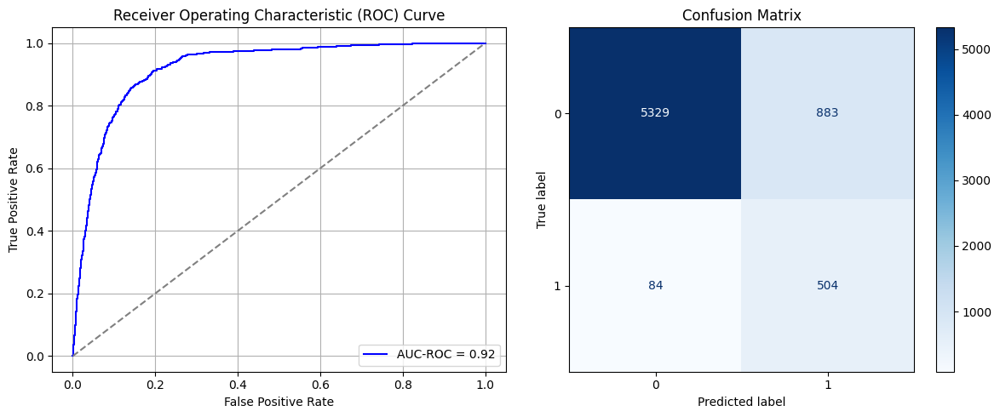

Best threshold based on F1-score: 0.9981366395950317
False Negative Rate: 0.14285714285714285
Time elapsed (performance): 1.0878792399998929
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6766 - loss: 0.6547 - val_AUC: 0.7625 - val_loss: 0.5876
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.7852 - loss: 0.5642 - val_AUC: 0.8437 - val_loss: 0.5193
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8593 - loss: 0.4849 - val_AUC: 0.8694 - val_loss: 0.4707
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8758 - loss: 0.4525 - val_AUC: 0.8749 - val_loss: 0.4540
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8804 - loss: 0.4397 - val_AUC: 0.8760 - val_loss: 0.4572
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8861 - loss: 0.4304 - val_AUC: 0.8759 - val_loss: 0.4488
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8869 - loss: 0.4268 - val_AUC: 0.8786 - val_loss: 0.4453
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8825 - loss: 0.4353 - val_AUC: 0.8762 - val_loss: 0.4469
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8893 -

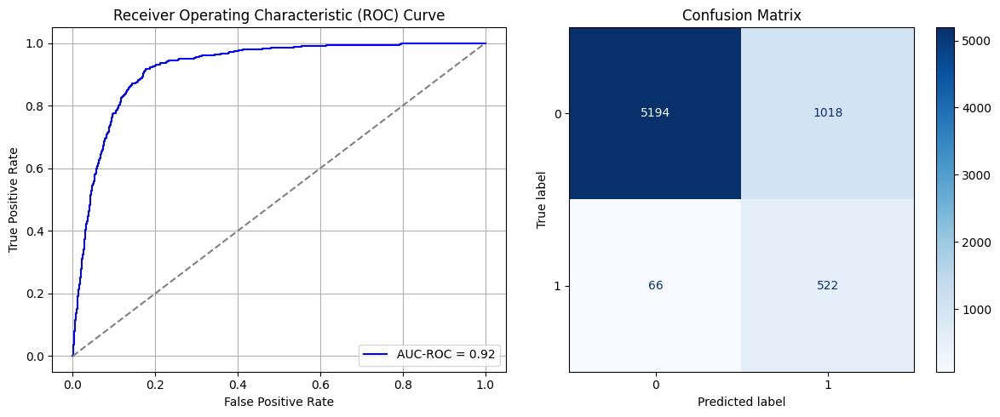

Best threshold based on F1-score: 0.9943152666091919
False Negative Rate: 0.11224489795918367
Time elapsed (performance): 0.9475681980002264


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


In [88]:
times = 50

Training_time = []
FPR = []
TPR = []
FNR = []
TNR = []
TL_time = []


for i in range(times):
    data_S_maj_rus = data_S_majority.sample(n=undersample_size, replace=False)
    data_S_SRS_RUS = pd.concat([data_S_maj_rus, data_S_minority])
    X_S_SRS = data_S_SRS_RUS.iloc[:, :-1]
    y_S_SRS = data_S_SRS_RUS.iloc[:, -1]
    X_S_train, X_S_test, y_S_train, y_S_test = train_test_split(X_S_SRS, y_S_SRS, test_size=0.20, random_state=0)
    model_SRS = create_dnn_model(X_S_train.shape[1])
    result_SRS = train_and_evaluate(model_SRS, X_S_train, X_S_test, y_S_train, y_S_test, "Source")
    result_TL_SRS = Transductive_TL(model_SRS, X_T_full, y_T_full, "Target")

    Training_time.append(result_SRS)
    FPR.append(result_TL_SRS[0])
    TNR.append(result_TL_SRS[1])
    FNR.append(result_TL_SRS[2])
    TPR.append(result_TL_SRS[3])
    TL_time.append(result_TL_SRS[4])

ParamFit = pd.DataFrame([Training_time, FPR, TPR, FNR, TNR, TL_time]).T
ParamFit.columns=['Source time', 'FPR', 'TPR', 'FNR', 'TNR', 'Target time']
# print(ParamFit)

In [89]:
print(ParamFit)
ParamFit.to_csv('SRS_RUS.csv')

    Source time       FPR       TPR       FNR       TNR  Target time
0     12.596636  0.098841  0.748299  0.251701  0.901159     0.764573
1     14.243331  0.104314  0.780612  0.219388  0.895686     0.984185
2     10.008150  0.131681  0.824830  0.175170  0.868319     0.772737
3     12.337391  0.174984  0.858844  0.141156  0.825016     0.789927
4     11.148867  0.120412  0.802721  0.197279  0.879588     0.767323
5     10.102469  0.144881  0.829932  0.170068  0.855119     0.789148
6      9.872483  0.105280  0.787415  0.212585  0.894720     0.785075
7      9.609812  0.154057  0.863946  0.136054  0.845943     1.042168
8     10.674996  0.129910  0.819728  0.180272  0.870090     1.046870
9      9.746573  0.138764  0.836735  0.163265  0.861236     0.781416
10    10.834248  0.132325  0.833333  0.166667  0.867675     0.974786
11     8.962771  0.108500  0.778912  0.221088  0.891500     0.926622
12    10.685052  0.132003  0.831633  0.168367  0.867997     0.801538
13    11.331186  0.127334  0.81802

## Simple Random Sampling with Replacement:

In [90]:
data_S
data_S_majority = data_S[data_S['Y'].isin([0])]
data_S_minority = data_S[data_S['Y'].isin([1])]

undersample_size = data_S_minority['Y'].size
oversample_size = data_S_majority['Y'].size

print(undersample_size)
print(oversample_size)

4433
31960


Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.6838 - loss: 0.6492 - val_AUC: 0.7555 - val_loss: 0.5964
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7811 - loss: 0.5702 - val_AUC: 0.8446 - val_loss: 0.5212
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8442 - loss: 0.5007 - val_AUC: 0.8695 - val_loss: 0.4860
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8578 - loss: 0.4788 - val_AUC: 0.8795 - val_loss: 0.4439
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8781 - loss: 0.4459 - val_AUC: 0.8838 - val_loss: 0.4349
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8727 - loss: 0.4504 - val_AUC: 0.8825 - val_loss: 0.4399
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8739 - loss: 0.4460 - val_AUC: 0.8852 - val_loss: 0.4312
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8850 - loss: 0.4279 - val_AUC: 0.8833 - val_loss: 0.4383
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8817 -

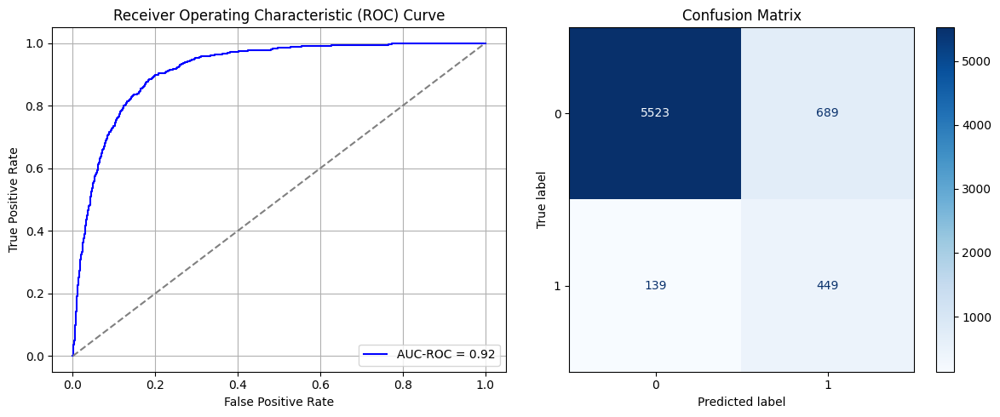

Best threshold based on F1-score: 0.5889469385147095
False Negative Rate: 0.23639455782312926
Time elapsed (performance): 1.0511431790000643
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6870 - loss: 0.6475 - val_AUC: 0.7724 - val_loss: 0.5808
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7858 - loss: 0.5653 - val_AUC: 0.8615 - val_loss: 0.4932
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8463 - loss: 0.5009 - val_AUC: 0.8856 - val_loss: 0.4391
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8743 - loss: 0.4551 - val_AUC: 0.8904 - val_loss: 0.4270
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8776 - loss: 0.4436 - val_AUC: 0.8933 - val_loss: 0.4208
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8886 - loss: 0.4270 - val_AUC: 0.8952 - val_loss: 0.4117
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8849 - loss: 0.4295 - val_AUC: 0.8920 - val_loss: 0.4151
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8894 - loss: 0.4216 - val_AUC: 0.8933 - val_loss: 0.4155
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8791 -

<ipython-input-76-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
AUC-ROC: 0.9187012135826642
Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.89      0.93      6212
           1       0.40      0.79      0.53       588

    accuracy                           0.88      6800
   macro avg       0.69      0.84      0.73      6800
weighted avg       0.93      0.88      0.90      6800

FPR 0.11059240180296201 TPR: 0.7874149659863946 FNR: 0.21258503401360543 TNR: 0.889407598197038


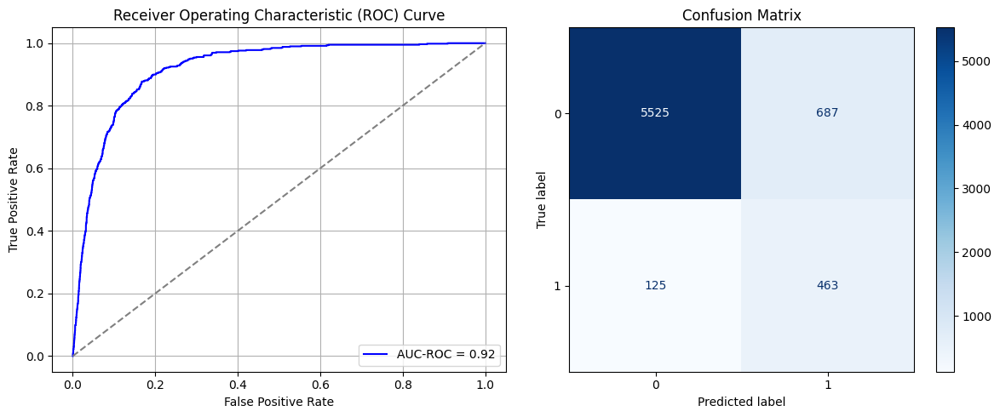

Best threshold based on F1-score: 0.6051921844482422
False Negative Rate: 0.21258503401360543
Time elapsed (performance): 0.7548415850005767
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6724 - loss: 0.6497 - val_AUC: 0.7891 - val_loss: 0.5681
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8045 - loss: 0.5482 - val_AUC: 0.8597 - val_loss: 0.4942
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8644 - loss: 0.4753 - val_AUC: 0.8727 - val_loss: 0.4575
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8705 - loss: 0.4567 - val_AUC: 0.8843 - val_loss: 0.4391
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8790 - loss: 0.4395 - val_AUC: 0.8832 - val_loss: 0.4325
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8872 - loss: 0.4238 - val_AUC: 0.8849 - val_loss: 0.4336
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8930 - loss: 0.4154 - val_AUC: 0.8840 - val_loss: 0.4287
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8919 - loss: 0.4147 - val_AUC: 0.8836 - val_loss: 0.4499
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8827 -

<ipython-input-76-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
AUC-ROC: 0.922189497176849
Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.84      0.91      6212
           1       0.35      0.87      0.50       588

    accuracy                           0.85      6800
   macro avg       0.67      0.86      0.70      6800
weighted avg       0.93      0.85      0.87      6800

FPR 0.15518351577591757 TPR: 0.8690476190476191 FNR: 0.13095238095238096 TNR: 0.8448164842240824


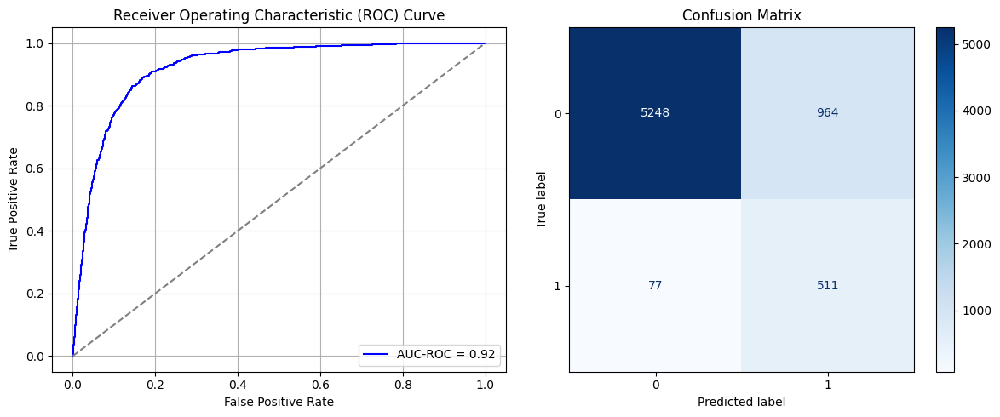

Best threshold based on F1-score: 0.9957543611526489
False Negative Rate: 0.13095238095238096
Time elapsed (performance): 0.7504743230001623
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6956 - loss: 0.6467 - val_AUC: 0.7822 - val_loss: 0.5769
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7922 - loss: 0.5586 - val_AUC: 0.8638 - val_loss: 0.4921
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8652 - loss: 0.4755 - val_AUC: 0.8812 - val_loss: 0.4660
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8727 - loss: 0.4564 - val_AUC: 0.8886 - val_loss: 0.4438
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8822 - loss: 0.4382 - val_AUC: 0.8901 - val_loss: 0.4302
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8785 - loss: 0.4433 - val_AUC: 0.8924 - val_loss: 0.4273
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8826 - loss: 0.4356 - val_AUC: 0.8947 - val_loss: 0.4218
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8922 - loss: 0.4167 - val_AUC: 0.8964 - val_loss: 0.4219
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8909 -

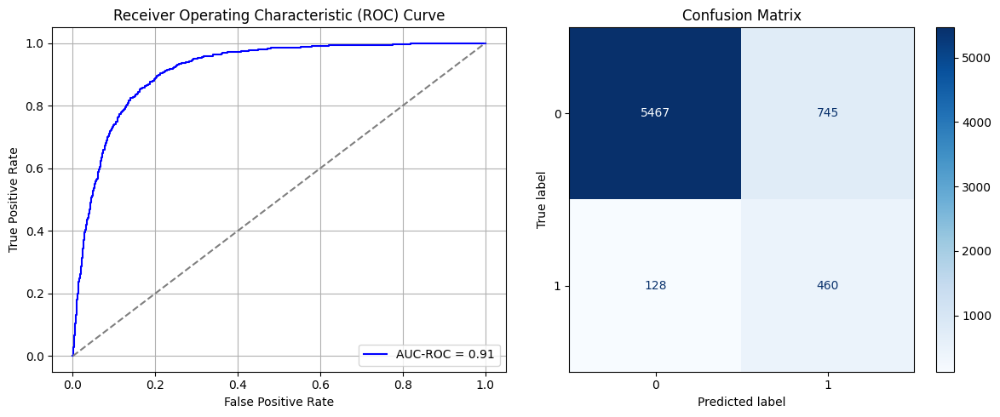

Best threshold based on F1-score: 0.9988102316856384
False Negative Rate: 0.21768707482993196
Time elapsed (performance): 1.217604577000202
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.6417 - loss: 0.6646 - val_AUC: 0.7767 - val_loss: 0.5773
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7773 - loss: 0.5726 - val_AUC: 0.8543 - val_loss: 0.4991
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8585 - loss: 0.4835 - val_AUC: 0.8747 - val_loss: 0.4557
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8693 - loss: 0.4596 - val_AUC: 0.8798 - val_loss: 0.4518
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8723 - loss: 0.4538 - val_AUC: 0.8826 - val_loss: 0.4374
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8739 - loss: 0.4481 - val_AUC: 0.8820 - val_loss: 0.4319
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8813 - loss: 0.4372 - val_AUC: 0.8796 - val_loss: 0.4359
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8768 - loss: 0.4421 - val_AUC: 0.8833 - val_loss: 0.4313
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8859 -

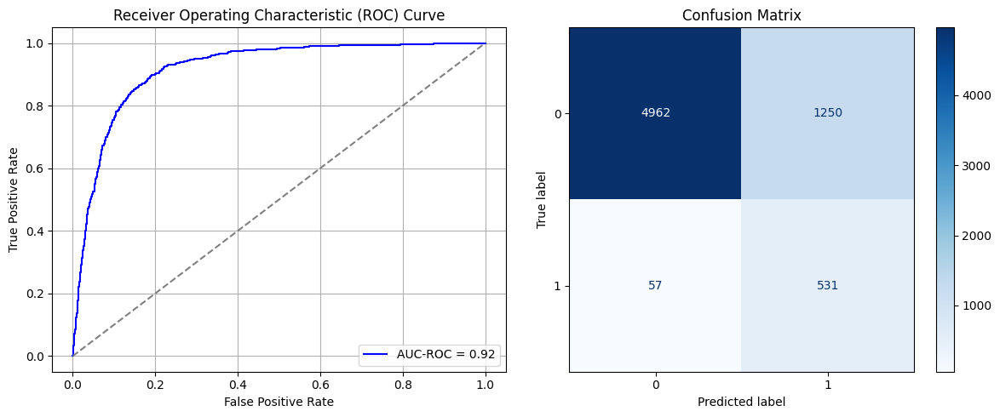

Best threshold based on F1-score: 0.9994297027587891
False Negative Rate: 0.09693877551020408
Time elapsed (performance): 0.7685588170006667
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - AUC: 0.6508 - loss: 0.6625 - val_AUC: 0.7728 - val_loss: 0.5810
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.7678 - loss: 0.5811 - val_AUC: 0.8510 - val_loss: 0.5093
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8598 - loss: 0.4832 - val_AUC: 0.8757 - val_loss: 0.4795
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8627 - loss: 0.4696 - val_AUC: 0.8822 - val_loss: 0.4464
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8710 - loss: 0.4557 - val_AUC: 0.8827 - val_loss: 0.4409
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8784 - loss: 0.4459 - val_AUC: 0.8813 - val_loss: 0.4414
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8737 - loss: 0.4498 - val_AUC: 0.8867 - val_loss: 0.4412
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8938 - loss: 0.4165 - val_AUC: 0.8845 - val_loss: 0.4537
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8810 -

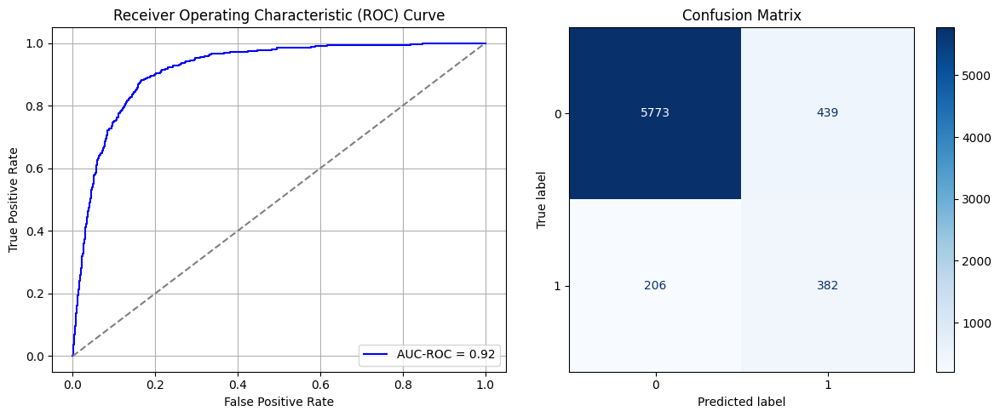

Best threshold based on F1-score: 0.5404671430587769
False Negative Rate: 0.35034013605442177
Time elapsed (performance): 0.7733890700001211
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6424 - loss: 0.6586 - val_AUC: 0.7562 - val_loss: 0.5907
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7758 - loss: 0.5716 - val_AUC: 0.8332 - val_loss: 0.5206
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8513 - loss: 0.4931 - val_AUC: 0.8705 - val_loss: 0.4634
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8746 - loss: 0.4526 - val_AUC: 0.8802 - val_loss: 0.4400
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8809 - loss: 0.4380 - val_AUC: 0.8855 - val_loss: 0.4355
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8744 - loss: 0.4463 - val_AUC: 0.8861 - val_loss: 0.4286
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8863 - loss: 0.4256 - val_AUC: 0.8877 - val_loss: 0.4298
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8864 - loss: 0.4281 - val_AUC: 0.8900 - val_loss: 0.4188
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8854 -

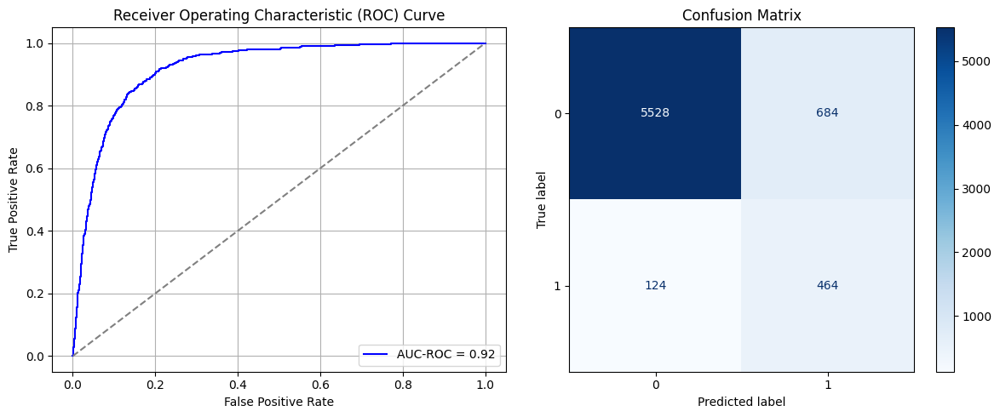

Best threshold based on F1-score: 0.995786726474762
False Negative Rate: 0.2108843537414966
Time elapsed (performance): 2.533428394999646
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.6456 - loss: 0.6618 - val_AUC: 0.7522 - val_loss: 0.5947
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.7718 - loss: 0.5756 - val_AUC: 0.8465 - val_loss: 0.5154
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8384 - loss: 0.5124 - val_AUC: 0.8715 - val_loss: 0.4642
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8603 - loss: 0.4758 - val_AUC: 0.8784 - val_loss: 0.4466
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8757 - loss: 0.4524 - val_AUC: 0.8830 - val_loss: 0.4523
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8744 - loss: 0.4525 - val_AUC: 0.8799 - val_loss: 0.4515
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8707 - loss: 0.4596 - val_AUC: 0.8835 - val_loss: 0.4440
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8745 - loss: 0.4491 - val_AUC: 0.8852 - val_loss: 0.4375
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8834 -

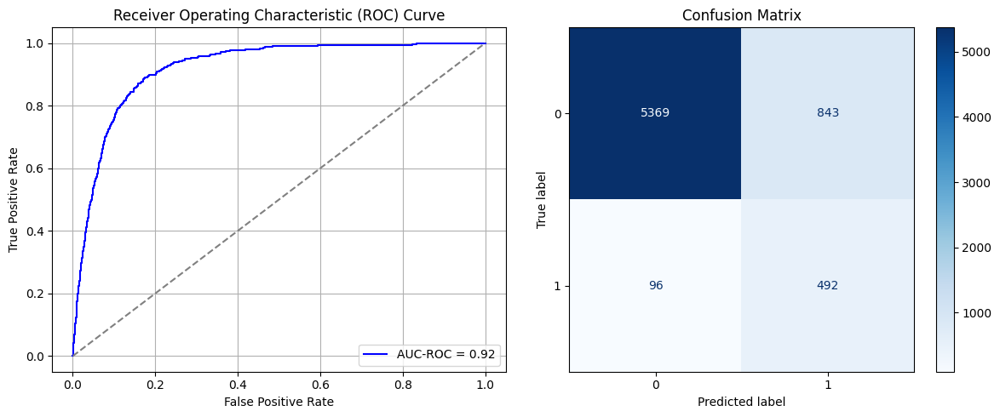

Best threshold based on F1-score: 0.9954600930213928
False Negative Rate: 0.16326530612244897
Time elapsed (performance): 1.0675434749991837
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - AUC: 0.6443 - loss: 0.6586 - val_AUC: 0.7782 - val_loss: 0.5747
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7969 - loss: 0.5532 - val_AUC: 0.8591 - val_loss: 0.4928
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8585 - loss: 0.4869 - val_AUC: 0.8797 - val_loss: 0.4487
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8763 - loss: 0.4488 - val_AUC: 0.8871 - val_loss: 0.4353
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8805 - loss: 0.4410 - val_AUC: 0.8880 - val_loss: 0.4245
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8761 - loss: 0.4443 - val_AUC: 0.8881 - val_loss: 0.4232
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8856 - loss: 0.4288 - val_AUC: 0.8912 - val_loss: 0.4211
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8905 - loss: 0.4178 - val_AUC: 0.8905 - val_loss: 0.4225
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8884 -

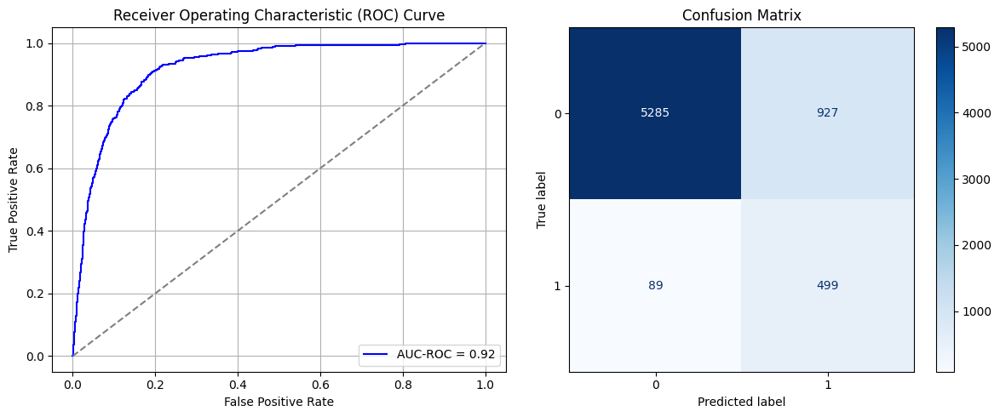

Best threshold based on F1-score: 0.9902454614639282
False Negative Rate: 0.15136054421768708
Time elapsed (performance): 1.00268540199977
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.6858 - loss: 0.6493 - val_AUC: 0.7798 - val_loss: 0.5765
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7973 - loss: 0.5546 - val_AUC: 0.8549 - val_loss: 0.5005
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8637 - loss: 0.4789 - val_AUC: 0.8683 - val_loss: 0.4695
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8786 - loss: 0.4535 - val_AUC: 0.8706 - val_loss: 0.4652
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8830 - loss: 0.4402 - val_AUC: 0.8726 - val_loss: 0.4655
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8901 - loss: 0.4300 - val_AUC: 0.8745 - val_loss: 0.4522
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8849 - loss: 0.4339 - val_AUC: 0.8757 - val_loss: 0.4551
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8814 - loss: 0.4430 - val_AUC: 0.8751 - val_loss: 0.4488
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8901 -

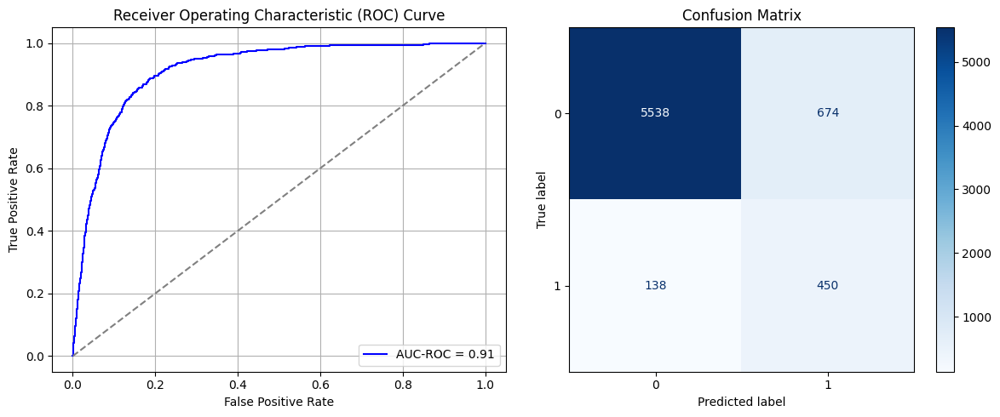

Best threshold based on F1-score: 0.9978319406509399
False Negative Rate: 0.23469387755102042
Time elapsed (performance): 1.1860490810004194
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.6619 - loss: 0.6544 - val_AUC: 0.7871 - val_loss: 0.5657
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8106 - loss: 0.5402 - val_AUC: 0.8471 - val_loss: 0.5175
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8581 - loss: 0.4787 - val_AUC: 0.8688 - val_loss: 0.4698
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8777 - loss: 0.4463 - val_AUC: 0.8716 - val_loss: 0.4628
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8789 - loss: 0.4451 - val_AUC: 0.8750 - val_loss: 0.4601
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8777 - loss: 0.4495 - val_AUC: 0.8743 - val_loss: 0.4613
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8791 - loss: 0.4446 - val_AUC: 0.8757 - val_loss: 0.4538
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8872 - loss: 0.4313 - val_AUC: 0.8761 - val_loss: 0.4579
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8837 -

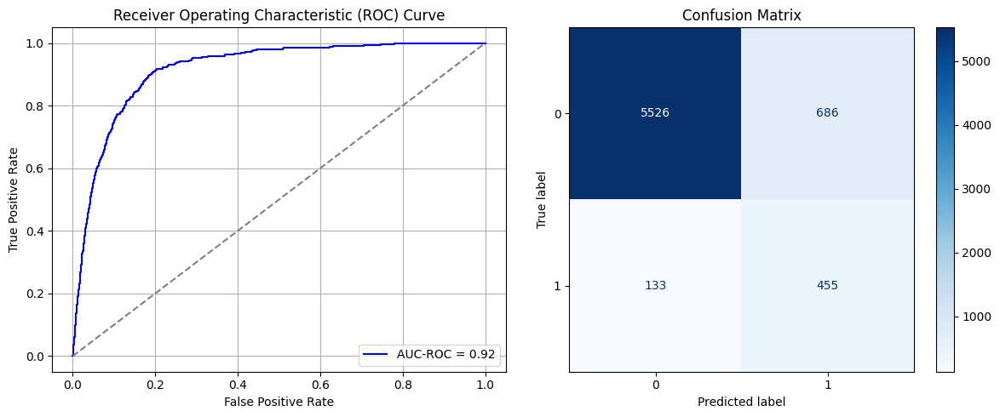

Best threshold based on F1-score: 0.9995903968811035
False Negative Rate: 0.2261904761904762
Time elapsed (performance): 1.2582496320001155
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.6722 - loss: 0.6546 - val_AUC: 0.7849 - val_loss: 0.5722
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8009 - loss: 0.5532 - val_AUC: 0.8586 - val_loss: 0.4909
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8557 - loss: 0.4837 - val_AUC: 0.8733 - val_loss: 0.4566
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8691 - loss: 0.4613 - val_AUC: 0.8783 - val_loss: 0.4449
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8737 - loss: 0.4500 - val_AUC: 0.8794 - val_loss: 0.4548
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8836 - loss: 0.4372 - val_AUC: 0.8790 - val_loss: 0.4492
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8819 - loss: 0.4356 - val_AUC: 0.8819 - val_loss: 0.4436
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8886 - loss: 0.4258 - val_AUC: 0.8827 - val_loss: 0.4362
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8859 -

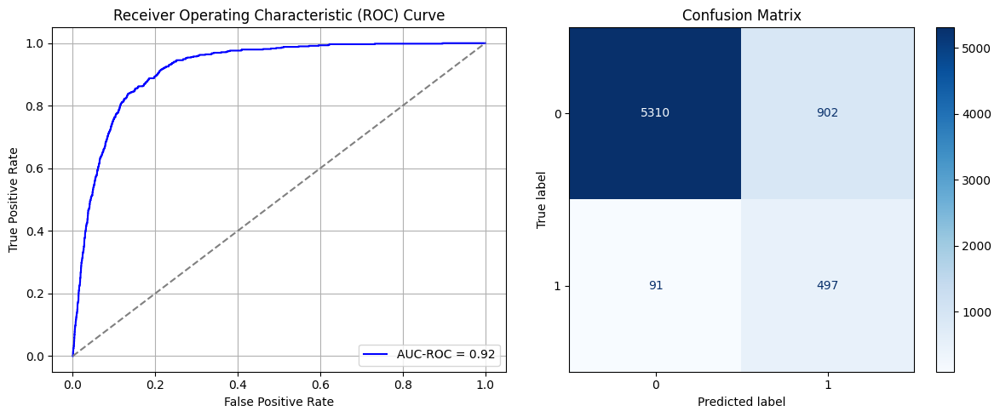

Best threshold based on F1-score: 0.707778811454773
False Negative Rate: 0.15476190476190477
Time elapsed (performance): 1.0861399989998972
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6602 - loss: 0.6593 - val_AUC: 0.7554 - val_loss: 0.5925
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7603 - loss: 0.5846 - val_AUC: 0.8398 - val_loss: 0.5207
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8504 - loss: 0.4959 - val_AUC: 0.8705 - val_loss: 0.4796
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8529 - loss: 0.4844 - val_AUC: 0.8732 - val_loss: 0.4628
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8694 - loss: 0.4577 - val_AUC: 0.8738 - val_loss: 0.4522
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8679 - loss: 0.4599 - val_AUC: 0.8732 - val_loss: 0.4589
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8697 - loss: 0.4549 - val_AUC: 0.8751 - val_loss: 0.4462
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8726 - loss: 0.4497 - val_AUC: 0.8753 - val_loss: 0.4496
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8768 -

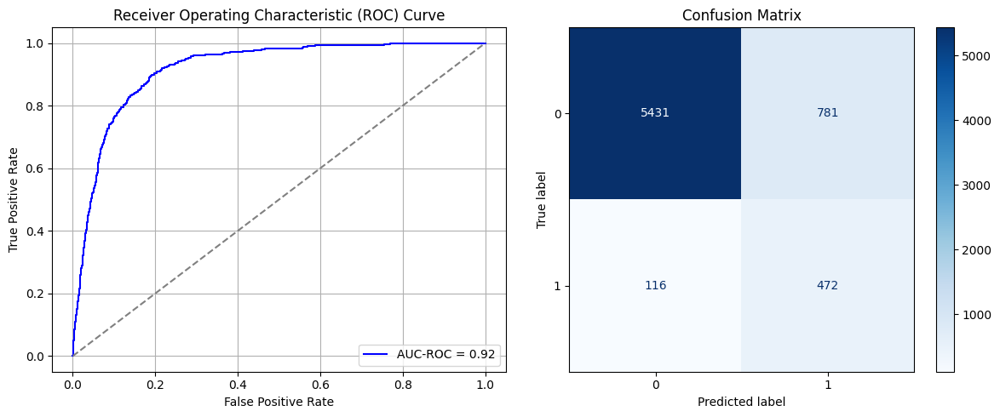

Best threshold based on F1-score: 0.6101605296134949
False Negative Rate: 0.19727891156462585
Time elapsed (performance): 0.7902817920003145
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6402 - loss: 0.6623 - val_AUC: 0.7393 - val_loss: 0.6047
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7735 - loss: 0.5774 - val_AUC: 0.8324 - val_loss: 0.5242
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8407 - loss: 0.5032 - val_AUC: 0.8691 - val_loss: 0.4703
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8678 - loss: 0.4632 - val_AUC: 0.8757 - val_loss: 0.4484
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8768 - loss: 0.4459 - val_AUC: 0.8796 - val_loss: 0.4523
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8871 - loss: 0.4270 - val_AUC: 0.8816 - val_loss: 0.4408
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8863 - loss: 0.4263 - val_AUC: 0.8826 - val_loss: 0.4344
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8850 - loss: 0.4275 - val_AUC: 0.8852 - val_loss: 0.4298
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8905 -

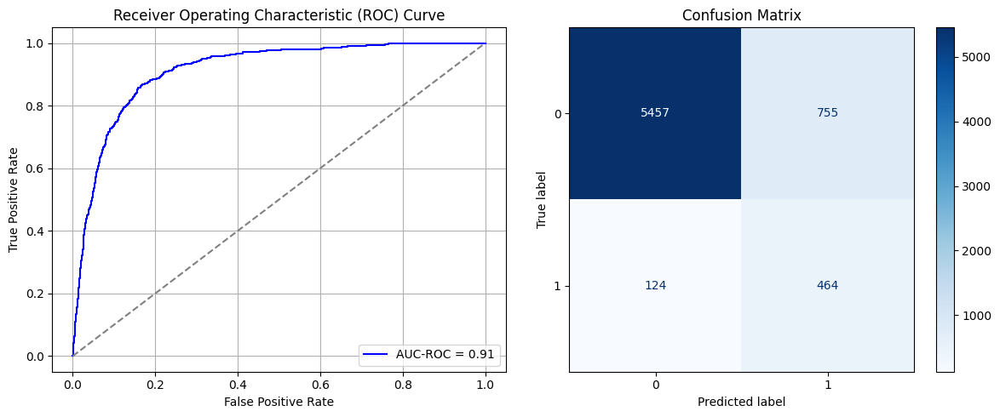

Best threshold based on F1-score: 0.9983001351356506
False Negative Rate: 0.2108843537414966
Time elapsed (performance): 0.8385270349999701
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6496 - loss: 0.6547 - val_AUC: 0.7738 - val_loss: 0.5778
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7843 - loss: 0.5649 - val_AUC: 0.8557 - val_loss: 0.5249
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8441 - loss: 0.4983 - val_AUC: 0.8748 - val_loss: 0.4592
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8797 - loss: 0.4445 - val_AUC: 0.8807 - val_loss: 0.4441
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8861 - loss: 0.4296 - val_AUC: 0.8835 - val_loss: 0.4457
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8819 - loss: 0.4433 - val_AUC: 0.8810 - val_loss: 0.4413
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8838 - loss: 0.4324 - val_AUC: 0.8833 - val_loss: 0.4375
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8921 - loss: 0.4196 - val_AUC: 0.8841 - val_loss: 0.4426
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8821 -

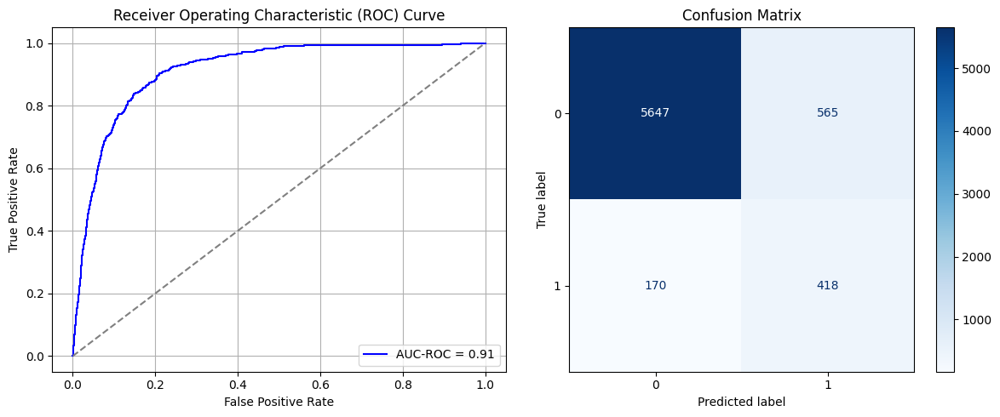

Best threshold based on F1-score: 0.9974294900894165
False Negative Rate: 0.2891156462585034
Time elapsed (performance): 1.0623477030003414
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.6857 - loss: 0.6486 - val_AUC: 0.7462 - val_loss: 0.5927
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7908 - loss: 0.5571 - val_AUC: 0.8418 - val_loss: 0.5017
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8651 - loss: 0.4723 - val_AUC: 0.8714 - val_loss: 0.4635
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8826 - loss: 0.4389 - val_AUC: 0.8697 - val_loss: 0.4601
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8855 - loss: 0.4336 - val_AUC: 0.8714 - val_loss: 0.4603
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8883 - loss: 0.4264 - val_AUC: 0.8737 - val_loss: 0.4529
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8838 - loss: 0.4308 - val_AUC: 0.8740 - val_loss: 0.4624
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8949 - loss: 0.4158 - val_AUC: 0.8746 - val_loss: 0.4489
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8816 -

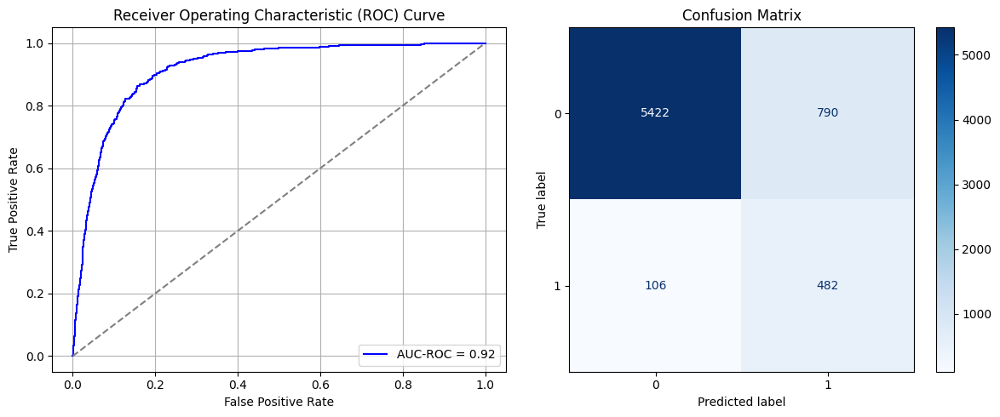

Best threshold based on F1-score: 0.9992124438285828
False Negative Rate: 0.18027210884353742
Time elapsed (performance): 0.8168115940006828
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6516 - loss: 0.6617 - val_AUC: 0.7552 - val_loss: 0.5954
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7817 - loss: 0.5705 - val_AUC: 0.8300 - val_loss: 0.5149
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8549 - loss: 0.4833 - val_AUC: 0.8631 - val_loss: 0.4758
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8714 - loss: 0.4535 - val_AUC: 0.8654 - val_loss: 0.4630
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8696 - loss: 0.4543 - val_AUC: 0.8725 - val_loss: 0.4509
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8809 - loss: 0.4351 - val_AUC: 0.8729 - val_loss: 0.4505
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8853 - loss: 0.4282 - val_AUC: 0.8753 - val_loss: 0.4465
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8831 - loss: 0.4304 - val_AUC: 0.8773 - val_loss: 0.4418
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8805 -

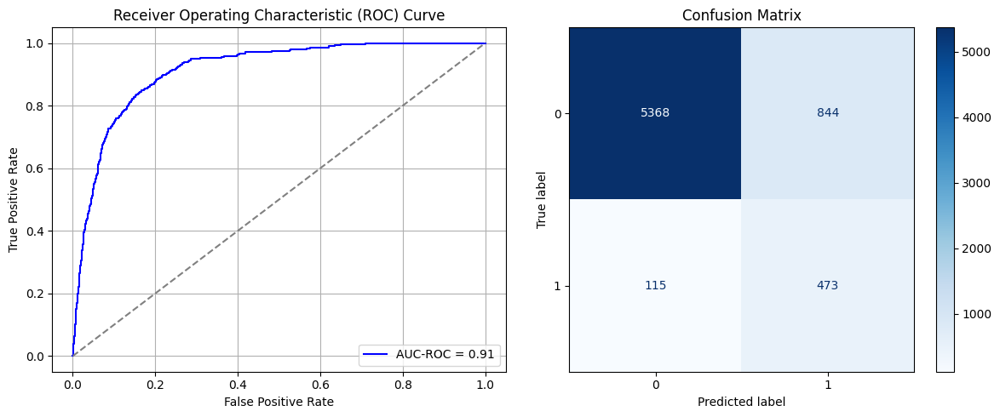

Best threshold based on F1-score: 0.6903166174888611
False Negative Rate: 0.195578231292517
Time elapsed (performance): 1.0615432610002244
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6660 - loss: 0.6600 - val_AUC: 0.7673 - val_loss: 0.5888
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7754 - loss: 0.5767 - val_AUC: 0.8511 - val_loss: 0.5096
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8495 - loss: 0.5015 - val_AUC: 0.8780 - val_loss: 0.4597
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8673 - loss: 0.4678 - val_AUC: 0.8803 - val_loss: 0.4434
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8735 - loss: 0.4529 - val_AUC: 0.8852 - val_loss: 0.4562
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8759 - loss: 0.4478 - val_AUC: 0.8857 - val_loss: 0.4331
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8788 - loss: 0.4404 - val_AUC: 0.8864 - val_loss: 0.4407
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8762 - loss: 0.4423 - val_AUC: 0.8889 - val_loss: 0.4220
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8871 -

<ipython-input-76-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
AUC-ROC: 0.9205282402722841
Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.85      0.91      6212
           1       0.35      0.84      0.50       588

    accuracy                           0.85      6800
   macro avg       0.67      0.85      0.71      6800
weighted avg       0.93      0.85      0.88      6800

FPR 0.14536381197681905 TPR: 0.8418367346938775 FNR: 0.15816326530612246 TNR: 0.854636188023181


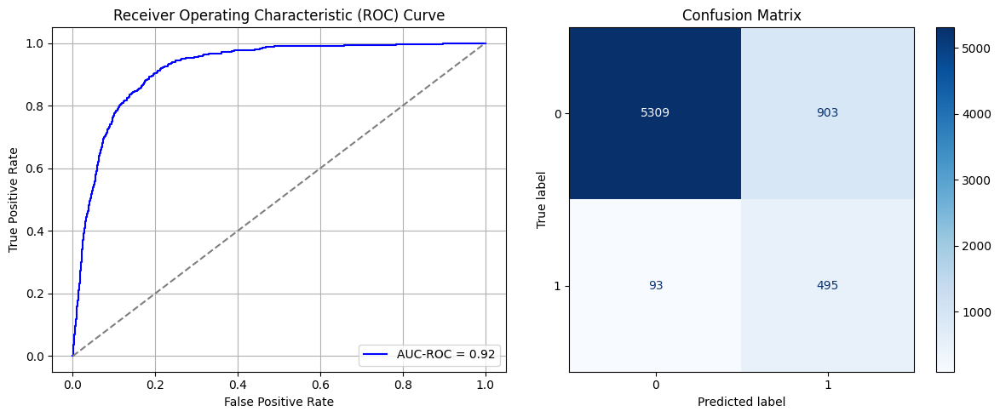

Best threshold based on F1-score: 0.9965648055076599
False Negative Rate: 0.15816326530612246
Time elapsed (performance): 1.0691443059995436
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6651 - loss: 0.6498 - val_AUC: 0.7816 - val_loss: 0.5713
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8041 - loss: 0.5461 - val_AUC: 0.8491 - val_loss: 0.5071
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8632 - loss: 0.4752 - val_AUC: 0.8660 - val_loss: 0.4755
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8666 - loss: 0.4659 - val_AUC: 0.8650 - val_loss: 0.4661
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8736 - loss: 0.4516 - val_AUC: 0.8692 - val_loss: 0.4583
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8835 - loss: 0.4353 - val_AUC: 0.8700 - val_loss: 0.4547
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8864 - loss: 0.4318 - val_AUC: 0.8703 - val_loss: 0.4525
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8830 - loss: 0.4359 - val_AUC: 0.8739 - val_loss: 0.4458
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8818 -

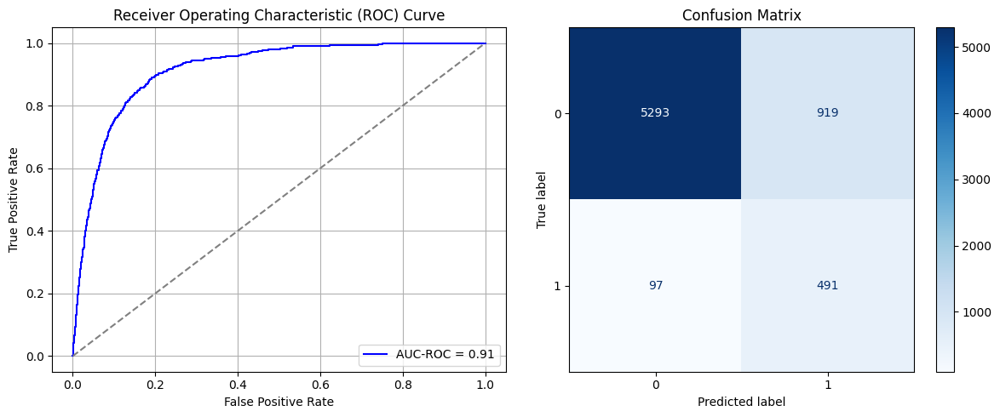

Best threshold based on F1-score: 0.996809184551239
False Negative Rate: 0.1649659863945578
Time elapsed (performance): 1.05233340399991
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6309 - loss: 0.6646 - val_AUC: 0.7601 - val_loss: 0.5848
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7970 - loss: 0.5530 - val_AUC: 0.8501 - val_loss: 0.5000
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8481 - loss: 0.4929 - val_AUC: 0.8674 - val_loss: 0.4708
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8700 - loss: 0.4593 - val_AUC: 0.8701 - val_loss: 0.4581
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8683 - loss: 0.4579 - val_AUC: 0.8733 - val_loss: 0.4534
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8814 - loss: 0.4374 - val_AUC: 0.8745 - val_loss: 0.4746
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8763 - loss: 0.4451 - val_AUC: 0.8742 - val_loss: 0.4729
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8762 - loss: 0.4476 - val_AUC: 0.8768 - val_loss: 0.4448
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8826 -

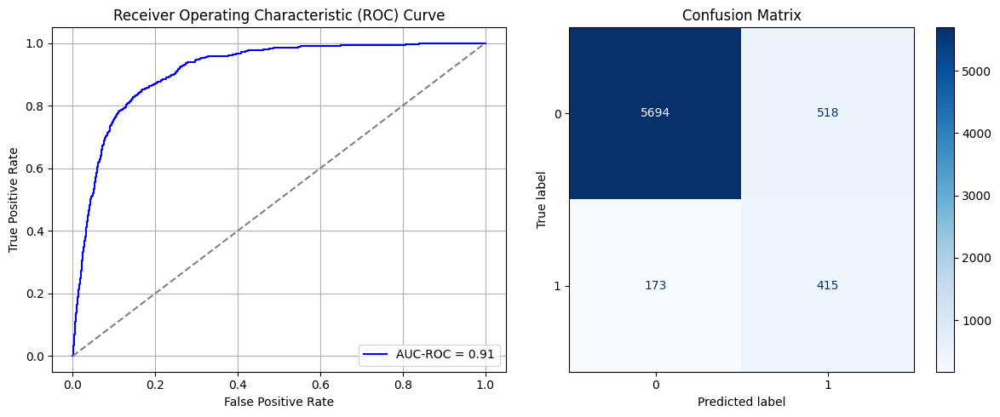

Best threshold based on F1-score: 0.9968141913414001
False Negative Rate: 0.2942176870748299
Time elapsed (performance): 1.0524985419997392
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6363 - loss: 0.6620 - val_AUC: 0.7794 - val_loss: 0.5723
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.7867 - loss: 0.5612 - val_AUC: 0.8539 - val_loss: 0.4982
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8546 - loss: 0.4816 - val_AUC: 0.8826 - val_loss: 0.4416
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8766 - loss: 0.4479 - val_AUC: 0.8871 - val_loss: 0.4506
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8762 - loss: 0.4459 - val_AUC: 0.8903 - val_loss: 0.4268
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8770 - loss: 0.4455 - val_AUC: 0.8913 - val_loss: 0.4213
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8910 - loss: 0.4216 - val_AUC: 0.8905 - val_loss: 0.4280
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8841 - loss: 0.4317 - val_AUC: 0.8929 - val_loss: 0.4212
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8766 -

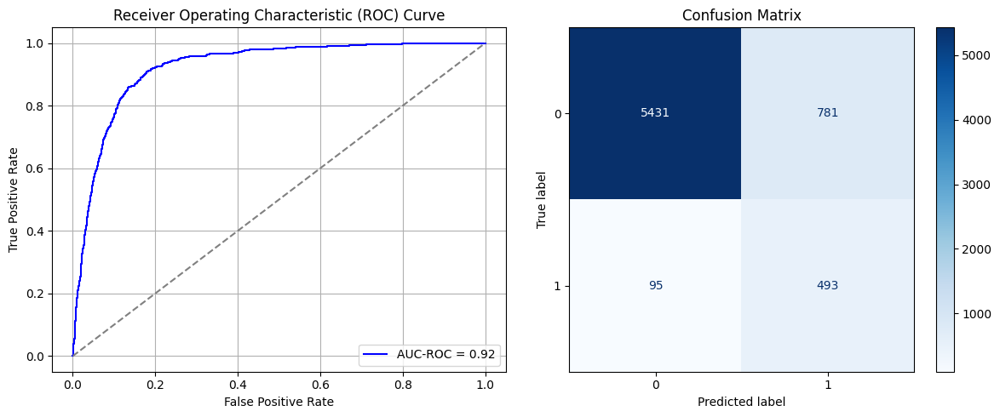

Best threshold based on F1-score: 0.6612858772277832
False Negative Rate: 0.16156462585034015
Time elapsed (performance): 0.8257886270002928
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6721 - loss: 0.6514 - val_AUC: 0.7730 - val_loss: 0.5750
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.7946 - loss: 0.5542 - val_AUC: 0.8513 - val_loss: 0.4880
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8563 - loss: 0.4788 - val_AUC: 0.8756 - val_loss: 0.4502
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8841 - loss: 0.4331 - val_AUC: 0.8812 - val_loss: 0.4425
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8812 - loss: 0.4356 - val_AUC: 0.8824 - val_loss: 0.4444
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8873 - loss: 0.4233 - val_AUC: 0.8853 - val_loss: 0.4279
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8815 - loss: 0.4311 - val_AUC: 0.8857 - val_loss: 0.4237
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8874 - loss: 0.4219 - val_AUC: 0.8844 - val_loss: 0.4275
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8911 -

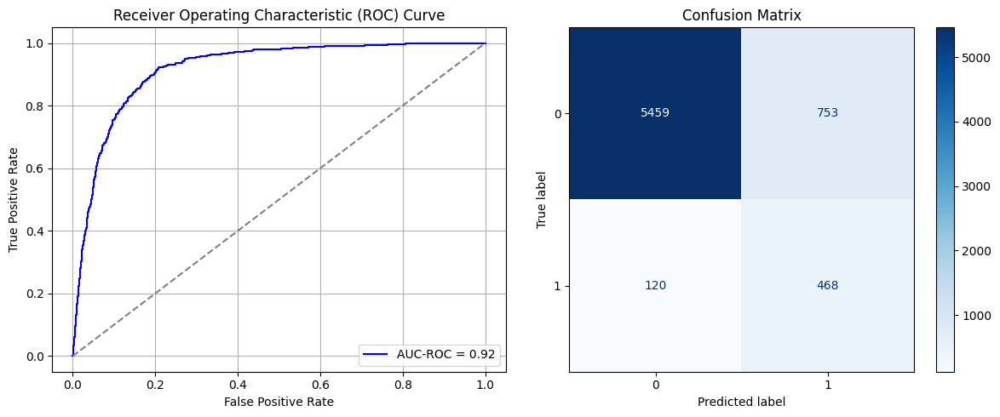

Best threshold based on F1-score: 0.6688039302825928
False Negative Rate: 0.20408163265306123
Time elapsed (performance): 0.822840812999857
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - AUC: 0.6561 - loss: 0.6609 - val_AUC: 0.7628 - val_loss: 0.5865
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.7855 - loss: 0.5665 - val_AUC: 0.8725 - val_loss: 0.4903
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8500 - loss: 0.4986 - val_AUC: 0.8866 - val_loss: 0.4596
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8650 - loss: 0.4681 - val_AUC: 0.8893 - val_loss: 0.4605
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8693 - loss: 0.4586 - val_AUC: 0.8924 - val_loss: 0.4429
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8753 - loss: 0.4479 - val_AUC: 0.8896 - val_loss: 0.4286
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8738 - loss: 0.4487 - val_AUC: 0.8953 - val_loss: 0.4227
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8847 - loss: 0.4328 - val_AUC: 0.8912 - val_loss: 0.4235
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8875 -

<ipython-input-76-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
AUC-ROC: 0.9201608363886444
Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.86      0.92      6212
           1       0.37      0.84      0.51       588

    accuracy                           0.86      6800
   macro avg       0.68      0.85      0.72      6800
weighted avg       0.93      0.86      0.88      6800

FPR 0.13715389568576947 TPR: 0.8435374149659864 FNR: 0.1564625850340136 TNR: 0.8628461043142306


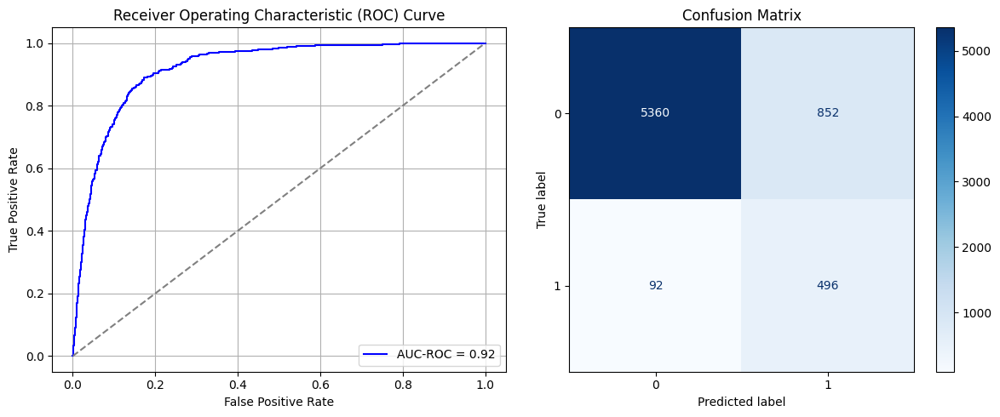

Best threshold based on F1-score: 0.9966138005256653
False Negative Rate: 0.1564625850340136
Time elapsed (performance): 0.8293166150006073
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6508 - loss: 0.6605 - val_AUC: 0.7759 - val_loss: 0.5764
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.7880 - loss: 0.5668 - val_AUC: 0.8515 - val_loss: 0.4968
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8498 - loss: 0.4942 - val_AUC: 0.8683 - val_loss: 0.4630
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8649 - loss: 0.4693 - val_AUC: 0.8701 - val_loss: 0.4545
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8708 - loss: 0.4580 - val_AUC: 0.8708 - val_loss: 0.4538
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8670 - loss: 0.4595 - val_AUC: 0.8705 - val_loss: 0.4605
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8725 - loss: 0.4501 - val_AUC: 0.8722 - val_loss: 0.4543
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8836 - loss: 0.4324 - val_AUC: 0.8729 - val_loss: 0.4438
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8832 -

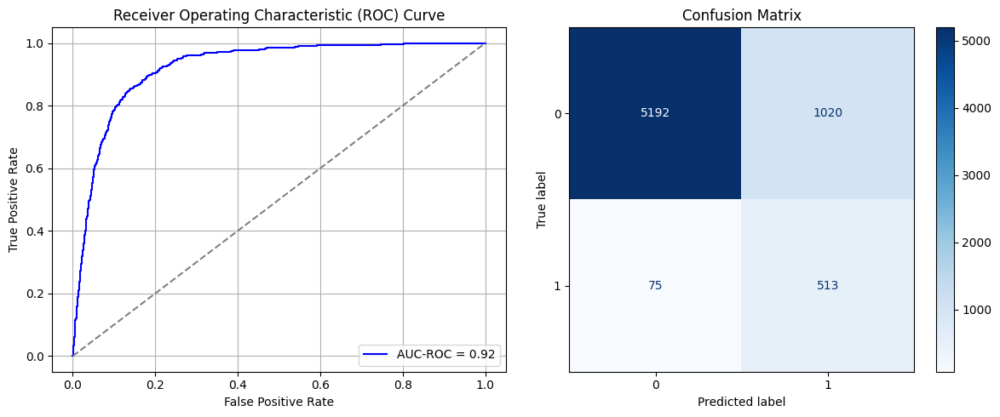

Best threshold based on F1-score: 0.7468475699424744
False Negative Rate: 0.12755102040816327
Time elapsed (performance): 0.8545785360001901
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - AUC: 0.6895 - loss: 0.6476 - val_AUC: 0.7806 - val_loss: 0.5850
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.7947 - loss: 0.5597 - val_AUC: 0.8592 - val_loss: 0.5032
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8365 - loss: 0.5116 - val_AUC: 0.8751 - val_loss: 0.4742
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8652 - loss: 0.4666 - val_AUC: 0.8853 - val_loss: 0.4452
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8675 - loss: 0.4622 - val_AUC: 0.8856 - val_loss: 0.4313
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8789 - loss: 0.4408 - val_AUC: 0.8896 - val_loss: 0.4332
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8695 - loss: 0.4531 - val_AUC: 0.8891 - val_loss: 0.4239
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8739 - loss: 0.4459 - val_AUC: 0.8875 - val_loss: 0.4226
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8797 -

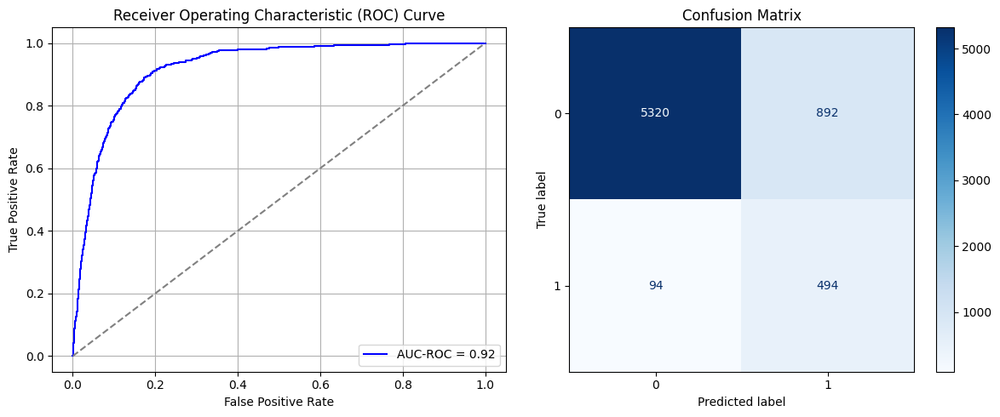

Best threshold based on F1-score: 0.9865666031837463
False Negative Rate: 0.1598639455782313
Time elapsed (performance): 1.118874061000497
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 5s 6ms/step - AUC: 0.6401 - loss: 0.6590 - val_AUC: 0.7453 - val_loss: 0.5941
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7827 - loss: 0.5664 - val_AUC: 0.8346 - val_loss: 0.5135
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8492 - loss: 0.4960 - val_AUC: 0.8609 - val_loss: 0.4726
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8689 - loss: 0.4617 - val_AUC: 0.8650 - val_loss: 0.4609
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8761 - loss: 0.4454 - val_AUC: 0.8642 - val_loss: 0.4681
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8820 - loss: 0.4338 - val_AUC: 0.8679 - val_loss: 0.4556
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8842 - loss: 0.4299 - val_AUC: 0.8695 - val_loss: 0.4497
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8863 - loss: 0.4253 - val_AUC: 0.8690 - val_loss: 0.4507
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8941 -

<ipython-input-76-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
AUC-ROC: 0.9150503085973605
Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.87      0.92      6212
           1       0.37      0.81      0.51       588

    accuracy                           0.86      6800
   macro avg       0.68      0.84      0.71      6800
weighted avg       0.93      0.86      0.89      6800

FPR 0.12974887314874436 TPR: 0.8078231292517006 FNR: 0.1921768707482993 TNR: 0.8702511268512556


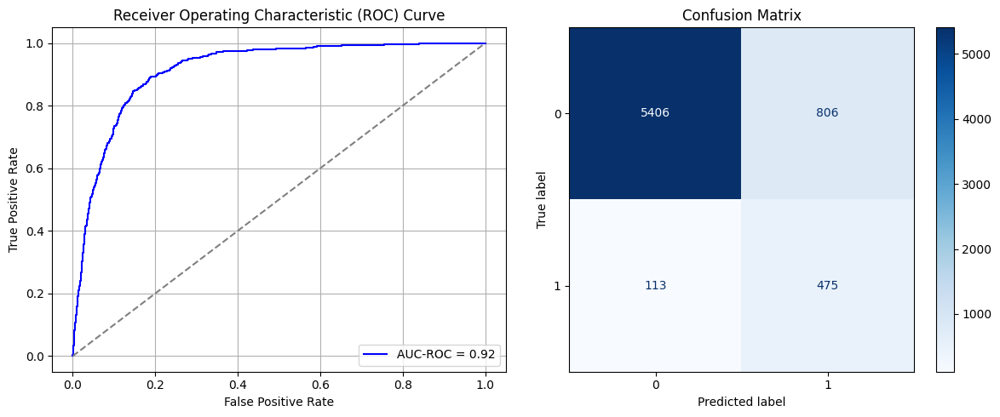

Best threshold based on F1-score: 0.6389350891113281
False Negative Rate: 0.1921768707482993
Time elapsed (performance): 0.8803098050002518
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6688 - loss: 0.6528 - val_AUC: 0.7691 - val_loss: 0.5817
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7887 - loss: 0.5649 - val_AUC: 0.8595 - val_loss: 0.4869
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8588 - loss: 0.4775 - val_AUC: 0.8738 - val_loss: 0.4589
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8697 - loss: 0.4607 - val_AUC: 0.8811 - val_loss: 0.4444
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8794 - loss: 0.4415 - val_AUC: 0.8825 - val_loss: 0.4484
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8746 - loss: 0.4508 - val_AUC: 0.8821 - val_loss: 0.4425
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8836 - loss: 0.4338 - val_AUC: 0.8838 - val_loss: 0.4340
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8868 - loss: 0.4272 - val_AUC: 0.8857 - val_loss: 0.4447
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8876 -

<ipython-input-76-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
AUC-ROC: 0.9200442089263265
Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.86      0.92      6212
           1       0.37      0.82      0.51       588

    accuracy                           0.86      6800
   macro avg       0.67      0.84      0.71      6800
weighted avg       0.93      0.86      0.88      6800

FPR 0.13506117192530587 TPR: 0.8248299319727891 FNR: 0.17517006802721088 TNR: 0.8649388280746941


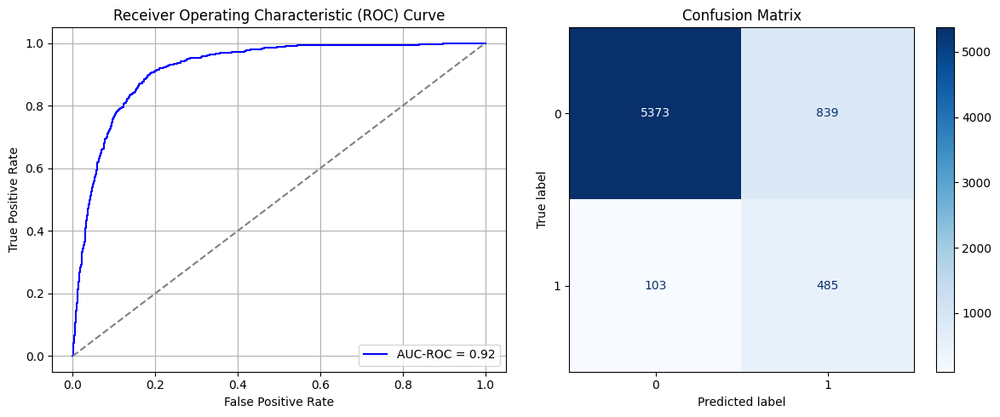

Best threshold based on F1-score: 0.9991360306739807
False Negative Rate: 0.17517006802721088
Time elapsed (performance): 0.8589638319999722
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6286 - loss: 0.6654 - val_AUC: 0.7731 - val_loss: 0.5791
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7815 - loss: 0.5698 - val_AUC: 0.8453 - val_loss: 0.5071
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8581 - loss: 0.4879 - val_AUC: 0.8645 - val_loss: 0.4771
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8661 - loss: 0.4676 - val_AUC: 0.8674 - val_loss: 0.4654
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8680 - loss: 0.4618 - val_AUC: 0.8692 - val_loss: 0.4686
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8785 - loss: 0.4458 - val_AUC: 0.8687 - val_loss: 0.4614
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.8762 - loss: 0.4476 - val_AUC: 0.8683 - val_loss: 0.4655
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8821 - loss: 0.4383 - val_AUC: 0.8713 - val_loss: 0.4547
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8830 -

<ipython-input-76-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
AUC-ROC: 0.9063946892343544
Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.87      0.92      6212
           1       0.36      0.77      0.49       588

    accuracy                           0.86      6800
   macro avg       0.67      0.82      0.71      6800
weighted avg       0.92      0.86      0.88      6800

FPR 0.12910495814552478 TPR: 0.7721088435374149 FNR: 0.22789115646258504 TNR: 0.8708950418544752


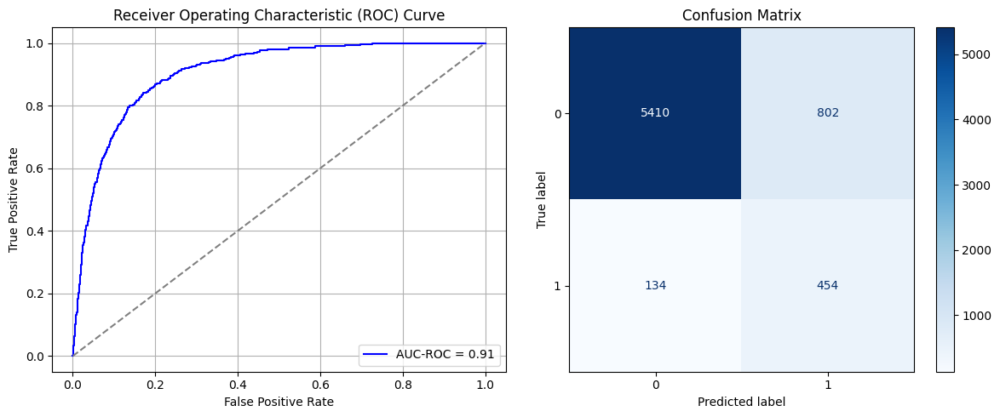

Best threshold based on F1-score: 0.6519927978515625
False Negative Rate: 0.22789115646258504
Time elapsed (performance): 0.9065573279995078
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6133 - loss: 0.6638 - val_AUC: 0.7672 - val_loss: 0.5835
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7886 - loss: 0.5615 - val_AUC: 0.8423 - val_loss: 0.5082
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8527 - loss: 0.4900 - val_AUC: 0.8671 - val_loss: 0.4654
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8781 - loss: 0.4440 - val_AUC: 0.8738 - val_loss: 0.4518
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8761 - loss: 0.4456 - val_AUC: 0.8752 - val_loss: 0.4512
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8785 - loss: 0.4407 - val_AUC: 0.8766 - val_loss: 0.4425
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8871 - loss: 0.4245 - val_AUC: 0.8774 - val_loss: 0.4416
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8896 - loss: 0.4237 - val_AUC: 0.8777 - val_loss: 0.4398
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8930 -

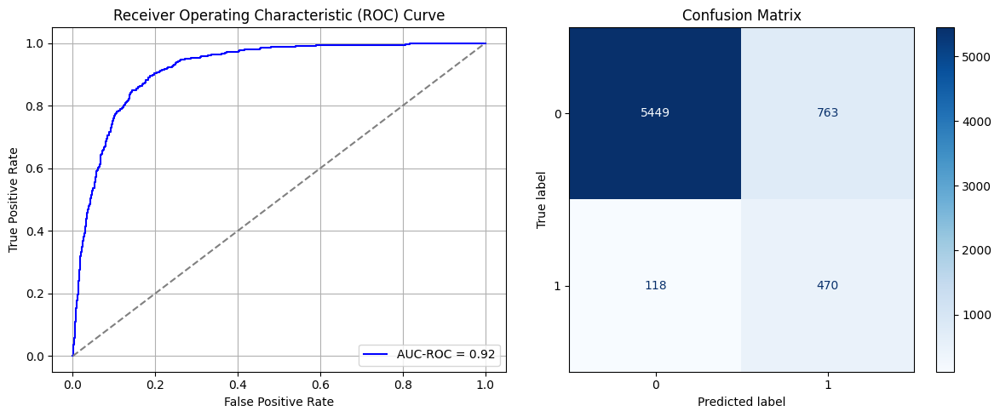

Best threshold based on F1-score: 0.9990749955177307
False Negative Rate: 0.20068027210884354
Time elapsed (performance): 1.066623226000047
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6614 - loss: 0.6553 - val_AUC: 0.7446 - val_loss: 0.5983
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7779 - loss: 0.5716 - val_AUC: 0.8414 - val_loss: 0.5173
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8523 - loss: 0.4987 - val_AUC: 0.8751 - val_loss: 0.4697
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8761 - loss: 0.4566 - val_AUC: 0.8771 - val_loss: 0.4540
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8793 - loss: 0.4490 - val_AUC: 0.8845 - val_loss: 0.4454
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.8747 - loss: 0.4528 - val_AUC: 0.8847 - val_loss: 0.4450
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8823 - loss: 0.4410 - val_AUC: 0.8831 - val_loss: 0.4427
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8831 - loss: 0.4366 - val_AUC: 0.8863 - val_loss: 0.4406
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8801 -

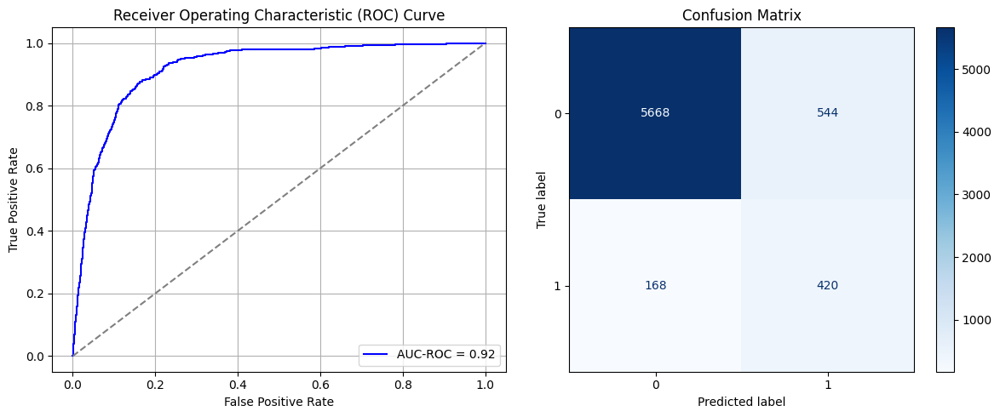

Best threshold based on F1-score: 0.9995328783988953
False Negative Rate: 0.2857142857142857
Time elapsed (performance): 1.0731956419995186
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6501 - loss: 0.6589 - val_AUC: 0.7621 - val_loss: 0.5872
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7900 - loss: 0.5644 - val_AUC: 0.8505 - val_loss: 0.5040
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - AUC: 0.8404 - loss: 0.5051 - val_AUC: 0.8722 - val_loss: 0.4596
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8640 - loss: 0.4667 - val_AUC: 0.8774 - val_loss: 0.4519
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8656 - loss: 0.4602 - val_AUC: 0.8755 - val_loss: 0.4526
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8739 - loss: 0.4465 - val_AUC: 0.8803 - val_loss: 0.4346
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8760 - loss: 0.4408 - val_AUC: 0.8793 - val_loss: 0.4371
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8769 - loss: 0.4396 - val_AUC: 0.8789 - val_loss: 0.4454
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8805 -

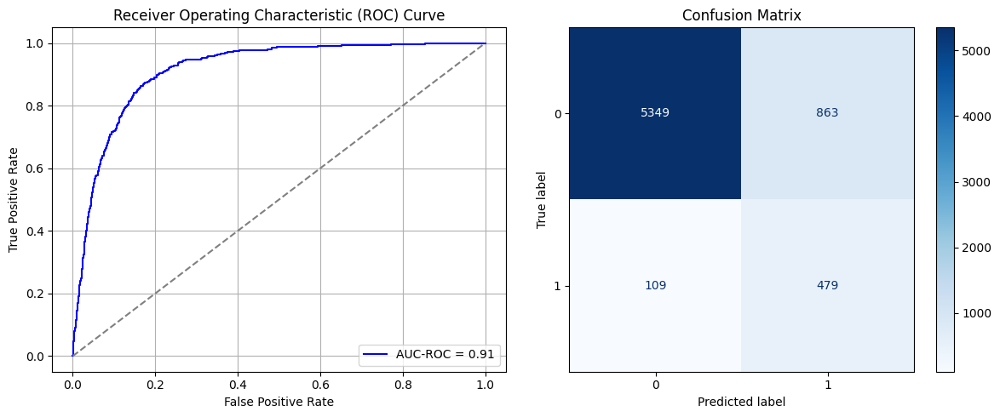

Best threshold based on F1-score: 0.9872474670410156
False Negative Rate: 0.18537414965986396
Time elapsed (performance): 0.8727942169998641
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - AUC: 0.6437 - loss: 0.6577 - val_AUC: 0.7842 - val_loss: 0.5691
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.7908 - loss: 0.5583 - val_AUC: 0.8622 - val_loss: 0.4867
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8520 - loss: 0.4889 - val_AUC: 0.8784 - val_loss: 0.4556
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8683 - loss: 0.4628 - val_AUC: 0.8844 - val_loss: 0.4357
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8757 - loss: 0.4488 - val_AUC: 0.8882 - val_loss: 0.4298
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8764 - loss: 0.4438 - val_AUC: 0.8886 - val_loss: 0.4312
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8769 - loss: 0.4424 - val_AUC: 0.8901 - val_loss: 0.4258
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8856 - loss: 0.4278 - val_AUC: 0.8896 - val_loss: 0.4257
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8881 -

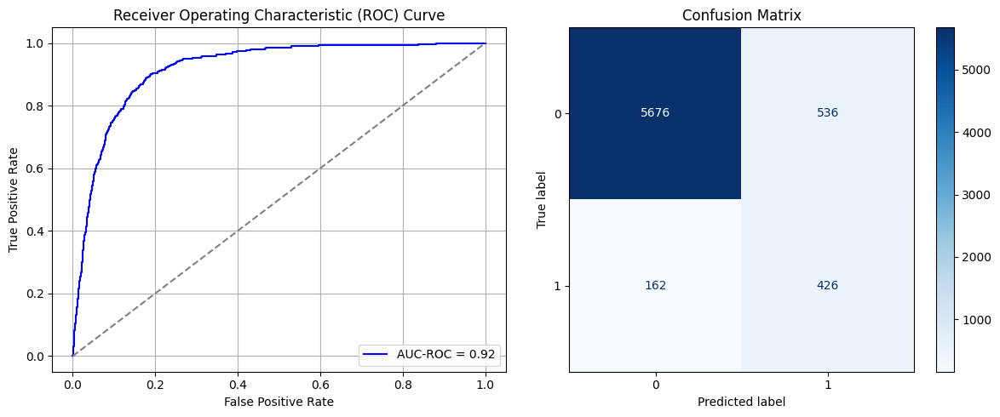

Best threshold based on F1-score: 0.9962982535362244
False Negative Rate: 0.2755102040816326
Time elapsed (performance): 1.2856884550001269
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - AUC: 0.6048 - loss: 0.6698 - val_AUC: 0.7715 - val_loss: 0.5819
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7734 - loss: 0.5758 - val_AUC: 0.8450 - val_loss: 0.5166
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8412 - loss: 0.5081 - val_AUC: 0.8771 - val_loss: 0.4561
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8693 - loss: 0.4628 - val_AUC: 0.8825 - val_loss: 0.4515
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8685 - loss: 0.4600 - val_AUC: 0.8851 - val_loss: 0.4298
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8815 - loss: 0.4363 - val_AUC: 0.8868 - val_loss: 0.4232
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8796 - loss: 0.4393 - val_AUC: 0.8873 - val_loss: 0.4220
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8852 - loss: 0.4284 - val_AUC: 0.8865 - val_loss: 0.4308
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8858 -

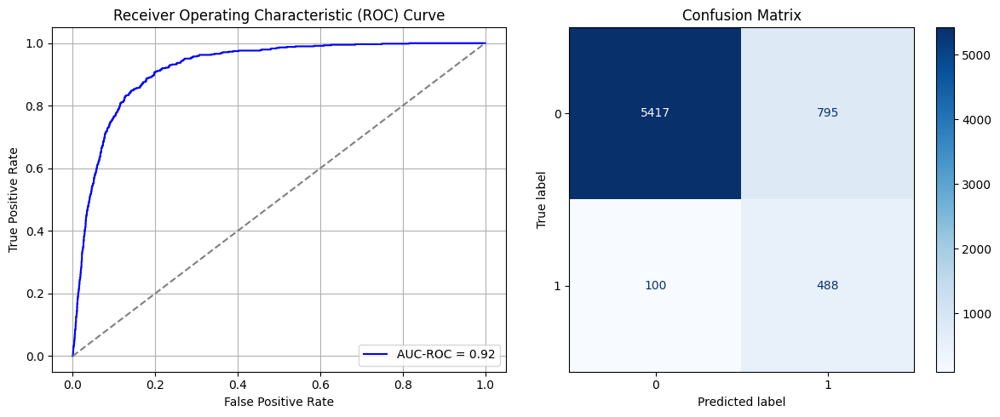

Best threshold based on F1-score: 0.986528217792511
False Negative Rate: 0.17006802721088435
Time elapsed (performance): 1.2697135569997045
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.6558 - loss: 0.6618 - val_AUC: 0.7647 - val_loss: 0.5875
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7887 - loss: 0.5631 - val_AUC: 0.8459 - val_loss: 0.5410
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8371 - loss: 0.5122 - val_AUC: 0.8762 - val_loss: 0.4629
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8635 - loss: 0.4717 - val_AUC: 0.8837 - val_loss: 0.4452
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8720 - loss: 0.4558 - val_AUC: 0.8862 - val_loss: 0.4392
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8701 - loss: 0.4538 - val_AUC: 0.8850 - val_loss: 0.4402
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8728 - loss: 0.4502 - val_AUC: 0.8886 - val_loss: 0.4707
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8836 - loss: 0.4330 - val_AUC: 0.8898 - val_loss: 0.4283
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8766 -

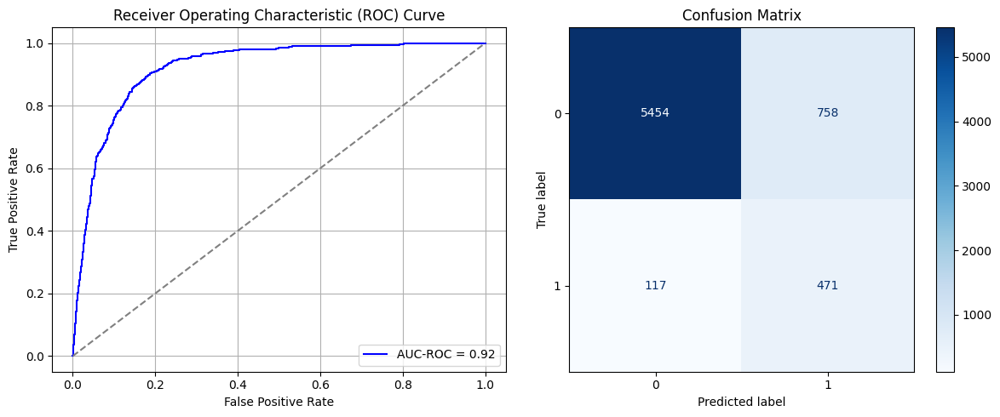

Best threshold based on F1-score: 0.9961281418800354
False Negative Rate: 0.1989795918367347
Time elapsed (performance): 1.24655281700052
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6370 - loss: 0.6617 - val_AUC: 0.7658 - val_loss: 0.5798
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7957 - loss: 0.5565 - val_AUC: 0.8511 - val_loss: 0.5011
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8553 - loss: 0.4860 - val_AUC: 0.8688 - val_loss: 0.4727
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8771 - loss: 0.4521 - val_AUC: 0.8725 - val_loss: 0.4759
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8761 - loss: 0.4494 - val_AUC: 0.8749 - val_loss: 0.4673
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8744 - loss: 0.4499 - val_AUC: 0.8743 - val_loss: 0.4684
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8862 - loss: 0.4301 - val_AUC: 0.8765 - val_loss: 0.4541
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8860 - loss: 0.4283 - val_AUC: 0.8767 - val_loss: 0.4488
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8788 -

<ipython-input-76-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
AUC-ROC: 0.9197797438357186
Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.82      0.90      6212
           1       0.32      0.88      0.47       588

    accuracy                           0.83      6800
   macro avg       0.65      0.85      0.68      6800
weighted avg       0.93      0.83      0.86      6800

FPR 0.177237604636188 TPR: 0.8809523809523809 FNR: 0.11904761904761904 TNR: 0.822762395363812


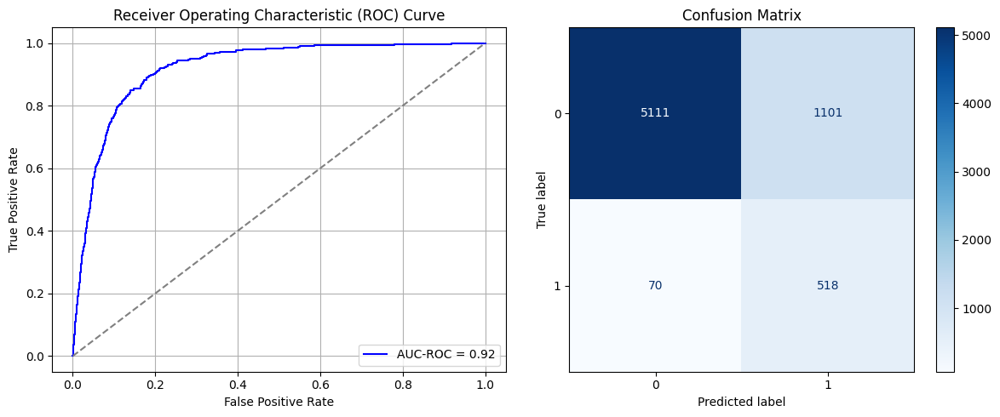

Best threshold based on F1-score: 0.9992978572845459
False Negative Rate: 0.11904761904761904
Time elapsed (performance): 1.0475584270006948
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6656 - loss: 0.6560 - val_AUC: 0.7773 - val_loss: 0.5781
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7681 - loss: 0.5796 - val_AUC: 0.8564 - val_loss: 0.4949
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8425 - loss: 0.5025 - val_AUC: 0.8716 - val_loss: 0.4572
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8688 - loss: 0.4605 - val_AUC: 0.8753 - val_loss: 0.4552
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8703 - loss: 0.4570 - val_AUC: 0.8752 - val_loss: 0.4544
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8733 - loss: 0.4509 - val_AUC: 0.8779 - val_loss: 0.4405
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8714 - loss: 0.4527 - val_AUC: 0.8790 - val_loss: 0.4435
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8662 - loss: 0.4615 - val_AUC: 0.8761 - val_loss: 0.4416
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.8859 -

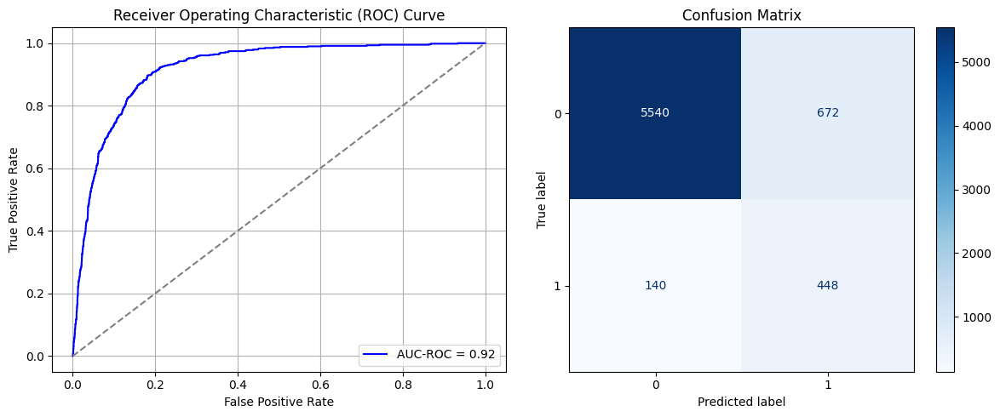

Best threshold based on F1-score: 0.9974635243415833
False Negative Rate: 0.23809523809523808
Time elapsed (performance): 1.057229629000176
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6412 - loss: 0.6673 - val_AUC: 0.7361 - val_loss: 0.6035
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7636 - loss: 0.5816 - val_AUC: 0.8377 - val_loss: 0.5217
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8520 - loss: 0.4958 - val_AUC: 0.8706 - val_loss: 0.4716
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8730 - loss: 0.4585 - val_AUC: 0.8727 - val_loss: 0.4822
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8887 - loss: 0.4343 - val_AUC: 0.8775 - val_loss: 0.4536
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8911 - loss: 0.4221 - val_AUC: 0.8793 - val_loss: 0.4488
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8954 - loss: 0.4137 - val_AUC: 0.8796 - val_loss: 0.4468
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8919 - loss: 0.4211 - val_AUC: 0.8773 - val_loss: 0.4469
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - AUC: 0.8911 -

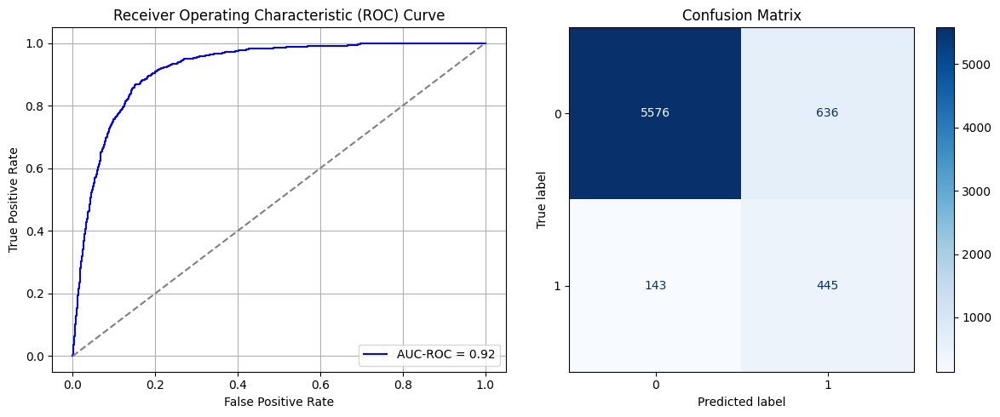

Best threshold based on F1-score: 0.6216026544570923
False Negative Rate: 0.24319727891156462
Time elapsed (performance): 0.8452423759999874
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.6559 - loss: 0.6571 - val_AUC: 0.7646 - val_loss: 0.5915
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7829 - loss: 0.5689 - val_AUC: 0.8447 - val_loss: 0.5081
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8509 - loss: 0.4961 - val_AUC: 0.8742 - val_loss: 0.4621
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8819 - loss: 0.4445 - val_AUC: 0.8787 - val_loss: 0.4523
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8848 - loss: 0.4381 - val_AUC: 0.8782 - val_loss: 0.4479
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8887 - loss: 0.4283 - val_AUC: 0.8831 - val_loss: 0.4402
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8933 - loss: 0.4225 - val_AUC: 0.8816 - val_loss: 0.4431
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8874 - loss: 0.4293 - val_AUC: 0.8823 - val_loss: 0.4410
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8862 -

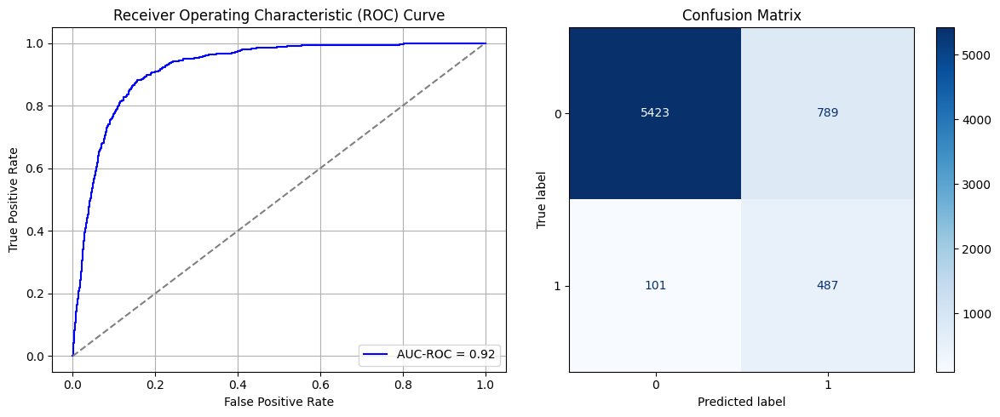

Best threshold based on F1-score: 0.9996313452720642
False Negative Rate: 0.1717687074829932
Time elapsed (performance): 0.9025250439999581
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6654 - loss: 0.6552 - val_AUC: 0.7680 - val_loss: 0.5842
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7681 - loss: 0.5807 - val_AUC: 0.8608 - val_loss: 0.4985
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8362 - loss: 0.5113 - val_AUC: 0.8897 - val_loss: 0.4364
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8618 - loss: 0.4697 - val_AUC: 0.8949 - val_loss: 0.4367
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8715 - loss: 0.4541 - val_AUC: 0.8998 - val_loss: 0.4100
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8738 - loss: 0.4492 - val_AUC: 0.9012 - val_loss: 0.4173
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8822 - loss: 0.4322 - val_AUC: 0.9018 - val_loss: 0.4037
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8775 - loss: 0.4402 - val_AUC: 0.9020 - val_loss: 0.4081
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8830 -

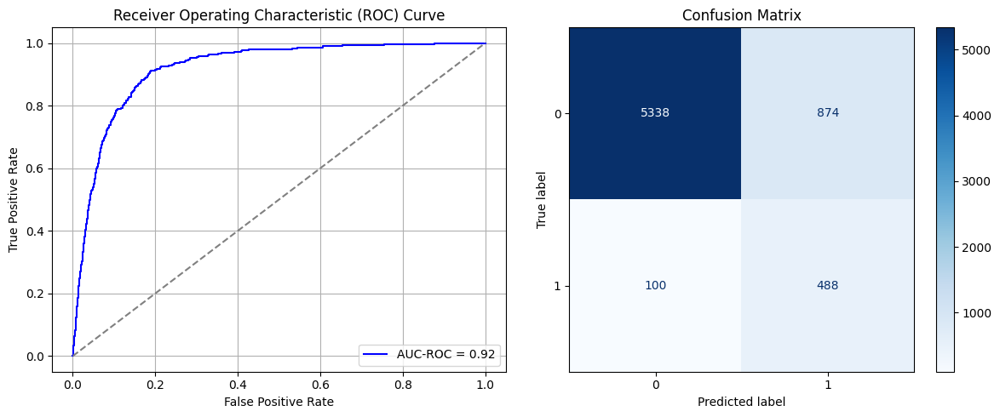

Best threshold based on F1-score: 0.9969526529312134
False Negative Rate: 0.17006802721088435
Time elapsed (performance): 0.8903041809999195
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6375 - loss: 0.6635 - val_AUC: 0.7889 - val_loss: 0.5647
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7911 - loss: 0.5610 - val_AUC: 0.8706 - val_loss: 0.4813
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8419 - loss: 0.5016 - val_AUC: 0.8887 - val_loss: 0.4449
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8657 - loss: 0.4687 - val_AUC: 0.8948 - val_loss: 0.4257
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8768 - loss: 0.4538 - val_AUC: 0.8938 - val_loss: 0.4250
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8799 - loss: 0.4421 - val_AUC: 0.8963 - val_loss: 0.4155
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8793 - loss: 0.4438 - val_AUC: 0.8965 - val_loss: 0.4200
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8876 - loss: 0.4292 - val_AUC: 0.8979 - val_loss: 0.4270
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8786 -

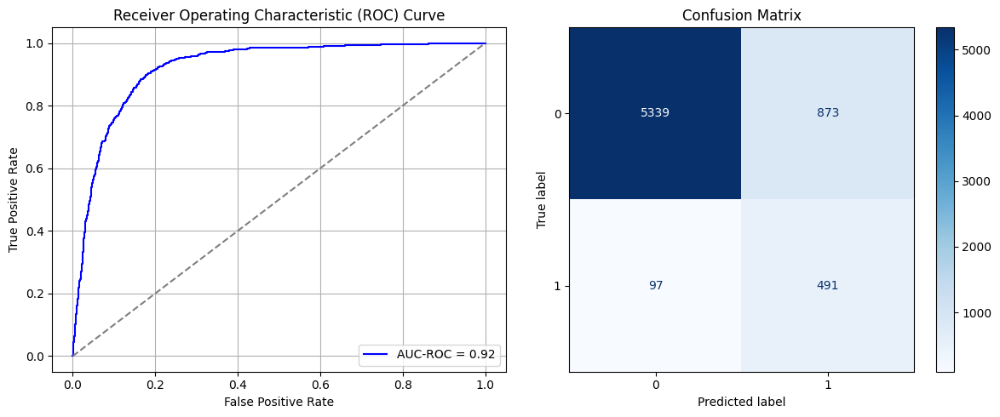

Best threshold based on F1-score: 0.9996392130851746
False Negative Rate: 0.1649659863945578
Time elapsed (performance): 1.0872153430000253
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6436 - loss: 0.6602 - val_AUC: 0.7570 - val_loss: 0.5976
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7907 - loss: 0.5608 - val_AUC: 0.8543 - val_loss: 0.5031
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - AUC: 0.8511 - loss: 0.4947 - val_AUC: 0.8710 - val_loss: 0.4621
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8739 - loss: 0.4531 - val_AUC: 0.8764 - val_loss: 0.4502
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8801 - loss: 0.4406 - val_AUC: 0.8835 - val_loss: 0.4399
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8859 - loss: 0.4296 - val_AUC: 0.8817 - val_loss: 0.4603
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8803 - loss: 0.4396 - val_AUC: 0.8838 - val_loss: 0.4353
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8801 - loss: 0.4371 - val_AUC: 0.8869 - val_loss: 0.4298
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8817 -

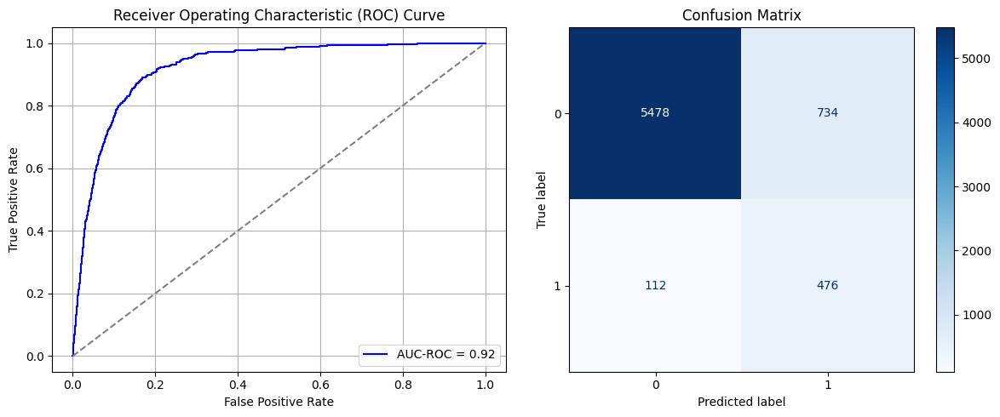

Best threshold based on F1-score: 0.9977183938026428
False Negative Rate: 0.19047619047619047
Time elapsed (performance): 0.9279978849999679
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6613 - loss: 0.6571 - val_AUC: 0.7867 - val_loss: 0.5767
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7798 - loss: 0.5732 - val_AUC: 0.8576 - val_loss: 0.4969
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8485 - loss: 0.4953 - val_AUC: 0.8880 - val_loss: 0.4737
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.8708 - loss: 0.4561 - val_AUC: 0.8903 - val_loss: 0.4300
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8725 - loss: 0.4550 - val_AUC: 0.8919 - val_loss: 0.4180
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8781 - loss: 0.4410 - val_AUC: 0.8955 - val_loss: 0.4151
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8787 - loss: 0.4383 - val_AUC: 0.8955 - val_loss: 0.4113
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8690 - loss: 0.4526 - val_AUC: 0.8947 - val_loss: 0.4359
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8801 -

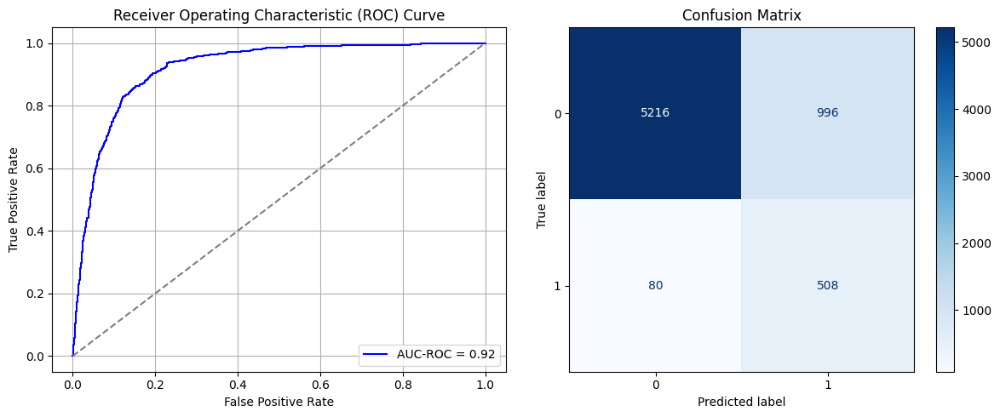

Best threshold based on F1-score: 0.99515700340271
False Negative Rate: 0.1360544217687075
Time elapsed (performance): 0.9077918080001837
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6169 - loss: 0.6724 - val_AUC: 0.7546 - val_loss: 0.5962
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.7909 - loss: 0.5623 - val_AUC: 0.8660 - val_loss: 0.4854
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8582 - loss: 0.4853 - val_AUC: 0.8791 - val_loss: 0.4550
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8692 - loss: 0.4575 - val_AUC: 0.8841 - val_loss: 0.4356
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.8815 - loss: 0.4383 - val_AUC: 0.8858 - val_loss: 0.4382
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8790 - loss: 0.4412 - val_AUC: 0.8847 - val_loss: 0.4278
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8861 - loss: 0.4263 - val_AUC: 0.8881 - val_loss: 0.4237
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8855 - loss: 0.4258 - val_AUC: 0.8888 - val_loss: 0.4191
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8835 -

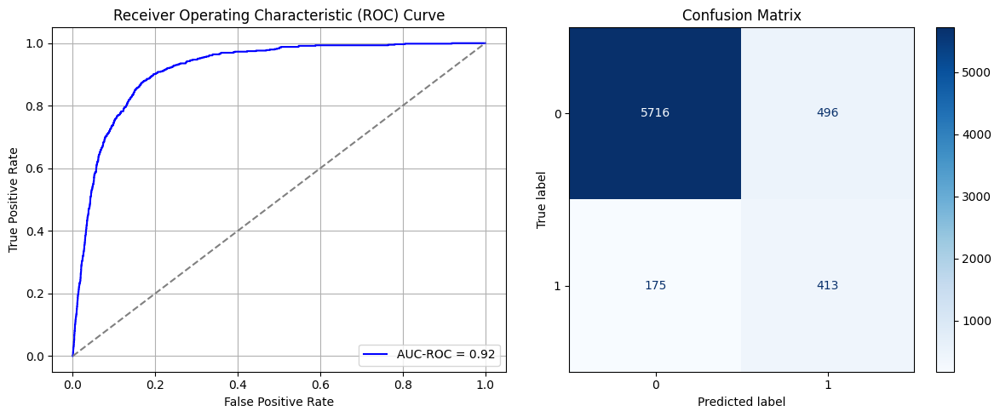

Best threshold based on F1-score: 0.9942381381988525
False Negative Rate: 0.2976190476190476
Time elapsed (performance): 0.9138824490000843
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - AUC: 0.6832 - loss: 0.6493 - val_AUC: 0.7837 - val_loss: 0.5757
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.7973 - loss: 0.5549 - val_AUC: 0.8559 - val_loss: 0.4916
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8635 - loss: 0.4769 - val_AUC: 0.8708 - val_loss: 0.4620
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8749 - loss: 0.4526 - val_AUC: 0.8745 - val_loss: 0.4541
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8818 - loss: 0.4392 - val_AUC: 0.8742 - val_loss: 0.4571
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8905 - loss: 0.4237 - val_AUC: 0.8744 - val_loss: 0.4523
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8865 - loss: 0.4301 - val_AUC: 0.8743 - val_loss: 0.4551
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8832 - loss: 0.4371 - val_AUC: 0.8745 - val_loss: 0.4681
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8804 -

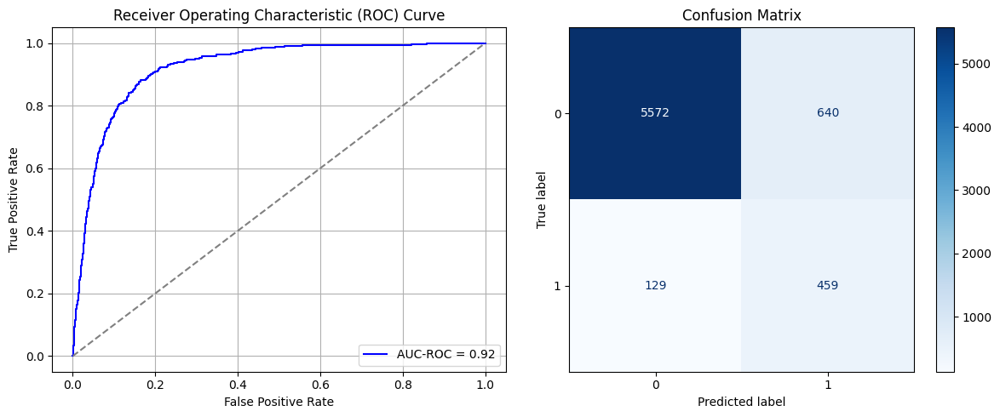

Best threshold based on F1-score: 0.9995120167732239
False Negative Rate: 0.2193877551020408
Time elapsed (performance): 1.34174981400065
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6822 - loss: 0.6528 - val_AUC: 0.7795 - val_loss: 0.5717
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7904 - loss: 0.5586 - val_AUC: 0.8481 - val_loss: 0.4974
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8577 - loss: 0.4821 - val_AUC: 0.8774 - val_loss: 0.4518
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8707 - loss: 0.4563 - val_AUC: 0.8816 - val_loss: 0.4441
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8783 - loss: 0.4436 - val_AUC: 0.8845 - val_loss: 0.4318
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8830 - loss: 0.4322 - val_AUC: 0.8857 - val_loss: 0.4351
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8875 - loss: 0.4244 - val_AUC: 0.8858 - val_loss: 0.4312
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8865 - loss: 0.4238 - val_AUC: 0.8874 - val_loss: 0.4251
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8863 -

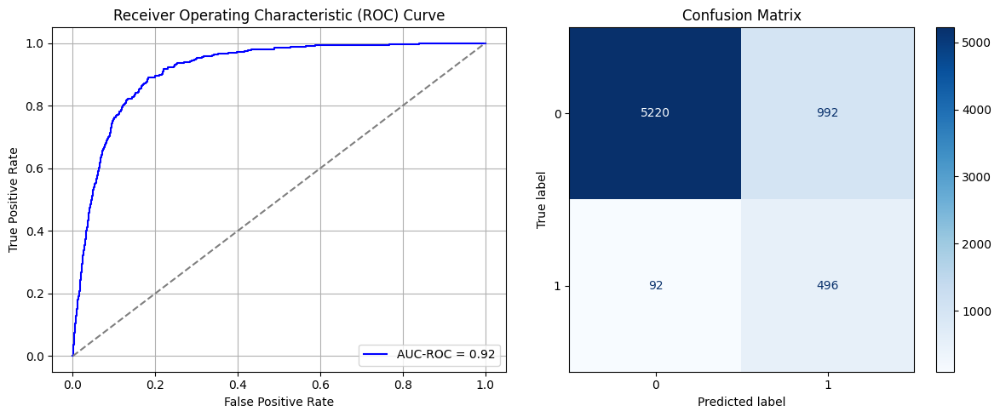

Best threshold based on F1-score: 0.9964206218719482
False Negative Rate: 0.1564625850340136
Time elapsed (performance): 1.0563494919997538
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6621 - loss: 0.6553 - val_AUC: 0.7737 - val_loss: 0.5777
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7995 - loss: 0.5519 - val_AUC: 0.8579 - val_loss: 0.4860
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8598 - loss: 0.4772 - val_AUC: 0.8763 - val_loss: 0.4498
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8808 - loss: 0.4412 - val_AUC: 0.8836 - val_loss: 0.4336
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8778 - loss: 0.4425 - val_AUC: 0.8863 - val_loss: 0.4382
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8863 - loss: 0.4302 - val_AUC: 0.8891 - val_loss: 0.4213
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8877 - loss: 0.4248 - val_AUC: 0.8902 - val_loss: 0.4357
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8872 - loss: 0.4277 - val_AUC: 0.8902 - val_loss: 0.4191
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8862 -

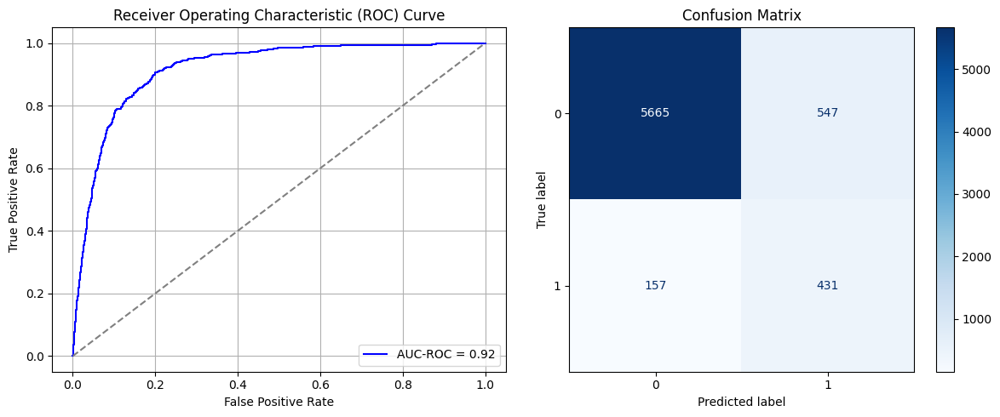

Best threshold based on F1-score: 0.9962486624717712
False Negative Rate: 0.26700680272108845
Time elapsed (performance): 1.095646893999401
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 5s 7ms/step - AUC: 0.6279 - loss: 0.6654 - val_AUC: 0.7850 - val_loss: 0.5696
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.7888 - loss: 0.5604 - val_AUC: 0.8658 - val_loss: 0.4923
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8568 - loss: 0.4863 - val_AUC: 0.8849 - val_loss: 0.4443
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8713 - loss: 0.4593 - val_AUC: 0.8860 - val_loss: 0.4346
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8725 - loss: 0.4527 - val_AUC: 0.8898 - val_loss: 0.4251
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8684 - loss: 0.4590 - val_AUC: 0.8914 - val_loss: 0.4210
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8726 - loss: 0.4501 - val_AUC: 0.8910 - val_loss: 0.4218
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8838 - loss: 0.4334 - val_AUC: 0.8920 - val_loss: 0.4170
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8807 -

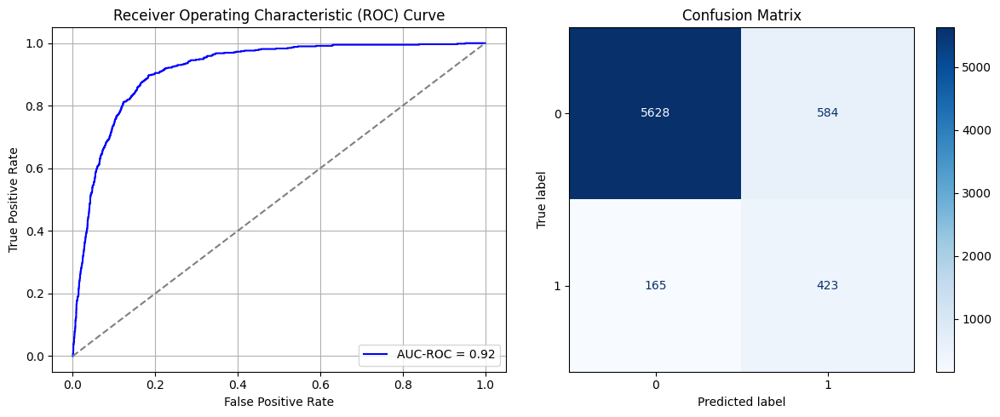

Best threshold based on F1-score: 0.5753328204154968
False Negative Rate: 0.28061224489795916
Time elapsed (performance): 1.0932639200000267
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - AUC: 0.6480 - loss: 0.6617 - val_AUC: 0.7738 - val_loss: 0.5799
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8033 - loss: 0.5489 - val_AUC: 0.8707 - val_loss: 0.4858
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8536 - loss: 0.4897 - val_AUC: 0.8885 - val_loss: 0.4378
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8890 - loss: 0.4324 - val_AUC: 0.8935 - val_loss: 0.4333
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8816 - loss: 0.4421 - val_AUC: 0.8942 - val_loss: 0.4263
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.8840 - loss: 0.4351 - val_AUC: 0.8943 - val_loss: 0.4191
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8850 - loss: 0.4347 - val_AUC: 0.8962 - val_loss: 0.4127
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8950 - loss: 0.4141 - val_AUC: 0.8983 - val_loss: 0.4130
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8901 -

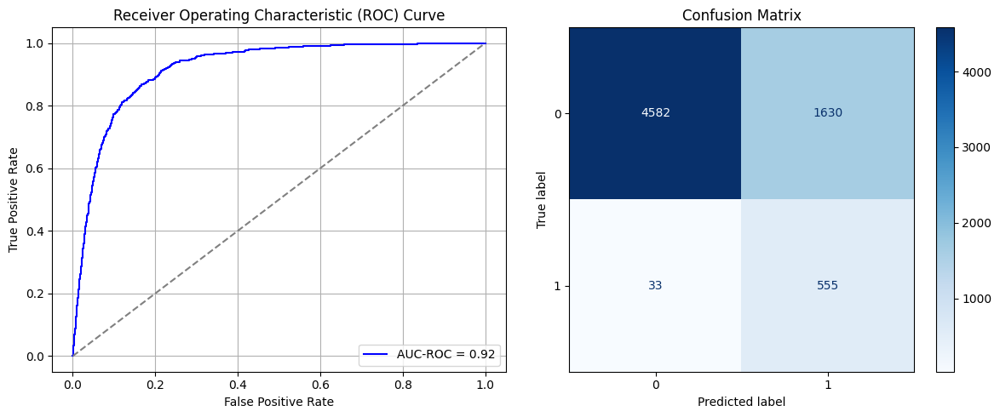

Best threshold based on F1-score: 0.7981780171394348
False Negative Rate: 0.05612244897959184
Time elapsed (performance): 1.3583619710007042
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6637 - loss: 0.6575 - val_AUC: 0.7827 - val_loss: 0.5797
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.7991 - loss: 0.5569 - val_AUC: 0.8424 - val_loss: 0.5053
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8616 - loss: 0.4807 - val_AUC: 0.8578 - val_loss: 0.4791
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8740 - loss: 0.4533 - val_AUC: 0.8610 - val_loss: 0.4749
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.8779 - loss: 0.4464 - val_AUC: 0.8636 - val_loss: 0.4705
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8860 - loss: 0.4304 - val_AUC: 0.8613 - val_loss: 0.4777
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8840 - loss: 0.4310 - val_AUC: 0.8629 - val_loss: 0.4701
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8907 - loss: 0.4225 - val_AUC: 0.8623 - val_loss: 0.4707
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8862 -

<ipython-input-76-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
AUC-ROC: 0.9216110140128171
Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.86      0.92      6212
           1       0.36      0.84      0.50       588

    accuracy                           0.86      6800
   macro avg       0.67      0.85      0.71      6800
weighted avg       0.93      0.86      0.88      6800

FPR 0.14375402446877011 TPR: 0.8435374149659864 FNR: 0.1564625850340136 TNR: 0.8562459755312299


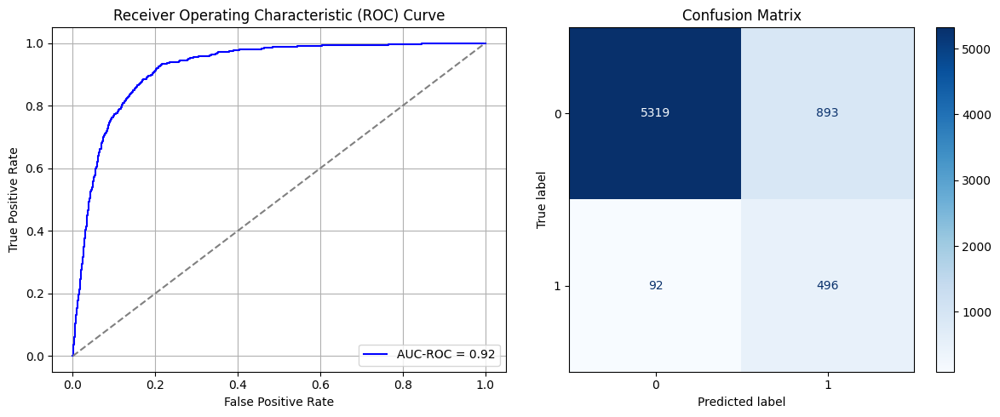

Best threshold based on F1-score: 0.7061277031898499
False Negative Rate: 0.1564625850340136
Time elapsed (performance): 1.015743349999866
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - AUC: 0.6492 - loss: 0.6633 - val_AUC: 0.7651 - val_loss: 0.5915
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.7947 - loss: 0.5620 - val_AUC: 0.8495 - val_loss: 0.5073
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8489 - loss: 0.4966 - val_AUC: 0.8811 - val_loss: 0.4459
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8774 - loss: 0.4481 - val_AUC: 0.8834 - val_loss: 0.4365
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8819 - loss: 0.4362 - val_AUC: 0.8845 - val_loss: 0.4319
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8844 - loss: 0.4319 - val_AUC: 0.8833 - val_loss: 0.4389
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8808 - loss: 0.4363 - val_AUC: 0.8835 - val_loss: 0.4391
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8850 - loss: 0.4310 - val_AUC: 0.8838 - val_loss: 0.4299
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8907 -

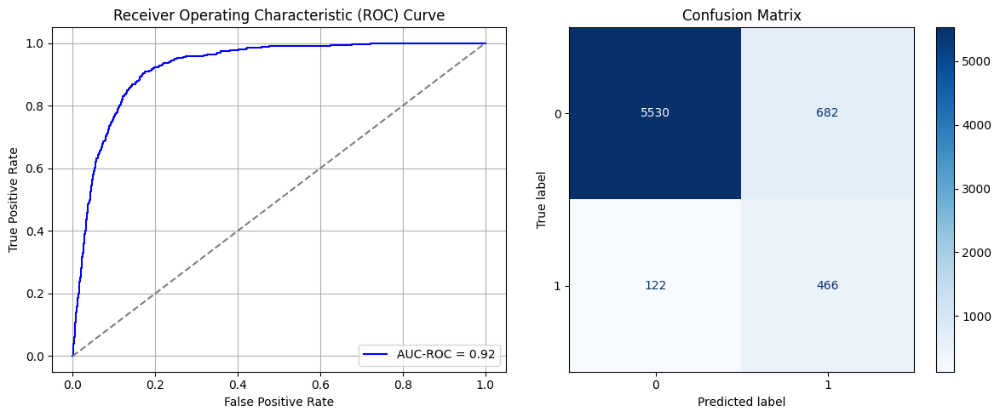

Best threshold based on F1-score: 0.9935765266418457
False Negative Rate: 0.20748299319727892
Time elapsed (performance): 1.4293456190007419


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


In [92]:
times = 50

Training_time = []
FPR = []
TPR = []
FNR = []
TNR = []
TL_time = []


for i in range(times):
    data_S_maj_rus = data_S_majority.sample(n=undersample_size, replace=True)
    data_S_SRSwR_RUS = pd.concat([data_S_maj_rus, data_S_minority])
    X_S_SRSwR = data_S_SRSwR_RUS.iloc[:, :-1]
    y_S_SRSwR = data_S_SRSwR_RUS.iloc[:, -1]
    X_S_train, X_S_test, y_S_train, y_S_test = train_test_split(X_S_SRSwR, y_S_SRSwR, test_size=0.20, random_state=0)
    model_SRSwR = create_dnn_model(X_S_train.shape[1])
    result_SRSwR = train_and_evaluate(model_SRSwR, X_S_train, X_S_test, y_S_train, y_S_test, "Source")
    result_TL_SRSwR = Transductive_TL(model_SRSwR, X_T_full, y_T_full, "Target")

    Training_time.append(result_SRSwR)
    FPR.append(result_TL_SRSwR[0])
    TNR.append(result_TL_SRSwR[1])
    FNR.append(result_TL_SRSwR[2])
    TPR.append(result_TL_SRSwR[3])
    TL_time.append(result_TL_SRSwR[4])

ParamFit = pd.DataFrame([Training_time, FPR, TNR, FNR, TPR, TL_time]).T
ParamFit.columns=['Source time', 'FPR', 'TNR', 'FNR', 'TPR', 'Target time']
# print(ParamFit)

In [93]:
print(ParamFit)
ParamFit.to_csv('SRSwR_RUS.csv')

    Source time       FPR       TNR       FNR       TPR  Target time
0     10.410867  0.110914  0.889086  0.236395  0.763605     1.051143
1      9.822702  0.110592  0.889408  0.212585  0.787415     0.754842
2     10.055883  0.155184  0.844816  0.130952  0.869048     0.750474
3      8.093453  0.119929  0.880071  0.217687  0.782313     1.217605
4      9.168984  0.201223  0.798777  0.096939  0.903061     0.768559
5     10.124553  0.070670  0.929330  0.350340  0.649660     0.773389
6      9.888166  0.110109  0.889891  0.210884  0.789116     2.533428
7     14.070024  0.135705  0.864295  0.163265  0.836735     1.067543
8     12.599277  0.149227  0.850773  0.151361  0.848639     1.002685
9     11.109044  0.108500  0.891500  0.234694  0.765306     1.186049
10    12.751289  0.110431  0.889569  0.226190  0.773810     1.258250
11    12.878057  0.145203  0.854797  0.154762  0.845238     1.086140
12    11.842575  0.125724  0.874276  0.197279  0.802721     0.790282
13    12.939161  0.121539  0.87846

## Systematic Sampling:

First, we select a single systematic sample from the majority class, in which $k = \frac{N_0}{N_1}$, where $N_0$ is the majority class size in the source domain and $N_1$ is the minority class in the source domain.

7.209564628919468
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.7095 - loss: 0.6411 - val_AUC: 0.7686 - val_loss: 0.5883
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.7813 - loss: 0.5694 - val_AUC: 0.8312 - val_loss: 0.5171
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8510 - loss: 0.4942 - val_AUC: 0.8628 - val_loss: 0.4817
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8665 - loss: 0.4677 - val_AUC: 0.8675 - val_loss: 0.4597
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8752 - loss: 0.4472 - val_AUC: 0.8733 - val_loss: 0.4591
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8870 - loss: 0.4274 - val_AUC: 0.8729 - val_loss: 0.4530
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8853 - loss: 0.4281 - val_AUC: 0.8739 - val_loss: 0.4489
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8892 - loss: 0.4206 - val_AUC: 0.8755 - val_loss: 0.4417
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8868 -

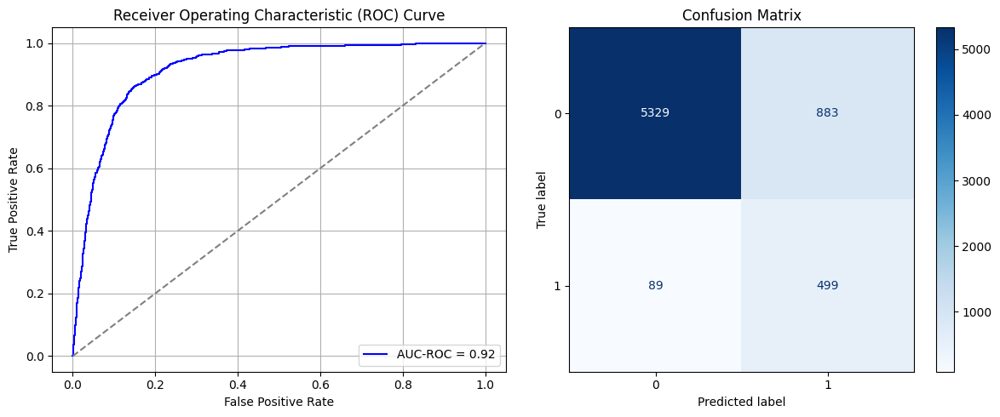

Best threshold based on F1-score: 0.9864786267280579
False Negative Rate: 0.15136054421768708
Time elapsed (performance): 0.7787545709998085
(np.float64(0.14214423696072118), np.float64(0.8578557630392788))
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.5925 - loss: 0.6749 - val_AUC: 0.7587 - val_loss: 0.5902
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7811 - loss: 0.5683 - val_AUC: 0.8450 - val_loss: 0.5068
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8533 - loss: 0.4900 - val_AUC: 0.8754 - val_loss: 0.4597
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8831 - loss: 0.4405 - val_AUC: 0.8789 - val_loss: 0.4682
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8821 - loss: 0.4387 - val_AUC: 0.8824 - val_loss: 0.4512
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8847 - loss: 0.4354 - val_AUC: 0.8836 - val_loss: 0.4396
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8849 - loss: 0.4322 - val_AUC: 0.8850 - val_loss: 0.4351
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8926 - loss: 0.4159 - val_AUC: 0.8837 - val_loss: 0.4308
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8913 -

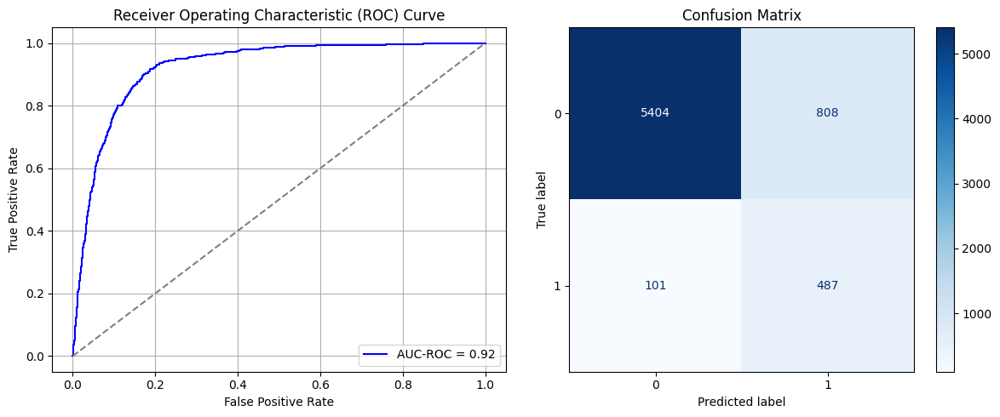

Best threshold based on F1-score: 0.9945423603057861
False Negative Rate: 0.1717687074829932
Time elapsed (performance): 0.7620344560000376
(np.float64(0.13007083065035416), np.float64(0.8699291693496458))
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6868 - loss: 0.6529 - val_AUC: 0.7841 - val_loss: 0.5711
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8024 - loss: 0.5483 - val_AUC: 0.8588 - val_loss: 0.4848
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8571 - loss: 0.4822 - val_AUC: 0.8744 - val_loss: 0.4659
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8692 - loss: 0.4566 - val_AUC: 0.8790 - val_loss: 0.4448
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8792 - loss: 0.4392 - val_AUC: 0.8836 - val_loss: 0.4324
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8778 - loss: 0.4415 - val_AUC: 0.8858 - val_loss: 0.4264
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8870 - loss: 0.4253 - val_AUC: 0.8850 - val_loss: 0.4351
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8883 - loss: 0.4210 - val_AUC: 0.8835 - val_loss: 0.4341
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8839 -

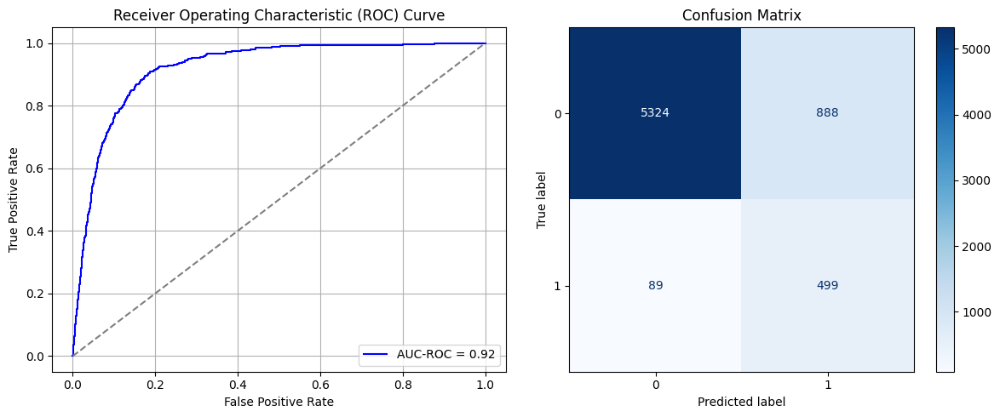

Best threshold based on F1-score: 0.9959033131599426
False Negative Rate: 0.15136054421768708
Time elapsed (performance): 0.7664686529997198
(np.float64(0.14294913071474566), np.float64(0.8570508692852543))
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6803 - loss: 0.6515 - val_AUC: 0.7690 - val_loss: 0.5860
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7794 - loss: 0.5732 - val_AUC: 0.8501 - val_loss: 0.5004
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8639 - loss: 0.4773 - val_AUC: 0.8734 - val_loss: 0.4579
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8752 - loss: 0.4501 - val_AUC: 0.8756 - val_loss: 0.4449
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8885 - loss: 0.4239 - val_AUC: 0.8774 - val_loss: 0.4432
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8828 - loss: 0.4328 - val_AUC: 0.8791 - val_loss: 0.4433
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8891 - loss: 0.4223 - val_AUC: 0.8742 - val_loss: 0.4477
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8888 - loss: 0.4213 - val_AUC: 0.8791 - val_loss: 0.4388
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8867 -

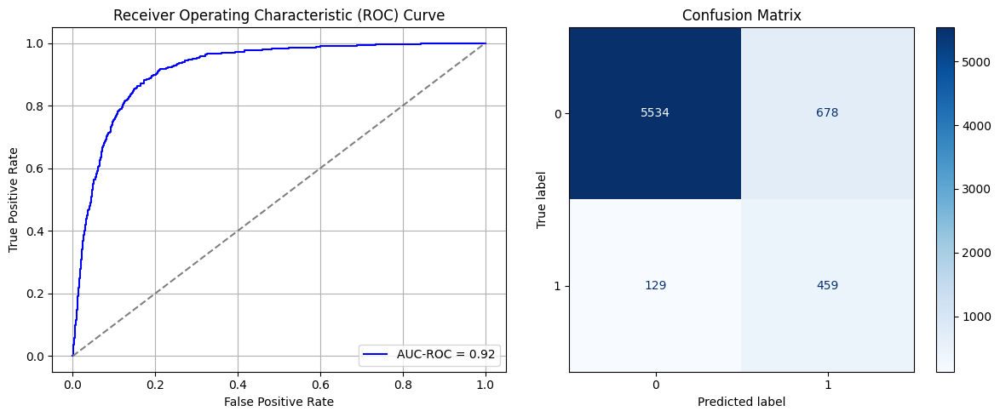

Best threshold based on F1-score: 0.9917258620262146
False Negative Rate: 0.2193877551020408
Time elapsed (performance): 0.7688660109997727
(np.float64(0.10914359304571797), np.float64(0.890856406954282))
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.6903 - loss: 0.6476 - val_AUC: 0.7869 - val_loss: 0.5741
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7996 - loss: 0.5577 - val_AUC: 0.8541 - val_loss: 0.4920
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8564 - loss: 0.4862 - val_AUC: 0.8692 - val_loss: 0.4640
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8724 - loss: 0.4569 - val_AUC: 0.8724 - val_loss: 0.4556
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8808 - loss: 0.4426 - val_AUC: 0.8756 - val_loss: 0.4482
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8772 - loss: 0.4457 - val_AUC: 0.8778 - val_loss: 0.4543
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8832 - loss: 0.4403 - val_AUC: 0.8740 - val_loss: 0.4504
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8757 - loss: 0.4495 - val_AUC: 0.8752 - val_loss: 0.4465
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8845 -

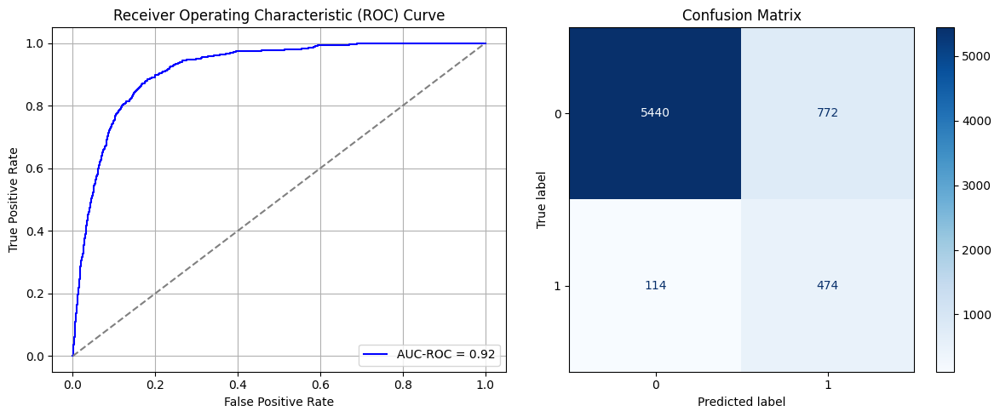

Best threshold based on F1-score: 0.9994158744812012
False Negative Rate: 0.19387755102040816
Time elapsed (performance): 1.2349014390001685
(np.float64(0.12427559562137798), np.float64(0.875724404378622))
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6471 - loss: 0.6629 - val_AUC: 0.7646 - val_loss: 0.5802
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7945 - loss: 0.5564 - val_AUC: 0.8588 - val_loss: 0.4868
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8671 - loss: 0.4683 - val_AUC: 0.8744 - val_loss: 0.4546
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8806 - loss: 0.4405 - val_AUC: 0.8766 - val_loss: 0.4494
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8929 - loss: 0.4181 - val_AUC: 0.8787 - val_loss: 0.4439
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8859 - loss: 0.4283 - val_AUC: 0.8790 - val_loss: 0.4401
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8873 - loss: 0.4236 - val_AUC: 0.8798 - val_loss: 0.4408
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8909 - loss: 0.4179 - val_AUC: 0.8821 - val_loss: 0.4335
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8905 -

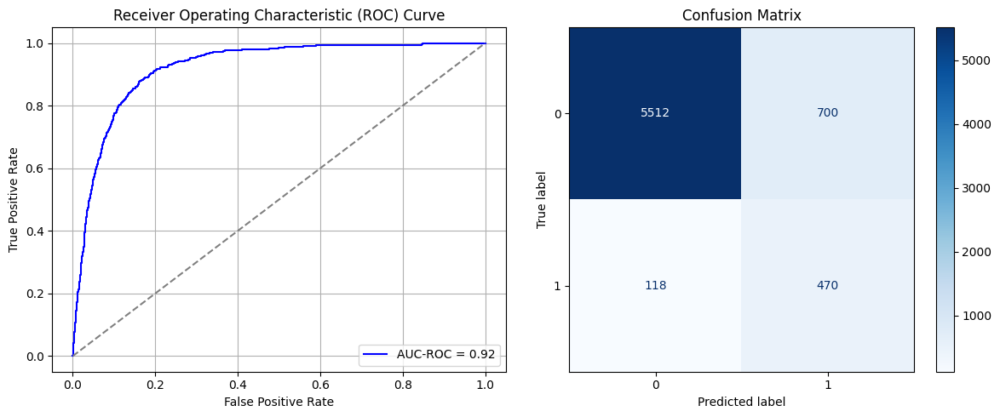

Best threshold based on F1-score: 0.9885289669036865
False Negative Rate: 0.20068027210884354
Time elapsed (performance): 1.0412264659998982
(np.float64(0.11268512556342562), np.float64(0.8873148744365744))
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - AUC: 0.6881 - loss: 0.6455 - val_AUC: 0.7751 - val_loss: 0.5781
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.7969 - loss: 0.5557 - val_AUC: 0.8535 - val_loss: 0.5186
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8615 - loss: 0.4808 - val_AUC: 0.8710 - val_loss: 0.4563
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8802 - loss: 0.4424 - val_AUC: 0.8735 - val_loss: 0.4537
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8713 - loss: 0.4567 - val_AUC: 0.8758 - val_loss: 0.4545
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8888 - loss: 0.4251 - val_AUC: 0.8763 - val_loss: 0.4408
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8847 - loss: 0.4303 - val_AUC: 0.8730 - val_loss: 0.4608
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8835 - loss: 0.4309 - val_AUC: 0.8743 - val_loss: 0.4553
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8871 -

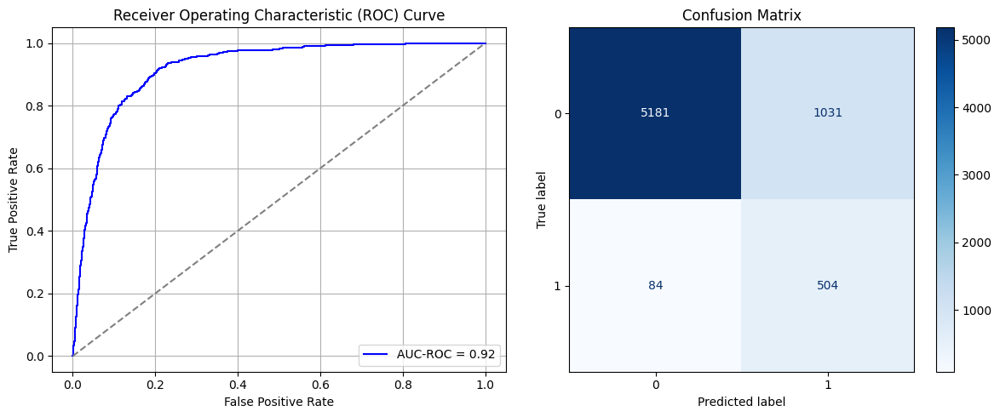

Best threshold based on F1-score: 0.9981736540794373
False Negative Rate: 0.14285714285714285
Time elapsed (performance): 1.0433726310002385
(np.float64(0.16596909207984545), np.float64(0.8340309079201546))
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - AUC: 0.6473 - loss: 0.6607 - val_AUC: 0.7542 - val_loss: 0.5905
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.7833 - loss: 0.5657 - val_AUC: 0.8463 - val_loss: 0.5008
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8656 - loss: 0.4726 - val_AUC: 0.8763 - val_loss: 0.4558
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8777 - loss: 0.4483 - val_AUC: 0.8775 - val_loss: 0.4466
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8792 - loss: 0.4416 - val_AUC: 0.8778 - val_loss: 0.4471
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8805 - loss: 0.4374 - val_AUC: 0.8796 - val_loss: 0.4405
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8785 - loss: 0.4399 - val_AUC: 0.8810 - val_loss: 0.4429
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8851 - loss: 0.4291 - val_AUC: 0.8805 - val_loss: 0.4420
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8921 -

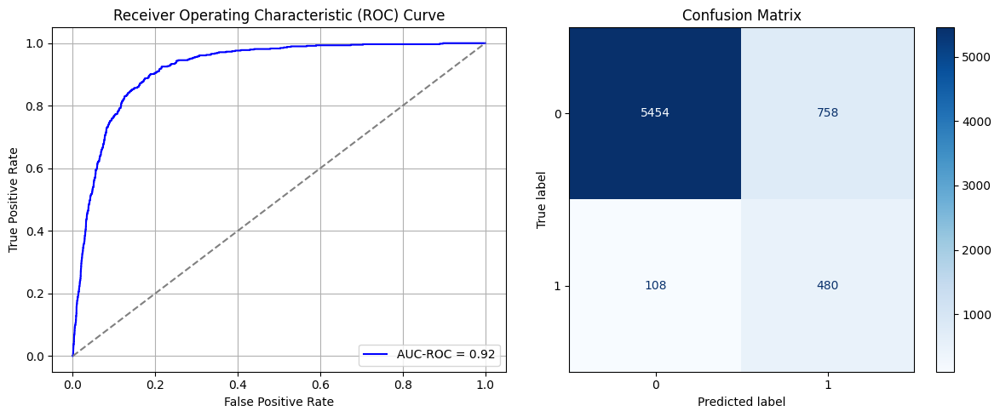

Best threshold based on F1-score: 0.998107373714447
False Negative Rate: 0.1836734693877551
Time elapsed (performance): 0.7795498089999455
(np.float64(0.12202189311010947), np.float64(0.8779781068898905))
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6976 - loss: 0.6507 - val_AUC: 0.7712 - val_loss: 0.5842
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7920 - loss: 0.5648 - val_AUC: 0.8542 - val_loss: 0.5023
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8592 - loss: 0.4841 - val_AUC: 0.8705 - val_loss: 0.4726
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8614 - loss: 0.4752 - val_AUC: 0.8750 - val_loss: 0.4508
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8769 - loss: 0.4470 - val_AUC: 0.8756 - val_loss: 0.4472
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8853 - loss: 0.4368 - val_AUC: 0.8772 - val_loss: 0.4445
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8819 - loss: 0.4395 - val_AUC: 0.8767 - val_loss: 0.4440
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8818 - loss: 0.4394 - val_AUC: 0.8762 - val_loss: 0.4439
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8840 -

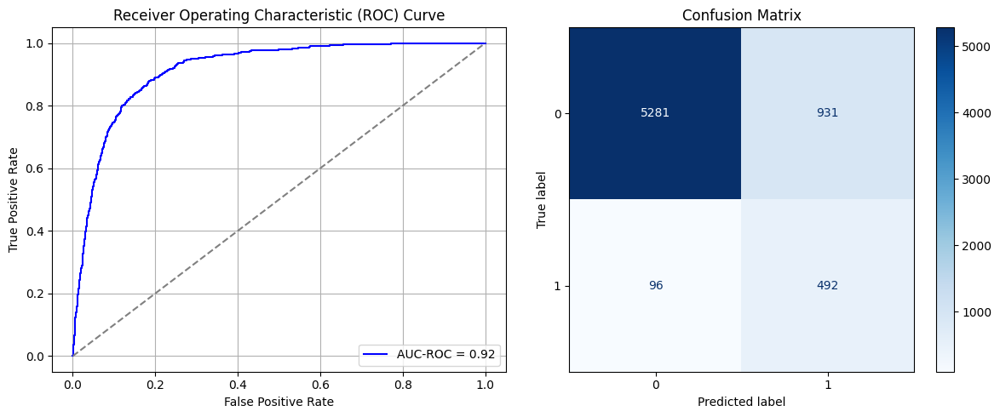

Best threshold based on F1-score: 0.6600224375724792
False Negative Rate: 0.16326530612244897
Time elapsed (performance): 0.774887953999496
(np.float64(0.14987121699935607), np.float64(0.8501287830006439))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6457 - loss: 0.6597 - val_AUC: 0.7627 - val_loss: 0.5919
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7949 - loss: 0.5592 - val_AUC: 0.8543 - val_loss: 0.5098
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8574 - loss: 0.4833 - val_AUC: 0.8707 - val_loss: 0.4577
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8731 - loss: 0.4526 - val_AUC: 0.8741 - val_loss: 0.4496
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8846 - loss: 0.4318 - val_AUC: 0.8774 - val_loss: 0.4443
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8864 - loss: 0.4278 - val_AUC: 0.8774 - val_loss: 0.4418
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8972 - loss: 0.4074 - val_AUC: 0.8768 - val_loss: 0.4438
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8861 - loss: 0.4266 - val_AUC: 0.8767 - val_loss: 0.4492
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8878 -

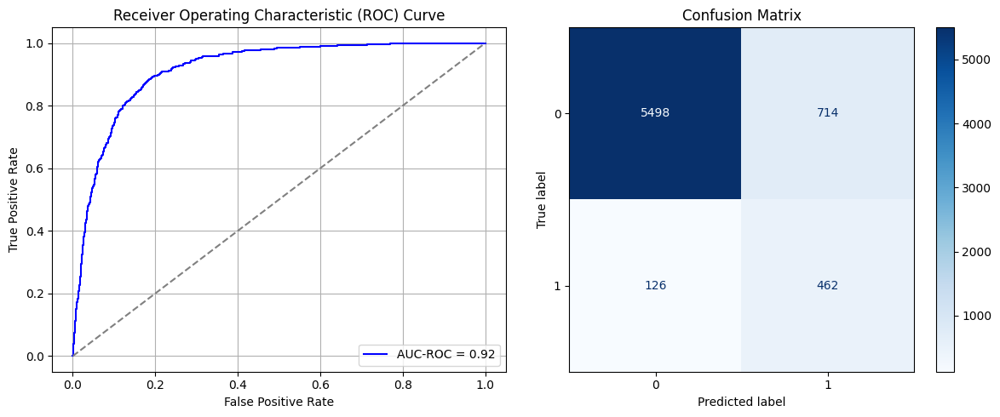

Best threshold based on F1-score: 0.6562714576721191
False Negative Rate: 0.21428571428571427
Time elapsed (performance): 0.7993925109985867
(np.float64(0.11493882807469415), np.float64(0.8850611719253059))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.5853 - loss: 0.6755 - val_AUC: 0.7489 - val_loss: 0.5913
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7739 - loss: 0.5723 - val_AUC: 0.8343 - val_loss: 0.5131
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8492 - loss: 0.4895 - val_AUC: 0.8638 - val_loss: 0.4707
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8733 - loss: 0.4565 - val_AUC: 0.8658 - val_loss: 0.4669
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8815 - loss: 0.4398 - val_AUC: 0.8697 - val_loss: 0.4613
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8787 - loss: 0.4430 - val_AUC: 0.8713 - val_loss: 0.4608
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8848 - loss: 0.4310 - val_AUC: 0.8706 - val_loss: 0.4548
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8877 - loss: 0.4251 - val_AUC: 0.8711 - val_loss: 0.4526
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8824 -

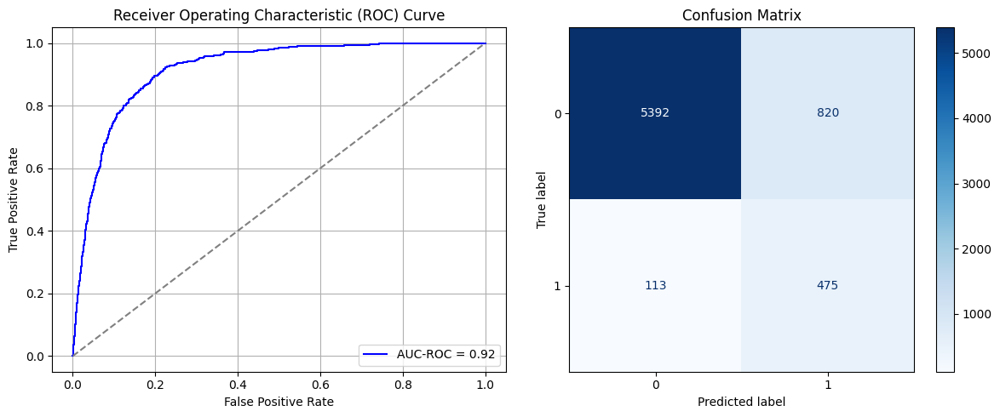

Best threshold based on F1-score: 0.659618616104126
False Negative Rate: 0.1921768707482993
Time elapsed (performance): 1.4050170219998108
(np.float64(0.1320025756600129), np.float64(0.8679974243399871))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.6179 - loss: 0.6696 - val_AUC: 0.7610 - val_loss: 0.6005
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7787 - loss: 0.5723 - val_AUC: 0.8465 - val_loss: 0.5048
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8536 - loss: 0.4888 - val_AUC: 0.8688 - val_loss: 0.4749
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8669 - loss: 0.4634 - val_AUC: 0.8745 - val_loss: 0.4475
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8852 - loss: 0.4317 - val_AUC: 0.8737 - val_loss: 0.4604
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8827 - loss: 0.4367 - val_AUC: 0.8797 - val_loss: 0.4380
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8885 - loss: 0.4264 - val_AUC: 0.8780 - val_loss: 0.4379
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8793 - loss: 0.4368 - val_AUC: 0.8811 - val_loss: 0.4337
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8903 -

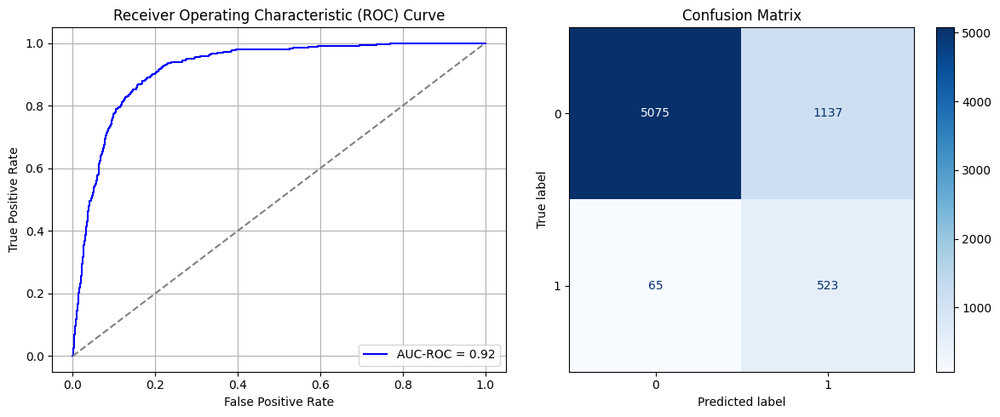

Best threshold based on F1-score: 0.9971438646316528
False Negative Rate: 0.11054421768707483
Time elapsed (performance): 1.0714618519996293
(np.float64(0.1830328396651642), np.float64(0.8169671603348359))
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6910 - loss: 0.6464 - val_AUC: 0.7626 - val_loss: 0.5874
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7908 - loss: 0.5624 - val_AUC: 0.8560 - val_loss: 0.5043
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8499 - loss: 0.4961 - val_AUC: 0.8731 - val_loss: 0.4596
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8794 - loss: 0.4519 - val_AUC: 0.8772 - val_loss: 0.4489
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8942 - loss: 0.4226 - val_AUC: 0.8767 - val_loss: 0.4436
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8917 - loss: 0.4217 - val_AUC: 0.8771 - val_loss: 0.4453
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8955 - loss: 0.4138 - val_AUC: 0.8767 - val_loss: 0.4427
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8965 - loss: 0.4117 - val_AUC: 0.8761 - val_loss: 0.4431
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8974 -

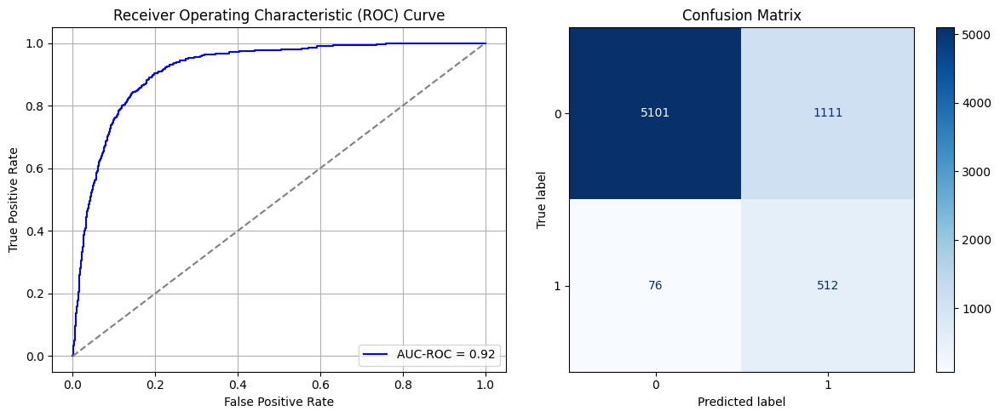

Best threshold based on F1-score: 0.9986078143119812
False Negative Rate: 0.1292517006802721
Time elapsed (performance): 1.2533608510002523
(np.float64(0.17884739214423695), np.float64(0.821152607855763))
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.6593 - loss: 0.6522 - val_AUC: 0.7646 - val_loss: 0.5808
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7869 - loss: 0.5639 - val_AUC: 0.8479 - val_loss: 0.5007
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8561 - loss: 0.4870 - val_AUC: 0.8735 - val_loss: 0.4564
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8834 - loss: 0.4384 - val_AUC: 0.8758 - val_loss: 0.4501
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8828 - loss: 0.4382 - val_AUC: 0.8803 - val_loss: 0.4440
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8833 - loss: 0.4342 - val_AUC: 0.8758 - val_loss: 0.4552
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8849 - loss: 0.4289 - val_AUC: 0.8798 - val_loss: 0.4444
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8832 - loss: 0.4316 - val_AUC: 0.8796 - val_loss: 0.4453
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8830 -

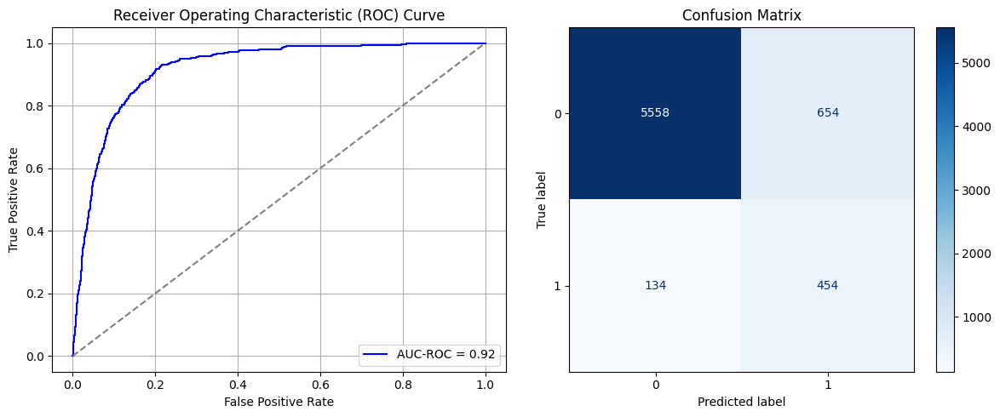

Best threshold based on F1-score: 0.9985409379005432
False Negative Rate: 0.22789115646258504
Time elapsed (performance): 0.9661438719995203
(np.float64(0.10528010302640052), np.float64(0.8947198969735994))
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.6662 - loss: 0.6551 - val_AUC: 0.7485 - val_loss: 0.6013
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7938 - loss: 0.5575 - val_AUC: 0.8440 - val_loss: 0.5139
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8571 - loss: 0.4856 - val_AUC: 0.8628 - val_loss: 0.4742
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8738 - loss: 0.4524 - val_AUC: 0.8665 - val_loss: 0.4680
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8767 - loss: 0.4438 - val_AUC: 0.8655 - val_loss: 0.4635
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8866 - loss: 0.4290 - val_AUC: 0.8699 - val_loss: 0.4606
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8774 - loss: 0.4420 - val_AUC: 0.8703 - val_loss: 0.4533
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8896 - loss: 0.4198 - val_AUC: 0.8722 - val_loss: 0.4496
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8910 -

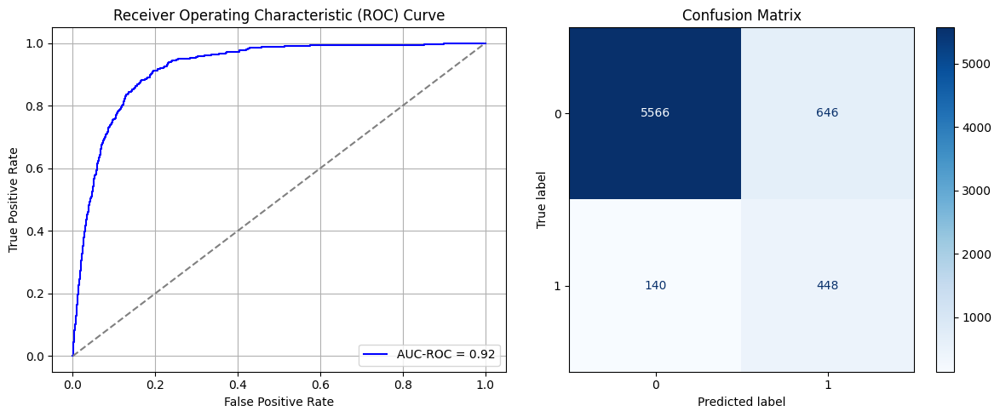

Best threshold based on F1-score: 0.9966259002685547
False Negative Rate: 0.23809523809523808
Time elapsed (performance): 1.0547798370007513
(np.float64(0.10399227301996136), np.float64(0.8960077269800386))
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - AUC: 0.6677 - loss: 0.6589 - val_AUC: 0.7681 - val_loss: 0.5880
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.7836 - loss: 0.5674 - val_AUC: 0.8436 - val_loss: 0.5019
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8413 - loss: 0.5024 - val_AUC: 0.8771 - val_loss: 0.4530
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8749 - loss: 0.4514 - val_AUC: 0.8834 - val_loss: 0.4414
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8757 - loss: 0.4444 - val_AUC: 0.8872 - val_loss: 0.4254
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8797 - loss: 0.4390 - val_AUC: 0.8877 - val_loss: 0.4287
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8875 - loss: 0.4242 - val_AUC: 0.8859 - val_loss: 0.4257
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8851 - loss: 0.4282 - val_AUC: 0.8834 - val_loss: 0.4377
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8910 -

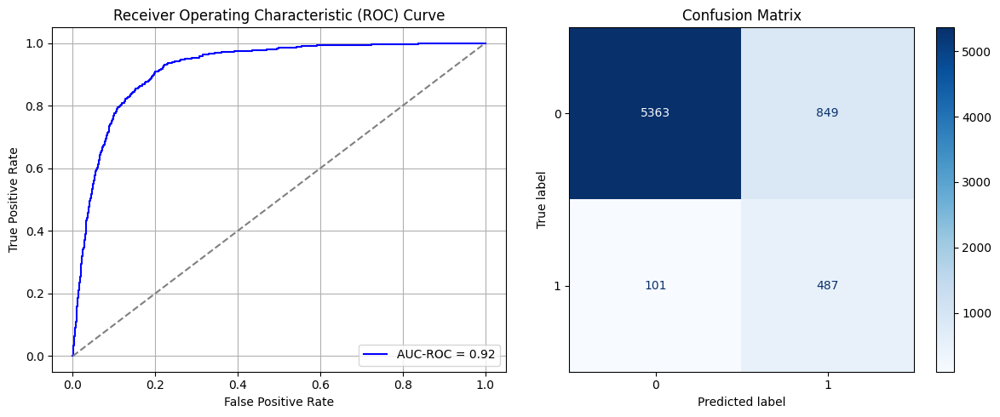

Best threshold based on F1-score: 0.7116619348526001
False Negative Rate: 0.1717687074829932
Time elapsed (performance): 0.9201047650003602
(np.float64(0.1366709594333548), np.float64(0.8633290405666452))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.6742 - loss: 0.6507 - val_AUC: 0.7935 - val_loss: 0.5641
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7990 - loss: 0.5513 - val_AUC: 0.8475 - val_loss: 0.4988
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8522 - loss: 0.4897 - val_AUC: 0.8645 - val_loss: 0.4707
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8746 - loss: 0.4560 - val_AUC: 0.8711 - val_loss: 0.4592
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8750 - loss: 0.4514 - val_AUC: 0.8732 - val_loss: 0.4601
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8887 - loss: 0.4290 - val_AUC: 0.8732 - val_loss: 0.4609
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8768 - loss: 0.4454 - val_AUC: 0.8735 - val_loss: 0.4495
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8872 - loss: 0.4286 - val_AUC: 0.8735 - val_loss: 0.4515
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8833 -

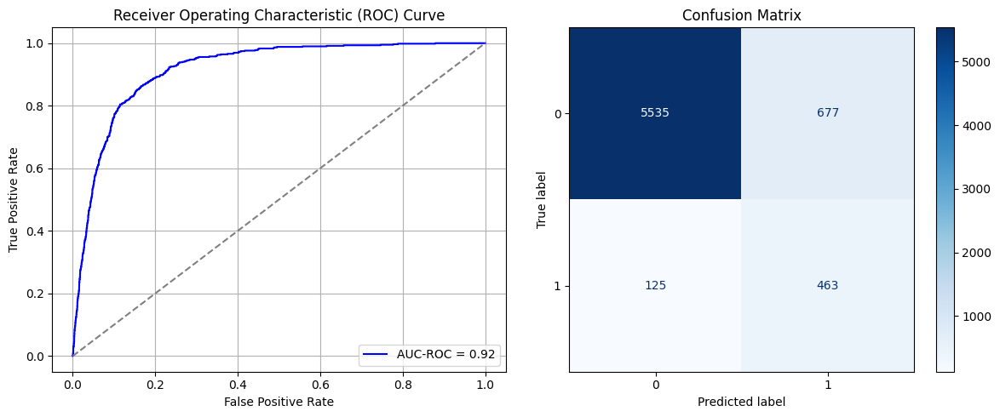

Best threshold based on F1-score: 0.9972633719444275
False Negative Rate: 0.21258503401360543
Time elapsed (performance): 0.8276419909998367
(np.float64(0.10898261429491307), np.float64(0.8910173857050869))
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - AUC: 0.6401 - loss: 0.6624 - val_AUC: 0.7561 - val_loss: 0.5908
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7906 - loss: 0.5608 - val_AUC: 0.8445 - val_loss: 0.5124
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8553 - loss: 0.4894 - val_AUC: 0.8623 - val_loss: 0.4739
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8723 - loss: 0.4541 - val_AUC: 0.8676 - val_loss: 0.4648
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8728 - loss: 0.4509 - val_AUC: 0.8673 - val_loss: 0.4591
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8800 - loss: 0.4380 - val_AUC: 0.8658 - val_loss: 0.4608
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8729 - loss: 0.4496 - val_AUC: 0.8694 - val_loss: 0.4556
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8869 - loss: 0.4261 - val_AUC: 0.8712 - val_loss: 0.4517
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8835 -

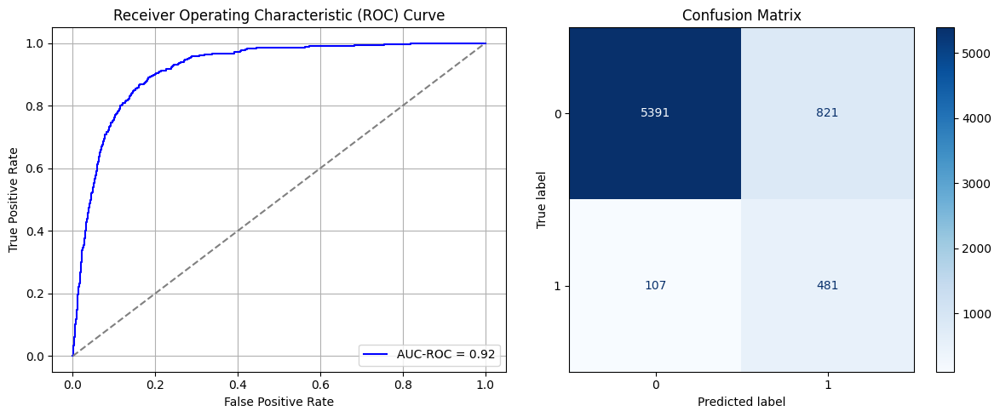

Best threshold based on F1-score: 0.6480181813240051
False Negative Rate: 0.18197278911564627
Time elapsed (performance): 1.0928794859992195
(np.float64(0.13216355441081779), np.float64(0.8678364455891823))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6648 - loss: 0.6574 - val_AUC: 0.7578 - val_loss: 0.5906
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7891 - loss: 0.5619 - val_AUC: 0.8486 - val_loss: 0.5012
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8610 - loss: 0.4798 - val_AUC: 0.8720 - val_loss: 0.4573
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8722 - loss: 0.4547 - val_AUC: 0.8755 - val_loss: 0.4468
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8853 - loss: 0.4330 - val_AUC: 0.8776 - val_loss: 0.4410
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8808 - loss: 0.4354 - val_AUC: 0.8788 - val_loss: 0.4387
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8867 - loss: 0.4253 - val_AUC: 0.8738 - val_loss: 0.4470
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8924 - loss: 0.4160 - val_AUC: 0.8781 - val_loss: 0.4370
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8904 -

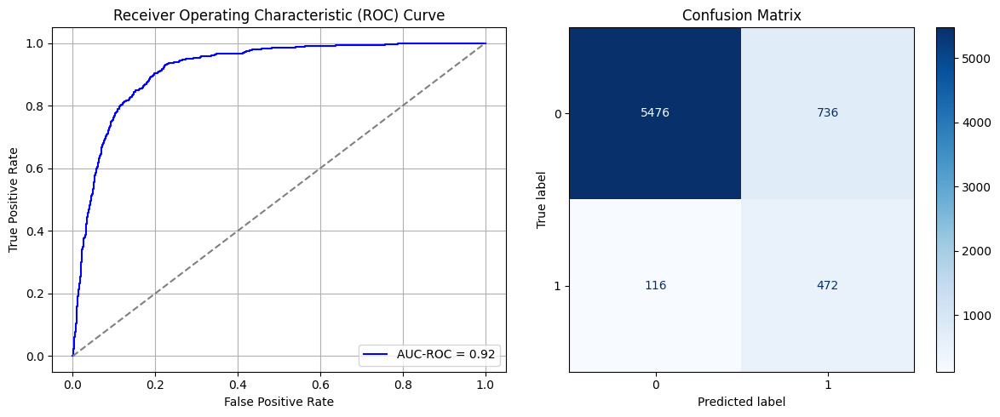

Best threshold based on F1-score: 0.996370255947113
False Negative Rate: 0.19727891156462585
Time elapsed (performance): 1.0675631510002859
(np.float64(0.1184803605924018), np.float64(0.8815196394075981))
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.6891 - loss: 0.6552 - val_AUC: 0.7706 - val_loss: 0.5868
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7835 - loss: 0.5674 - val_AUC: 0.8496 - val_loss: 0.5099
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8567 - loss: 0.4906 - val_AUC: 0.8736 - val_loss: 0.4694
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8834 - loss: 0.4420 - val_AUC: 0.8810 - val_loss: 0.4461
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8791 - loss: 0.4466 - val_AUC: 0.8818 - val_loss: 0.4467
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8846 - loss: 0.4343 - val_AUC: 0.8808 - val_loss: 0.4451
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8906 - loss: 0.4228 - val_AUC: 0.8805 - val_loss: 0.4395
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8904 - loss: 0.4219 - val_AUC: 0.8825 - val_loss: 0.4341
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8921 -

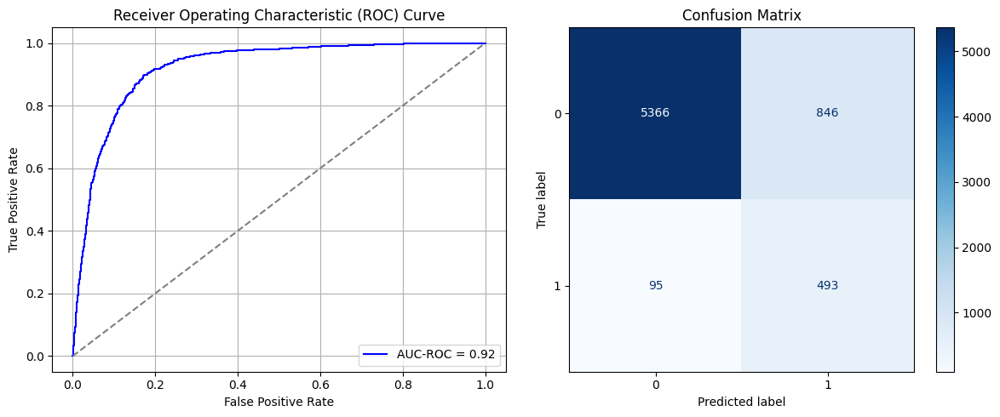

Best threshold based on F1-score: 0.9957841634750366
False Negative Rate: 0.16156462585034015
Time elapsed (performance): 0.8395472450010857
(np.float64(0.13618802318094012), np.float64(0.8638119768190599))
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.7000 - loss: 0.6398 - val_AUC: 0.7849 - val_loss: 0.5701
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8071 - loss: 0.5446 - val_AUC: 0.8497 - val_loss: 0.4948
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8555 - loss: 0.4845 - val_AUC: 0.8722 - val_loss: 0.4632
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8710 - loss: 0.4580 - val_AUC: 0.8753 - val_loss: 0.4441
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8752 - loss: 0.4463 - val_AUC: 0.8767 - val_loss: 0.4463
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8909 - loss: 0.4217 - val_AUC: 0.8763 - val_loss: 0.4430
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8845 - loss: 0.4271 - val_AUC: 0.8750 - val_loss: 0.4459
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8964 - loss: 0.4073 - val_AUC: 0.8791 - val_loss: 0.4401
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8818 -

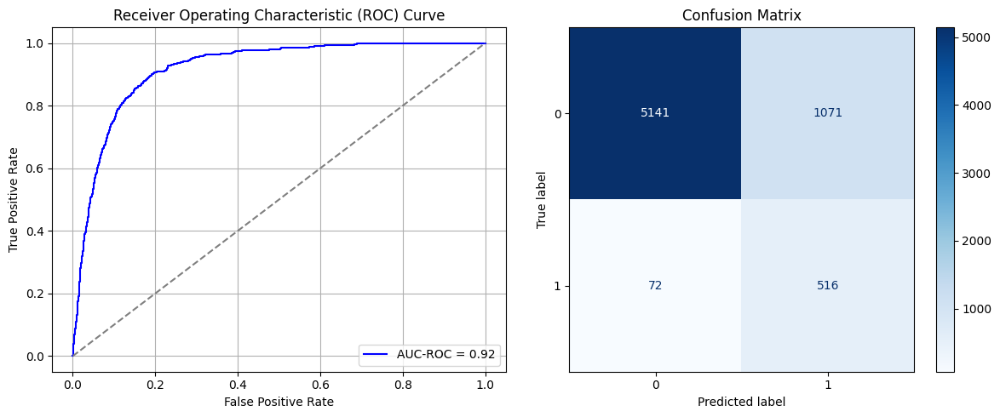

Best threshold based on F1-score: 0.9957409501075745
False Negative Rate: 0.12244897959183673
Time elapsed (performance): 0.8540868069994758
(np.float64(0.1724082421120412), np.float64(0.8275917578879588))
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - AUC: 0.6890 - loss: 0.6465 - val_AUC: 0.7779 - val_loss: 0.5764
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.7877 - loss: 0.5607 - val_AUC: 0.8567 - val_loss: 0.4987
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8539 - loss: 0.4882 - val_AUC: 0.8811 - val_loss: 0.4523
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8749 - loss: 0.4539 - val_AUC: 0.8801 - val_loss: 0.4516
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8769 - loss: 0.4466 - val_AUC: 0.8838 - val_loss: 0.4350
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8819 - loss: 0.4349 - val_AUC: 0.8836 - val_loss: 0.4329
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8817 - loss: 0.4344 - val_AUC: 0.8871 - val_loss: 0.4325
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8800 - loss: 0.4386 - val_AUC: 0.8863 - val_loss: 0.4378
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8804 -

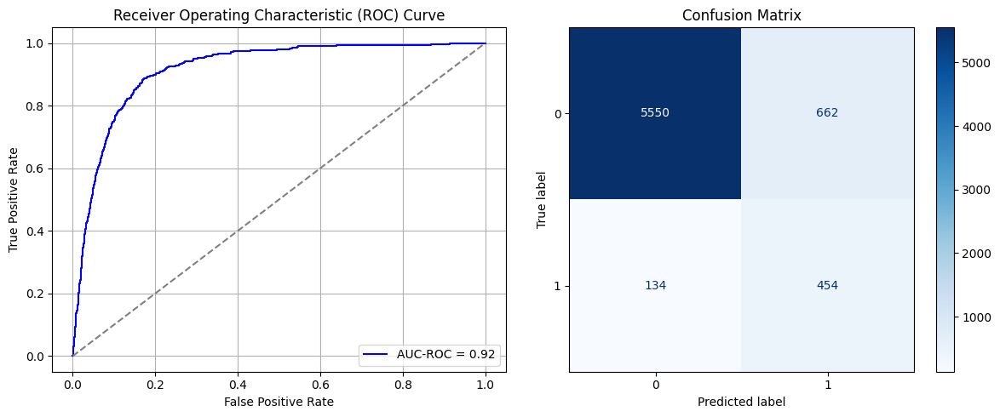

Best threshold based on F1-score: 0.9983312487602234
False Negative Rate: 0.22789115646258504
Time elapsed (performance): 1.2727223389993014
(np.float64(0.10656793303283967), np.float64(0.8934320669671604))
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6694 - loss: 0.6546 - val_AUC: 0.7574 - val_loss: 0.5951
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7784 - loss: 0.5737 - val_AUC: 0.8320 - val_loss: 0.5240
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8480 - loss: 0.4970 - val_AUC: 0.8577 - val_loss: 0.4826
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8674 - loss: 0.4658 - val_AUC: 0.8686 - val_loss: 0.4617
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8751 - loss: 0.4519 - val_AUC: 0.8720 - val_loss: 0.4519
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8706 - loss: 0.4559 - val_AUC: 0.8730 - val_loss: 0.4492
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8736 - loss: 0.4493 - val_AUC: 0.8755 - val_loss: 0.4448
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8805 - loss: 0.4355 - val_AUC: 0.8763 - val_loss: 0.4531
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8888 -

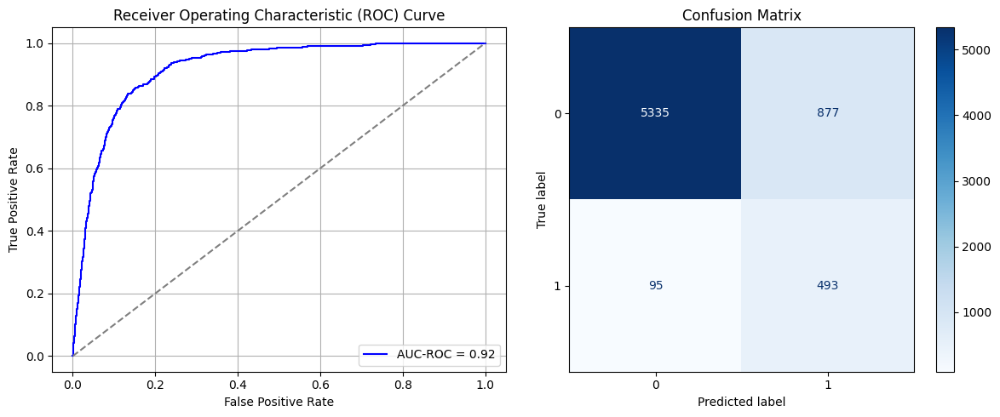

Best threshold based on F1-score: 0.6614725589752197
False Negative Rate: 0.16156462585034015
Time elapsed (performance): 1.0521555389987043
(np.float64(0.14117836445589182), np.float64(0.8588216355441082))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6575 - loss: 0.6560 - val_AUC: 0.7672 - val_loss: 0.5835
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7942 - loss: 0.5596 - val_AUC: 0.8558 - val_loss: 0.5018
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8519 - loss: 0.4943 - val_AUC: 0.8693 - val_loss: 0.4656
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8695 - loss: 0.4622 - val_AUC: 0.8749 - val_loss: 0.4520
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8747 - loss: 0.4506 - val_AUC: 0.8792 - val_loss: 0.4473
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8804 - loss: 0.4394 - val_AUC: 0.8760 - val_loss: 0.4506
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8731 - loss: 0.4514 - val_AUC: 0.8774 - val_loss: 0.4425
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8873 - loss: 0.4261 - val_AUC: 0.8766 - val_loss: 0.4460
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8899 -

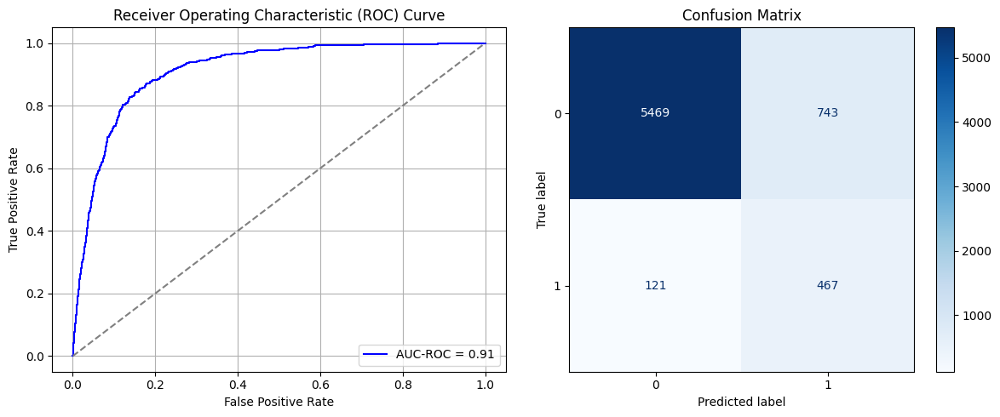

Best threshold based on F1-score: 0.9978857040405273
False Negative Rate: 0.20578231292517007
Time elapsed (performance): 0.872690866000994
(np.float64(0.11960721184803606), np.float64(0.880392788151964))
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6656 - loss: 0.6573 - val_AUC: 0.7624 - val_loss: 0.6010
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7915 - loss: 0.5621 - val_AUC: 0.8380 - val_loss: 0.5083
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8575 - loss: 0.4847 - val_AUC: 0.8651 - val_loss: 0.4677
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8764 - loss: 0.4486 - val_AUC: 0.8705 - val_loss: 0.4601
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8786 - loss: 0.4408 - val_AUC: 0.8694 - val_loss: 0.4611
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8874 - loss: 0.4270 - val_AUC: 0.8718 - val_loss: 0.4562
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8912 - loss: 0.4208 - val_AUC: 0.8719 - val_loss: 0.4510
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8888 - loss: 0.4214 - val_AUC: 0.8706 - val_loss: 0.4523
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8864 -

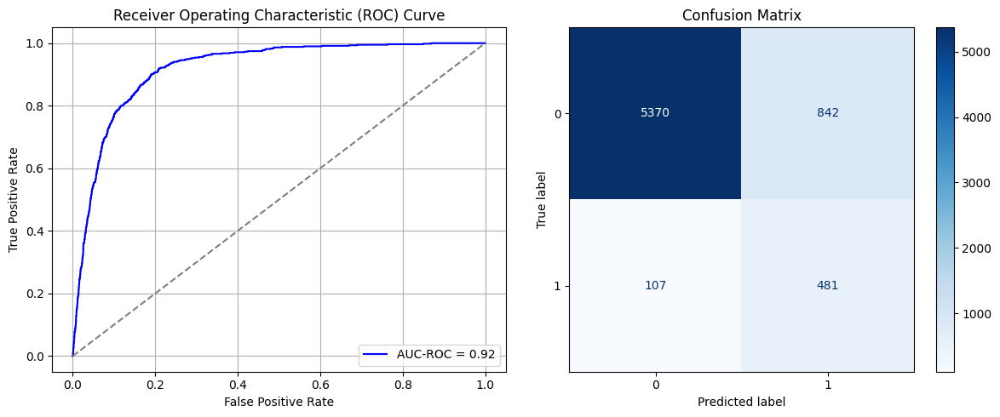

Best threshold based on F1-score: 0.9986297488212585
False Negative Rate: 0.18197278911564627
Time elapsed (performance): 1.1120005560005666
(np.float64(0.13554410817772053), np.float64(0.8644558918222794))
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.6700 - loss: 0.6532 - val_AUC: 0.7586 - val_loss: 0.5899
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7964 - loss: 0.5572 - val_AUC: 0.8535 - val_loss: 0.4951
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8661 - loss: 0.4713 - val_AUC: 0.8732 - val_loss: 0.4605
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8768 - loss: 0.4495 - val_AUC: 0.8748 - val_loss: 0.4632
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8872 - loss: 0.4305 - val_AUC: 0.8762 - val_loss: 0.4468
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8776 - loss: 0.4422 - val_AUC: 0.8761 - val_loss: 0.4507
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8800 - loss: 0.4373 - val_AUC: 0.8779 - val_loss: 0.4428
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8830 - loss: 0.4325 - val_AUC: 0.8810 - val_loss: 0.4384
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8933 -

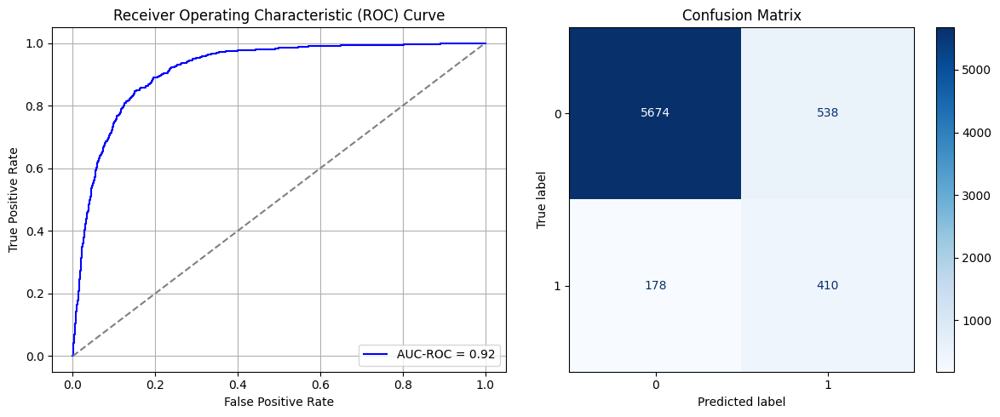

Best threshold based on F1-score: 0.9945209622383118
False Negative Rate: 0.30272108843537415
Time elapsed (performance): 1.0958893499991973
(np.float64(0.08660656793303284), np.float64(0.9133934320669672))
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6679 - loss: 0.6528 - val_AUC: 0.7517 - val_loss: 0.5917
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7898 - loss: 0.5618 - val_AUC: 0.8514 - val_loss: 0.5071
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8563 - loss: 0.4865 - val_AUC: 0.8630 - val_loss: 0.4769
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8744 - loss: 0.4519 - val_AUC: 0.8657 - val_loss: 0.4654
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.8792 - loss: 0.4424 - val_AUC: 0.8720 - val_loss: 0.4608
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8820 - loss: 0.4370 - val_AUC: 0.8716 - val_loss: 0.4553
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8771 - loss: 0.4434 - val_AUC: 0.8720 - val_loss: 0.4525
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8837 - loss: 0.4309 - val_AUC: 0.8743 - val_loss: 0.4488
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8880 -

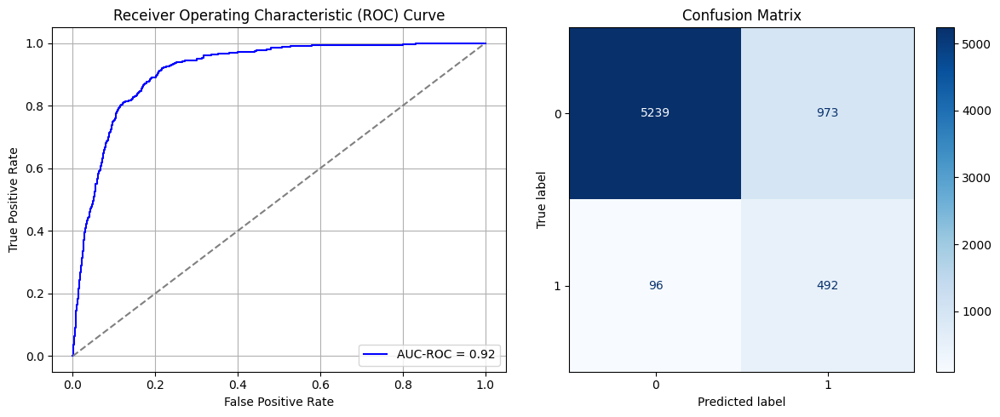

Best threshold based on F1-score: 0.6228674054145813
False Negative Rate: 0.16326530612244897
Time elapsed (performance): 1.0868628030002583
(np.float64(0.15663232453316162), np.float64(0.8433676754668384))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - AUC: 0.6416 - loss: 0.6626 - val_AUC: 0.7646 - val_loss: 0.5855
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8000 - loss: 0.5506 - val_AUC: 0.8503 - val_loss: 0.5006
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8660 - loss: 0.4723 - val_AUC: 0.8673 - val_loss: 0.4907
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8741 - loss: 0.4543 - val_AUC: 0.8704 - val_loss: 0.5009
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8678 - loss: 0.4581 - val_AUC: 0.8695 - val_loss: 0.4558
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8843 - loss: 0.4316 - val_AUC: 0.8734 - val_loss: 0.4508
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8883 - loss: 0.4239 - val_AUC: 0.8709 - val_loss: 0.4570
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8898 - loss: 0.4226 - val_AUC: 0.8728 - val_loss: 0.4511
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8883 

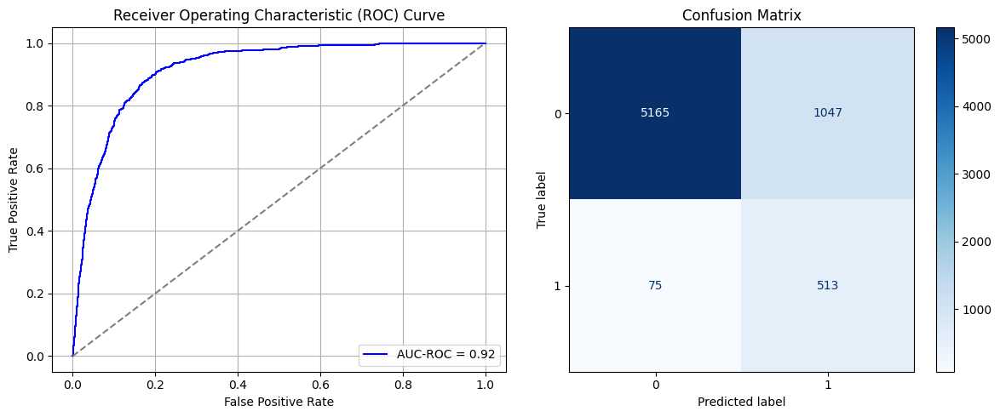

Best threshold based on F1-score: 0.9990516304969788
False Negative Rate: 0.12755102040816327
Time elapsed (performance): 1.263214380998761
(np.float64(0.16854475209272377), np.float64(0.8314552479072762))
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6895 - loss: 0.6485 - val_AUC: 0.7609 - val_loss: 0.5926
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7895 - loss: 0.5628 - val_AUC: 0.8344 - val_loss: 0.5235
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8360 - loss: 0.5094 - val_AUC: 0.8627 - val_loss: 0.4786
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8678 - loss: 0.4664 - val_AUC: 0.8677 - val_loss: 0.4620
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8746 - loss: 0.4490 - val_AUC: 0.8713 - val_loss: 0.4594
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8774 - loss: 0.4448 - val_AUC: 0.8712 - val_loss: 0.4698
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8784 - loss: 0.4449 - val_AUC: 0.8752 - val_loss: 0.4483
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8780 - loss: 0.4431 - val_AUC: 0.8746 - val_loss: 0.4463
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8828 -

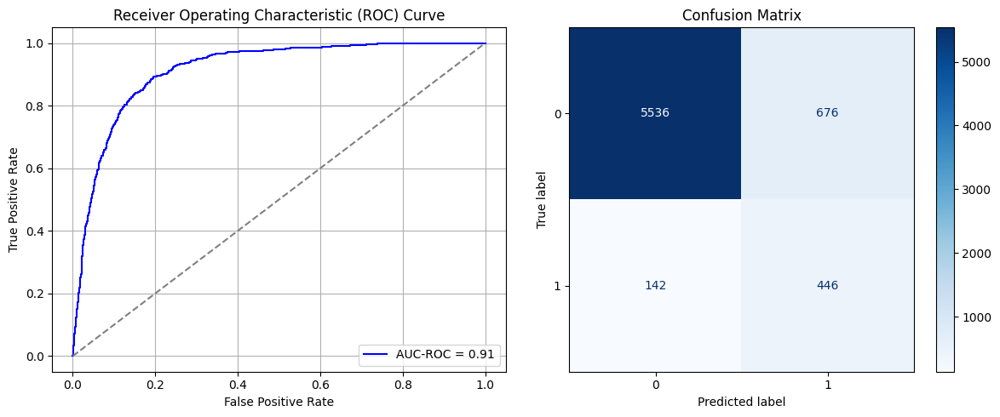

Best threshold based on F1-score: 0.9971728920936584
False Negative Rate: 0.24149659863945577
Time elapsed (performance): 1.2143389850007225
(np.float64(0.10882163554410818), np.float64(0.8911783644558918))
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.6402 - loss: 0.6579 - val_AUC: 0.7647 - val_loss: 0.5911
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7718 - loss: 0.5746 - val_AUC: 0.8498 - val_loss: 0.4971
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8576 - loss: 0.4888 - val_AUC: 0.8758 - val_loss: 0.4563
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8836 - loss: 0.4427 - val_AUC: 0.8815 - val_loss: 0.4568
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8889 - loss: 0.4348 - val_AUC: 0.8812 - val_loss: 0.4460
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8896 - loss: 0.4293 - val_AUC: 0.8817 - val_loss: 0.4407
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8876 - loss: 0.4329 - val_AUC: 0.8816 - val_loss: 0.4406
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8829 - loss: 0.4374 - val_AUC: 0.8821 - val_loss: 0.4463
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8901 -

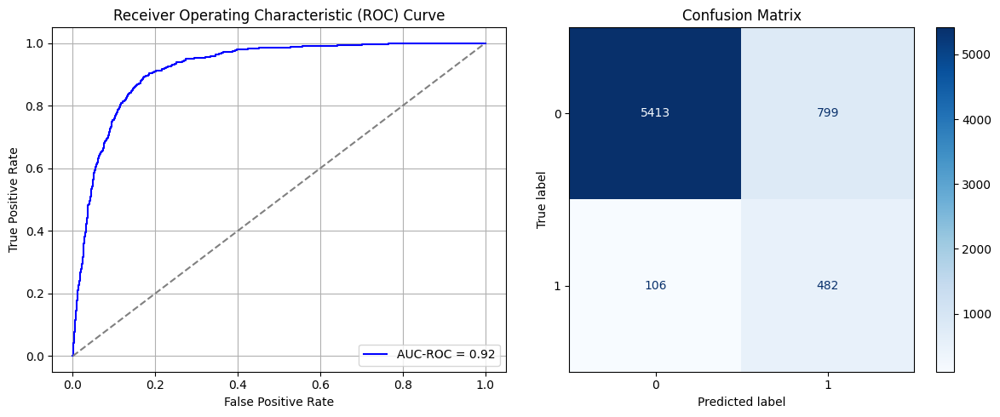

Best threshold based on F1-score: 0.9977033734321594
False Negative Rate: 0.18027210884353742
Time elapsed (performance): 1.055122665999079
(np.float64(0.12862202189311012), np.float64(0.8713779781068899))
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6858 - loss: 0.6512 - val_AUC: 0.7688 - val_loss: 0.5778
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7976 - loss: 0.5514 - val_AUC: 0.8470 - val_loss: 0.5053
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8710 - loss: 0.4680 - val_AUC: 0.8665 - val_loss: 0.4755
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8768 - loss: 0.4510 - val_AUC: 0.8723 - val_loss: 0.4575
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8817 - loss: 0.4396 - val_AUC: 0.8739 - val_loss: 0.4524
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8937 - loss: 0.4205 - val_AUC: 0.8744 - val_loss: 0.4533
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.8806 - loss: 0.4390 - val_AUC: 0.8748 - val_loss: 0.4488
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8851 - loss: 0.4289 - val_AUC: 0.8721 - val_loss: 0.4552
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8891 -

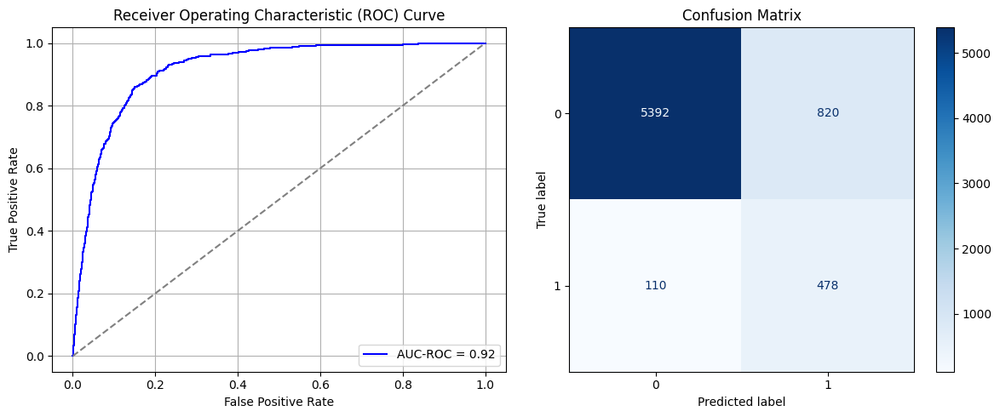

Best threshold based on F1-score: 0.6860150098800659
False Negative Rate: 0.1870748299319728
Time elapsed (performance): 0.8961742890005553
(np.float64(0.1320025756600129), np.float64(0.8679974243399871))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6578 - loss: 0.6591 - val_AUC: 0.7620 - val_loss: 0.5845
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7839 - loss: 0.5645 - val_AUC: 0.8509 - val_loss: 0.5026
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8585 - loss: 0.4868 - val_AUC: 0.8671 - val_loss: 0.4633
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8735 - loss: 0.4566 - val_AUC: 0.8695 - val_loss: 0.4770
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8731 - loss: 0.4541 - val_AUC: 0.8738 - val_loss: 0.4497
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8777 - loss: 0.4436 - val_AUC: 0.8729 - val_loss: 0.4465
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8803 - loss: 0.4378 - val_AUC: 0.8742 - val_loss: 0.4496
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8835 - loss: 0.4311 - val_AUC: 0.8747 - val_loss: 0.4433
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8852 -

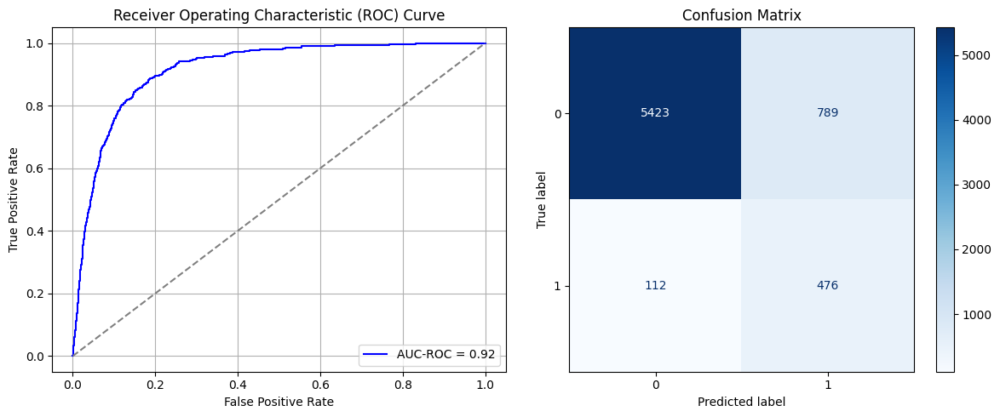

Best threshold based on F1-score: 0.9901228547096252
False Negative Rate: 0.19047619047619047
Time elapsed (performance): 1.0625830010012578
(np.float64(0.12701223438506118), np.float64(0.8729877656149388))
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6514 - loss: 0.6546 - val_AUC: 0.7755 - val_loss: 0.5746
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7857 - loss: 0.5661 - val_AUC: 0.8476 - val_loss: 0.5043
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8629 - loss: 0.4740 - val_AUC: 0.8717 - val_loss: 0.4695
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8771 - loss: 0.4520 - val_AUC: 0.8735 - val_loss: 0.4512
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8814 - loss: 0.4376 - val_AUC: 0.8759 - val_loss: 0.4474
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8804 - loss: 0.4372 - val_AUC: 0.8727 - val_loss: 0.4748
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8797 - loss: 0.4383 - val_AUC: 0.8754 - val_loss: 0.4506
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8821 - loss: 0.4336 - val_AUC: 0.8747 - val_loss: 0.4458
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8917 -

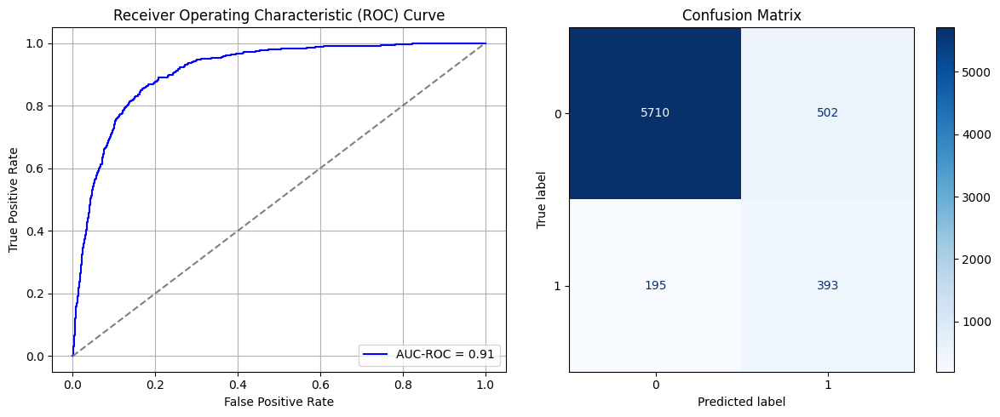

Best threshold based on F1-score: 0.9975517988204956
False Negative Rate: 0.33163265306122447
Time elapsed (performance): 1.0824822169997788
(np.float64(0.08081133290405666), np.float64(0.9191886670959434))
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6452 - loss: 0.6675 - val_AUC: 0.7534 - val_loss: 0.5941
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7747 - loss: 0.5760 - val_AUC: 0.8356 - val_loss: 0.5151
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8438 - loss: 0.5020 - val_AUC: 0.8664 - val_loss: 0.4790
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8736 - loss: 0.4545 - val_AUC: 0.8727 - val_loss: 0.4587
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8736 - loss: 0.4523 - val_AUC: 0.8767 - val_loss: 0.4513
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8787 - loss: 0.4472 - val_AUC: 0.8754 - val_loss: 0.4595
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8916 - loss: 0.4237 - val_AUC: 0.8798 - val_loss: 0.4469
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8856 - loss: 0.4302 - val_AUC: 0.8797 - val_loss: 0.4448
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8865 -

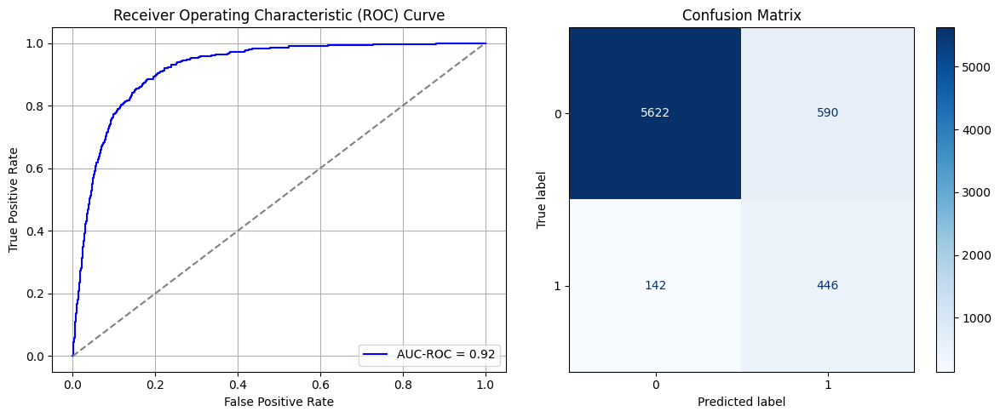

Best threshold based on F1-score: 0.9990518689155579
False Negative Rate: 0.24149659863945577
Time elapsed (performance): 1.0552194320007402
(np.float64(0.09497746297488731), np.float64(0.9050225370251127))
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6721 - loss: 0.6567 - val_AUC: 0.7548 - val_loss: 0.6011
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.7809 - loss: 0.5726 - val_AUC: 0.8295 - val_loss: 0.5274
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8445 - loss: 0.5023 - val_AUC: 0.8604 - val_loss: 0.4838
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8689 - loss: 0.4682 - val_AUC: 0.8684 - val_loss: 0.4648
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8791 - loss: 0.4475 - val_AUC: 0.8704 - val_loss: 0.4600
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8789 - loss: 0.4466 - val_AUC: 0.8701 - val_loss: 0.4588
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8790 - loss: 0.4441 - val_AUC: 0.8717 - val_loss: 0.4602
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8719 - loss: 0.4561 - val_AUC: 0.8730 - val_loss: 0.4657
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8848 -

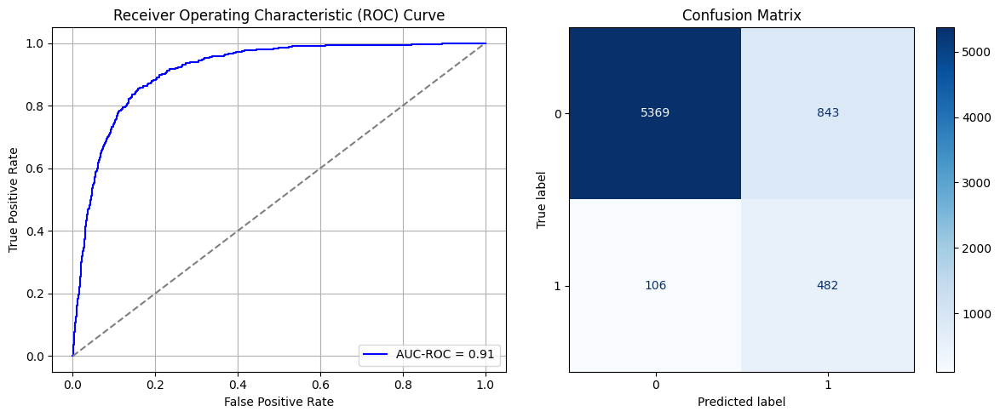

Best threshold based on F1-score: 0.9972769021987915
False Negative Rate: 0.18027210884353742
Time elapsed (performance): 1.047340818999146
(np.float64(0.13570508692852543), np.float64(0.8642949130714745))
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - AUC: 0.6634 - loss: 0.6550 - val_AUC: 0.7537 - val_loss: 0.5942
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.7715 - loss: 0.5762 - val_AUC: 0.8420 - val_loss: 0.5191
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8477 - loss: 0.5028 - val_AUC: 0.8704 - val_loss: 0.4636
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8694 - loss: 0.4601 - val_AUC: 0.8749 - val_loss: 0.4533
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8747 - loss: 0.4491 - val_AUC: 0.8759 - val_loss: 0.4614
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8915 - loss: 0.4224 - val_AUC: 0.8757 - val_loss: 0.4494
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8827 - loss: 0.4353 - val_AUC: 0.8735 - val_loss: 0.4538
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8956 - loss: 0.4163 - val_AUC: 0.8775 - val_loss: 0.4506
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8952 -

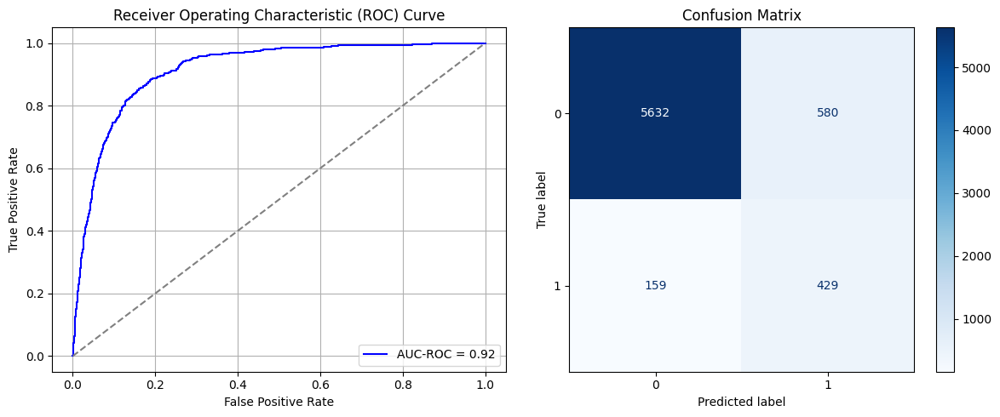

Best threshold based on F1-score: 0.9988611936569214
False Negative Rate: 0.27040816326530615
Time elapsed (performance): 1.069843874000071
(np.float64(0.09336767546683837), np.float64(0.9066323245331617))
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - AUC: 0.6671 - loss: 0.6556 - val_AUC: 0.7538 - val_loss: 0.5922
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.7836 - loss: 0.5662 - val_AUC: 0.8326 - val_loss: 0.5266
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8431 - loss: 0.5048 - val_AUC: 0.8696 - val_loss: 0.4866
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8673 - loss: 0.4657 - val_AUC: 0.8784 - val_loss: 0.4558
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8772 - loss: 0.4469 - val_AUC: 0.8779 - val_loss: 0.4473
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8831 - loss: 0.4340 - val_AUC: 0.8832 - val_loss: 0.4408
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8860 - loss: 0.4278 - val_AUC: 0.8839 - val_loss: 0.4314
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8850 - loss: 0.4292 - val_AUC: 0.8816 - val_loss: 0.4340
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8902 -

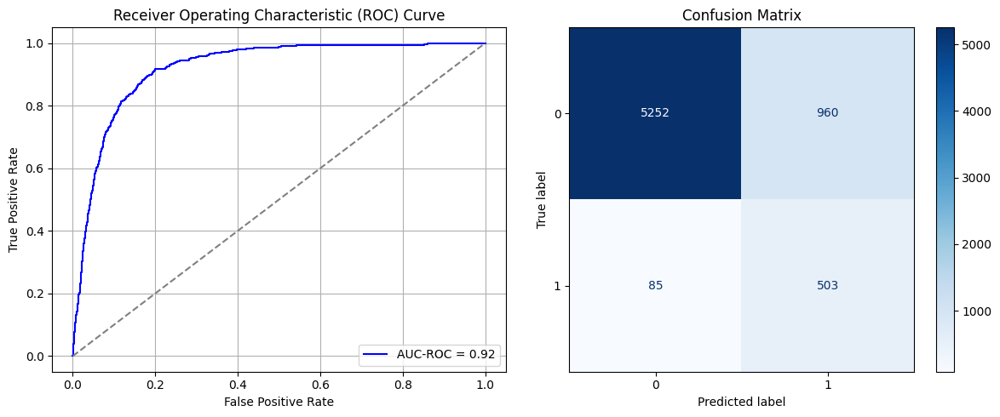

Best threshold based on F1-score: 0.6581666469573975
False Negative Rate: 0.1445578231292517
Time elapsed (performance): 1.0712072299993451
(np.float64(0.15453960077269802), np.float64(0.845460399227302))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - AUC: 0.6545 - loss: 0.6600 - val_AUC: 0.7781 - val_loss: 0.5778
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8040 - loss: 0.5488 - val_AUC: 0.8553 - val_loss: 0.4925
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8624 - loss: 0.4792 - val_AUC: 0.8697 - val_loss: 0.4772
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8765 - loss: 0.4491 - val_AUC: 0.8770 - val_loss: 0.4456
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8829 - loss: 0.4356 - val_AUC: 0.8757 - val_loss: 0.4581
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8763 - loss: 0.4448 - val_AUC: 0.8777 - val_loss: 0.4406
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8946 - loss: 0.4134 - val_AUC: 0.8786 - val_loss: 0.4378
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8872 - loss: 0.4247 - val_AUC: 0.8797 - val_loss: 0.4357
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8891 -

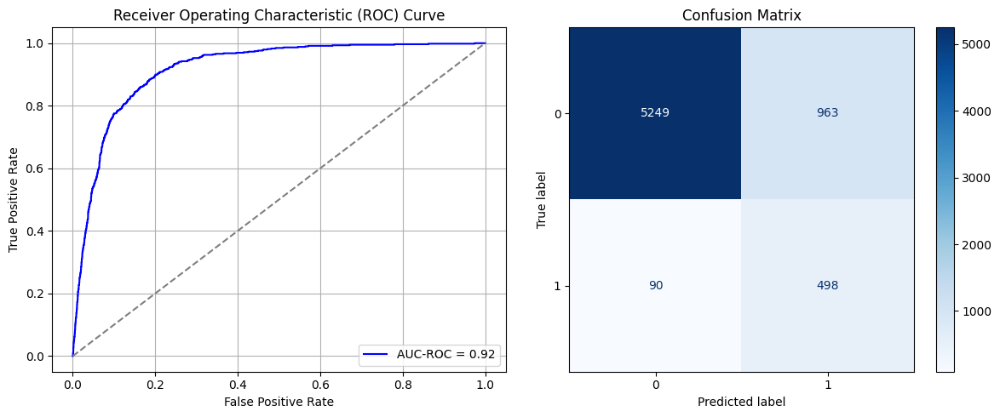

Best threshold based on F1-score: 0.7092985510826111
False Negative Rate: 0.15306122448979592
Time elapsed (performance): 0.9147845410006994
(np.float64(0.15502253702511268), np.float64(0.8449774629748873))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - AUC: 0.6532 - loss: 0.6604 - val_AUC: 0.7743 - val_loss: 0.5785
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.7969 - loss: 0.5505 - val_AUC: 0.8524 - val_loss: 0.5007
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8601 - loss: 0.4838 - val_AUC: 0.8684 - val_loss: 0.4657
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8746 - loss: 0.4556 - val_AUC: 0.8730 - val_loss: 0.4528
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8802 - loss: 0.4425 - val_AUC: 0.8726 - val_loss: 0.4507
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8726 - loss: 0.4509 - val_AUC: 0.8764 - val_loss: 0.4505
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8816 - loss: 0.4353 - val_AUC: 0.8764 - val_loss: 0.4417
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8808 - loss: 0.4348 - val_AUC: 0.8750 - val_loss: 0.4481
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8827 -

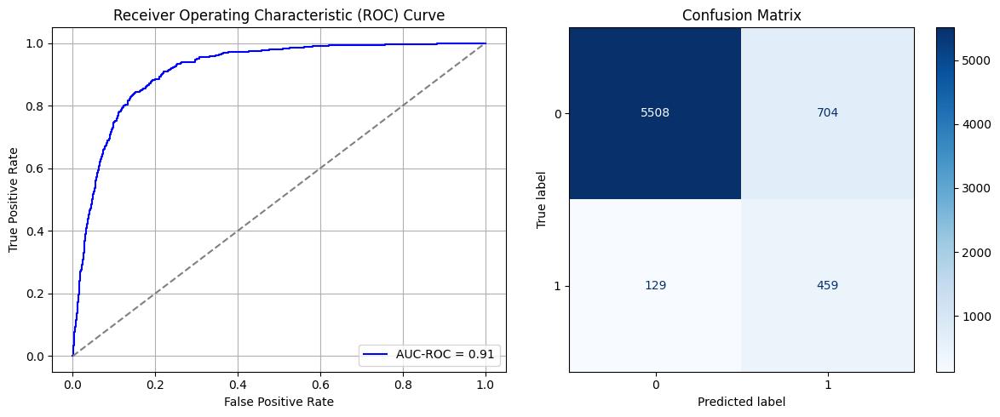

Best threshold based on F1-score: 0.667172372341156
False Negative Rate: 0.2193877551020408
Time elapsed (performance): 1.2547110799987422
(np.float64(0.11332904056664521), np.float64(0.8866709594333548))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.6703 - loss: 0.6572 - val_AUC: 0.7677 - val_loss: 0.5827
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7920 - loss: 0.5581 - val_AUC: 0.8519 - val_loss: 0.4949
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8569 - loss: 0.4820 - val_AUC: 0.8722 - val_loss: 0.4607
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8774 - loss: 0.4457 - val_AUC: 0.8791 - val_loss: 0.4459
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8766 - loss: 0.4426 - val_AUC: 0.8809 - val_loss: 0.4511
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8785 - loss: 0.4418 - val_AUC: 0.8783 - val_loss: 0.4408
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8853 - loss: 0.4290 - val_AUC: 0.8823 - val_loss: 0.4341
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8910 - loss: 0.4184 - val_AUC: 0.8815 - val_loss: 0.4370
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8971 -

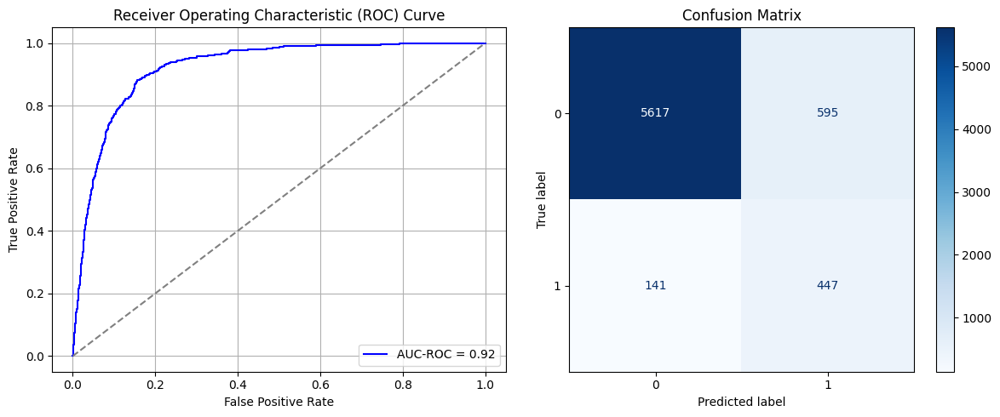

Best threshold based on F1-score: 0.5468043684959412
False Negative Rate: 0.23979591836734693
Time elapsed (performance): 1.0887404439999955
(np.float64(0.09578235672891178), np.float64(0.9042176432710882))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6333 - loss: 0.6641 - val_AUC: 0.7506 - val_loss: 0.5990
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7636 - loss: 0.5837 - val_AUC: 0.8335 - val_loss: 0.5246
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8426 - loss: 0.5095 - val_AUC: 0.8604 - val_loss: 0.4875
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8713 - loss: 0.4615 - val_AUC: 0.8663 - val_loss: 0.4636
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8769 - loss: 0.4516 - val_AUC: 0.8709 - val_loss: 0.4532
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8763 - loss: 0.4501 - val_AUC: 0.8716 - val_loss: 0.4517
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8869 - loss: 0.4275 - val_AUC: 0.8750 - val_loss: 0.4502
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8804 - loss: 0.4377 - val_AUC: 0.8737 - val_loss: 0.4527
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8765 -

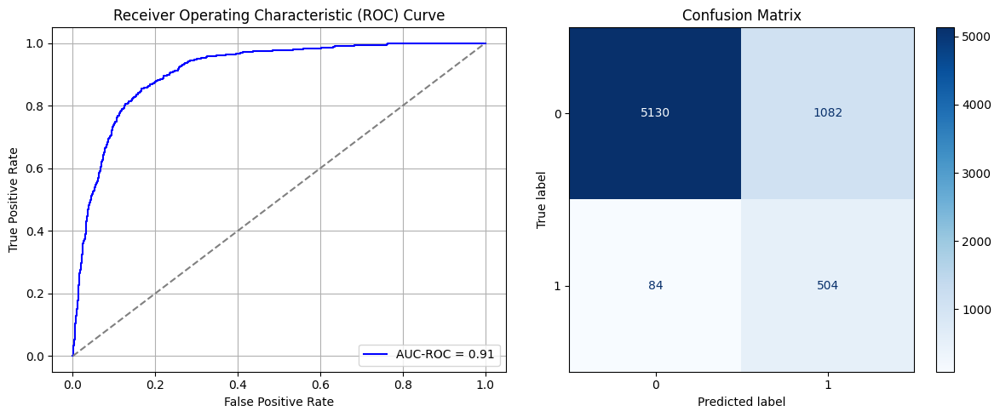

Best threshold based on F1-score: 0.9921819567680359
False Negative Rate: 0.14285714285714285
Time elapsed (performance): 1.0879617190003046
(np.float64(0.17417900837089503), np.float64(0.8258209916291049))
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6613 - loss: 0.6554 - val_AUC: 0.7621 - val_loss: 0.5872
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.7835 - loss: 0.5672 - val_AUC: 0.8464 - val_loss: 0.5034
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8491 - loss: 0.4925 - val_AUC: 0.8745 - val_loss: 0.4542
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8781 - loss: 0.4474 - val_AUC: 0.8795 - val_loss: 0.4453
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8843 - loss: 0.4364 - val_AUC: 0.8801 - val_loss: 0.4402
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8861 - loss: 0.4304 - val_AUC: 0.8811 - val_loss: 0.4381
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8900 - loss: 0.4214 - val_AUC: 0.8802 - val_loss: 0.4390
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8864 - loss: 0.4282 - val_AUC: 0.8827 - val_loss: 0.4320
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8923 -

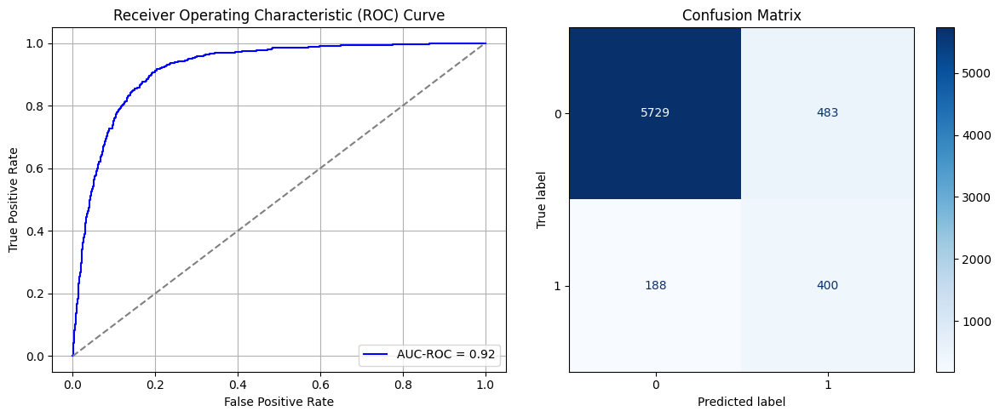

Best threshold based on F1-score: 0.9919617176055908
False Negative Rate: 0.3197278911564626
Time elapsed (performance): 0.9342930130005698
(np.float64(0.07775273663876368), np.float64(0.9222472633612363))
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6496 - loss: 0.6561 - val_AUC: 0.7854 - val_loss: 0.5710
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7890 - loss: 0.5634 - val_AUC: 0.8471 - val_loss: 0.5006
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8543 - loss: 0.4893 - val_AUC: 0.8728 - val_loss: 0.4707
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8732 - loss: 0.4582 - val_AUC: 0.8750 - val_loss: 0.4510
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8766 - loss: 0.4515 - val_AUC: 0.8735 - val_loss: 0.4528
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8819 - loss: 0.4393 - val_AUC: 0.8764 - val_loss: 0.4443
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8749 - loss: 0.4476 - val_AUC: 0.8751 - val_loss: 0.4442
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8847 - loss: 0.4293 - val_AUC: 0.8784 - val_loss: 0.4403
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - AUC: 0.8853 -

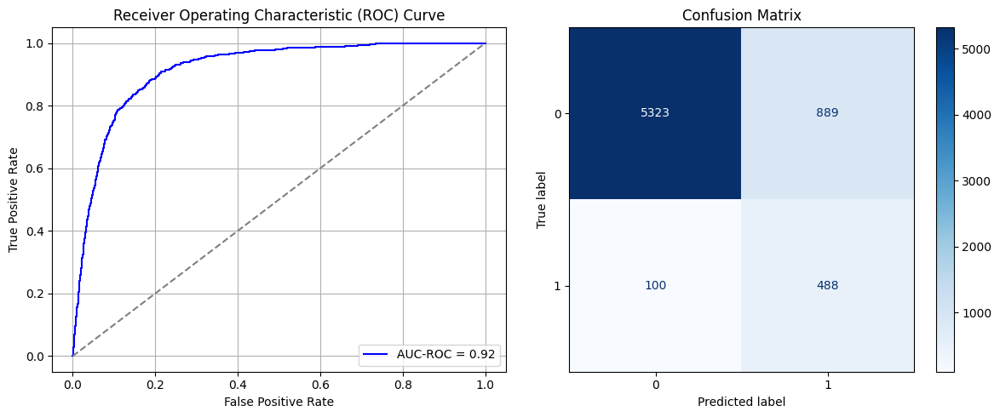

Best threshold based on F1-score: 0.6750316619873047
False Negative Rate: 0.17006802721088435
Time elapsed (performance): 3.9224871340011305
(np.float64(0.14311010946555056), np.float64(0.8568898905344494))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6988 - loss: 0.6452 - val_AUC: 0.7751 - val_loss: 0.5758
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8004 - loss: 0.5536 - val_AUC: 0.8494 - val_loss: 0.4976
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - AUC: 0.8577 - loss: 0.4824 - val_AUC: 0.8727 - val_loss: 0.4657
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8742 - loss: 0.4514 - val_AUC: 0.8765 - val_loss: 0.4493
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.8775 - loss: 0.4431 - val_AUC: 0.8779 - val_loss: 0.4437
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8921 - loss: 0.4183 - val_AUC: 0.8781 - val_loss: 0.4443
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8864 - loss: 0.4268 - val_AUC: 0.8780 - val_loss: 0.4421
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8947 - loss: 0.4119 - val_AUC: 0.8808 - val_loss: 0.4378
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8948 -

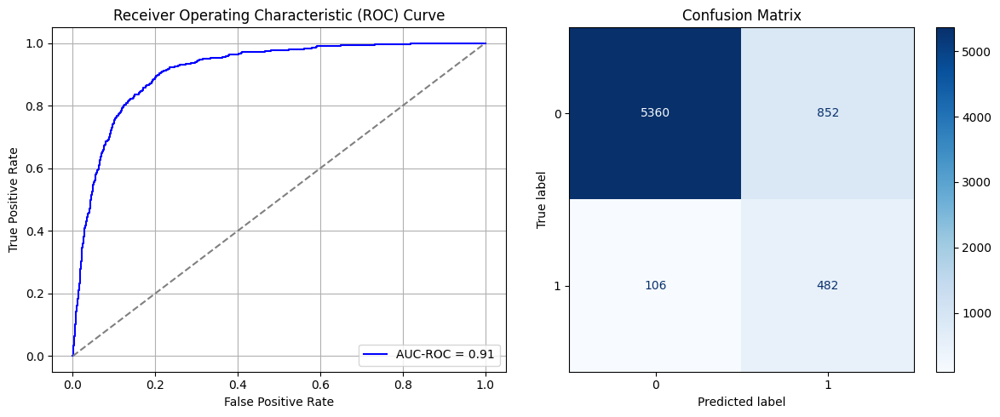

Best threshold based on F1-score: 0.6791480183601379
False Negative Rate: 0.18027210884353742
Time elapsed (performance): 0.9670080979994964
(np.float64(0.13715389568576947), np.float64(0.8628461043142306))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - AUC: 0.6183 - loss: 0.6679 - val_AUC: 0.7427 - val_loss: 0.5999
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.7720 - loss: 0.5762 - val_AUC: 0.8392 - val_loss: 0.5123
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.8542 - loss: 0.4884 - val_AUC: 0.8667 - val_loss: 0.4710
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8758 - loss: 0.4482 - val_AUC: 0.8744 - val_loss: 0.4464
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8773 - loss: 0.4437 - val_AUC: 0.8747 - val_loss: 0.4515
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8798 - loss: 0.4378 - val_AUC: 0.8763 - val_loss: 0.4432
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8837 - loss: 0.4304 - val_AUC: 0.8756 - val_loss: 0.4418
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8936 - loss: 0.4119 - val_AUC: 0.8771 - val_loss: 0.4430
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8898 -

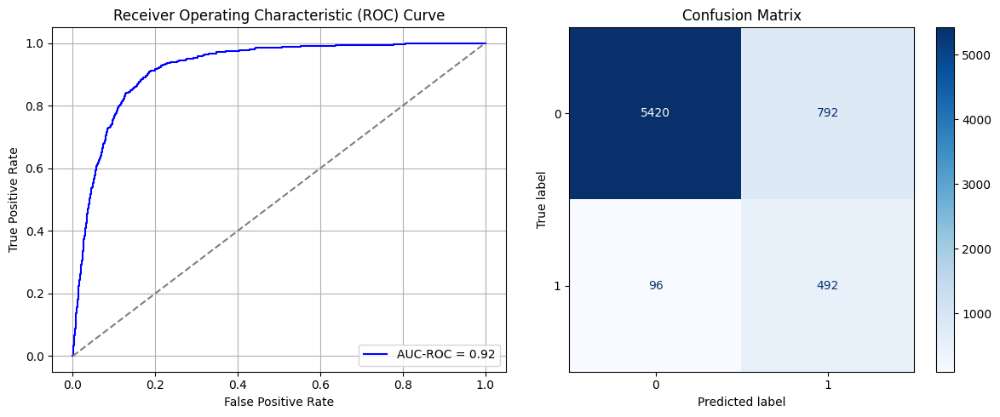

Best threshold based on F1-score: 0.9931066036224365
False Negative Rate: 0.16326530612244897
Time elapsed (performance): 0.9756240089991479
(np.float64(0.12749517063747584), np.float64(0.8725048293625242))
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - AUC: 0.6622 - loss: 0.6559 - val_AUC: 0.7594 - val_loss: 0.5889
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.7819 - loss: 0.5672 - val_AUC: 0.8447 - val_loss: 0.5101
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8522 - loss: 0.4930 - val_AUC: 0.8721 - val_loss: 0.4611
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8770 - loss: 0.4503 - val_AUC: 0.8736 - val_loss: 0.4852
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8813 - loss: 0.4397 - val_AUC: 0.8733 - val_loss: 0.4523
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8832 - loss: 0.4347 - val_AUC: 0.8743 - val_loss: 0.4442
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8811 - loss: 0.4350 - val_AUC: 0.8777 - val_loss: 0.4446
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8899 - loss: 0.4208 - val_AUC: 0.8773 - val_loss: 0.4392
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8889 -

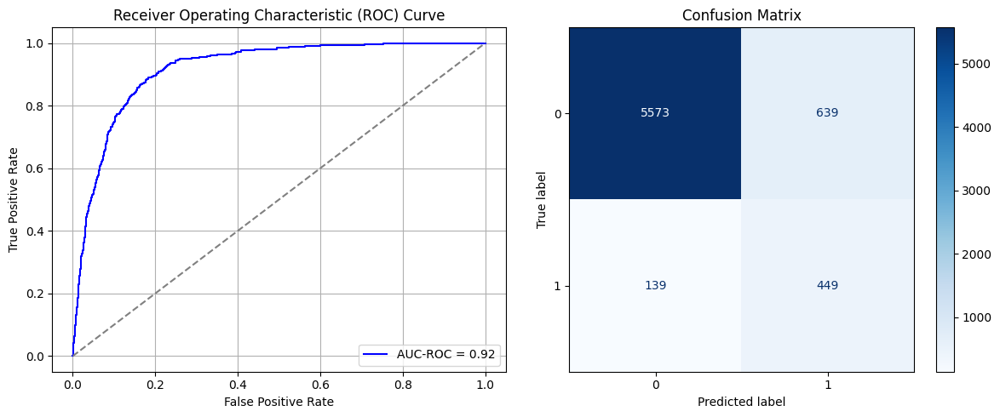

Best threshold based on F1-score: 0.9934061765670776
False Negative Rate: 0.23639455782312926
Time elapsed (performance): 1.0774697729993932
(np.float64(0.10286542176432711), np.float64(0.8971345782356729))
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - AUC: 0.6740 - loss: 0.6576 - val_AUC: 0.7747 - val_loss: 0.5796
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.7932 - loss: 0.5609 - val_AUC: 0.8496 - val_loss: 0.4958
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8540 - loss: 0.4875 - val_AUC: 0.8756 - val_loss: 0.4601
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8721 - loss: 0.4578 - val_AUC: 0.8774 - val_loss: 0.4481
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8762 - loss: 0.4478 - val_AUC: 0.8794 - val_loss: 0.4446
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8859 - loss: 0.4288 - val_AUC: 0.8810 - val_loss: 0.4387
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.8822 - loss: 0.4334 - val_AUC: 0.8803 - val_loss: 0.4376
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.8900 - loss: 0.4198 - val_AUC: 0.8815 - val_loss: 0.4340
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.8938 -

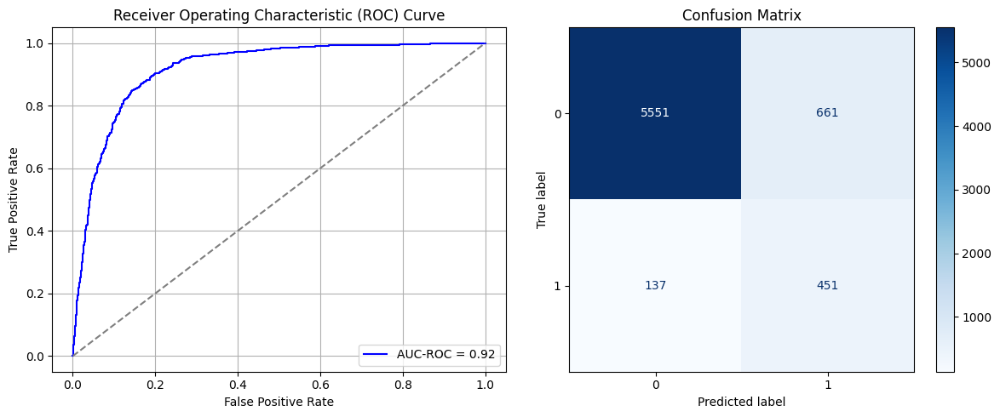

Best threshold based on F1-score: 0.9948888421058655
False Negative Rate: 0.23299319727891157
Time elapsed (performance): 1.0812932230001024
(np.float64(0.10640695428203477), np.float64(0.8935930457179653))
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6780 - loss: 0.6476 - val_AUC: 0.7654 - val_loss: 0.5862
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.7862 - loss: 0.5663 - val_AUC: 0.8363 - val_loss: 0.5076
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8464 - loss: 0.4957 - val_AUC: 0.8652 - val_loss: 0.4659
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8665 - loss: 0.4622 - val_AUC: 0.8721 - val_loss: 0.4595
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8842 - loss: 0.4333 - val_AUC: 0.8773 - val_loss: 0.4542
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8730 - loss: 0.4500 - val_AUC: 0.8748 - val_loss: 0.4447
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8875 - loss: 0.4247 - val_AUC: 0.8755 - val_loss: 0.4517
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8895 - loss: 0.4228 - val_AUC: 0.8790 - val_loss: 0.4374
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8801 -

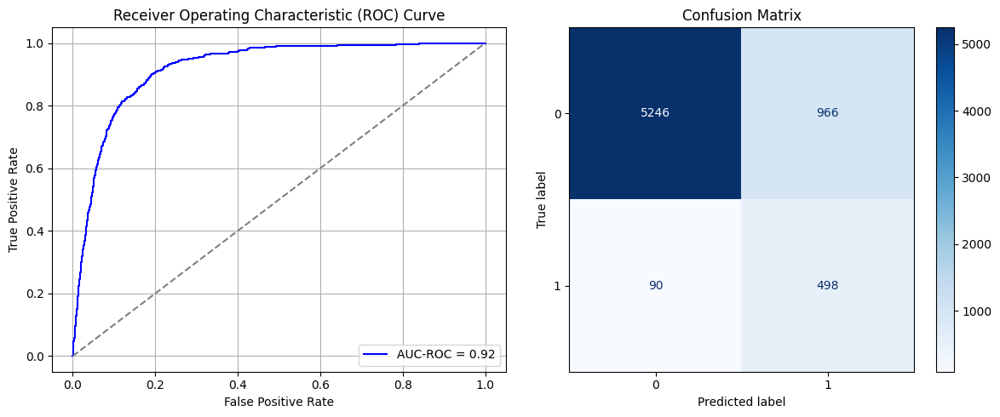

Best threshold based on F1-score: 0.6828702092170715
False Negative Rate: 0.15306122448979592
Time elapsed (performance): 1.0902742019989091
(np.float64(0.15550547327752737), np.float64(0.8444945267224726))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6592 - loss: 0.6571 - val_AUC: 0.7632 - val_loss: 0.5844
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.7824 - loss: 0.5671 - val_AUC: 0.8477 - val_loss: 0.5013
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8536 - loss: 0.4892 - val_AUC: 0.8755 - val_loss: 0.4725
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8744 - loss: 0.4557 - val_AUC: 0.8779 - val_loss: 0.4481
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8851 - loss: 0.4338 - val_AUC: 0.8792 - val_loss: 0.4445
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.8842 - loss: 0.4351 - val_AUC: 0.8810 - val_loss: 0.4521
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8730 - loss: 0.4544 - val_AUC: 0.8838 - val_loss: 0.4319
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8870 - loss: 0.4268 - val_AUC: 0.8823 - val_loss: 0.4368
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8904 -

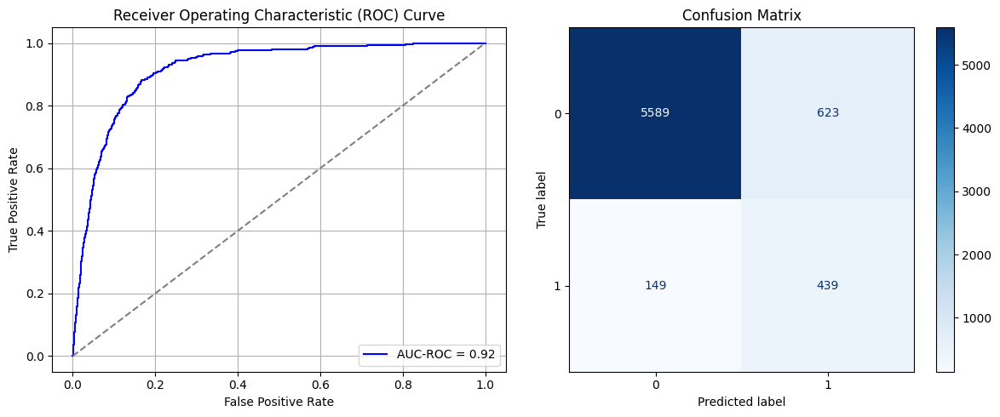

Best threshold based on F1-score: 0.9957478642463684
False Negative Rate: 0.2534013605442177
Time elapsed (performance): 0.9989805990007881
(np.float64(0.10028976175144881), np.float64(0.8997102382485512))
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - AUC: 0.6522 - loss: 0.6587 - val_AUC: 0.7896 - val_loss: 0.5759
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8090 - loss: 0.5501 - val_AUC: 0.8603 - val_loss: 0.4928
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8584 - loss: 0.4884 - val_AUC: 0.8704 - val_loss: 0.4645
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8739 - loss: 0.4591 - val_AUC: 0.8728 - val_loss: 0.4586
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.8809 - loss: 0.4421 - val_AUC: 0.8745 - val_loss: 0.4528
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.8756 - loss: 0.4491 - val_AUC: 0.8745 - val_loss: 0.4485
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8820 - loss: 0.4404 - val_AUC: 0.8751 - val_loss: 0.4547
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8820 - loss: 0.4383 - val_AUC: 0.8755 - val_loss: 0.4481
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8868 -

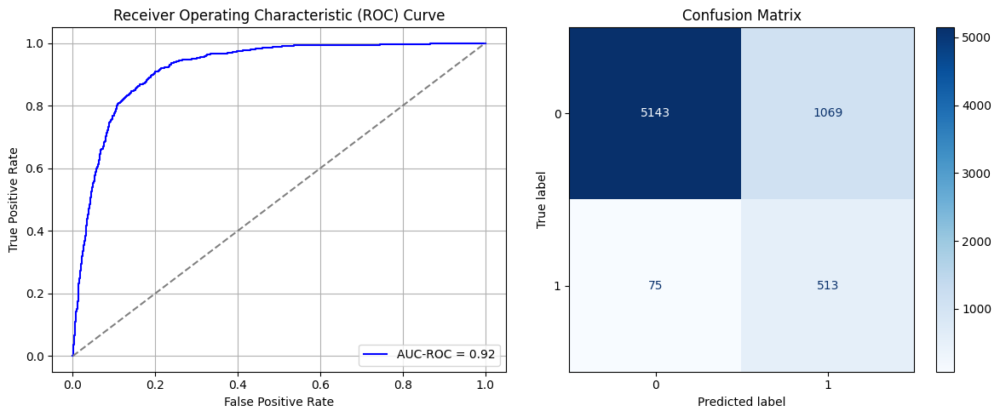

Best threshold based on F1-score: 0.7425506711006165
False Negative Rate: 0.12755102040816327
Time elapsed (performance): 1.0026410030004627
(np.float64(0.17208628461043143), np.float64(0.8279137153895686))
    Source time       FPR       TNR       FNR       TPR  Target time
0     10.037711  0.142144  0.857856  0.151361  0.848639     0.778755
1      9.517267  0.130071  0.869929  0.171769  0.828231     0.762034
2      9.689454  0.142949  0.857051  0.151361  0.848639     0.766469
3     10.671759  0.109144  0.890856  0.219388  0.780612     0.768866
4      9.555329  0.124276  0.875724  0.193878  0.806122     1.234901
5      8.948477  0.112685  0.887315  0.200680  0.799320     1.041226
6     10.480449  0.165969  0.834031  0.142857  0.857143     1.043373
7      9.346722  0.122022  0.877978  0.183673  0.816327     0.779550
8     10.074071  0.149871  0.850129  0.163265  0.836735     0.774888
9      9.482544  0.114939  0.885061  0.214286  0.785714     0.799393
10    10.533739  0.132003  0.86799

In [95]:
import random

times = 50

Training_time = []
FPR = []
TPR = []
FNR = []
TNR = []
TL_time = []

k = oversample_size/undersample_size
print(k)

# np.random.seed(123)

for i in range(times):
    start = random.randint(1, int(k))
    # print(start)

    Row = []

    for j in range(undersample_size):
      row = start+int(k*j)-1
      Row.append(row)

    # print(Row)

    data_S_maj_rus = pd.DataFrame()
    data_S_maj_rus = data_S_majority.iloc[Row]

    data_S_Sy_RUS = pd.concat([data_S_maj_rus, data_S_minority])
    X_S_Sy = data_S_Sy_RUS.iloc[:, :-1]
    y_S_Sy = data_S_Sy_RUS.iloc[:, -1]
    X_S_train, X_S_test, y_S_train, y_S_test = train_test_split(X_S_Sy, y_S_Sy, test_size=0.20, random_state=0)
    model_Sy = create_dnn_model(X_S_train.shape[1])
    result_Sy = train_and_evaluate(model_Sy, X_S_train, X_S_test, y_S_train, y_S_test, "Source")
    result_TL_Sy = Transductive_TL(model_Sy, X_T_full, y_T_full, "Target")
    print(result_TL_Sy[0:2])

    Training_time.append(result_Sy)
    FPR.append(result_TL_Sy[0])
    TNR.append(result_TL_Sy[1])
    FNR.append(result_TL_Sy[2])
    TPR.append(result_TL_Sy[3])
    TL_time.append(result_TL_Sy[4])

# return fpr, tnr, fnr, tpr, time_elapsed

# print(TNR)

ParamFit = pd.DataFrame([Training_time, FPR, TNR, FNR, TPR, TL_time]).T
ParamFit.columns=['Source time', 'FPR', 'TNR', 'FNR', 'TPR', 'Target time']
print(ParamFit)


In [96]:
print(ParamFit)
ParamFit.to_csv('Sy_RUS.csv')

    Source time       FPR       TNR       FNR       TPR  Target time
0     10.037711  0.142144  0.857856  0.151361  0.848639     0.778755
1      9.517267  0.130071  0.869929  0.171769  0.828231     0.762034
2      9.689454  0.142949  0.857051  0.151361  0.848639     0.766469
3     10.671759  0.109144  0.890856  0.219388  0.780612     0.768866
4      9.555329  0.124276  0.875724  0.193878  0.806122     1.234901
5      8.948477  0.112685  0.887315  0.200680  0.799320     1.041226
6     10.480449  0.165969  0.834031  0.142857  0.857143     1.043373
7      9.346722  0.122022  0.877978  0.183673  0.816327     0.779550
8     10.074071  0.149871  0.850129  0.163265  0.836735     0.774888
9      9.482544  0.114939  0.885061  0.214286  0.785714     0.799393
10    10.533739  0.132003  0.867997  0.192177  0.807823     1.405017
11    11.828501  0.183033  0.816967  0.110544  0.889456     1.071462
12     8.526676  0.178847  0.821153  0.129252  0.870748     1.253361
13    11.461222  0.105280  0.89472

## Systematic Sampling (multiple samples):

Now, we investigate the possibility of conducting $m$ systematic samples, each with a sampling interval of $k=m*\frac{N_0}{N_1}$, and obtaining the undersampled majority class data using all $m$ systematic samples combined. This may more closely approximate SRS sampling.

For convenience, we take $m=10$ in this case.

72.09564628919468
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.6655 - loss: 0.6558 - val_AUC: 0.7662 - val_loss: 0.5873
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8025 - loss: 0.5490 - val_AUC: 0.8327 - val_loss: 0.5140
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8583 - loss: 0.4769 - val_AUC: 0.8701 - val_loss: 0.4641
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8781 - loss: 0.4459 - val_AUC: 0.8733 - val_loss: 0.4590
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8786 - loss: 0.4392 - val_AUC: 0.8778 - val_loss: 0.4501
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8896 - loss: 0.4214 - val_AUC: 0.8816 - val_loss: 0.4427
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8855 - loss: 0.4286 - val_AUC: 0.8820 - val_loss: 0.4414
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8884 - loss: 0.4228 - val_AUC: 0.8802 - val_loss: 0.4456
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8961 -

<ipython-input-76-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
AUC-ROC: 0.908206247727681
Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.87      0.92      6212
           1       0.36      0.79      0.49       588

    accuracy                           0.86      6800
   macro avg       0.67      0.83      0.71      6800
weighted avg       0.92      0.86      0.88      6800

FPR 0.1320025756600129 TPR: 0.7874149659863946 FNR: 0.21258503401360543 TNR: 0.8679974243399871


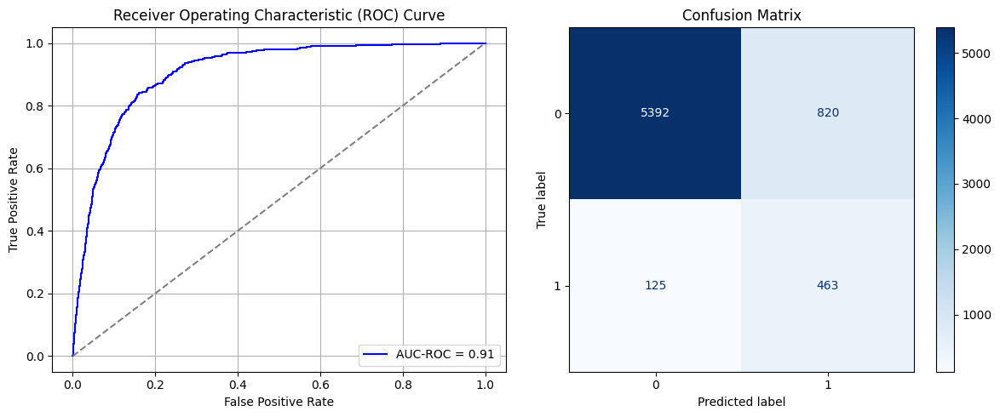

Best threshold based on F1-score: 0.9993557929992676
False Negative Rate: 0.21258503401360543
Time elapsed (performance): 0.7648602479985129
(np.float64(0.1320025756600129), np.float64(0.8679974243399871))
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.6610 - loss: 0.6565 - val_AUC: 0.7815 - val_loss: 0.5684
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7907 - loss: 0.5574 - val_AUC: 0.8463 - val_loss: 0.5034
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8554 - loss: 0.4831 - val_AUC: 0.8761 - val_loss: 0.4652
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8738 - loss: 0.4511 - val_AUC: 0.8785 - val_loss: 0.4457
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8863 - loss: 0.4317 - val_AUC: 0.8799 - val_loss: 0.4455
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8899 - loss: 0.4228 - val_AUC: 0.8875 - val_loss: 0.4360
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8902 - loss: 0.4206 - val_AUC: 0.8843 - val_loss: 0.4355
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8858 - loss: 0.4277 - val_AUC: 0.8870 - val_loss: 0.4312
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8933 -

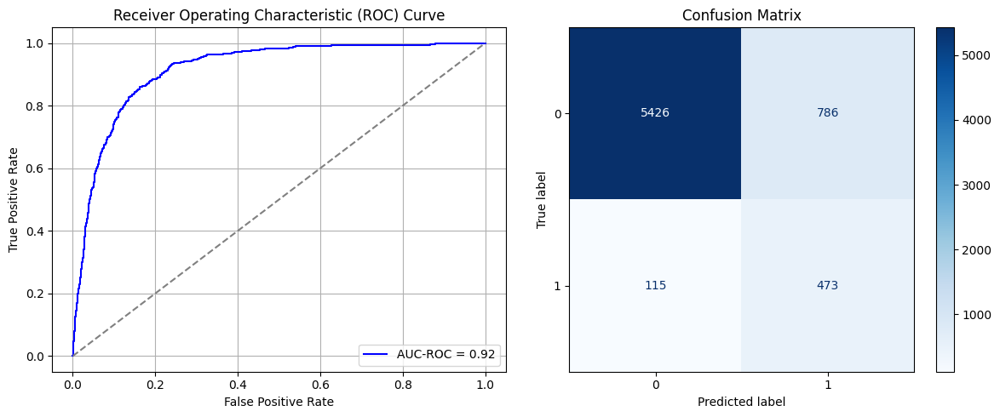

Best threshold based on F1-score: 0.9995944499969482
False Negative Rate: 0.195578231292517
Time elapsed (performance): 1.0232166030000371
(np.float64(0.1265292981326465), np.float64(0.8734707018673535))
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.6088 - loss: 0.6696 - val_AUC: 0.7647 - val_loss: 0.5833
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7909 - loss: 0.5598 - val_AUC: 0.8465 - val_loss: 0.5002
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8496 - loss: 0.4935 - val_AUC: 0.8736 - val_loss: 0.4602
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8743 - loss: 0.4509 - val_AUC: 0.8806 - val_loss: 0.4443
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8768 - loss: 0.4440 - val_AUC: 0.8789 - val_loss: 0.4583
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8807 - loss: 0.4371 - val_AUC: 0.8852 - val_loss: 0.4309
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8897 - loss: 0.4208 - val_AUC: 0.8838 - val_loss: 0.4331
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8894 - loss: 0.4202 - val_AUC: 0.8839 - val_loss: 0.4337
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8887 -

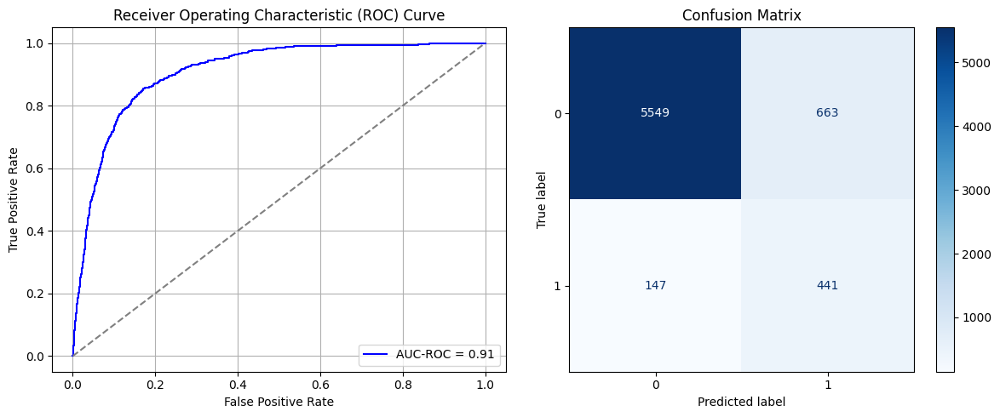

Best threshold based on F1-score: 0.9959732294082642
False Negative Rate: 0.25
Time elapsed (performance): 1.0705773910012795
(np.float64(0.10672891178364456), np.float64(0.8932710882163555))
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - AUC: 0.6717 - loss: 0.6515 - val_AUC: 0.7677 - val_loss: 0.5839
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.7939 - loss: 0.5589 - val_AUC: 0.8489 - val_loss: 0.4969
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8634 - loss: 0.4774 - val_AUC: 0.8731 - val_loss: 0.4562
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8865 - loss: 0.4331 - val_AUC: 0.8767 - val_loss: 0.4440
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8876 - loss: 0.4254 - val_AUC: 0.8802 - val_loss: 0.4557
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8859 - loss: 0.4287 - val_AUC: 0.8807 - val_loss: 0.4510
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8961 - loss: 0.4092 - val_AUC: 0.8814 - val_loss: 0.4343
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8866 - loss: 0.4252 - val_AUC: 0.8833 - val_loss: 0.4323
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8929 -

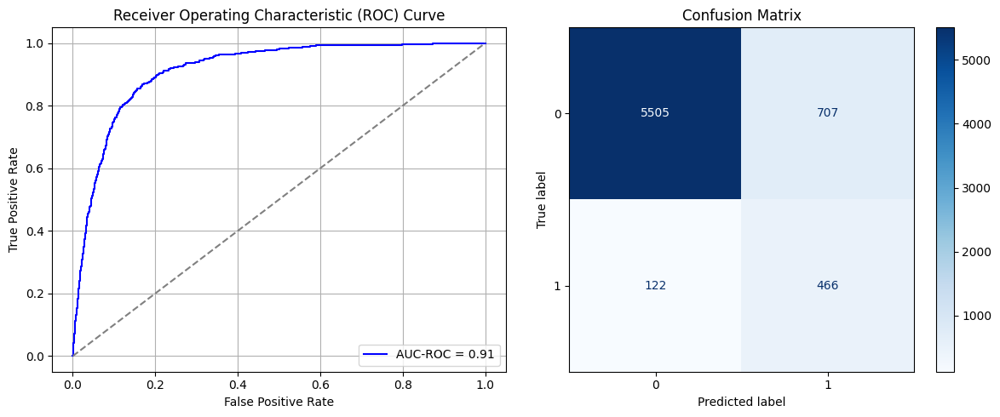

Best threshold based on F1-score: 0.5808153748512268
False Negative Rate: 0.20748299319727892
Time elapsed (performance): 0.7617338340005517
(np.float64(0.11381197681905988), np.float64(0.8861880231809401))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - AUC: 0.6989 - loss: 0.6464 - val_AUC: 0.7735 - val_loss: 0.5739
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8041 - loss: 0.5441 - val_AUC: 0.8378 - val_loss: 0.5102
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8651 - loss: 0.4781 - val_AUC: 0.8646 - val_loss: 0.4709
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8764 - loss: 0.4519 - val_AUC: 0.8705 - val_loss: 0.4594
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8830 - loss: 0.4357 - val_AUC: 0.8756 - val_loss: 0.4544
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8881 - loss: 0.4299 - val_AUC: 0.8775 - val_loss: 0.4522
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8911 - loss: 0.4250 - val_AUC: 0.8770 - val_loss: 0.4528
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8869 - loss: 0.4271 - val_AUC: 0.8797 - val_loss: 0.4450
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8888 -

<ipython-input-76-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
AUC-ROC: 0.917103882763666
Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.87      0.92      6212
           1       0.37      0.83      0.51       588

    accuracy                           0.86      6800
   macro avg       0.68      0.85      0.72      6800
weighted avg       0.93      0.86      0.88      6800

FPR 0.13377334191886672 TPR: 0.8282312925170068 FNR: 0.1717687074829932 TNR: 0.8662266580811333


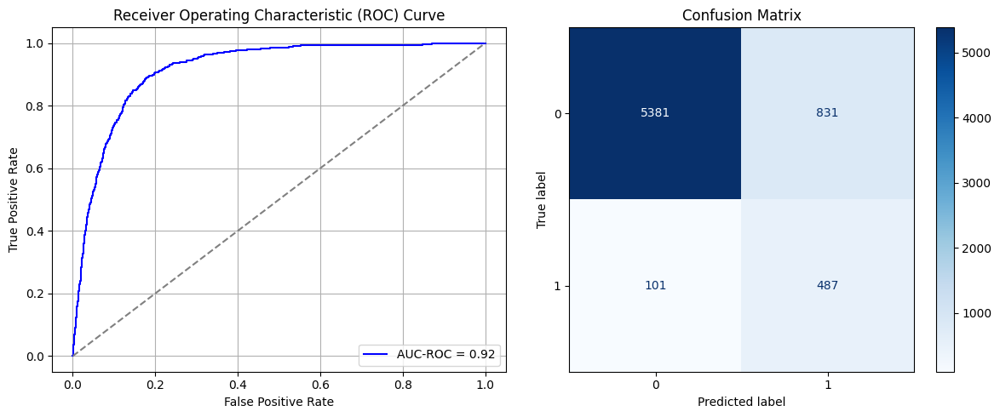

Best threshold based on F1-score: 0.9988238215446472
False Negative Rate: 0.1717687074829932
Time elapsed (performance): 0.7756583739992493
(np.float64(0.13377334191886672), np.float64(0.8662266580811333))
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6234 - loss: 0.6660 - val_AUC: 0.7636 - val_loss: 0.5816
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7756 - loss: 0.5754 - val_AUC: 0.8398 - val_loss: 0.5066
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8519 - loss: 0.4908 - val_AUC: 0.8735 - val_loss: 0.4525
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8898 - loss: 0.4312 - val_AUC: 0.8751 - val_loss: 0.4482
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8882 - loss: 0.4289 - val_AUC: 0.8814 - val_loss: 0.4394
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8927 - loss: 0.4207 - val_AUC: 0.8831 - val_loss: 0.4357
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8938 - loss: 0.4163 - val_AUC: 0.8823 - val_loss: 0.4362
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8968 - loss: 0.4101 - val_AUC: 0.8804 - val_loss: 0.4372
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8947 -

<ipython-input-76-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
AUC-ROC: 0.9091121638610371
Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.88      0.92      6212
           1       0.37      0.79      0.51       588

    accuracy                           0.87      6800
   macro avg       0.68      0.83      0.71      6800
weighted avg       0.93      0.87      0.89      6800

FPR 0.12475853187379266 TPR: 0.7857142857142857 FNR: 0.21428571428571427 TNR: 0.8752414681262073


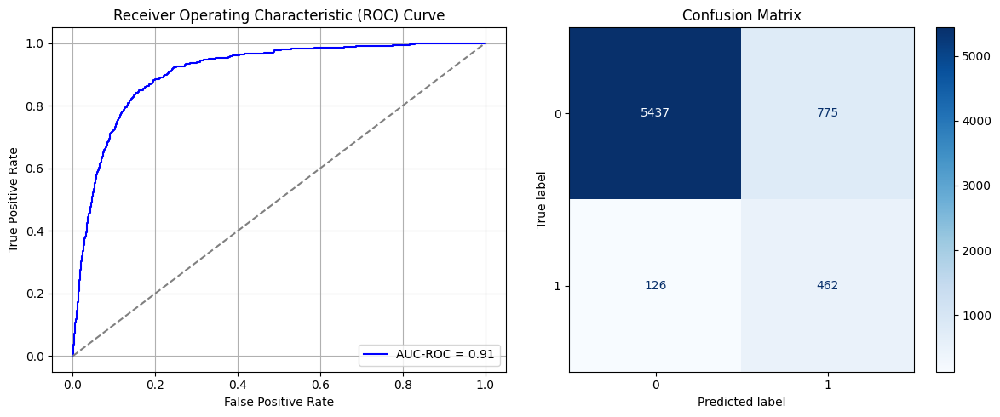

Best threshold based on F1-score: 0.6512665152549744
False Negative Rate: 0.21428571428571427
Time elapsed (performance): 1.0477275280009053
(np.float64(0.12475853187379266), np.float64(0.8752414681262073))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6799 - loss: 0.6521 - val_AUC: 0.7531 - val_loss: 0.5941
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7896 - loss: 0.5622 - val_AUC: 0.8231 - val_loss: 0.5303
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8502 - loss: 0.4932 - val_AUC: 0.8561 - val_loss: 0.4806
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8710 - loss: 0.4610 - val_AUC: 0.8697 - val_loss: 0.4589
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8854 - loss: 0.4313 - val_AUC: 0.8644 - val_loss: 0.4651
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8811 - loss: 0.4369 - val_AUC: 0.8661 - val_loss: 0.4651
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8903 - loss: 0.4217 - val_AUC: 0.8722 - val_loss: 0.4492
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8846 - loss: 0.4286 - val_AUC: 0.8681 - val_loss: 0.4693
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8953 -

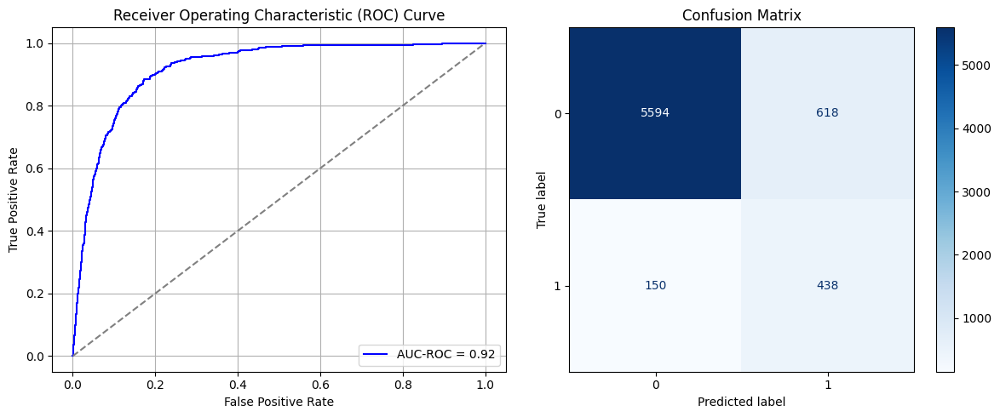

Best threshold based on F1-score: 0.9984516501426697
False Negative Rate: 0.25510204081632654
Time elapsed (performance): 0.7668906870003411
(np.float64(0.09948486799742434), np.float64(0.9005151320025757))
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6481 - loss: 0.6589 - val_AUC: 0.7586 - val_loss: 0.5880
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7938 - loss: 0.5540 - val_AUC: 0.8430 - val_loss: 0.5066
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8531 - loss: 0.4874 - val_AUC: 0.8689 - val_loss: 0.4612
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8738 - loss: 0.4508 - val_AUC: 0.8760 - val_loss: 0.4482
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8844 - loss: 0.4288 - val_AUC: 0.8771 - val_loss: 0.4479
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8762 - loss: 0.4411 - val_AUC: 0.8765 - val_loss: 0.4642
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8803 - loss: 0.4351 - val_AUC: 0.8796 - val_loss: 0.4380
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8831 - loss: 0.4307 - val_AUC: 0.8827 - val_loss: 0.4323
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8832 -

<ipython-input-76-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
AUC-ROC: 0.9162866692072837
Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.89      0.93      6212
           1       0.41      0.76      0.53       588

    accuracy                           0.88      6800
   macro avg       0.69      0.83      0.73      6800
weighted avg       0.93      0.88      0.90      6800

FPR 0.1056020605280103 TPR: 0.7636054421768708 FNR: 0.23639455782312926 TNR: 0.8943979394719896


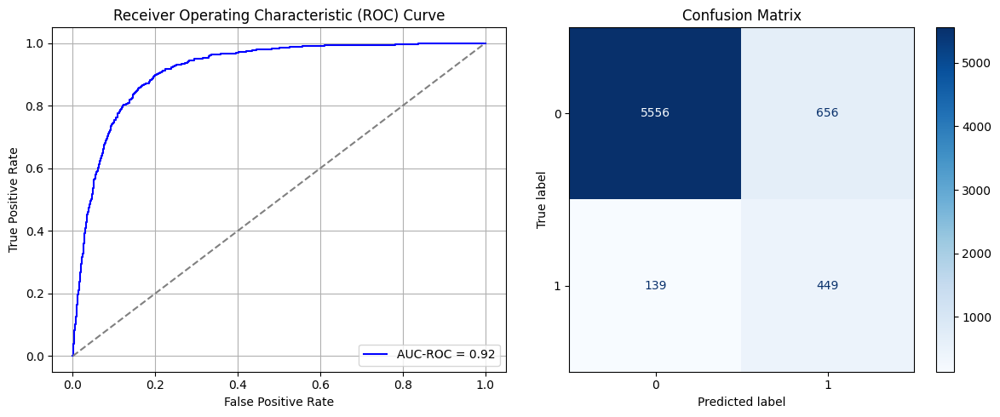

Best threshold based on F1-score: 0.9935517907142639
False Negative Rate: 0.23639455782312926
Time elapsed (performance): 1.0380756459999247
(np.float64(0.1056020605280103), np.float64(0.8943979394719896))
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6378 - loss: 0.6623 - val_AUC: 0.7532 - val_loss: 0.5963
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7881 - loss: 0.5614 - val_AUC: 0.8497 - val_loss: 0.5014
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8632 - loss: 0.4808 - val_AUC: 0.8730 - val_loss: 0.4830
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8677 - loss: 0.4627 - val_AUC: 0.8775 - val_loss: 0.4461
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8756 - loss: 0.4495 - val_AUC: 0.8777 - val_loss: 0.4456
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8721 - loss: 0.4500 - val_AUC: 0.8807 - val_loss: 0.4389
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8861 - loss: 0.4305 - val_AUC: 0.8826 - val_loss: 0.4359
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8816 - loss: 0.4357 - val_AUC: 0.8817 - val_loss: 0.4389
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8853 -

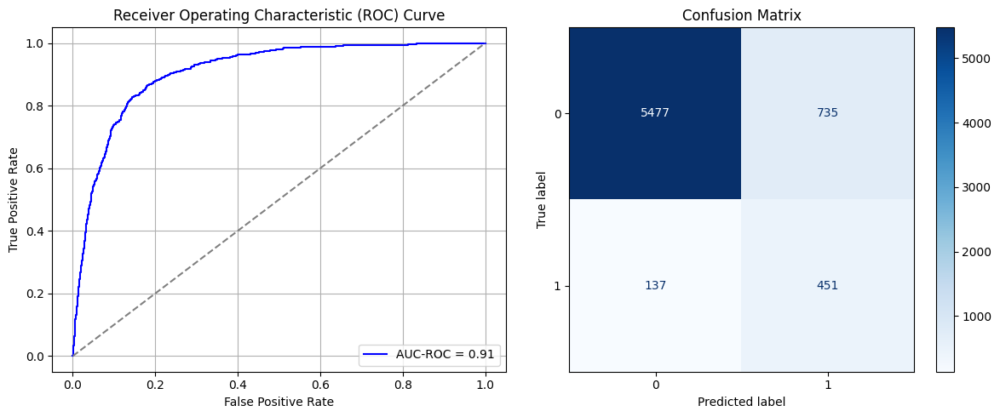

Best threshold based on F1-score: 0.5678582787513733
False Negative Rate: 0.23299319727891157
Time elapsed (performance): 0.7721864949999144
(np.float64(0.1183193818415969), np.float64(0.8816806181584032))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6726 - loss: 0.6552 - val_AUC: 0.7702 - val_loss: 0.5823
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7982 - loss: 0.5508 - val_AUC: 0.8567 - val_loss: 0.4854
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8643 - loss: 0.4716 - val_AUC: 0.8804 - val_loss: 0.4438
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8818 - loss: 0.4372 - val_AUC: 0.8821 - val_loss: 0.4403
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8853 - loss: 0.4278 - val_AUC: 0.8841 - val_loss: 0.4311
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8835 - loss: 0.4291 - val_AUC: 0.8844 - val_loss: 0.4293
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8831 - loss: 0.4306 - val_AUC: 0.8859 - val_loss: 0.4272
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8856 - loss: 0.4255 - val_AUC: 0.8870 - val_loss: 0.4398
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8861 -

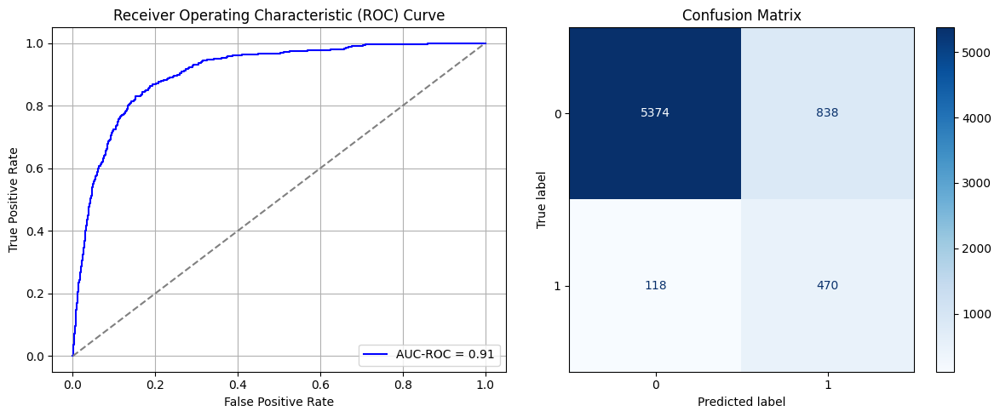

Best threshold based on F1-score: 0.998219907283783
False Negative Rate: 0.20068027210884354
Time elapsed (performance): 1.1385208169995167
(np.float64(0.13490019317450097), np.float64(0.865099806825499))
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.6619 - loss: 0.6534 - val_AUC: 0.7622 - val_loss: 0.5928
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8054 - loss: 0.5456 - val_AUC: 0.8400 - val_loss: 0.5119
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8529 - loss: 0.4885 - val_AUC: 0.8658 - val_loss: 0.4675
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8776 - loss: 0.4493 - val_AUC: 0.8728 - val_loss: 0.4566
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8770 - loss: 0.4456 - val_AUC: 0.8727 - val_loss: 0.4663
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8824 - loss: 0.4388 - val_AUC: 0.8740 - val_loss: 0.4713
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8915 - loss: 0.4178 - val_AUC: 0.8761 - val_loss: 0.4491
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8931 - loss: 0.4157 - val_AUC: 0.8754 - val_loss: 0.4660
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8866 -

<ipython-input-76-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
AUC-ROC: 0.9185505013338238
Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.89      0.93      6212
           1       0.41      0.79      0.54       588

    accuracy                           0.88      6800
   macro avg       0.69      0.84      0.74      6800
weighted avg       0.93      0.88      0.90      6800

FPR 0.10785576303927881 TPR: 0.7908163265306123 FNR: 0.20918367346938777 TNR: 0.8921442369607212


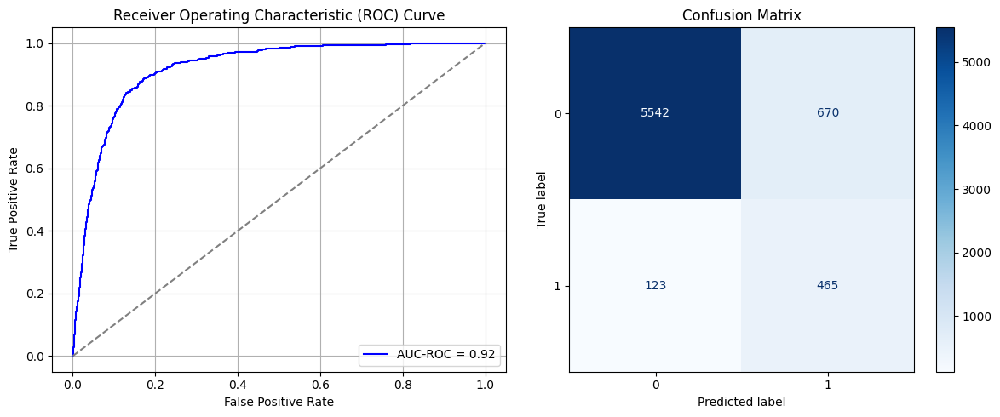

Best threshold based on F1-score: 0.6253971457481384
False Negative Rate: 0.20918367346938777
Time elapsed (performance): 0.7821537519994308
(np.float64(0.10785576303927881), np.float64(0.8921442369607212))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - AUC: 0.6293 - loss: 0.6641 - val_AUC: 0.7358 - val_loss: 0.6054
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7757 - loss: 0.5711 - val_AUC: 0.8225 - val_loss: 0.5387
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8471 - loss: 0.5017 - val_AUC: 0.8516 - val_loss: 0.4817
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8762 - loss: 0.4478 - val_AUC: 0.8650 - val_loss: 0.4667
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8888 - loss: 0.4240 - val_AUC: 0.8625 - val_loss: 0.4683
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8856 - loss: 0.4287 - val_AUC: 0.8666 - val_loss: 0.4608
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8872 - loss: 0.4258 - val_AUC: 0.8704 - val_loss: 0.4767
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8900 - loss: 0.4220 - val_AUC: 0.8713 - val_loss: 0.4630
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8904 -

<ipython-input-76-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
AUC-ROC: 0.9194895440468523
Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.85      0.91      6212
           1       0.36      0.86      0.50       588

    accuracy                           0.85      6800
   macro avg       0.67      0.86      0.71      6800
weighted avg       0.93      0.85      0.88      6800

FPR 0.14600772698003864 TPR: 0.8571428571428572 FNR: 0.14285714285714285 TNR: 0.8539922730199614


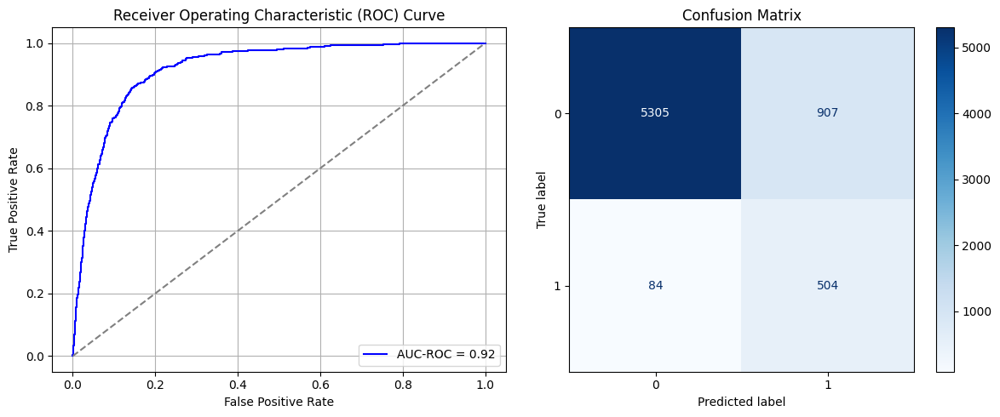

Best threshold based on F1-score: 0.7005168795585632
False Negative Rate: 0.14285714285714285
Time elapsed (performance): 1.0336718260005
(np.float64(0.14600772698003864), np.float64(0.8539922730199614))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6744 - loss: 0.6567 - val_AUC: 0.7862 - val_loss: 0.5687
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8107 - loss: 0.5425 - val_AUC: 0.8567 - val_loss: 0.4876
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8609 - loss: 0.4761 - val_AUC: 0.8726 - val_loss: 0.4638
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8711 - loss: 0.4552 - val_AUC: 0.8816 - val_loss: 0.4409
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8775 - loss: 0.4458 - val_AUC: 0.8809 - val_loss: 0.4439
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8770 - loss: 0.4419 - val_AUC: 0.8845 - val_loss: 0.4428
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8764 - loss: 0.4435 - val_AUC: 0.8854 - val_loss: 0.4346
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8853 - loss: 0.4277 - val_AUC: 0.8855 - val_loss: 0.4293
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8801 -

<ipython-input-76-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
AUC-ROC: 0.9154700031976731
Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.87      0.92      6212
           1       0.37      0.80      0.51       588

    accuracy                           0.87      6800
   macro avg       0.68      0.84      0.72      6800
weighted avg       0.93      0.87      0.89      6800

FPR 0.12830006439150032 TPR: 0.8027210884353742 FNR: 0.19727891156462585 TNR: 0.8716999356084997


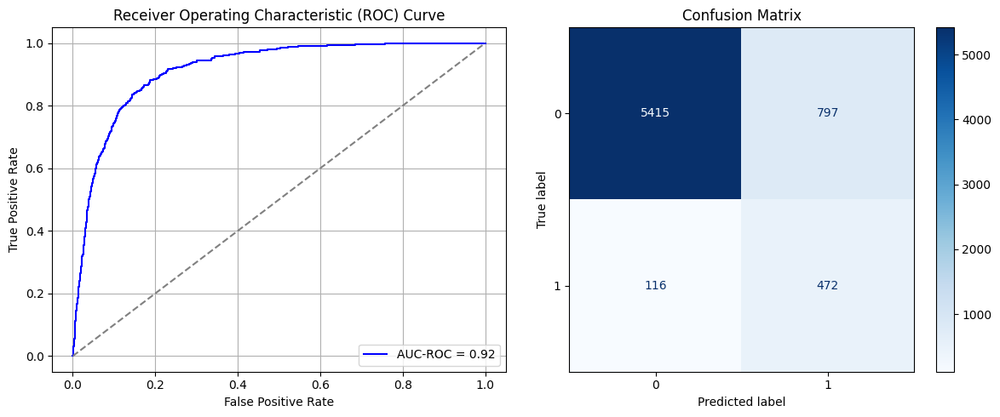

Best threshold based on F1-score: 0.729678750038147
False Negative Rate: 0.19727891156462585
Time elapsed (performance): 1.0407179770008952
(np.float64(0.12830006439150032), np.float64(0.8716999356084997))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6388 - loss: 0.6638 - val_AUC: 0.7419 - val_loss: 0.6036
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7793 - loss: 0.5698 - val_AUC: 0.8102 - val_loss: 0.5384
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8441 - loss: 0.4972 - val_AUC: 0.8572 - val_loss: 0.4797
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8722 - loss: 0.4540 - val_AUC: 0.8623 - val_loss: 0.4730
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8770 - loss: 0.4474 - val_AUC: 0.8683 - val_loss: 0.4583
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8830 - loss: 0.4377 - val_AUC: 0.8721 - val_loss: 0.4576
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8874 - loss: 0.4270 - val_AUC: 0.8698 - val_loss: 0.4524
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8920 - loss: 0.4167 - val_AUC: 0.8741 - val_loss: 0.4448
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - AUC: 0.8926 -

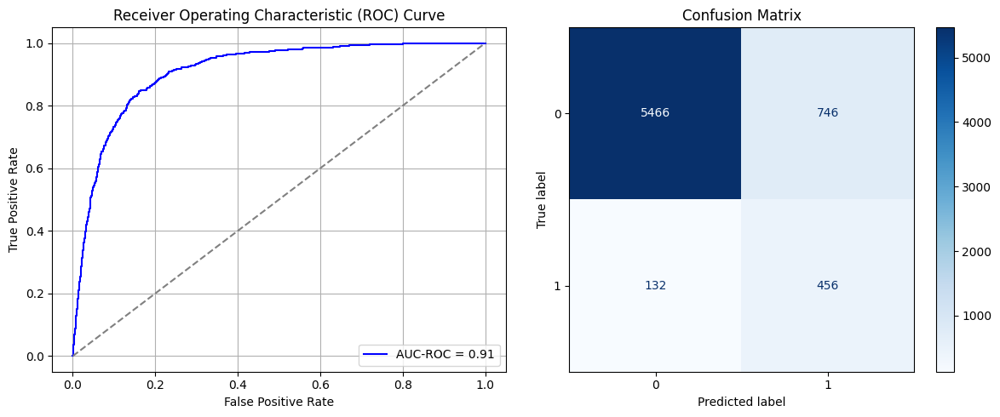

Best threshold based on F1-score: 0.9908751249313354
False Negative Rate: 0.22448979591836735
Time elapsed (performance): 0.8202594519989361
(np.float64(0.12009014810045074), np.float64(0.8799098518995493))
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6366 - loss: 0.6654 - val_AUC: 0.7411 - val_loss: 0.6162
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7687 - loss: 0.5792 - val_AUC: 0.8237 - val_loss: 0.5263
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8406 - loss: 0.5074 - val_AUC: 0.8595 - val_loss: 0.4814
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8693 - loss: 0.4613 - val_AUC: 0.8716 - val_loss: 0.4528
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8804 - loss: 0.4405 - val_AUC: 0.8773 - val_loss: 0.4431
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8841 - loss: 0.4326 - val_AUC: 0.8778 - val_loss: 0.4541
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8896 - loss: 0.4234 - val_AUC: 0.8811 - val_loss: 0.4372
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8887 - loss: 0.4227 - val_AUC: 0.8785 - val_loss: 0.4390
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8882 -

<ipython-input-76-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
AUC-ROC: 0.9180753676229023
Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.89      0.93      6212
           1       0.40      0.78      0.53       588

    accuracy                           0.88      6800
   macro avg       0.69      0.83      0.73      6800
weighted avg       0.93      0.88      0.90      6800

FPR 0.10914359304571797 TPR: 0.7789115646258503 FNR: 0.22108843537414966 TNR: 0.890856406954282


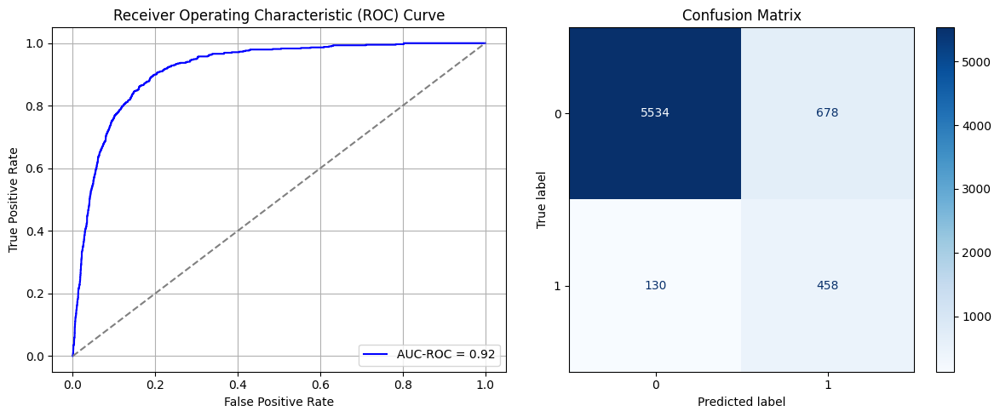

Best threshold based on F1-score: 0.9980387091636658
False Negative Rate: 0.22108843537414966
Time elapsed (performance): 1.0423575340009847
(np.float64(0.10914359304571797), np.float64(0.890856406954282))
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6778 - loss: 0.6545 - val_AUC: 0.7583 - val_loss: 0.5911
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7879 - loss: 0.5663 - val_AUC: 0.8265 - val_loss: 0.5254
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8604 - loss: 0.4815 - val_AUC: 0.8581 - val_loss: 0.4802
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8725 - loss: 0.4548 - val_AUC: 0.8670 - val_loss: 0.4673
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8818 - loss: 0.4369 - val_AUC: 0.8687 - val_loss: 0.4590
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8843 - loss: 0.4318 - val_AUC: 0.8665 - val_loss: 0.4638
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8842 - loss: 0.4305 - val_AUC: 0.8705 - val_loss: 0.4542
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8898 - loss: 0.4205 - val_AUC: 0.8726 - val_loss: 0.4514
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8930 -

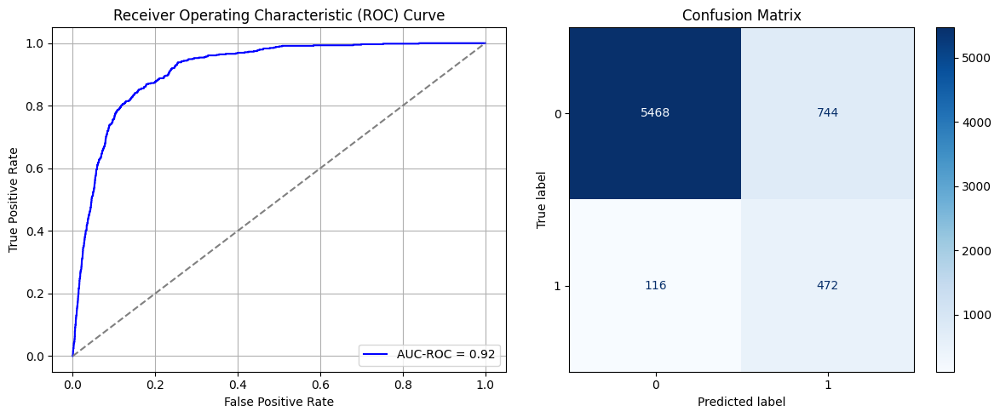

Best threshold based on F1-score: 0.9989238381385803
False Negative Rate: 0.19727891156462585
Time elapsed (performance): 0.81237936099933
(np.float64(0.11976819059884096), np.float64(0.8802318094011591))
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6416 - loss: 0.6603 - val_AUC: 0.7595 - val_loss: 0.5873
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7964 - loss: 0.5547 - val_AUC: 0.8405 - val_loss: 0.5095
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8620 - loss: 0.4784 - val_AUC: 0.8720 - val_loss: 0.4579
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8848 - loss: 0.4394 - val_AUC: 0.8797 - val_loss: 0.4425
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8898 - loss: 0.4278 - val_AUC: 0.8787 - val_loss: 0.4455
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8959 - loss: 0.4149 - val_AUC: 0.8841 - val_loss: 0.4431
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8918 - loss: 0.4229 - val_AUC: 0.8853 - val_loss: 0.4320
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8983 - loss: 0.4090 - val_AUC: 0.8846 - val_loss: 0.4330
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8990 -

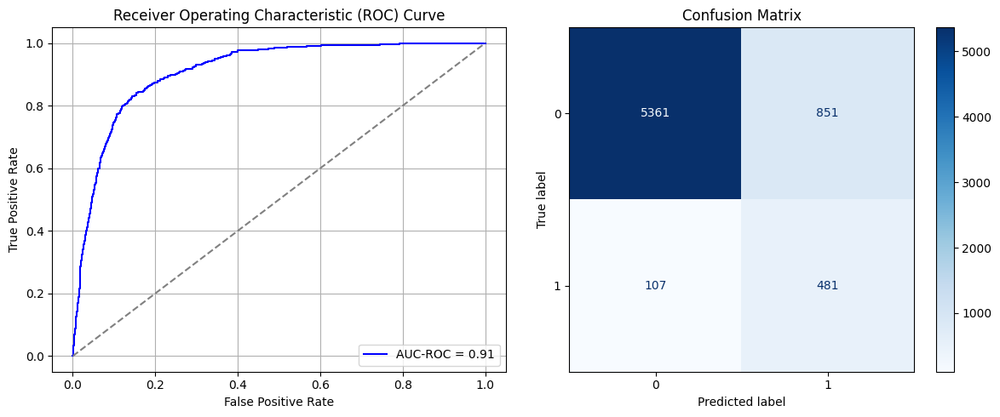

Best threshold based on F1-score: 0.9995401501655579
False Negative Rate: 0.18197278911564627
Time elapsed (performance): 1.0550791130008292
(np.float64(0.1369929169349646), np.float64(0.8630070830650354))
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6701 - loss: 0.6536 - val_AUC: 0.7698 - val_loss: 0.5805
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.7979 - loss: 0.5535 - val_AUC: 0.8471 - val_loss: 0.5017
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8648 - loss: 0.4760 - val_AUC: 0.8770 - val_loss: 0.4518
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8778 - loss: 0.4455 - val_AUC: 0.8825 - val_loss: 0.4419
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8766 - loss: 0.4446 - val_AUC: 0.8833 - val_loss: 0.4325
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8846 - loss: 0.4295 - val_AUC: 0.8854 - val_loss: 0.4276
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8865 - loss: 0.4255 - val_AUC: 0.8876 - val_loss: 0.4255
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8872 - loss: 0.4236 - val_AUC: 0.8871 - val_loss: 0.4237
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8839 -

<ipython-input-76-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
AUC-ROC: 0.9156446706177643
Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.85      0.91      6212
           1       0.35      0.83      0.49       588

    accuracy                           0.85      6800
   macro avg       0.66      0.84      0.70      6800
weighted avg       0.93      0.85      0.88      6800

FPR 0.14713457823567289 TPR: 0.8299319727891157 FNR: 0.17006802721088435 TNR: 0.8528654217643271


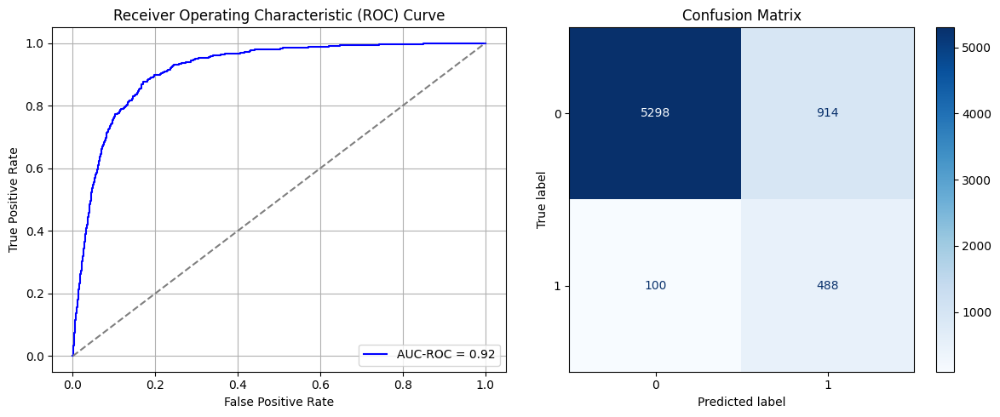

Best threshold based on F1-score: 0.9901525378227234
False Negative Rate: 0.17006802721088435
Time elapsed (performance): 1.071844960000817
(np.float64(0.14713457823567289), np.float64(0.8528654217643271))
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6831 - loss: 0.6484 - val_AUC: 0.7628 - val_loss: 0.5894
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8038 - loss: 0.5479 - val_AUC: 0.8438 - val_loss: 0.5136
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8539 - loss: 0.4897 - val_AUC: 0.8567 - val_loss: 0.4918
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8670 - loss: 0.4616 - val_AUC: 0.8677 - val_loss: 0.4595
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8805 - loss: 0.4393 - val_AUC: 0.8711 - val_loss: 0.4540
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8845 - loss: 0.4307 - val_AUC: 0.8727 - val_loss: 0.4508
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8868 - loss: 0.4255 - val_AUC: 0.8749 - val_loss: 0.4484
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8795 - loss: 0.4390 - val_AUC: 0.8743 - val_loss: 0.4502
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8868 -

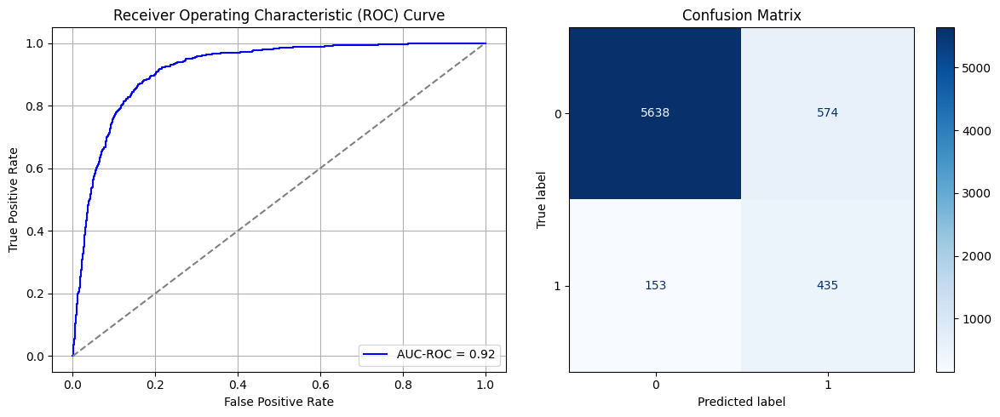

Best threshold based on F1-score: 0.9929600358009338
False Negative Rate: 0.2602040816326531
Time elapsed (performance): 0.827864763999969
(np.float64(0.09240180296200902), np.float64(0.9075981970379909))
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - AUC: 0.6350 - loss: 0.6616 - val_AUC: 0.7556 - val_loss: 0.5913
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.7999 - loss: 0.5525 - val_AUC: 0.8429 - val_loss: 0.5043
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8682 - loss: 0.4686 - val_AUC: 0.8676 - val_loss: 0.4629
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8684 - loss: 0.4575 - val_AUC: 0.8744 - val_loss: 0.4554
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8849 - loss: 0.4301 - val_AUC: 0.8768 - val_loss: 0.4444
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8845 - loss: 0.4297 - val_AUC: 0.8777 - val_loss: 0.4420
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8877 - loss: 0.4231 - val_AUC: 0.8810 - val_loss: 0.4376
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8858 - loss: 0.4277 - val_AUC: 0.8799 - val_loss: 0.4647
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8865 -

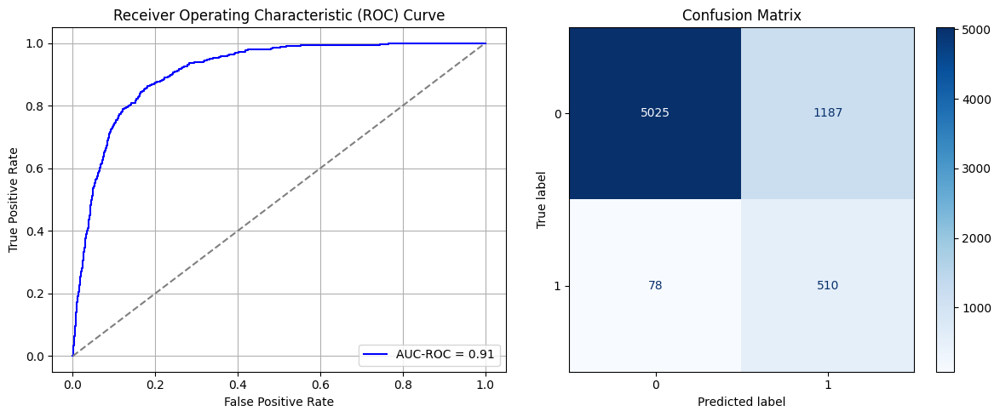

Best threshold based on F1-score: 0.9983518719673157
False Negative Rate: 0.1326530612244898
Time elapsed (performance): 1.074264894999942
(np.float64(0.1910817772054089), np.float64(0.8089182227945911))
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - AUC: 0.6663 - loss: 0.6563 - val_AUC: 0.7613 - val_loss: 0.5902
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.7973 - loss: 0.5551 - val_AUC: 0.8395 - val_loss: 0.5147
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8608 - loss: 0.4786 - val_AUC: 0.8640 - val_loss: 0.4690
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8771 - loss: 0.4467 - val_AUC: 0.8683 - val_loss: 0.4748
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8838 - loss: 0.4338 - val_AUC: 0.8727 - val_loss: 0.4560
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8843 - loss: 0.4329 - val_AUC: 0.8756 - val_loss: 0.4510
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8766 - loss: 0.4459 - val_AUC: 0.8744 - val_loss: 0.4506
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8946 - loss: 0.4126 - val_AUC: 0.8738 - val_loss: 0.4546
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8950 -

<ipython-input-76-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
AUC-ROC: 0.9104974571927934
Classification Report:
              precision    recall  f1-score   support

           0       0.96      0.93      0.95      6212
           1       0.46      0.62      0.53       588

    accuracy                           0.90      6800
   macro avg       0.71      0.78      0.74      6800
weighted avg       0.92      0.90      0.91      6800

FPR 0.06873792659368963 TPR: 0.6224489795918368 FNR: 0.37755102040816324 TNR: 0.9312620734063104


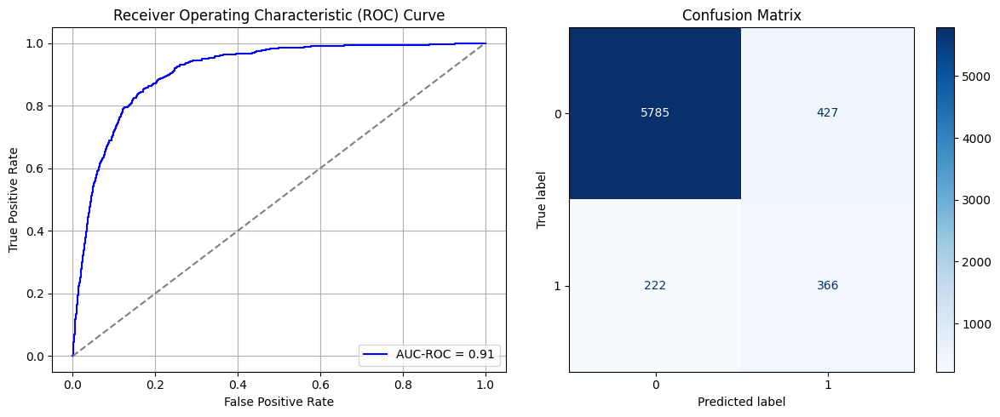

Best threshold based on F1-score: 0.9956616759300232
False Negative Rate: 0.37755102040816324
Time elapsed (performance): 1.3460869869995804
(np.float64(0.06873792659368963), np.float64(0.9312620734063104))
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6856 - loss: 0.6475 - val_AUC: 0.7549 - val_loss: 0.5964
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7846 - loss: 0.5643 - val_AUC: 0.8234 - val_loss: 0.5337
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8501 - loss: 0.4917 - val_AUC: 0.8551 - val_loss: 0.4744
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8773 - loss: 0.4475 - val_AUC: 0.8679 - val_loss: 0.4564
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8798 - loss: 0.4425 - val_AUC: 0.8681 - val_loss: 0.4714
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8836 - loss: 0.4322 - val_AUC: 0.8730 - val_loss: 0.4470
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8915 - loss: 0.4178 - val_AUC: 0.8712 - val_loss: 0.4639
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8871 - loss: 0.4271 - val_AUC: 0.8732 - val_loss: 0.4569
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8881 -

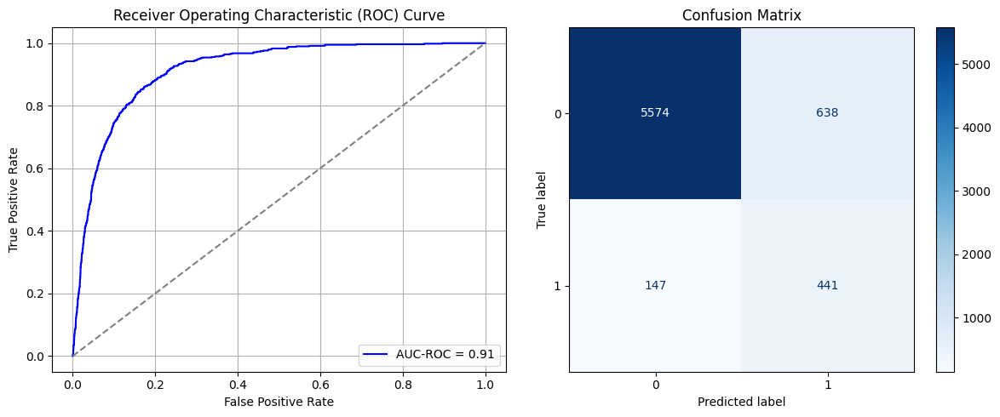

Best threshold based on F1-score: 0.9962198734283447
False Negative Rate: 0.25
Time elapsed (performance): 1.3393876660011301
(np.float64(0.10270444301352222), np.float64(0.8972955569864778))
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.6914 - loss: 0.6556 - val_AUC: 0.7657 - val_loss: 0.5805
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8051 - loss: 0.5474 - val_AUC: 0.8373 - val_loss: 0.5025
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8584 - loss: 0.4801 - val_AUC: 0.8690 - val_loss: 0.4593
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8840 - loss: 0.4347 - val_AUC: 0.8753 - val_loss: 0.4460
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8793 - loss: 0.4389 - val_AUC: 0.8755 - val_loss: 0.4443
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8867 - loss: 0.4248 - val_AUC: 0.8764 - val_loss: 0.4450
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8889 - loss: 0.4205 - val_AUC: 0.8817 - val_loss: 0.4345
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8881 - loss: 0.4218 - val_AUC: 0.8798 - val_loss: 0.4374
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8965 -

<ipython-input-76-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
AUC-ROC: 0.9159036602406577
Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.84      0.91      6212
           1       0.34      0.85      0.48       588

    accuracy                           0.84      6800
   macro avg       0.66      0.84      0.69      6800
weighted avg       0.93      0.84      0.87      6800

FPR 0.15792015453960076 TPR: 0.846938775510204 FNR: 0.15306122448979592 TNR: 0.8420798454603993


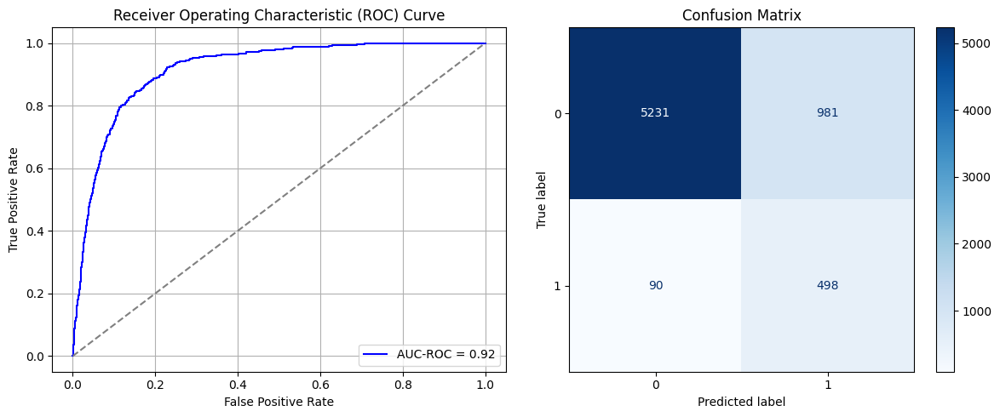

Best threshold based on F1-score: 0.9979113340377808
False Negative Rate: 0.15306122448979592
Time elapsed (performance): 1.0643567369988887
(np.float64(0.15792015453960076), np.float64(0.8420798454603993))
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.6575 - loss: 0.6586 - val_AUC: 0.7619 - val_loss: 0.5908
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7805 - loss: 0.5717 - val_AUC: 0.8456 - val_loss: 0.5057
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8615 - loss: 0.4832 - val_AUC: 0.8744 - val_loss: 0.4588
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8775 - loss: 0.4501 - val_AUC: 0.8775 - val_loss: 0.4509
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8851 - loss: 0.4334 - val_AUC: 0.8795 - val_loss: 0.4457
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8893 - loss: 0.4283 - val_AUC: 0.8830 - val_loss: 0.4422
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8817 - loss: 0.4396 - val_AUC: 0.8837 - val_loss: 0.4386
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8936 - loss: 0.4180 - val_AUC: 0.8840 - val_loss: 0.4465
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8888 -

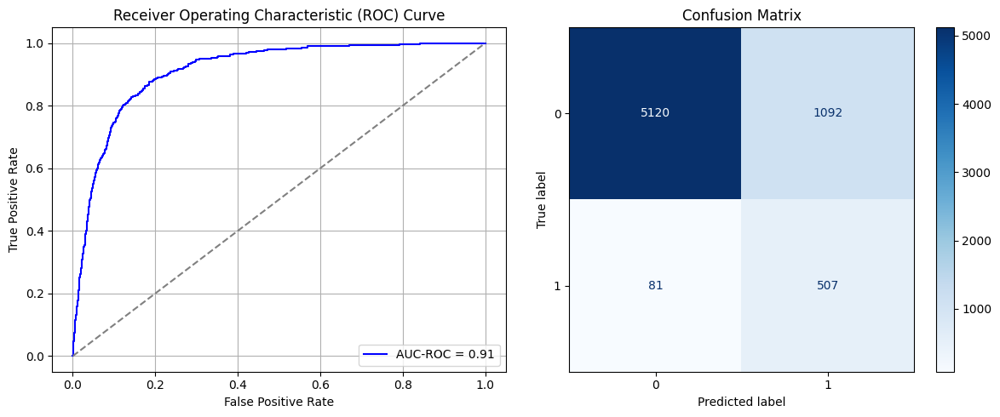

Best threshold based on F1-score: 0.9996264576911926
False Negative Rate: 0.1377551020408163
Time elapsed (performance): 1.0688391410003533
(np.float64(0.17578879587894397), np.float64(0.8242112041210561))
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6571 - loss: 0.6561 - val_AUC: 0.7718 - val_loss: 0.5754
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7932 - loss: 0.5588 - val_AUC: 0.8540 - val_loss: 0.4904
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8600 - loss: 0.4769 - val_AUC: 0.8706 - val_loss: 0.4561
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8865 - loss: 0.4324 - val_AUC: 0.8753 - val_loss: 0.4503
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8850 - loss: 0.4330 - val_AUC: 0.8783 - val_loss: 0.4422
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8929 - loss: 0.4166 - val_AUC: 0.8787 - val_loss: 0.4400
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8906 - loss: 0.4173 - val_AUC: 0.8776 - val_loss: 0.4413
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8864 - loss: 0.4238 - val_AUC: 0.8794 - val_loss: 0.4594
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8857 -

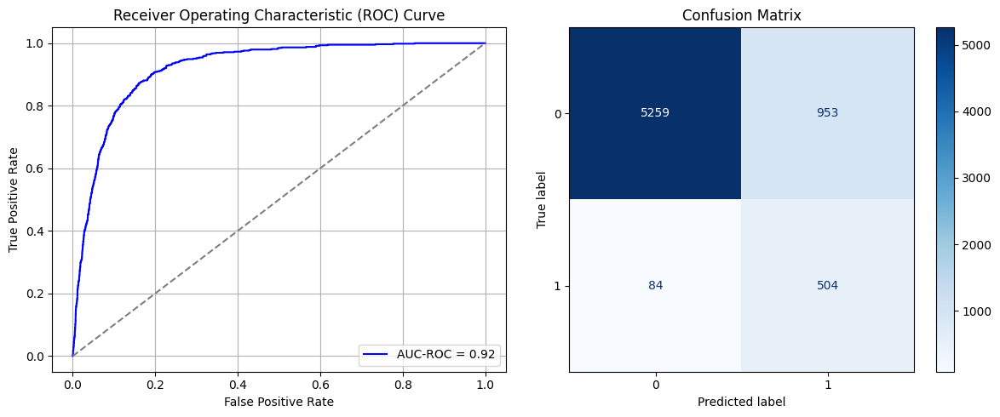

Best threshold based on F1-score: 0.9938015937805176
False Negative Rate: 0.14285714285714285
Time elapsed (performance): 0.8754052439999214
(np.float64(0.15341274951706374), np.float64(0.8465872504829363))
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.6833 - loss: 0.6509 - val_AUC: 0.7487 - val_loss: 0.5959
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7988 - loss: 0.5522 - val_AUC: 0.8379 - val_loss: 0.5171
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8572 - loss: 0.4815 - val_AUC: 0.8586 - val_loss: 0.4862
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8766 - loss: 0.4484 - val_AUC: 0.8671 - val_loss: 0.4620
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8869 - loss: 0.4292 - val_AUC: 0.8690 - val_loss: 0.4584
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8845 - loss: 0.4337 - val_AUC: 0.8700 - val_loss: 0.4581
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8869 - loss: 0.4263 - val_AUC: 0.8698 - val_loss: 0.4555
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8977 - loss: 0.4073 - val_AUC: 0.8731 - val_loss: 0.4522
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8883 -

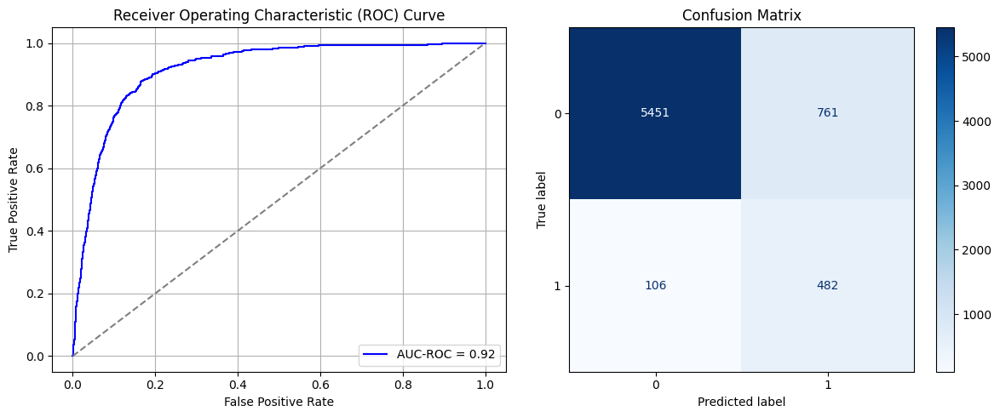

Best threshold based on F1-score: 0.9988527297973633
False Negative Rate: 0.18027210884353742
Time elapsed (performance): 1.0848777900009736
(np.float64(0.12250482936252415), np.float64(0.8774951706374758))
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6762 - loss: 0.6500 - val_AUC: 0.7733 - val_loss: 0.5835
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8000 - loss: 0.5489 - val_AUC: 0.8465 - val_loss: 0.4947
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8580 - loss: 0.4796 - val_AUC: 0.8713 - val_loss: 0.4566
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.8674 - loss: 0.4606 - val_AUC: 0.8789 - val_loss: 0.4400
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8783 - loss: 0.4414 - val_AUC: 0.8819 - val_loss: 0.4400
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8829 - loss: 0.4349 - val_AUC: 0.8812 - val_loss: 0.4472
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8892 - loss: 0.4223 - val_AUC: 0.8820 - val_loss: 0.4459
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8821 - loss: 0.4334 - val_AUC: 0.8849 - val_loss: 0.4268
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8877 -

<ipython-input-76-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
AUC-ROC: 0.9149011021021416
Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.88      0.93      6212
           1       0.38      0.78      0.52       588

    accuracy                           0.87      6800
   macro avg       0.68      0.83      0.72      6800
weighted avg       0.93      0.87      0.89      6800

FPR 0.11928525434642627 TPR: 0.7840136054421769 FNR: 0.21598639455782312 TNR: 0.8807147456535738


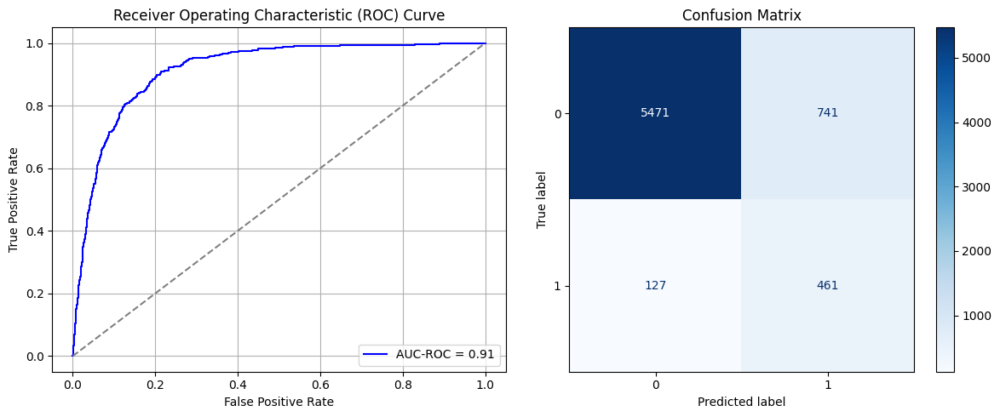

Best threshold based on F1-score: 0.9964156150817871
False Negative Rate: 0.21598639455782312
Time elapsed (performance): 0.9095366980000108
(np.float64(0.11928525434642627), np.float64(0.8807147456535738))
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 9ms/step - AUC: 0.6364 - loss: 0.6588 - val_AUC: 0.7866 - val_loss: 0.5737
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8079 - loss: 0.5439 - val_AUC: 0.8578 - val_loss: 0.4846
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8619 - loss: 0.4739 - val_AUC: 0.8822 - val_loss: 0.4439
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8840 - loss: 0.4385 - val_AUC: 0.8865 - val_loss: 0.4610
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8842 - loss: 0.4343 - val_AUC: 0.8881 - val_loss: 0.4316
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8791 - loss: 0.4428 - val_AUC: 0.8890 - val_loss: 0.4265
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8905 - loss: 0.4197 - val_AUC: 0.8894 - val_loss: 0.4240
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8870 - loss: 0.4262 - val_AUC: 0.8906 - val_loss: 0.4183
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8979 -

<ipython-input-76-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
AUC-ROC: 0.9225207629735731
Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.84      0.90      6212
           1       0.34      0.87      0.49       588

    accuracy                           0.84      6800
   macro avg       0.66      0.86      0.70      6800
weighted avg       0.93      0.84      0.87      6800

FPR 0.16371538956857695 TPR: 0.8741496598639455 FNR: 0.12585034013605442 TNR: 0.836284610431423


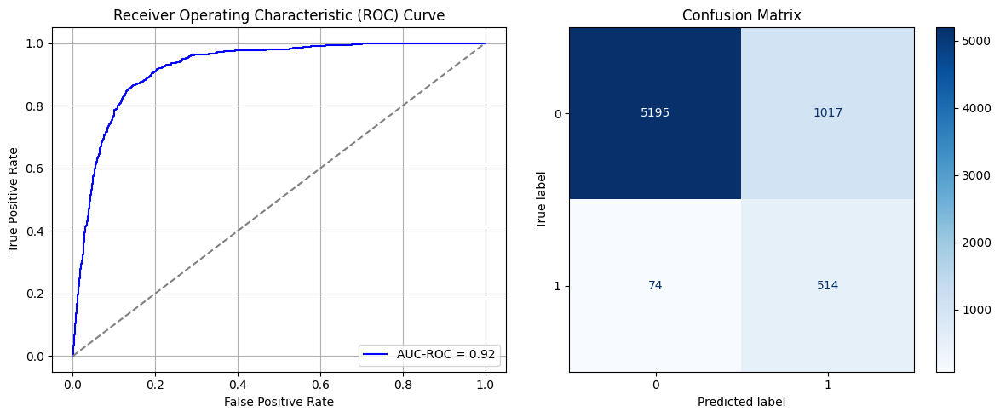

Best threshold based on F1-score: 0.9993485808372498
False Negative Rate: 0.12585034013605442
Time elapsed (performance): 0.9151153309994697
(np.float64(0.16371538956857695), np.float64(0.836284610431423))
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - AUC: 0.6773 - loss: 0.6456 - val_AUC: 0.7748 - val_loss: 0.5748
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8190 - loss: 0.5321 - val_AUC: 0.8461 - val_loss: 0.5107
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8645 - loss: 0.4738 - val_AUC: 0.8633 - val_loss: 0.4790
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8696 - loss: 0.4571 - val_AUC: 0.8693 - val_loss: 0.4601
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8845 - loss: 0.4337 - val_AUC: 0.8735 - val_loss: 0.4720
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8816 - loss: 0.4390 - val_AUC: 0.8760 - val_loss: 0.4500
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8900 - loss: 0.4222 - val_AUC: 0.8736 - val_loss: 0.4534
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8909 - loss: 0.4198 - val_AUC: 0.8721 - val_loss: 0.4643
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8910 -

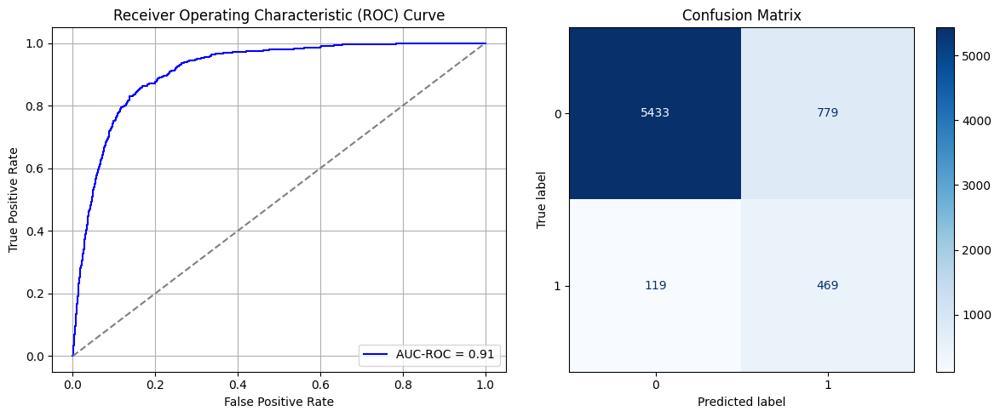

Best threshold based on F1-score: 0.999557375907898
False Negative Rate: 0.20238095238095238
Time elapsed (performance): 1.188597212998502
(np.float64(0.12540244687701224), np.float64(0.8745975531229877))
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.6462 - loss: 0.6642 - val_AUC: 0.7509 - val_loss: 0.5980
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7879 - loss: 0.5649 - val_AUC: 0.8392 - val_loss: 0.5106
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8630 - loss: 0.4779 - val_AUC: 0.8692 - val_loss: 0.4642
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8801 - loss: 0.4462 - val_AUC: 0.8725 - val_loss: 0.4557
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8802 - loss: 0.4463 - val_AUC: 0.8735 - val_loss: 0.4532
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8876 - loss: 0.4314 - val_AUC: 0.8760 - val_loss: 0.4528
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8883 - loss: 0.4324 - val_AUC: 0.8749 - val_loss: 0.4511
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8988 - loss: 0.4082 - val_AUC: 0.8803 - val_loss: 0.4395
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8912 -

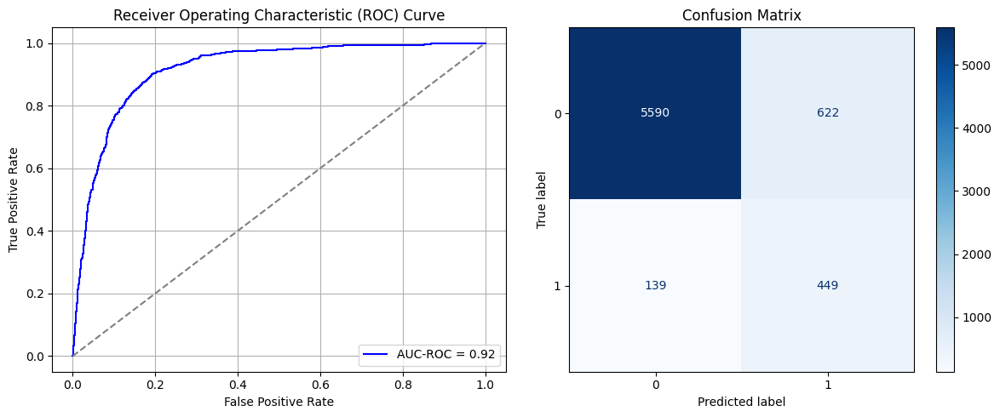

Best threshold based on F1-score: 0.9993756413459778
False Negative Rate: 0.23639455782312926
Time elapsed (performance): 1.3456965730001684
(np.float64(0.10012878300064391), np.float64(0.8998712169993561))
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.6730 - loss: 0.6526 - val_AUC: 0.7626 - val_loss: 0.5889
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8025 - loss: 0.5492 - val_AUC: 0.8345 - val_loss: 0.5077
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8631 - loss: 0.4732 - val_AUC: 0.8582 - val_loss: 0.4720
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8796 - loss: 0.4416 - val_AUC: 0.8679 - val_loss: 0.4583
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8917 - loss: 0.4193 - val_AUC: 0.8694 - val_loss: 0.4541
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8805 - loss: 0.4344 - val_AUC: 0.8700 - val_loss: 0.4572
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8933 - loss: 0.4156 - val_AUC: 0.8719 - val_loss: 0.4468
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8988 - loss: 0.4042 - val_AUC: 0.8726 - val_loss: 0.4494
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8927 -

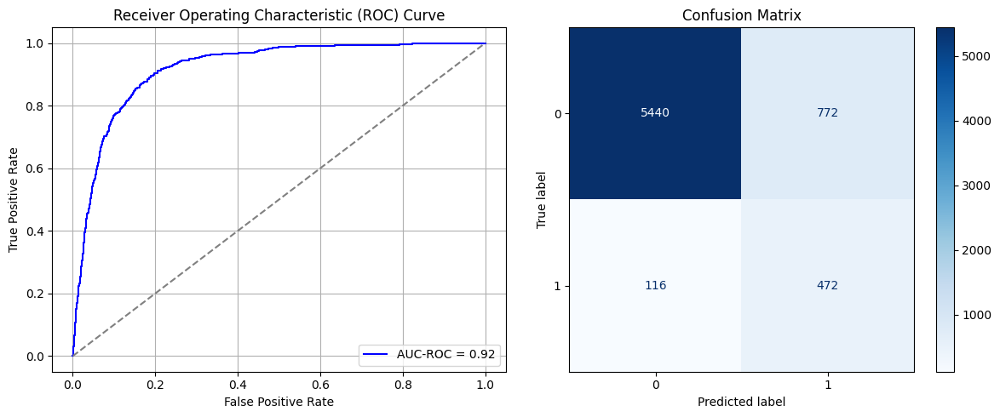

Best threshold based on F1-score: 0.9946918487548828
False Negative Rate: 0.19727891156462585
Time elapsed (performance): 0.8317860810002458
(np.float64(0.12427559562137798), np.float64(0.875724404378622))
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6462 - loss: 0.6611 - val_AUC: 0.7554 - val_loss: 0.5961
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7808 - loss: 0.5709 - val_AUC: 0.8346 - val_loss: 0.5150
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8551 - loss: 0.4843 - val_AUC: 0.8629 - val_loss: 0.4735
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8664 - loss: 0.4651 - val_AUC: 0.8691 - val_loss: 0.4602
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8819 - loss: 0.4371 - val_AUC: 0.8720 - val_loss: 0.4545
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8827 - loss: 0.4344 - val_AUC: 0.8727 - val_loss: 0.4567
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8907 - loss: 0.4187 - val_AUC: 0.8753 - val_loss: 0.4516
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8936 - loss: 0.4123 - val_AUC: 0.8760 - val_loss: 0.4475
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8946 -

<ipython-input-76-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
AUC-ROC: 0.914783379546281
Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.89      0.93      6212
           1       0.40      0.79      0.53       588

    accuracy                           0.88      6800
   macro avg       0.69      0.84      0.73      6800
weighted avg       0.93      0.88      0.90      6800

FPR 0.1107533805537669 TPR: 0.7857142857142857 FNR: 0.21428571428571427 TNR: 0.8892466194462331


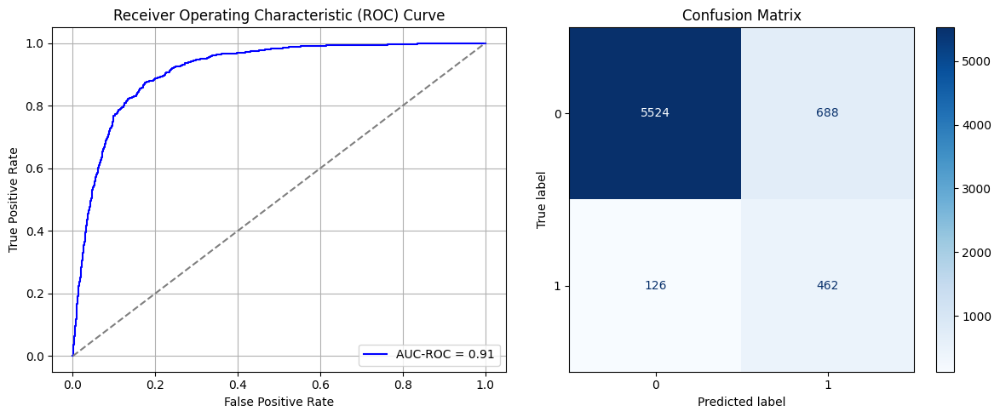

Best threshold based on F1-score: 0.997692883014679
False Negative Rate: 0.21428571428571427
Time elapsed (performance): 1.0566559609997057
(np.float64(0.1107533805537669), np.float64(0.8892466194462331))
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.6920 - loss: 0.6428 - val_AUC: 0.7688 - val_loss: 0.5825
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7829 - loss: 0.5647 - val_AUC: 0.8547 - val_loss: 0.4919
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8605 - loss: 0.4780 - val_AUC: 0.8809 - val_loss: 0.4482
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8838 - loss: 0.4402 - val_AUC: 0.8852 - val_loss: 0.4356
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8779 - loss: 0.4449 - val_AUC: 0.8874 - val_loss: 0.4320
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8855 - loss: 0.4327 - val_AUC: 0.8880 - val_loss: 0.4229
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8965 - loss: 0.4118 - val_AUC: 0.8907 - val_loss: 0.4192
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8809 - loss: 0.4353 - val_AUC: 0.8912 - val_loss: 0.4194
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8915 -

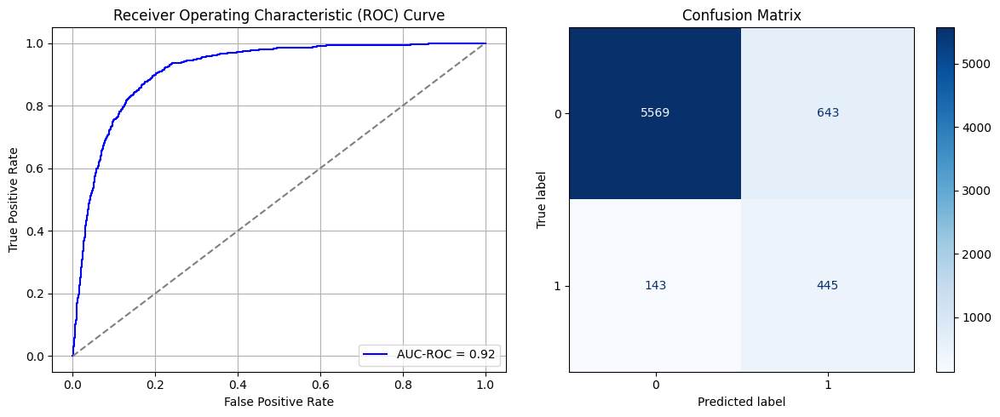

Best threshold based on F1-score: 0.588593065738678
False Negative Rate: 0.24319727891156462
Time elapsed (performance): 1.0807879879994289
(np.float64(0.10350933676754669), np.float64(0.8964906632324533))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6306 - loss: 0.6608 - val_AUC: 0.7624 - val_loss: 0.5883
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7913 - loss: 0.5601 - val_AUC: 0.8373 - val_loss: 0.5127
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8600 - loss: 0.4837 - val_AUC: 0.8635 - val_loss: 0.4734
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8831 - loss: 0.4420 - val_AUC: 0.8661 - val_loss: 0.4637
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8774 - loss: 0.4445 - val_AUC: 0.8684 - val_loss: 0.4578
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8872 - loss: 0.4278 - val_AUC: 0.8686 - val_loss: 0.4585
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8833 - loss: 0.4348 - val_AUC: 0.8694 - val_loss: 0.4551
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8945 - loss: 0.4124 - val_AUC: 0.8694 - val_loss: 0.4538
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8877 -

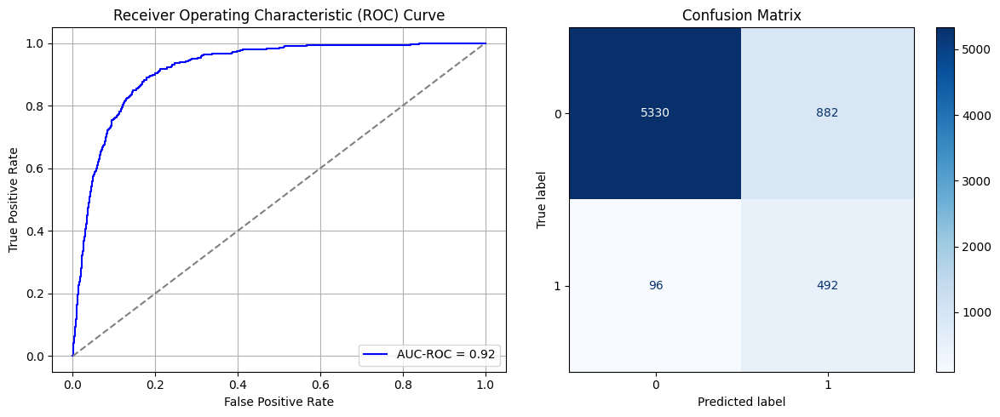

Best threshold based on F1-score: 0.9984033703804016
False Negative Rate: 0.16326530612244897
Time elapsed (performance): 0.904416110000966
(np.float64(0.14198325820991628), np.float64(0.8580167417900837))
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6598 - loss: 0.6570 - val_AUC: 0.7411 - val_loss: 0.6017
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7775 - loss: 0.5682 - val_AUC: 0.8157 - val_loss: 0.5337
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8486 - loss: 0.4942 - val_AUC: 0.8530 - val_loss: 0.4963
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.8600 - loss: 0.4720 - val_AUC: 0.8628 - val_loss: 0.4688
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8785 - loss: 0.4424 - val_AUC: 0.8691 - val_loss: 0.4585
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8790 - loss: 0.4398 - val_AUC: 0.8656 - val_loss: 0.4636
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8829 - loss: 0.4343 - val_AUC: 0.8660 - val_loss: 0.4619
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8914 - loss: 0.4175 - val_AUC: 0.8690 - val_loss: 0.4560
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8922 -

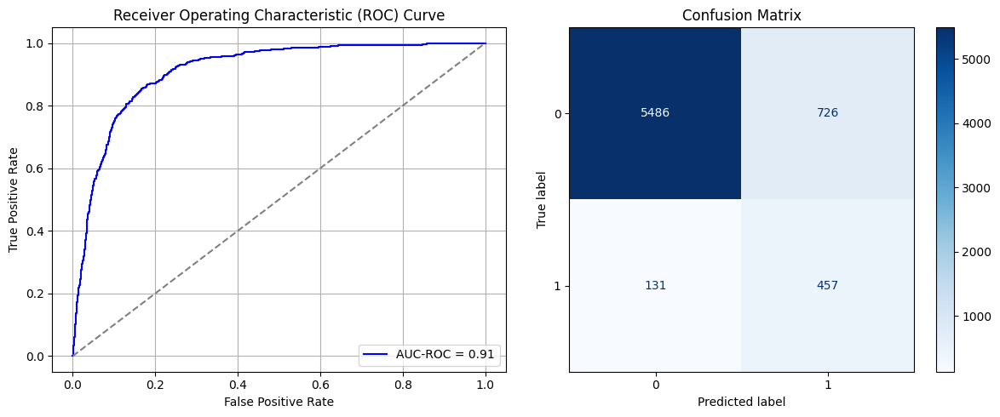

Best threshold based on F1-score: 0.9967398047447205
False Negative Rate: 0.2227891156462585
Time elapsed (performance): 1.0787762880008813
(np.float64(0.11687057308435286), np.float64(0.8831294269156471))
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - AUC: 0.6637 - loss: 0.6561 - val_AUC: 0.7470 - val_loss: 0.5998
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.7828 - loss: 0.5694 - val_AUC: 0.8213 - val_loss: 0.5287
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8562 - loss: 0.4868 - val_AUC: 0.8577 - val_loss: 0.4785
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8856 - loss: 0.4383 - val_AUC: 0.8668 - val_loss: 0.4649
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8895 - loss: 0.4268 - val_AUC: 0.8700 - val_loss: 0.4547
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8849 - loss: 0.4337 - val_AUC: 0.8703 - val_loss: 0.4530
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8873 - loss: 0.4264 - val_AUC: 0.8715 - val_loss: 0.4518
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8902 - loss: 0.4182 - val_AUC: 0.8723 - val_loss: 0.4515
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9015 -

<ipython-input-76-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
AUC-ROC: 0.9115818735736406
Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.78      0.87      6212
           1       0.28      0.88      0.42       588

    accuracy                           0.79      6800
   macro avg       0.63      0.83      0.65      6800
weighted avg       0.92      0.79      0.83      6800

FPR 0.2168383773341919 TPR: 0.8809523809523809 FNR: 0.11904761904761904 TNR: 0.7831616226658081


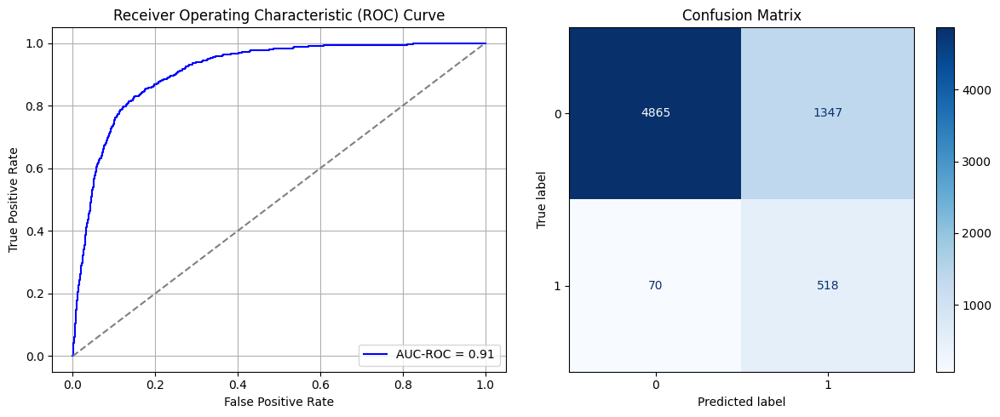

Best threshold based on F1-score: 0.9987853765487671
False Negative Rate: 0.11904761904761904
Time elapsed (performance): 1.2638582149993454
(np.float64(0.2168383773341919), np.float64(0.7831616226658081))
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6526 - loss: 0.6624 - val_AUC: 0.7663 - val_loss: 0.5932
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7847 - loss: 0.5705 - val_AUC: 0.8358 - val_loss: 0.5156
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8503 - loss: 0.4953 - val_AUC: 0.8663 - val_loss: 0.4684
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8657 - loss: 0.4683 - val_AUC: 0.8753 - val_loss: 0.4567
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8854 - loss: 0.4368 - val_AUC: 0.8763 - val_loss: 0.4551
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8872 - loss: 0.4355 - val_AUC: 0.8787 - val_loss: 0.4488
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8896 - loss: 0.4282 - val_AUC: 0.8796 - val_loss: 0.4461
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8878 - loss: 0.4290 - val_AUC: 0.8811 - val_loss: 0.4430
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8861 -

<ipython-input-76-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
AUC-ROC: 0.9110726550761966
Classification Report:
              precision    recall  f1-score   support

           0       0.97      0.90      0.93      6212
           1       0.41      0.75      0.53       588

    accuracy                           0.88      6800
   macro avg       0.69      0.82      0.73      6800
weighted avg       0.93      0.88      0.90      6800

FPR 0.10334835801674179 TPR: 0.7482993197278911 FNR: 0.25170068027210885 TNR: 0.8966516419832582


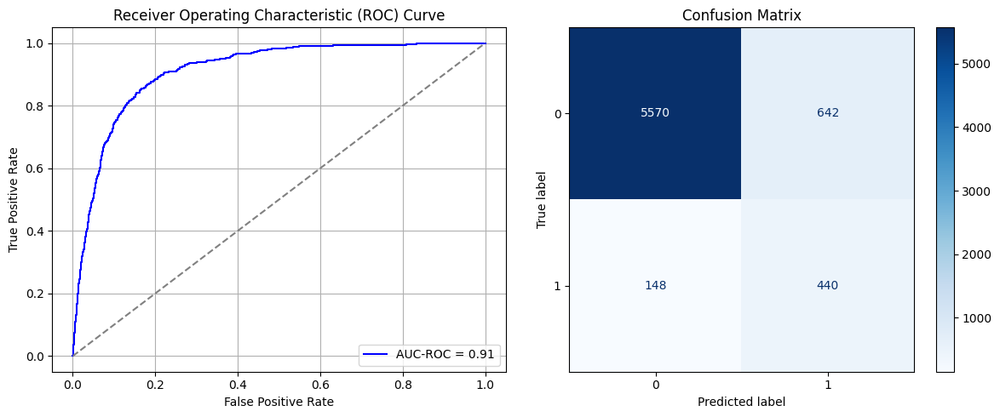

Best threshold based on F1-score: 0.9998052716255188
False Negative Rate: 0.25170068027210885
Time elapsed (performance): 0.8665231159993709
(np.float64(0.10334835801674179), np.float64(0.8966516419832582))
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6697 - loss: 0.6531 - val_AUC: 0.7569 - val_loss: 0.5890
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.7933 - loss: 0.5555 - val_AUC: 0.8359 - val_loss: 0.5081
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8554 - loss: 0.4835 - val_AUC: 0.8631 - val_loss: 0.4795
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8754 - loss: 0.4497 - val_AUC: 0.8707 - val_loss: 0.4569
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8863 - loss: 0.4274 - val_AUC: 0.8767 - val_loss: 0.4457
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8835 - loss: 0.4323 - val_AUC: 0.8765 - val_loss: 0.4436
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8941 - loss: 0.4124 - val_AUC: 0.8777 - val_loss: 0.4422
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8943 - loss: 0.4114 - val_AUC: 0.8781 - val_loss: 0.4448
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8996 -

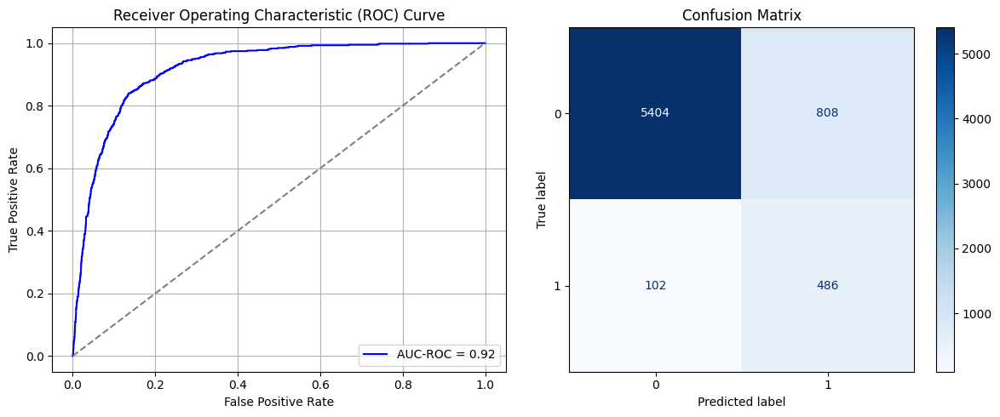

Best threshold based on F1-score: 0.9981986284255981
False Negative Rate: 0.17346938775510204
Time elapsed (performance): 1.079981246000898
(np.float64(0.13007083065035416), np.float64(0.8699291693496458))
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6163 - loss: 0.6651 - val_AUC: 0.7600 - val_loss: 0.5906
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7832 - loss: 0.5673 - val_AUC: 0.8435 - val_loss: 0.5047
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8536 - loss: 0.4888 - val_AUC: 0.8753 - val_loss: 0.4532
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8766 - loss: 0.4487 - val_AUC: 0.8815 - val_loss: 0.4391
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8861 - loss: 0.4295 - val_AUC: 0.8868 - val_loss: 0.4429
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8928 - loss: 0.4178 - val_AUC: 0.8863 - val_loss: 0.4322
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8853 - loss: 0.4267 - val_AUC: 0.8859 - val_loss: 0.4283
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8888 - loss: 0.4185 - val_AUC: 0.8889 - val_loss: 0.4216
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8884 -

<ipython-input-76-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
AUC-ROC: 0.9163901555470867
Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.88      0.92      6212
           1       0.38      0.79      0.51       588

    accuracy                           0.87      6800
   macro avg       0.68      0.83      0.72      6800
weighted avg       0.93      0.87      0.89      6800

FPR 0.12411461687057308 TPR: 0.7925170068027211 FNR: 0.20748299319727892 TNR: 0.8758853831294269


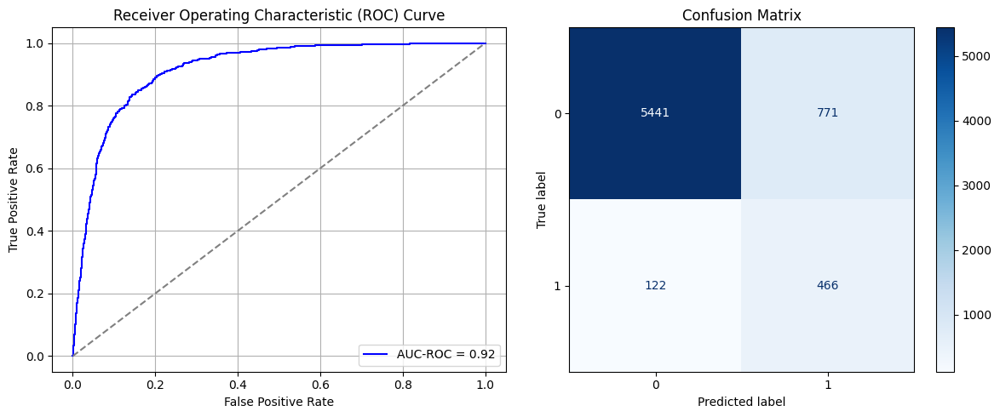

Best threshold based on F1-score: 0.9990460276603699
False Negative Rate: 0.20748299319727892
Time elapsed (performance): 0.9254738799991173
(np.float64(0.12411461687057308), np.float64(0.8758853831294269))
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6635 - loss: 0.6545 - val_AUC: 0.7596 - val_loss: 0.5884
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7820 - loss: 0.5666 - val_AUC: 0.8294 - val_loss: 0.5210
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8529 - loss: 0.4898 - val_AUC: 0.8594 - val_loss: 0.4773
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8756 - loss: 0.4526 - val_AUC: 0.8668 - val_loss: 0.4796
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8753 - loss: 0.4498 - val_AUC: 0.8702 - val_loss: 0.4589
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8709 - loss: 0.4542 - val_AUC: 0.8693 - val_loss: 0.4713
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8806 - loss: 0.4354 - val_AUC: 0.8735 - val_loss: 0.4498
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8814 - loss: 0.4336 - val_AUC: 0.8729 - val_loss: 0.4502
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8894 -

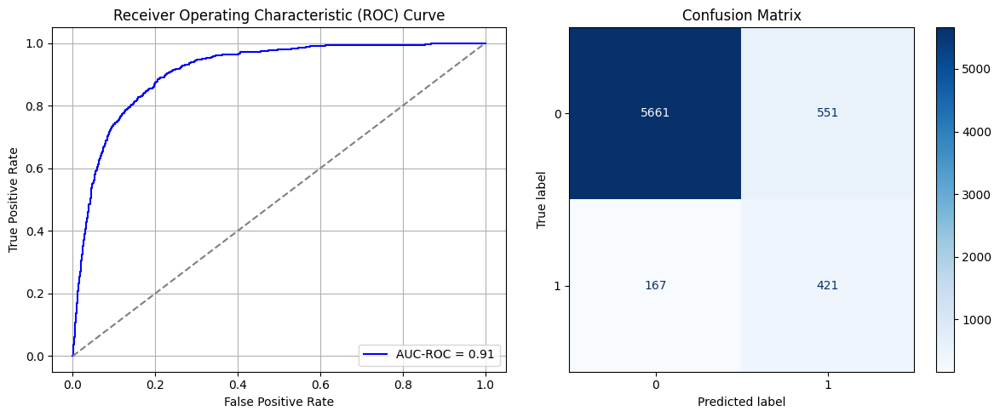

Best threshold based on F1-score: 0.994327187538147
False Negative Rate: 0.28401360544217685
Time elapsed (performance): 1.0475364480007556
(np.float64(0.08869929169349645), np.float64(0.9113007083065036))
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6474 - loss: 0.6588 - val_AUC: 0.7477 - val_loss: 0.6020
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7716 - loss: 0.5774 - val_AUC: 0.8227 - val_loss: 0.5378
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8431 - loss: 0.5065 - val_AUC: 0.8600 - val_loss: 0.4835
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8752 - loss: 0.4565 - val_AUC: 0.8689 - val_loss: 0.4625
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8729 - loss: 0.4550 - val_AUC: 0.8703 - val_loss: 0.4586
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - AUC: 0.8736 - loss: 0.4506 - val_AUC: 0.8689 - val_loss: 0.4569
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8710 - loss: 0.4509 - val_AUC: 0.8736 - val_loss: 0.4498
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8842 - loss: 0.4310 - val_AUC: 0.8742 - val_loss: 0.4475
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8839 -

<ipython-input-76-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
AUC-ROC: 0.9125058587504545
Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.81      0.89      6212
           1       0.30      0.88      0.45       588

    accuracy                           0.81      6800
   macro avg       0.64      0.84      0.67      6800
weighted avg       0.93      0.81      0.85      6800

FPR 0.19381841596909208 TPR: 0.8809523809523809 FNR: 0.11904761904761904 TNR: 0.8061815840309079


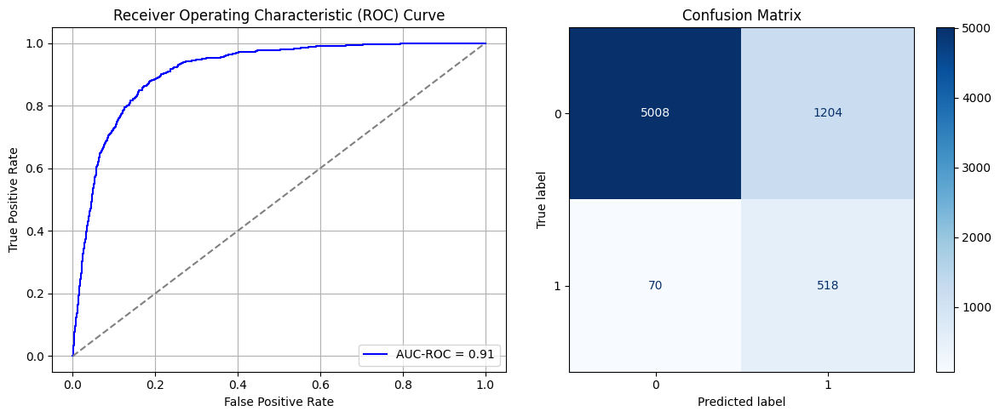

Best threshold based on F1-score: 0.9974870681762695
False Negative Rate: 0.11904761904761904
Time elapsed (performance): 0.9310733220008842
(np.float64(0.19381841596909208), np.float64(0.8061815840309079))
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6646 - loss: 0.6521 - val_AUC: 0.7656 - val_loss: 0.5825
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7889 - loss: 0.5597 - val_AUC: 0.8466 - val_loss: 0.5024
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8591 - loss: 0.4820 - val_AUC: 0.8748 - val_loss: 0.4567
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8700 - loss: 0.4583 - val_AUC: 0.8821 - val_loss: 0.4430
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8707 - loss: 0.4546 - val_AUC: 0.8808 - val_loss: 0.4382
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8820 - loss: 0.4350 - val_AUC: 0.8819 - val_loss: 0.4347
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8921 - loss: 0.4159 - val_AUC: 0.8817 - val_loss: 0.4333
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8835 - loss: 0.4286 - val_AUC: 0.8871 - val_loss: 0.4236
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8770 -

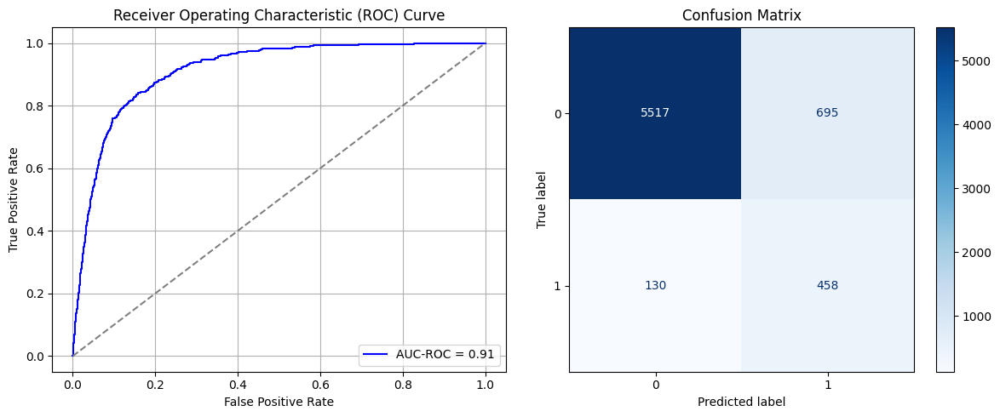

Best threshold based on F1-score: 0.9896288514137268
False Negative Rate: 0.22108843537414966
Time elapsed (performance): 0.9176886450004531
(np.float64(0.11188023180940115), np.float64(0.8881197681905988))
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6671 - loss: 0.6567 - val_AUC: 0.7717 - val_loss: 0.5811
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8023 - loss: 0.5517 - val_AUC: 0.8373 - val_loss: 0.5153
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8693 - loss: 0.4708 - val_AUC: 0.8622 - val_loss: 0.4725
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8798 - loss: 0.4454 - val_AUC: 0.8688 - val_loss: 0.4614
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8818 - loss: 0.4397 - val_AUC: 0.8737 - val_loss: 0.4606
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8783 - loss: 0.4402 - val_AUC: 0.8739 - val_loss: 0.4520
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8900 - loss: 0.4228 - val_AUC: 0.8751 - val_loss: 0.4473
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8855 - loss: 0.4316 - val_AUC: 0.8750 - val_loss: 0.4463
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8951 -

<ipython-input-76-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
AUC-ROC: 0.9095181697920637
Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.87      0.92      6212
           1       0.37      0.79      0.50       588

    accuracy                           0.87      6800
   macro avg       0.67      0.83      0.71      6800
weighted avg       0.93      0.87      0.89      6800

FPR 0.12733419188667097 TPR: 0.7908163265306123 FNR: 0.20918367346938777 TNR: 0.8726658081133291


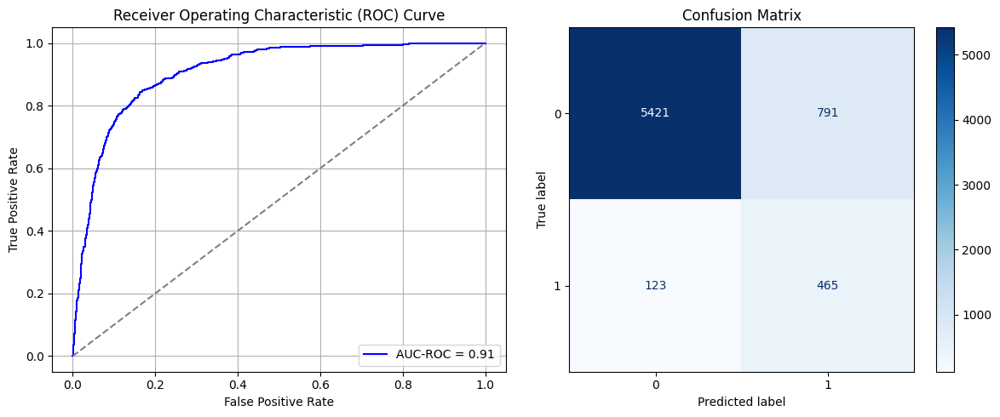

Best threshold based on F1-score: 0.9976111650466919
False Negative Rate: 0.20918367346938777
Time elapsed (performance): 1.0683953170009772
(np.float64(0.12733419188667097), np.float64(0.8726658081133291))
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6705 - loss: 0.6493 - val_AUC: 0.7603 - val_loss: 0.5863
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8034 - loss: 0.5447 - val_AUC: 0.8412 - val_loss: 0.5083
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8615 - loss: 0.4787 - val_AUC: 0.8644 - val_loss: 0.4656
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8695 - loss: 0.4596 - val_AUC: 0.8693 - val_loss: 0.4578
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8863 - loss: 0.4284 - val_AUC: 0.8742 - val_loss: 0.4480
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8901 - loss: 0.4212 - val_AUC: 0.8764 - val_loss: 0.4417
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8933 - loss: 0.4145 - val_AUC: 0.8749 - val_loss: 0.4469
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8887 - loss: 0.4220 - val_AUC: 0.8788 - val_loss: 0.4393
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8920 -

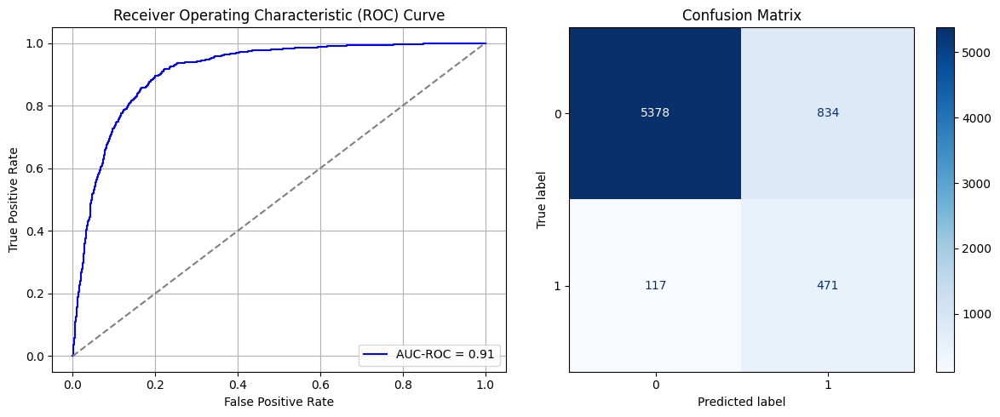

Best threshold based on F1-score: 0.995378315448761
False Negative Rate: 0.1989795918367347
Time elapsed (performance): 0.9087301290001051
(np.float64(0.13425627817128138), np.float64(0.8657437218287186))
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6657 - loss: 0.6602 - val_AUC: 0.7499 - val_loss: 0.5937
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.7787 - loss: 0.5675 - val_AUC: 0.8365 - val_loss: 0.5117
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8512 - loss: 0.4940 - val_AUC: 0.8774 - val_loss: 0.4584
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8684 - loss: 0.4603 - val_AUC: 0.8807 - val_loss: 0.4377
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - AUC: 0.8774 - loss: 0.4436 - val_AUC: 0.8867 - val_loss: 0.4394
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8855 - loss: 0.4284 - val_AUC: 0.8864 - val_loss: 0.4420
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8744 - loss: 0.4457 - val_AUC: 0.8876 - val_loss: 0.4291
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8832 - loss: 0.4298 - val_AUC: 0.8895 - val_loss: 0.4196
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8922 -

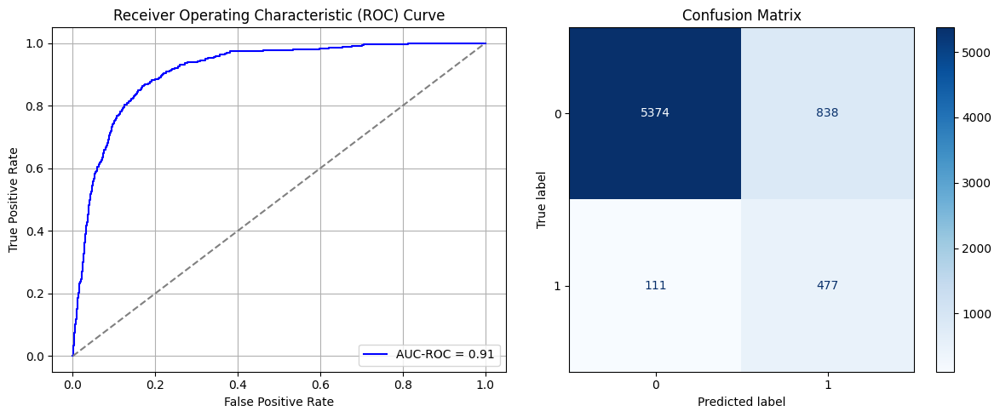

Best threshold based on F1-score: 0.993292510509491
False Negative Rate: 0.18877551020408162
Time elapsed (performance): 1.0688251060000766
(np.float64(0.13490019317450097), np.float64(0.865099806825499))
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6320 - loss: 0.6649 - val_AUC: 0.7549 - val_loss: 0.5935
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.7926 - loss: 0.5620 - val_AUC: 0.8352 - val_loss: 0.5181
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8573 - loss: 0.4843 - val_AUC: 0.8642 - val_loss: 0.4666
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8848 - loss: 0.4321 - val_AUC: 0.8777 - val_loss: 0.4424
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8787 - loss: 0.4397 - val_AUC: 0.8785 - val_loss: 0.4381
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8924 - loss: 0.4157 - val_AUC: 0.8832 - val_loss: 0.4318
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8889 - loss: 0.4216 - val_AUC: 0.8786 - val_loss: 0.4391
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8962 - loss: 0.4095 - val_AUC: 0.8826 - val_loss: 0.4346
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.9003 -

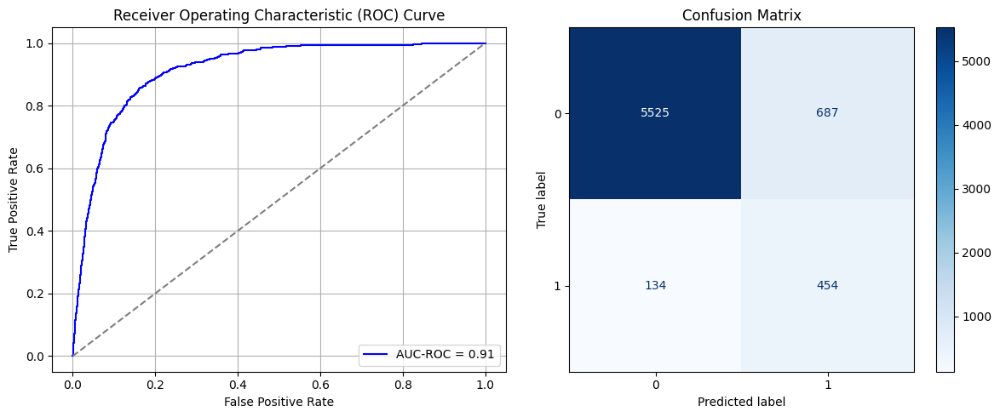

Best threshold based on F1-score: 0.5778215527534485
False Negative Rate: 0.22789115646258504
Time elapsed (performance): 0.9354864369997813
(np.float64(0.11059240180296201), np.float64(0.889407598197038))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6773 - loss: 0.6547 - val_AUC: 0.7605 - val_loss: 0.5858
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.7990 - loss: 0.5522 - val_AUC: 0.8493 - val_loss: 0.5062
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8605 - loss: 0.4844 - val_AUC: 0.8762 - val_loss: 0.4551
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8787 - loss: 0.4470 - val_AUC: 0.8843 - val_loss: 0.4364
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8861 - loss: 0.4356 - val_AUC: 0.8838 - val_loss: 0.4338
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8773 - loss: 0.4471 - val_AUC: 0.8803 - val_loss: 0.4367
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8809 - loss: 0.4399 - val_AUC: 0.8847 - val_loss: 0.4294
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8886 - loss: 0.4236 - val_AUC: 0.8855 - val_loss: 0.4294
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8898 -

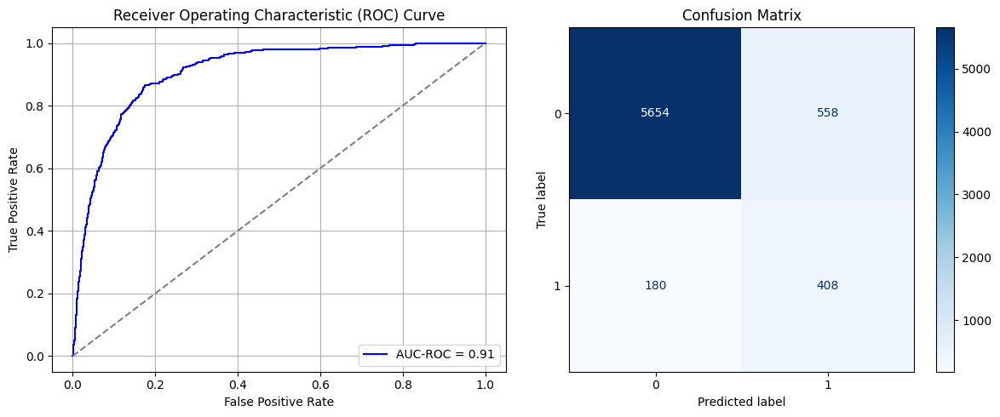

Best threshold based on F1-score: 0.9988877177238464
False Negative Rate: 0.30612244897959184
Time elapsed (performance): 1.0859847800002171
(np.float64(0.08982614294913072), np.float64(0.9101738570508693))
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.6382 - loss: 0.6577 - val_AUC: 0.7724 - val_loss: 0.5845
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.7928 - loss: 0.5581 - val_AUC: 0.8509 - val_loss: 0.4974
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8668 - loss: 0.4746 - val_AUC: 0.8703 - val_loss: 0.4770
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8782 - loss: 0.4511 - val_AUC: 0.8683 - val_loss: 0.4717
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8874 - loss: 0.4284 - val_AUC: 0.8730 - val_loss: 0.4542
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8856 - loss: 0.4317 - val_AUC: 0.8728 - val_loss: 0.4507
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8854 - loss: 0.4288 - val_AUC: 0.8730 - val_loss: 0.4551
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8879 - loss: 0.4267 - val_AUC: 0.8745 - val_loss: 0.4463
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8942 -

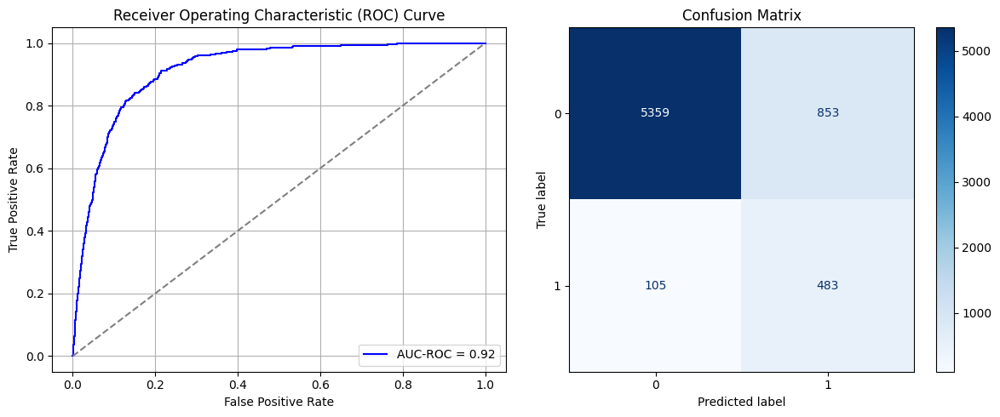

Best threshold based on F1-score: 0.9968141913414001
False Negative Rate: 0.17857142857142858
Time elapsed (performance): 0.9064766020001116
(np.float64(0.13731487443657436), np.float64(0.8626851255634256))
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - AUC: 0.6866 - loss: 0.6466 - val_AUC: 0.7821 - val_loss: 0.5711
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8220 - loss: 0.5320 - val_AUC: 0.8609 - val_loss: 0.4825
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8689 - loss: 0.4635 - val_AUC: 0.8705 - val_loss: 0.4550
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - AUC: 0.8677 - loss: 0.4583 - val_AUC: 0.8796 - val_loss: 0.4394
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8927 - loss: 0.4162 - val_AUC: 0.8801 - val_loss: 0.4367
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8899 - loss: 0.4195 - val_AUC: 0.8825 - val_loss: 0.4476
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8849 - loss: 0.4278 - val_AUC: 0.8854 - val_loss: 0.4266
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8944 - loss: 0.4117 - val_AUC: 0.8862 - val_loss: 0.4273
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8952 -

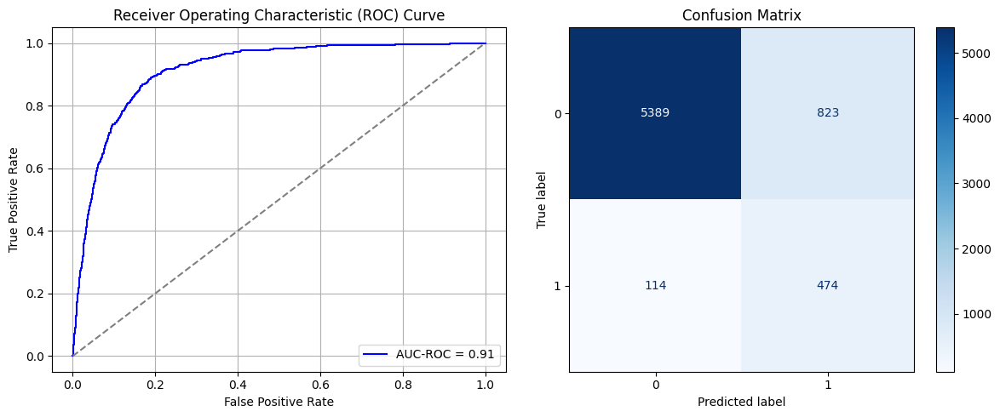

Best threshold based on F1-score: 0.9976306557655334
False Negative Rate: 0.19387755102040816
Time elapsed (performance): 0.9936383080002997
(np.float64(0.13248551191242755), np.float64(0.8675144880875725))
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


178/178 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - AUC: 0.6811 - loss: 0.6515 - val_AUC: 0.7522 - val_loss: 0.5942
Epoch 2/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.7855 - loss: 0.5653 - val_AUC: 0.8246 - val_loss: 0.5227
Epoch 3/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8509 - loss: 0.4929 - val_AUC: 0.8560 - val_loss: 0.4816
Epoch 4/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8694 - loss: 0.4598 - val_AUC: 0.8625 - val_loss: 0.4756
Epoch 5/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8778 - loss: 0.4417 - val_AUC: 0.8655 - val_loss: 0.4692
Epoch 6/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8822 - loss: 0.4332 - val_AUC: 0.8683 - val_loss: 0.4581
Epoch 7/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8883 - loss: 0.4200 - val_AUC: 0.8703 - val_loss: 0.4708
Epoch 8/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - AUC: 0.8845 - loss: 0.4277 - val_AUC: 0.8695 - val_loss: 0.4746
Epoch 9/10
178/178 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8849 -

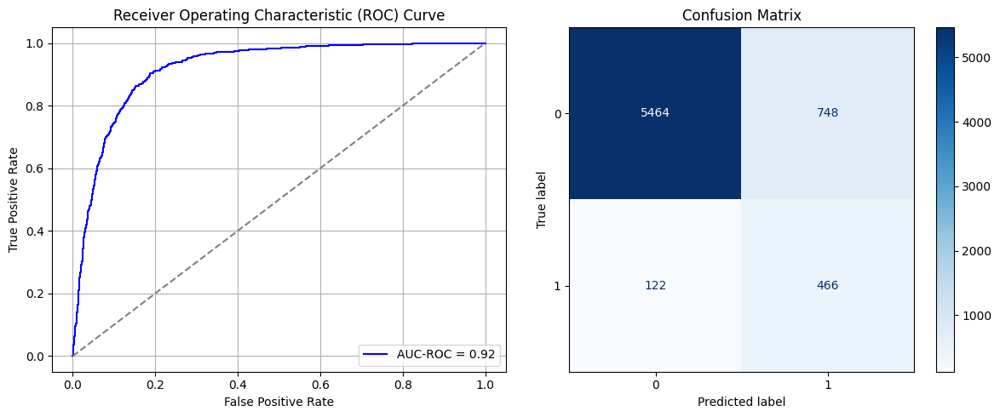

Best threshold based on F1-score: 0.9957630634307861
False Negative Rate: 0.20748299319727892
Time elapsed (performance): 1.903854644000603
(np.float64(0.12041210560206053), np.float64(0.8795878943979395))
    Source time       FPR       TNR       FNR       TPR  Target time
0      9.697337  0.132003  0.867997  0.212585  0.787415     0.764860
1      8.793765  0.126529  0.873471  0.195578  0.804422     1.023217
2      8.692254  0.106729  0.893271  0.250000  0.750000     1.070577
3     10.768860  0.113812  0.886188  0.207483  0.792517     0.761734
4      9.837659  0.133773  0.866227  0.171769  0.828231     0.775658
5      9.566466  0.124759  0.875241  0.214286  0.785714     1.047728
6     10.006104  0.099485  0.900515  0.255102  0.744898     0.766891
7      9.978140  0.105602  0.894398  0.236395  0.763605     1.038076
8     10.240593  0.118319  0.881681  0.232993  0.767007     0.772186
9      9.032491  0.134900  0.865100  0.200680  0.799320     1.138521
10     9.966257  0.107856  0.892144

<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


In [98]:
import random

times = 50

Training_time = []
FPR = []
TPR = []
FNR = []
TNR = []
TL_time = []

m = 10

k = oversample_size/undersample_size * m
print(k)

# np.random.seed(123)

for i in range(times):
    start = np.random.choice(int(k), 10)
    # print(start)

    Row = []

    Row = []

    for j in range(len(start)):
      for l in range(int(undersample_size/m)):
        row = start[j]+int(k*l)-1
        Row.append(row)

    # print(Row)

    data_S_maj_rus = pd.DataFrame()
    data_S_maj_rus = data_S_majority.iloc[Row]

    data_S_Sy_RUS = pd.concat([data_S_maj_rus, data_S_minority])
    X_S_Sy = data_S_Sy_RUS.iloc[:, :-1]
    y_S_Sy = data_S_Sy_RUS.iloc[:, -1]
    X_S_train, X_S_test, y_S_train, y_S_test = train_test_split(X_S_Sy, y_S_Sy, test_size=0.20, random_state=0)
    model_Sy = create_dnn_model(X_S_train.shape[1])
    result_Sy = train_and_evaluate(model_Sy, X_S_train, X_S_test, y_S_train, y_S_test, "Source")
    result_TL_Sy = Transductive_TL(model_Sy, X_T_full, y_T_full, "Target")
    print(result_TL_Sy[0:2])

    Training_time.append(result_Sy)
    FPR.append(result_TL_Sy[0])
    TNR.append(result_TL_Sy[1])
    FNR.append(result_TL_Sy[2])
    TPR.append(result_TL_Sy[3])
    TL_time.append(result_TL_Sy[4])

# return fpr, tnr, fnr, tpr, time_elapsed

# print(TNR)

ParamFit = pd.DataFrame([Training_time, FPR, TNR, FNR, TPR, TL_time]).T
ParamFit.columns=['Source time', 'FPR', 'TNR', 'FNR', 'TPR', 'Target time']
print(ParamFit)

In [99]:
print(ParamFit)
ParamFit.to_csv('Sy2_RUS.csv')

    Source time       FPR       TNR       FNR       TPR  Target time
0      9.697337  0.132003  0.867997  0.212585  0.787415     0.764860
1      8.793765  0.126529  0.873471  0.195578  0.804422     1.023217
2      8.692254  0.106729  0.893271  0.250000  0.750000     1.070577
3     10.768860  0.113812  0.886188  0.207483  0.792517     0.761734
4      9.837659  0.133773  0.866227  0.171769  0.828231     0.775658
5      9.566466  0.124759  0.875241  0.214286  0.785714     1.047728
6     10.006104  0.099485  0.900515  0.255102  0.744898     0.766891
7      9.978140  0.105602  0.894398  0.236395  0.763605     1.038076
8     10.240593  0.118319  0.881681  0.232993  0.767007     0.772186
9      9.032491  0.134900  0.865100  0.200680  0.799320     1.138521
10     9.966257  0.107856  0.892144  0.209184  0.790816     0.782154
11     9.166189  0.146008  0.853992  0.142857  0.857143     1.033672
12    10.010896  0.128300  0.871700  0.197279  0.802721     1.040718
13     9.902928  0.120090  0.87991

# Random Oversampling (ROS):

## Simple Random Sampling with Replacement:

In this case, we investigate the effectiveness of Random Oversampling methods, beginning with Simple Random Sampling (SRS) with replacement. For this, we perform random resampling from the minority class of size $N_1$ to generate an additional sample of size $N_0-N_1$, such that the oversampled minority class will have the same size as the majority class.

In [100]:
data_S
data_S_majority = data_S[data_S['Y'].isin([0])]
data_S_minority = data_S[data_S['Y'].isin([1])]

undersample_size = data_S_minority['Y'].size
oversample_size = data_S_majority['Y'].size

print(undersample_size)
print(oversample_size)

4433
31960


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 1/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 8s 3ms/step - AUC: 0.7944 - loss: 0.5458 - val_AUC: 0.8875 - val_loss: 0.4232
Epoch 2/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8861 - loss: 0.4248 - val_AUC: 0.8928 - val_loss: 0.4124
Epoch 3/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8939 - loss: 0.4090 - val_AUC: 0.9016 - val_loss: 0.3934
Epoch 4/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9020 - loss: 0.3923 - val_AUC: 0.9059 - val_loss: 0.3860
Epoch 5/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9072 - loss: 0.3810 - val_AUC: 0.9097 - val_loss: 0.3738
Epoch 6/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9083 - loss: 0.3776 - val_AUC: 0.9125 - val_loss: 0.3737
Epoch 7/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9123 - loss: 0.3687 - val_AUC: 0.9139 - val_loss: 0.3635
Epoch 8/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9125 - loss: 0.3678 - val_AUC: 0.9165 - val_loss: 0.3599
Epoch 9/10
1279/1279 ━━━━━━━━━━━━━━━━━━━

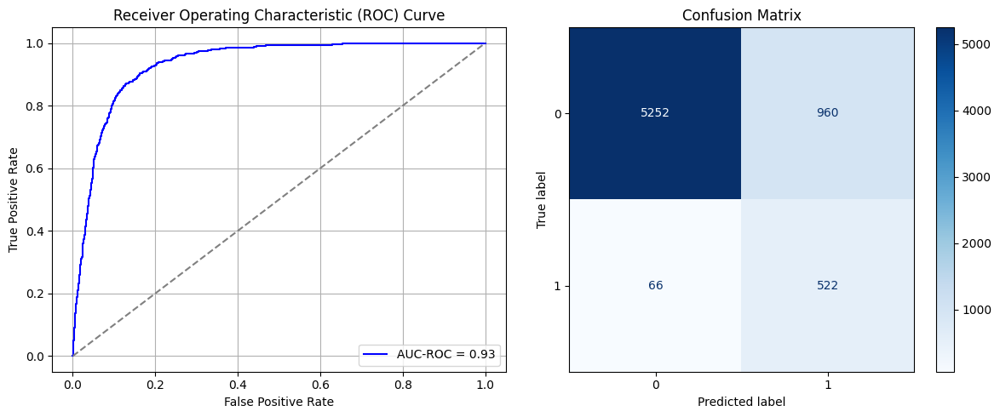

Best threshold based on F1-score: 0.7876825332641602
False Negative Rate: 0.11224489795918367
Time elapsed (performance): 0.7824903750006342
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.7893 - loss: 0.5511 - val_AUC: 0.8876 - val_loss: 0.4269
Epoch 2/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8842 - loss: 0.4288 - val_AUC: 0.8925 - val_loss: 0.4237
Epoch 3/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/step - AUC: 0.8900 - loss: 0.4160 - val_AUC: 0.8975 - val_loss: 0.4054
Epoch 4/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8973 - loss: 0.4007 - val_AUC: 0.9038 - val_loss: 0.3938
Epoch 5/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9018 - loss: 0.3922 - val_AUC: 0.9062 - val_loss: 0.3830
Epoch 6/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - AUC: 0.9055 - loss: 0.3837 - val_AUC: 0.9092 - val_loss: 0.3777
Epoch 7/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9095 - loss: 0.3750 - val_AUC: 0.9118 - val_loss: 0.3717
Epoch 8/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9145 - loss: 0.3642 - val_AUC: 0.9133 - val_loss: 0.3690
Epoch 9/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/st

<ipython-input-76-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
AUC-ROC: 0.9318378188364851
Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.83      0.90      6212
           1       0.34      0.91      0.50       588

    accuracy                           0.84      6800
   macro avg       0.66      0.87      0.70      6800
weighted avg       0.93      0.84      0.87      6800

FPR 0.16806181584030908 TPR: 0.9132653061224489 FNR: 0.08673469387755102 TNR: 0.8319381841596909


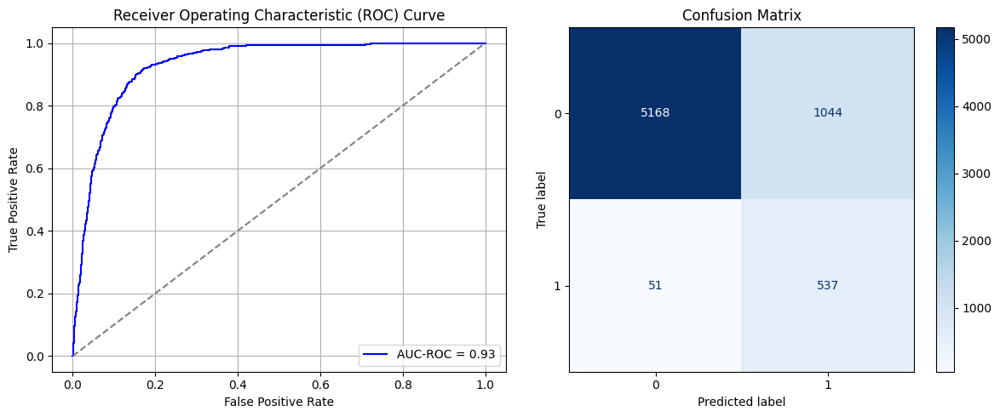

Best threshold based on F1-score: 0.8115533590316772
False Negative Rate: 0.08673469387755102
Time elapsed (performance): 0.7821920950009371
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1279/1279 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - AUC: 0.7923 - loss: 0.5476 - val_AUC: 0.8862 - val_loss: 0.4275
Epoch 2/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8793 - loss: 0.4376 - val_AUC: 0.8918 - val_loss: 0.4171
Epoch 3/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8914 - loss: 0.4145 - val_AUC: 0.8986 - val_loss: 0.4058
Epoch 4/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/step - AUC: 0.8915 - loss: 0.4113 - val_AUC: 0.9020 - val_loss: 0.3919
Epoch 5/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8954 - loss: 0.4053 - val_AUC: 0.9057 - val_loss: 0.3837
Epoch 6/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9018 - loss: 0.3914 - val_AUC: 0.9071 - val_loss: 0.3808
Epoch 7/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9069 - loss: 0.3814 - val_AUC: 0.9108 - val_loss: 0.3811
Epoch 8/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9075 - loss: 0.3796 - val_AUC: 0.9145 - val_loss: 0.3733
Epoch 9/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/st

<ipython-input-76-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
AUC-ROC: 0.929625182333075
Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.88      0.93      6212
           1       0.40      0.83      0.54       588

    accuracy                           0.88      6800
   macro avg       0.69      0.86      0.74      6800
weighted avg       0.93      0.88      0.90      6800

FPR 0.11574372182871862 TPR: 0.826530612244898 FNR: 0.17346938775510204 TNR: 0.8842562781712814


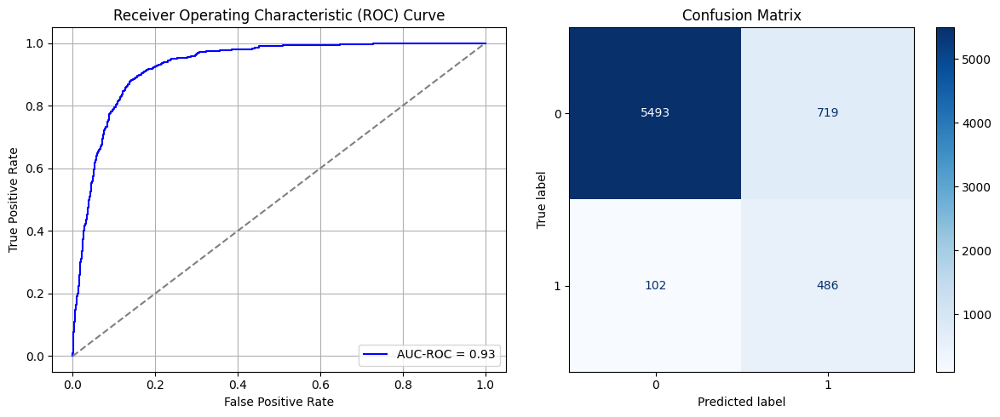

Best threshold based on F1-score: 0.6641920804977417
False Negative Rate: 0.17346938775510204
Time elapsed (performance): 0.7958946640010254
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1279/1279 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - AUC: 0.7832 - loss: 0.5580 - val_AUC: 0.8898 - val_loss: 0.4261
Epoch 2/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8850 - loss: 0.4305 - val_AUC: 0.8963 - val_loss: 0.4136
Epoch 3/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8962 - loss: 0.4055 - val_AUC: 0.9074 - val_loss: 0.3902
Epoch 4/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9053 - loss: 0.3857 - val_AUC: 0.9130 - val_loss: 0.3699
Epoch 5/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9060 - loss: 0.3827 - val_AUC: 0.9171 - val_loss: 0.3592
Epoch 6/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9110 - loss: 0.3708 - val_AUC: 0.9190 - val_loss: 0.3545
Epoch 7/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9158 - loss: 0.3608 - val_AUC: 0.9211 - val_loss: 0.3488
Epoch 8/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9173 - loss: 0.3572 - val_AUC: 0.9210 - val_loss: 0.3509
Epoch 9/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/st

<ipython-input-76-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
AUC-ROC: 0.9275513489362261
Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.86      0.92      6212
           1       0.36      0.87      0.51       588

    accuracy                           0.86      6800
   macro avg       0.67      0.86      0.71      6800
weighted avg       0.93      0.86      0.88      6800

FPR 0.1445589182227946 TPR: 0.8656462585034014 FNR: 0.13435374149659865 TNR: 0.8554410817772053


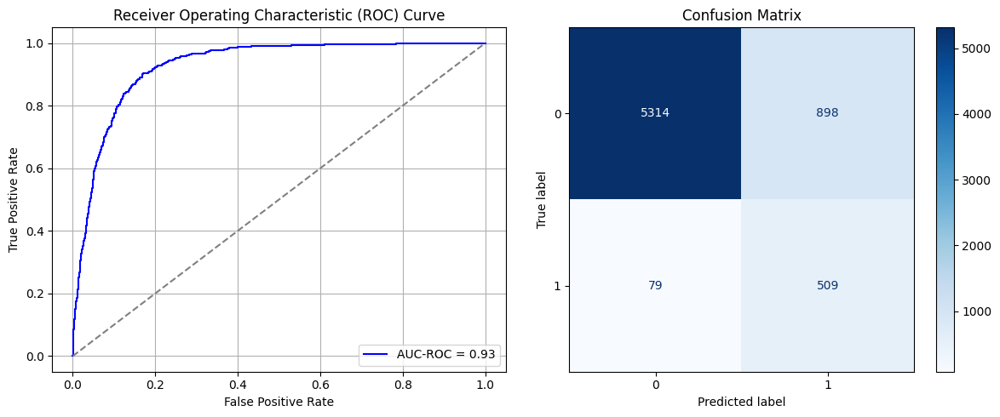

Best threshold based on F1-score: 0.7388377785682678
False Negative Rate: 0.13435374149659865
Time elapsed (performance): 1.0674042419996113
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.7881 - loss: 0.5546 - val_AUC: 0.8886 - val_loss: 0.4306
Epoch 2/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8875 - loss: 0.4238 - val_AUC: 0.8947 - val_loss: 0.4084
Epoch 3/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8940 - loss: 0.4085 - val_AUC: 0.9030 - val_loss: 0.3929
Epoch 4/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9021 - loss: 0.3927 - val_AUC: 0.9080 - val_loss: 0.3811
Epoch 5/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9052 - loss: 0.3848 - val_AUC: 0.9109 - val_loss: 0.4039
Epoch 6/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9076 - loss: 0.3799 - val_AUC: 0.9139 - val_loss: 0.3664
Epoch 7/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9109 - loss: 0.3712 - val_AUC: 0.9167 - val_loss: 0.3620
Epoch 8/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9152 - loss: 0.3619 - val_AUC: 0.9176 - val_loss: 0.3629
Epoch 9/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/st

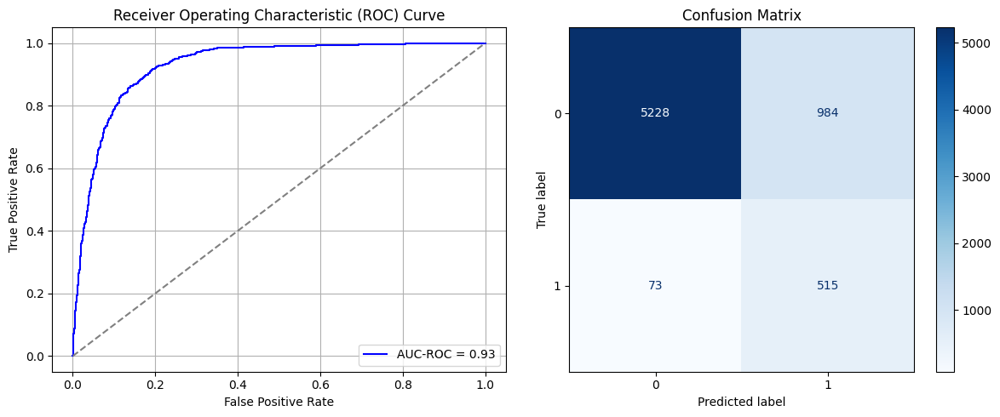

Best threshold based on F1-score: 0.9942017197608948
False Negative Rate: 0.12414965986394558
Time elapsed (performance): 0.7882358930000919
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/step - AUC: 0.7990 - loss: 0.5432 - val_AUC: 0.8864 - val_loss: 0.4267
Epoch 2/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8867 - loss: 0.4238 - val_AUC: 0.8949 - val_loss: 0.4102
Epoch 3/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8952 - loss: 0.4064 - val_AUC: 0.9023 - val_loss: 0.3982
Epoch 4/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8963 - loss: 0.4025 - val_AUC: 0.9071 - val_loss: 0.3846
Epoch 5/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9051 - loss: 0.3850 - val_AUC: 0.9107 - val_loss: 0.3756
Epoch 6/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9094 - loss: 0.3741 - val_AUC: 0.9136 - val_loss: 0.3649
Epoch 7/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9119 - loss: 0.3696 - val_AUC: 0.9149 - val_loss: 0.3698
Epoch 8/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.9163 - loss: 0.3595 - val_AUC: 0.9185 - val_loss: 0.3629
Epoch 9/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/st

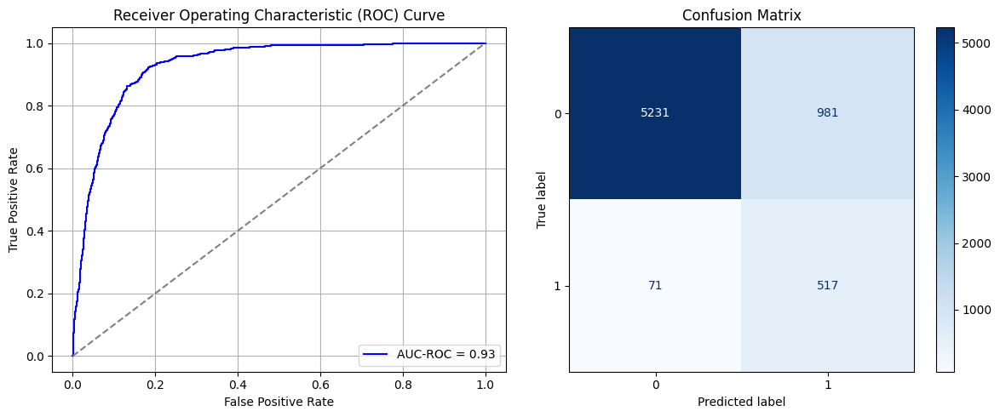

Best threshold based on F1-score: 0.9784729480743408
False Negative Rate: 0.12074829931972789
Time elapsed (performance): 1.0584344059989235
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.7897 - loss: 0.5525 - val_AUC: 0.8900 - val_loss: 0.4219
Epoch 2/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8821 - loss: 0.4327 - val_AUC: 0.8948 - val_loss: 0.4110
Epoch 3/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8889 - loss: 0.4178 - val_AUC: 0.9020 - val_loss: 0.4034
Epoch 4/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8970 - loss: 0.4018 - val_AUC: 0.9074 - val_loss: 0.3815
Epoch 5/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9048 - loss: 0.3854 - val_AUC: 0.9102 - val_loss: 0.3730
Epoch 6/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9100 - loss: 0.3748 - val_AUC: 0.9137 - val_loss: 0.3644
Epoch 7/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9120 - loss: 0.3686 - val_AUC: 0.9165 - val_loss: 0.3589
Epoch 8/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9129 - loss: 0.3663 - val_AUC: 0.9188 - val_loss: 0.3546
Epoch 9/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/st

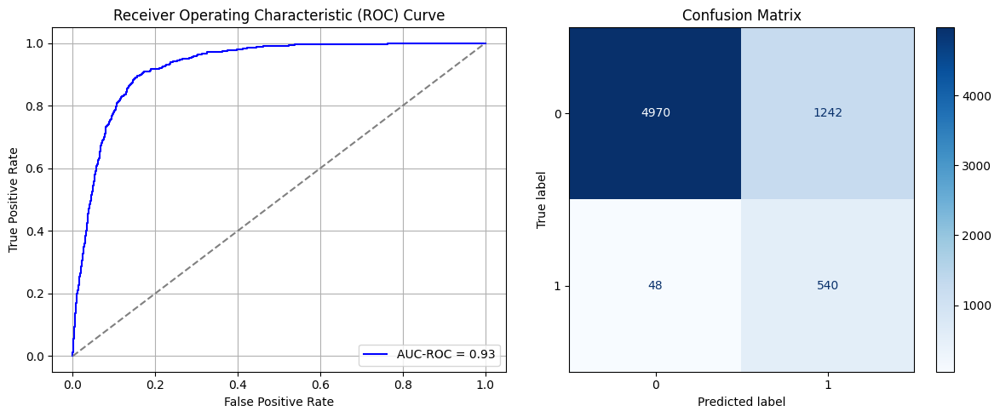

Best threshold based on F1-score: 0.7809227705001831
False Negative Rate: 0.08163265306122448
Time elapsed (performance): 0.9063731520000147
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/step - AUC: 0.7808 - loss: 0.5567 - val_AUC: 0.8845 - val_loss: 0.4287
Epoch 2/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8835 - loss: 0.4292 - val_AUC: 0.8938 - val_loss: 0.4096
Epoch 3/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8900 - loss: 0.4155 - val_AUC: 0.9005 - val_loss: 0.3973
Epoch 4/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8986 - loss: 0.3992 - val_AUC: 0.9066 - val_loss: 0.3860
Epoch 5/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9005 - loss: 0.3950 - val_AUC: 0.9108 - val_loss: 0.3731
Epoch 6/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9075 - loss: 0.3801 - val_AUC: 0.9135 - val_loss: 0.3678
Epoch 7/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9127 - loss: 0.3695 - val_AUC: 0.9152 - val_loss: 0.3634
Epoch 8/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.9124 - loss: 0.3690 - val_AUC: 0.9175 - val_loss: 0.3664
Epoch 9/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/st

<ipython-input-76-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
AUC-ROC: 0.9308215720286827
Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.85      0.91      6212
           1       0.36      0.89      0.51       588

    accuracy                           0.85      6800
   macro avg       0.67      0.87      0.71      6800
weighted avg       0.93      0.85      0.88      6800

FPR 0.14906632324533162 TPR: 0.891156462585034 FNR: 0.10884353741496598 TNR: 0.8509336767546684


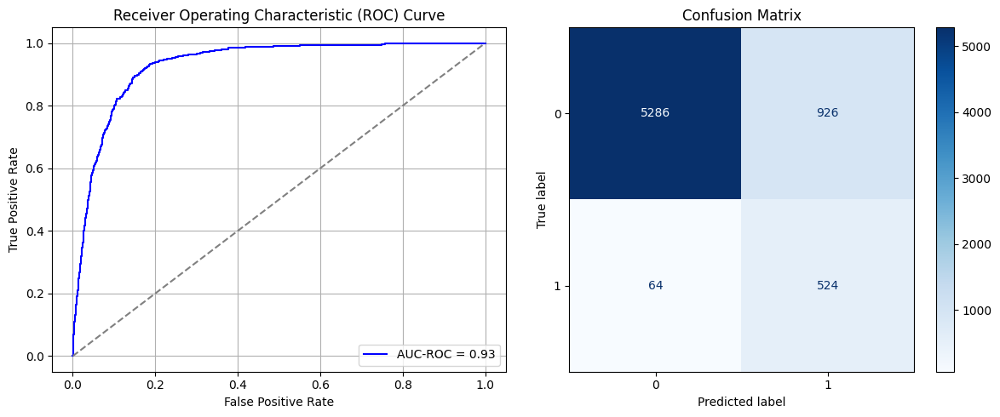

Best threshold based on F1-score: 0.9926391243934631
False Negative Rate: 0.10884353741496598
Time elapsed (performance): 1.2281709279995994
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/step - AUC: 0.7782 - loss: 0.5573 - val_AUC: 0.8918 - val_loss: 0.4190
Epoch 2/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8854 - loss: 0.4263 - val_AUC: 0.8959 - val_loss: 0.4278
Epoch 3/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8906 - loss: 0.4153 - val_AUC: 0.9008 - val_loss: 0.3961
Epoch 4/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8936 - loss: 0.4083 - val_AUC: 0.9065 - val_loss: 0.3849
Epoch 5/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9002 - loss: 0.3950 - val_AUC: 0.9094 - val_loss: 0.3774
Epoch 6/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/step - AUC: 0.9054 - loss: 0.3842 - val_AUC: 0.9136 - val_loss: 0.3661
Epoch 7/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9077 - loss: 0.3802 - val_AUC: 0.9149 - val_loss: 0.3697
Epoch 8/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9121 - loss: 0.3691 - val_AUC: 0.9187 - val_loss: 0.3608
Epoch 9/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/st

<ipython-input-76-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
AUC-ROC: 0.9295091024175286
Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.83      0.90      6212
           1       0.33      0.91      0.48       588

    accuracy                           0.83      6800
   macro avg       0.66      0.87      0.69      6800
weighted avg       0.93      0.83      0.86      6800

FPR 0.17498390212491952 TPR: 0.9098639455782312 FNR: 0.09013605442176871 TNR: 0.8250160978750805


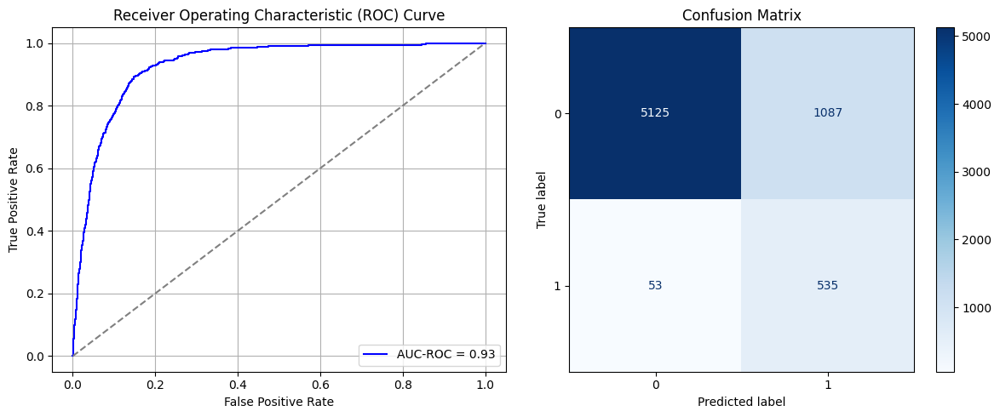

Best threshold based on F1-score: 0.8050104379653931
False Negative Rate: 0.09013605442176871
Time elapsed (performance): 1.2032958700001473
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/step - AUC: 0.7763 - loss: 0.5605 - val_AUC: 0.8881 - val_loss: 0.4354
Epoch 2/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8828 - loss: 0.4299 - val_AUC: 0.8943 - val_loss: 0.4095
Epoch 3/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/step - AUC: 0.8949 - loss: 0.4066 - val_AUC: 0.9008 - val_loss: 0.4060
Epoch 4/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9001 - loss: 0.3959 - val_AUC: 0.9043 - val_loss: 0.3932
Epoch 5/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9059 - loss: 0.3836 - val_AUC: 0.9090 - val_loss: 0.3764
Epoch 6/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9077 - loss: 0.3789 - val_AUC: 0.9125 - val_loss: 0.3706
Epoch 7/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9123 - loss: 0.3691 - val_AUC: 0.9135 - val_loss: 0.3699
Epoch 8/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9096 - loss: 0.3742 - val_AUC: 0.9158 - val_loss: 0.3592
Epoch 9/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/st

<ipython-input-76-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
AUC-ROC: 0.9274631939060235
Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.86      0.92      6212
           1       0.37      0.86      0.52       588

    accuracy                           0.86      6800
   macro avg       0.68      0.86      0.72      6800
weighted avg       0.93      0.86      0.88      6800

FPR 0.13860270444301354 TPR: 0.8605442176870748 FNR: 0.13945578231292516 TNR: 0.8613972955569864


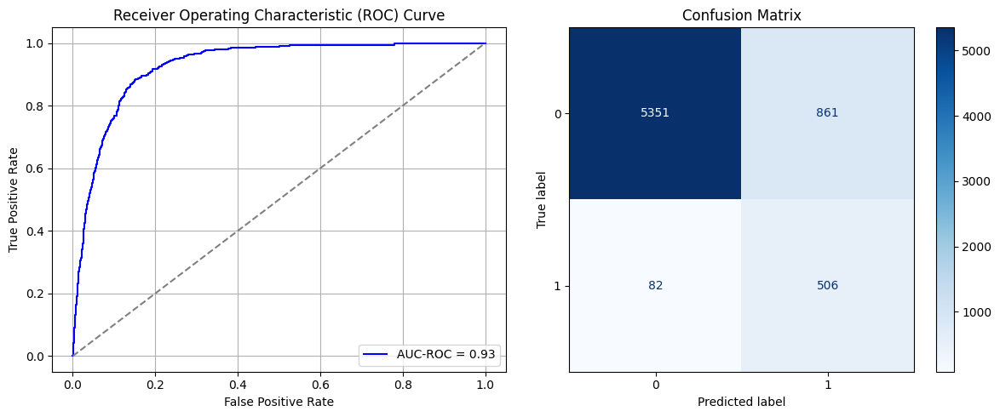

Best threshold based on F1-score: 0.9898638725280762
False Negative Rate: 0.13945578231292516
Time elapsed (performance): 1.090019678000317
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.7944 - loss: 0.5490 - val_AUC: 0.8854 - val_loss: 0.4333
Epoch 2/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8822 - loss: 0.4375 - val_AUC: 0.8893 - val_loss: 0.4218
Epoch 3/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8884 - loss: 0.4226 - val_AUC: 0.8951 - val_loss: 0.4120
Epoch 4/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8926 - loss: 0.4125 - val_AUC: 0.8994 - val_loss: 0.3985
Epoch 5/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8983 - loss: 0.4009 - val_AUC: 0.9023 - val_loss: 0.3937
Epoch 6/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 9s 3ms/step - AUC: 0.9010 - loss: 0.3947 - val_AUC: 0.9035 - val_loss: 0.4071
Epoch 7/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - AUC: 0.9068 - loss: 0.3833 - val_AUC: 0.9077 - val_loss: 0.3900
Epoch 8/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9088 - loss: 0.3786 - val_AUC: 0.9116 - val_loss: 0.3729
Epoch 9/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/st

<ipython-input-76-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
AUC-ROC: 0.9252404277873417
Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.83      0.90      6212
           1       0.34      0.90      0.49       588

    accuracy                           0.84      6800
   macro avg       0.66      0.87      0.70      6800
weighted avg       0.93      0.84      0.87      6800

FPR 0.16580811332904058 TPR: 0.8962585034013606 FNR: 0.10374149659863946 TNR: 0.8341918866709594


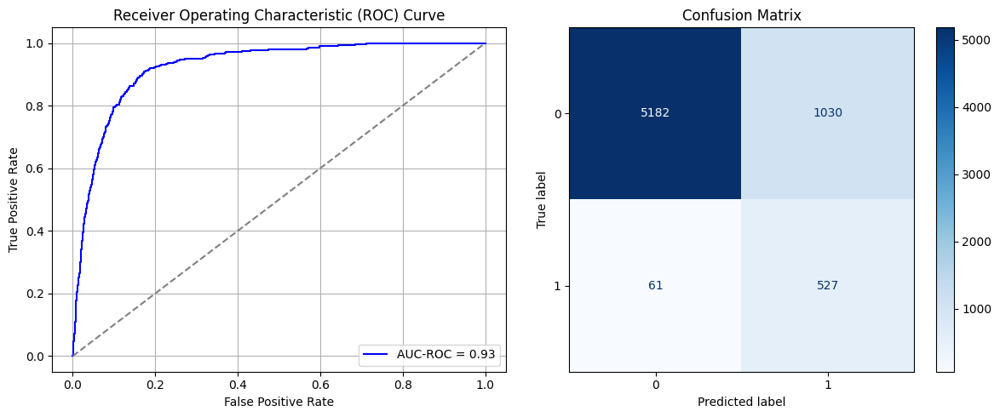

Best threshold based on F1-score: 0.7722367644309998
False Negative Rate: 0.10374149659863946
Time elapsed (performance): 0.8392646129996137
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.7815 - loss: 0.5582 - val_AUC: 0.8832 - val_loss: 0.4405
Epoch 2/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8839 - loss: 0.4312 - val_AUC: 0.8878 - val_loss: 0.4214
Epoch 3/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8884 - loss: 0.4193 - val_AUC: 0.8944 - val_loss: 0.4073
Epoch 4/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8957 - loss: 0.4052 - val_AUC: 0.8977 - val_loss: 0.4038
Epoch 5/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9001 - loss: 0.3951 - val_AUC: 0.9034 - val_loss: 0.3924
Epoch 6/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9049 - loss: 0.3843 - val_AUC: 0.9061 - val_loss: 0.3877
Epoch 7/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9095 - loss: 0.3743 - val_AUC: 0.9102 - val_loss: 0.3724
Epoch 8/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9117 - loss: 0.3690 - val_AUC: 0.9118 - val_loss: 0.3778
Epoch 9/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/st

<ipython-input-76-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
AUC-ROC: 0.9270163957405242
Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.86      0.92      6212
           1       0.36      0.88      0.52       588

    accuracy                           0.86      6800
   macro avg       0.68      0.87      0.72      6800
weighted avg       0.93      0.86      0.88      6800

FPR 0.1445589182227946 TPR: 0.8775510204081632 FNR: 0.12244897959183673 TNR: 0.8554410817772053


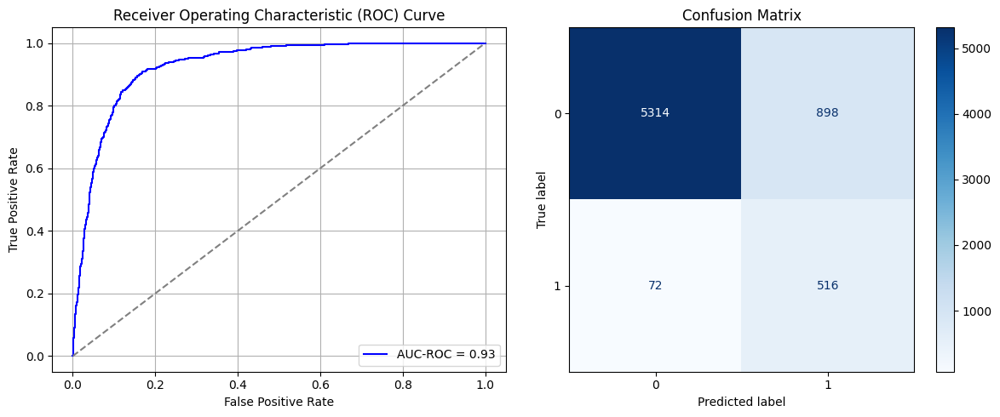

Best threshold based on F1-score: 0.9881569743156433
False Negative Rate: 0.12244897959183673
Time elapsed (performance): 1.0722172480000154
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8000 - loss: 0.5442 - val_AUC: 0.8899 - val_loss: 0.4217
Epoch 2/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - AUC: 0.8855 - loss: 0.4245 - val_AUC: 0.8978 - val_loss: 0.4056
Epoch 3/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8925 - loss: 0.4115 - val_AUC: 0.9033 - val_loss: 0.3903
Epoch 4/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9018 - loss: 0.3931 - val_AUC: 0.9063 - val_loss: 0.3862
Epoch 5/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9037 - loss: 0.3887 - val_AUC: 0.9113 - val_loss: 0.3698
Epoch 6/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9064 - loss: 0.3804 - val_AUC: 0.9141 - val_loss: 0.3761
Epoch 7/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9082 - loss: 0.3764 - val_AUC: 0.9178 - val_loss: 0.3575
Epoch 8/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9157 - loss: 0.3613 - val_AUC: 0.9179 - val_loss: 0.3550
Epoch 9/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/st

<ipython-input-76-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
AUC-ROC: 0.9290921455510729
Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.85      0.91      6212
           1       0.35      0.88      0.50       588

    accuracy                           0.85      6800
   macro avg       0.67      0.86      0.71      6800
weighted avg       0.93      0.85      0.88      6800

FPR 0.1519639407598197 TPR: 0.8758503401360545 FNR: 0.12414965986394558 TNR: 0.8480360592401803


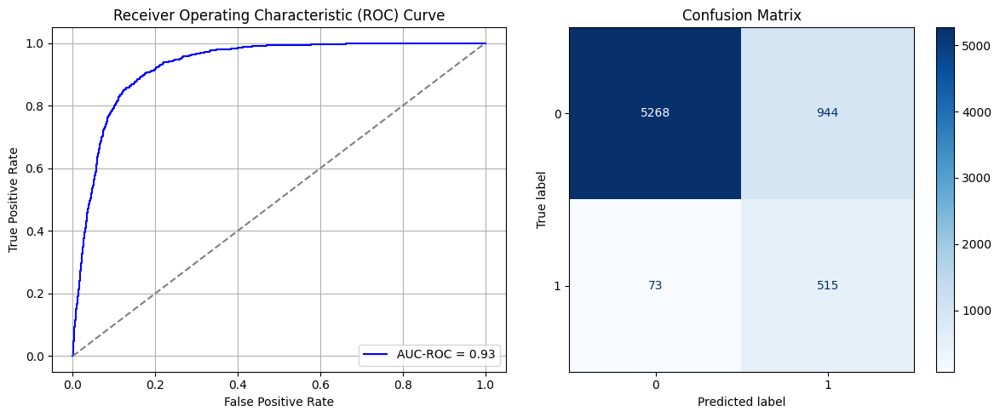

Best threshold based on F1-score: 0.7462016940116882
False Negative Rate: 0.12414965986394558
Time elapsed (performance): 1.2102616089996445
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/step - AUC: 0.7811 - loss: 0.5588 - val_AUC: 0.8874 - val_loss: 0.4243
Epoch 2/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8839 - loss: 0.4285 - val_AUC: 0.8926 - val_loss: 0.4110
Epoch 3/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8880 - loss: 0.4190 - val_AUC: 0.8990 - val_loss: 0.3967
Epoch 4/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8959 - loss: 0.4049 - val_AUC: 0.9036 - val_loss: 0.3911
Epoch 5/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8998 - loss: 0.3971 - val_AUC: 0.9069 - val_loss: 0.3847
Epoch 6/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.9059 - loss: 0.3837 - val_AUC: 0.9089 - val_loss: 0.3999
Epoch 7/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9079 - loss: 0.3805 - val_AUC: 0.9110 - val_loss: 0.3723
Epoch 8/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9104 - loss: 0.3740 - val_AUC: 0.9152 - val_loss: 0.3598
Epoch 9/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/st

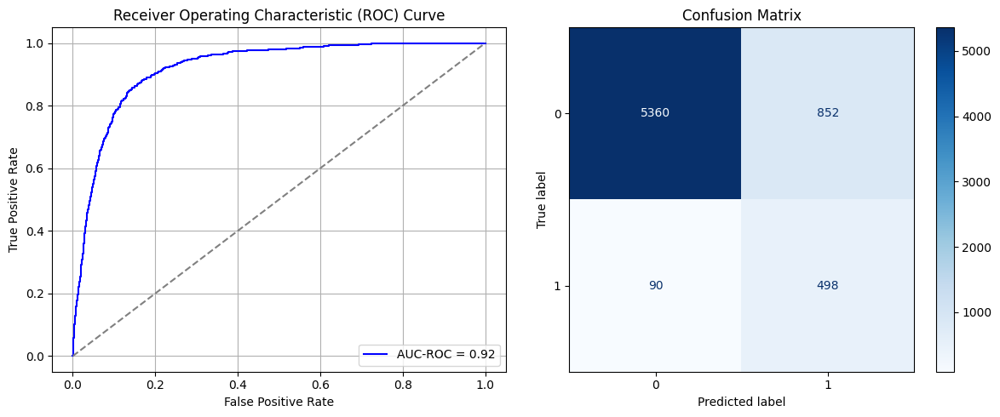

Best threshold based on F1-score: 0.7397498488426208
False Negative Rate: 0.15306122448979592
Time elapsed (performance): 1.043046028999015
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1279/1279 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - AUC: 0.7915 - loss: 0.5497 - val_AUC: 0.8892 - val_loss: 0.4235
Epoch 2/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8884 - loss: 0.4225 - val_AUC: 0.8960 - val_loss: 0.4064
Epoch 3/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8917 - loss: 0.4134 - val_AUC: 0.9015 - val_loss: 0.3933
Epoch 4/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8982 - loss: 0.4000 - val_AUC: 0.9048 - val_loss: 0.3861
Epoch 5/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 9s 3ms/step - AUC: 0.9065 - loss: 0.3825 - val_AUC: 0.9111 - val_loss: 0.3749
Epoch 6/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/step - AUC: 0.9076 - loss: 0.3802 - val_AUC: 0.9121 - val_loss: 0.3756
Epoch 7/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9105 - loss: 0.3740 - val_AUC: 0.9128 - val_loss: 0.3675
Epoch 8/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/step - AUC: 0.9142 - loss: 0.3650 - val_AUC: 0.9164 - val_loss: 0.3619
Epoch 9/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/st

<ipython-input-76-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
AUC-ROC: 0.927021597434853
Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.89      0.93      6212
           1       0.40      0.80      0.54       588

    accuracy                           0.88      6800
   macro avg       0.69      0.84      0.73      6800
weighted avg       0.93      0.88      0.90      6800

FPR 0.11123631680618158 TPR: 0.7976190476190477 FNR: 0.20238095238095238 TNR: 0.8887636831938184


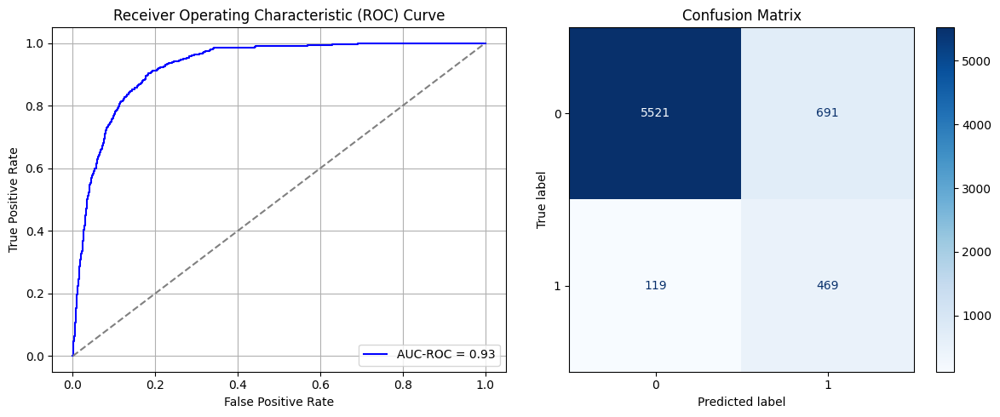

Best threshold based on F1-score: 0.6196228265762329
False Negative Rate: 0.20238095238095238
Time elapsed (performance): 1.1207075420006731
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/step - AUC: 0.7929 - loss: 0.5504 - val_AUC: 0.8842 - val_loss: 0.4447
Epoch 2/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8844 - loss: 0.4286 - val_AUC: 0.8909 - val_loss: 0.4161
Epoch 3/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8920 - loss: 0.4130 - val_AUC: 0.8964 - val_loss: 0.4036
Epoch 4/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 9s 3ms/step - AUC: 0.8959 - loss: 0.4035 - val_AUC: 0.9022 - val_loss: 0.3915
Epoch 5/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9045 - loss: 0.3875 - val_AUC: 0.9032 - val_loss: 0.4122
Epoch 6/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9067 - loss: 0.3820 - val_AUC: 0.9095 - val_loss: 0.3761
Epoch 7/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - AUC: 0.9113 - loss: 0.3714 - val_AUC: 0.9134 - val_loss: 0.3709
Epoch 8/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 8s 3ms/step - AUC: 0.9116 - loss: 0.3699 - val_AUC: 0.9151 - val_loss: 0.3644
Epoch 9/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/st

<ipython-input-76-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
AUC-ROC: 0.9247364109842263
Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.88      0.93      6212
           1       0.39      0.83      0.53       588

    accuracy                           0.87      6800
   macro avg       0.68      0.85      0.73      6800
weighted avg       0.93      0.87      0.89      6800

FPR 0.12395363811976819 TPR: 0.826530612244898 FNR: 0.17346938775510204 TNR: 0.8760463618802318


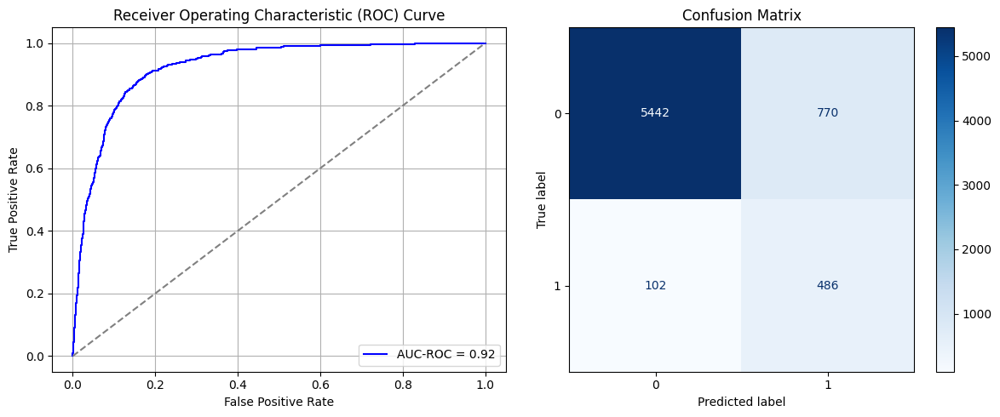

Best threshold based on F1-score: 0.6681205034255981
False Negative Rate: 0.17346938775510204
Time elapsed (performance): 1.0520604880002793
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1279/1279 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - AUC: 0.7878 - loss: 0.5520 - val_AUC: 0.8873 - val_loss: 0.4309
Epoch 2/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8867 - loss: 0.4265 - val_AUC: 0.8953 - val_loss: 0.4103
Epoch 3/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8918 - loss: 0.4135 - val_AUC: 0.9006 - val_loss: 0.4126
Epoch 4/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 8s 5ms/step - AUC: 0.8987 - loss: 0.3993 - val_AUC: 0.9045 - val_loss: 0.3993
Epoch 5/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9055 - loss: 0.3850 - val_AUC: 0.9066 - val_loss: 0.4069
Epoch 6/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9107 - loss: 0.3722 - val_AUC: 0.9125 - val_loss: 0.3728
Epoch 7/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.9119 - loss: 0.3697 - val_AUC: 0.9150 - val_loss: 0.3634
Epoch 8/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9147 - loss: 0.3629 - val_AUC: 0.9161 - val_loss: 0.3608
Epoch 9/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/st

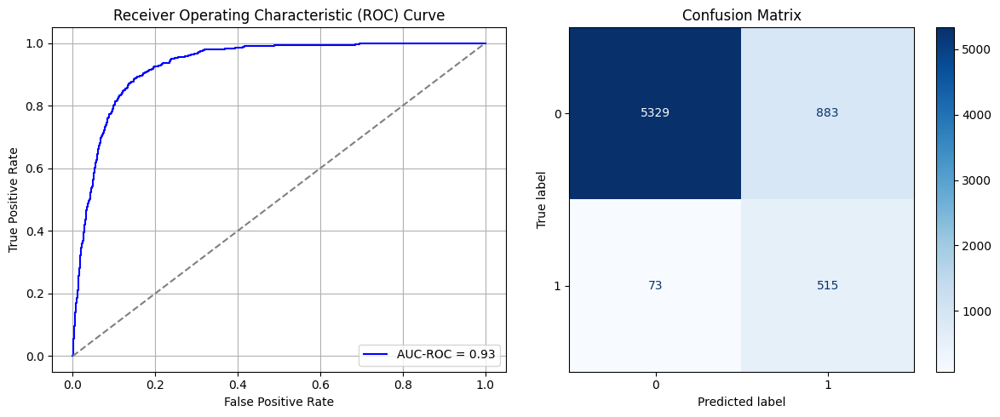

Best threshold based on F1-score: 0.7435514330863953
False Negative Rate: 0.12414965986394558
Time elapsed (performance): 0.8213470930004405
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.7969 - loss: 0.5461 - val_AUC: 0.8855 - val_loss: 0.4302
Epoch 2/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8832 - loss: 0.4307 - val_AUC: 0.8885 - val_loss: 0.4223
Epoch 3/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8907 - loss: 0.4154 - val_AUC: 0.8952 - val_loss: 0.4094
Epoch 4/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8953 - loss: 0.4069 - val_AUC: 0.9013 - val_loss: 0.3949
Epoch 5/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8998 - loss: 0.3966 - val_AUC: 0.9057 - val_loss: 0.3839
Epoch 6/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9058 - loss: 0.3840 - val_AUC: 0.9083 - val_loss: 0.3772
Epoch 7/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9123 - loss: 0.3692 - val_AUC: 0.9142 - val_loss: 0.3757
Epoch 8/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9141 - loss: 0.3655 - val_AUC: 0.9153 - val_loss: 0.3621
Epoch 9/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/st

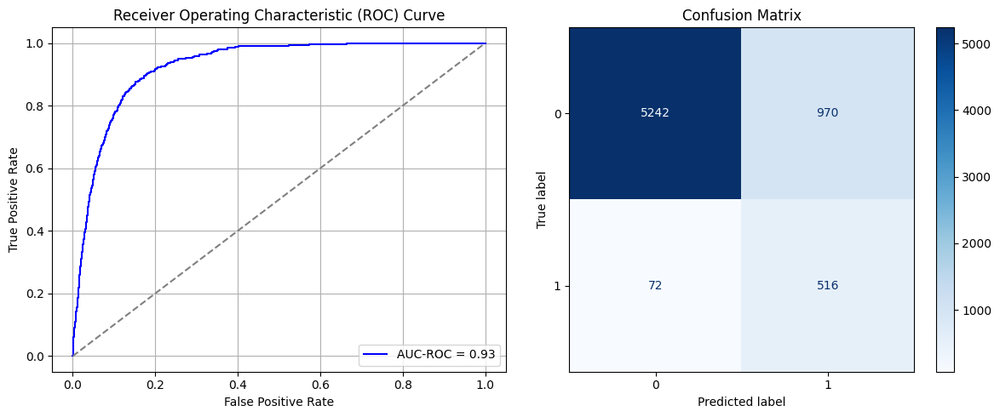

Best threshold based on F1-score: 0.7598116397857666
False Negative Rate: 0.12244897959183673
Time elapsed (performance): 1.0467101520007418
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/step - AUC: 0.7880 - loss: 0.5527 - val_AUC: 0.8875 - val_loss: 0.4428
Epoch 2/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8844 - loss: 0.4298 - val_AUC: 0.8965 - val_loss: 0.4070
Epoch 3/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 9s 3ms/step - AUC: 0.8965 - loss: 0.4054 - val_AUC: 0.9012 - val_loss: 0.4118
Epoch 4/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.9009 - loss: 0.3958 - val_AUC: 0.9043 - val_loss: 0.3908
Epoch 5/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9049 - loss: 0.3860 - val_AUC: 0.9120 - val_loss: 0.3726
Epoch 6/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.9061 - loss: 0.3829 - val_AUC: 0.9122 - val_loss: 0.3839
Epoch 7/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9097 - loss: 0.3752 - val_AUC: 0.9158 - val_loss: 0.3620
Epoch 8/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9145 - loss: 0.3636 - val_AUC: 0.9177 - val_loss: 0.3568
Epoch 9/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/st

<ipython-input-76-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
AUC-ROC: 0.9227592195925376
Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.83      0.90      6212
           1       0.33      0.89      0.49       588

    accuracy                           0.84      6800
   macro avg       0.66      0.86      0.70      6800
weighted avg       0.93      0.84      0.87      6800

FPR 0.16806181584030908 TPR: 0.8928571428571429 FNR: 0.10714285714285714 TNR: 0.8319381841596909


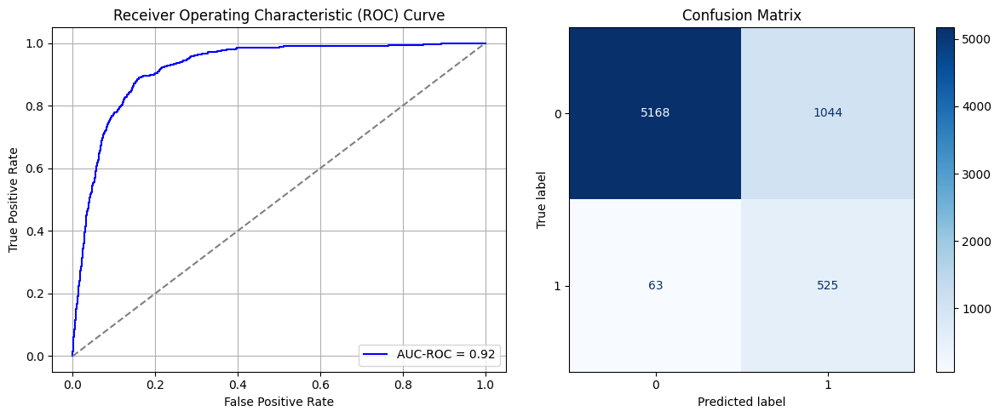

Best threshold based on F1-score: 0.7549683451652527
False Negative Rate: 0.10714285714285714
Time elapsed (performance): 0.8098322720015858
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1279/1279 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - AUC: 0.7799 - loss: 0.5608 - val_AUC: 0.8860 - val_loss: 0.4316
Epoch 2/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8814 - loss: 0.4353 - val_AUC: 0.8941 - val_loss: 0.4105
Epoch 3/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8899 - loss: 0.4176 - val_AUC: 0.8982 - val_loss: 0.4062
Epoch 4/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 8s 5ms/step - AUC: 0.8944 - loss: 0.4076 - val_AUC: 0.9030 - val_loss: 0.3915
Epoch 5/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 8s 3ms/step - AUC: 0.8990 - loss: 0.3981 - val_AUC: 0.9052 - val_loss: 0.4053
Epoch 6/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - AUC: 0.9031 - loss: 0.3889 - val_AUC: 0.9103 - val_loss: 0.3748
Epoch 7/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 8s 3ms/step - AUC: 0.9082 - loss: 0.3793 - val_AUC: 0.9134 - val_loss: 0.3895
Epoch 8/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.9086 - loss: 0.3776 - val_AUC: 0.9158 - val_loss: 0.3635
Epoch 9/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/st

<ipython-input-76-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
AUC-ROC: 0.9263117030456742
Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.85      0.91      6212
           1       0.36      0.88      0.51       588

    accuracy                           0.85      6800
   macro avg       0.67      0.87      0.71      6800
weighted avg       0.93      0.85      0.88      6800

FPR 0.15003219575016097 TPR: 0.8826530612244898 FNR: 0.11734693877551021 TNR: 0.8499678042498391


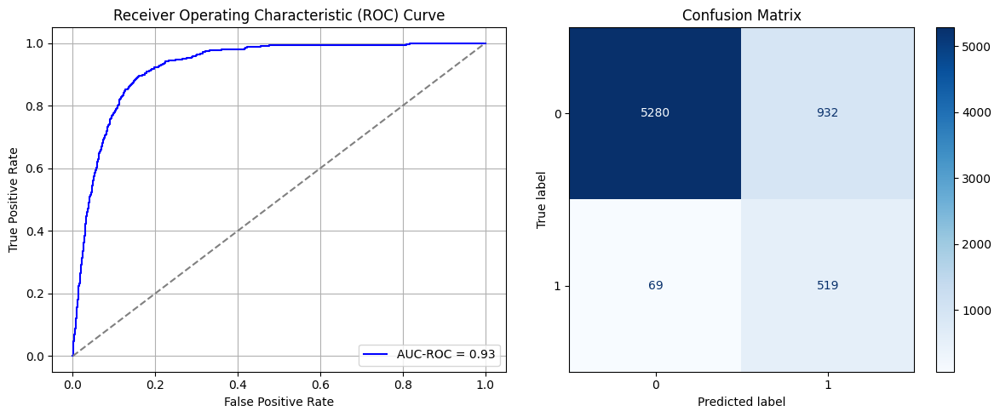

Best threshold based on F1-score: 0.7375343441963196
False Negative Rate: 0.11734693877551021
Time elapsed (performance): 0.81775941900014
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/step - AUC: 0.7950 - loss: 0.5493 - val_AUC: 0.8851 - val_loss: 0.4275
Epoch 2/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8879 - loss: 0.4212 - val_AUC: 0.8907 - val_loss: 0.4160
Epoch 3/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8917 - loss: 0.4127 - val_AUC: 0.8979 - val_loss: 0.4013
Epoch 4/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8958 - loss: 0.4039 - val_AUC: 0.9039 - val_loss: 0.3905
Epoch 5/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.9037 - loss: 0.3875 - val_AUC: 0.9084 - val_loss: 0.3787
Epoch 6/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9073 - loss: 0.3798 - val_AUC: 0.9102 - val_loss: 0.3736
Epoch 7/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9097 - loss: 0.3741 - val_AUC: 0.9107 - val_loss: 0.3840
Epoch 8/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.9117 - loss: 0.3679 - val_AUC: 0.9145 - val_loss: 0.3633
Epoch 9/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/st

<ipython-input-76-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
AUC-ROC: 0.9274158311102934
Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.86      0.92      6212
           1       0.36      0.86      0.51       588

    accuracy                           0.86      6800
   macro avg       0.67      0.86      0.71      6800
weighted avg       0.93      0.86      0.88      6800

FPR 0.1447198969735995 TPR: 0.8571428571428572 FNR: 0.14285714285714285 TNR: 0.8552801030264006


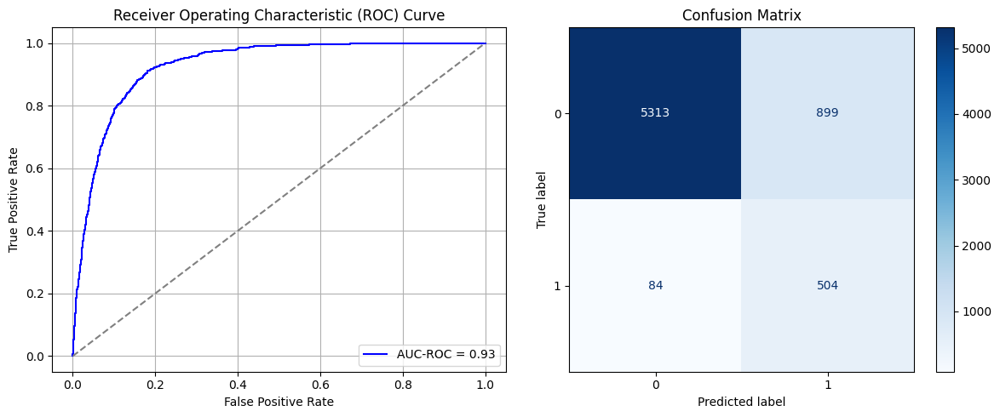

Best threshold based on F1-score: 0.744433581829071
False Negative Rate: 0.14285714285714285
Time elapsed (performance): 0.801291322999532
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/step - AUC: 0.7878 - loss: 0.5549 - val_AUC: 0.8860 - val_loss: 0.4357
Epoch 2/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8848 - loss: 0.4329 - val_AUC: 0.8909 - val_loss: 0.4196
Epoch 3/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 9s 3ms/step - AUC: 0.8910 - loss: 0.4177 - val_AUC: 0.8964 - val_loss: 0.4053
Epoch 4/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8961 - loss: 0.4053 - val_AUC: 0.9017 - val_loss: 0.3946
Epoch 5/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 9s 3ms/step - AUC: 0.9003 - loss: 0.3964 - val_AUC: 0.9058 - val_loss: 0.3864
Epoch 6/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9059 - loss: 0.3840 - val_AUC: 0.9111 - val_loss: 0.3764
Epoch 7/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9130 - loss: 0.3700 - val_AUC: 0.9097 - val_loss: 0.3909
Epoch 8/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9140 - loss: 0.3670 - val_AUC: 0.9157 - val_loss: 0.3616
Epoch 9/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/st

<ipython-input-76-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
AUC-ROC: 0.9233122418316974
Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.89      0.93      6212
           1       0.41      0.78      0.54       588

    accuracy                           0.88      6800
   macro avg       0.69      0.84      0.74      6800
weighted avg       0.93      0.88      0.90      6800

FPR 0.10656793303283967 TPR: 0.7840136054421769 FNR: 0.21598639455782312 TNR: 0.8934320669671604


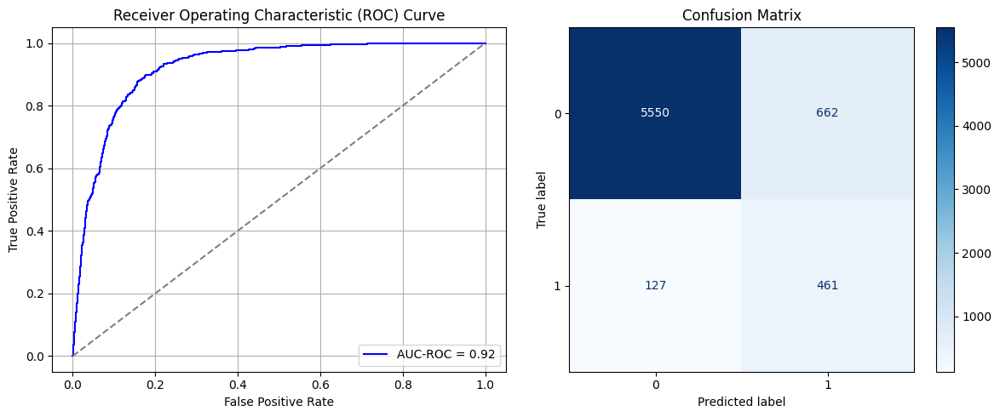

Best threshold based on F1-score: 0.6156723499298096
False Negative Rate: 0.21598639455782312
Time elapsed (performance): 1.039177048000056
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1279/1279 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - AUC: 0.7820 - loss: 0.5532 - val_AUC: 0.8863 - val_loss: 0.4275
Epoch 2/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 9s 3ms/step - AUC: 0.8831 - loss: 0.4300 - val_AUC: 0.8923 - val_loss: 0.4191
Epoch 3/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8913 - loss: 0.4136 - val_AUC: 0.8967 - val_loss: 0.4017
Epoch 4/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 10s 4ms/step - AUC: 0.8963 - loss: 0.4020 - val_AUC: 0.8987 - val_loss: 0.3975
Epoch 5/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9000 - loss: 0.3948 - val_AUC: 0.9016 - val_loss: 0.3902
Epoch 6/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9046 - loss: 0.3861 - val_AUC: 0.9052 - val_loss: 0.3851
Epoch 7/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - AUC: 0.9064 - loss: 0.3819 - val_AUC: 0.9062 - val_loss: 0.3805
Epoch 8/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 9s 3ms/step - AUC: 0.9076 - loss: 0.3785 - val_AUC: 0.9081 - val_loss: 0.3785
Epoch 9/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/s

<ipython-input-76-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
AUC-ROC: 0.9255580049147798
Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.86      0.92      6212
           1       0.37      0.86      0.52       588

    accuracy                           0.86      6800
   macro avg       0.68      0.86      0.72      6800
weighted avg       0.93      0.86      0.89      6800

FPR 0.13763683193818416 TPR: 0.8622448979591837 FNR: 0.1377551020408163 TNR: 0.8623631680618158


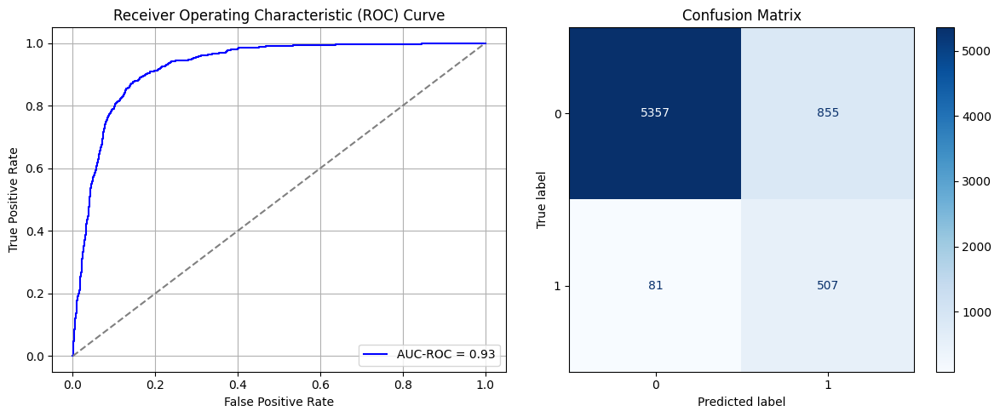

Best threshold based on F1-score: 0.6772854924201965
False Negative Rate: 0.1377551020408163
Time elapsed (performance): 1.18771813100102
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/step - AUC: 0.7783 - loss: 0.5635 - val_AUC: 0.8880 - val_loss: 0.4279
Epoch 2/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8840 - loss: 0.4305 - val_AUC: 0.8973 - val_loss: 0.4090
Epoch 3/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8933 - loss: 0.4110 - val_AUC: 0.9033 - val_loss: 0.3927
Epoch 4/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9022 - loss: 0.3942 - val_AUC: 0.9075 - val_loss: 0.3866
Epoch 5/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9061 - loss: 0.3847 - val_AUC: 0.9103 - val_loss: 0.3749
Epoch 6/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9060 - loss: 0.3848 - val_AUC: 0.9141 - val_loss: 0.3653
Epoch 7/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9121 - loss: 0.3707 - val_AUC: 0.9158 - val_loss: 0.3609
Epoch 8/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - AUC: 0.9129 - loss: 0.3680 - val_AUC: 0.9183 - val_loss: 0.3553
Epoch 9/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/st

<ipython-input-76-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
AUC-ROC: 0.9170754103315505
Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.84      0.91      6212
           1       0.34      0.85      0.48       588

    accuracy                           0.84      6800
   macro avg       0.66      0.85      0.69      6800
weighted avg       0.93      0.84      0.87      6800

FPR 0.15936896329684483 TPR: 0.8520408163265306 FNR: 0.14795918367346939 TNR: 0.8406310367031552


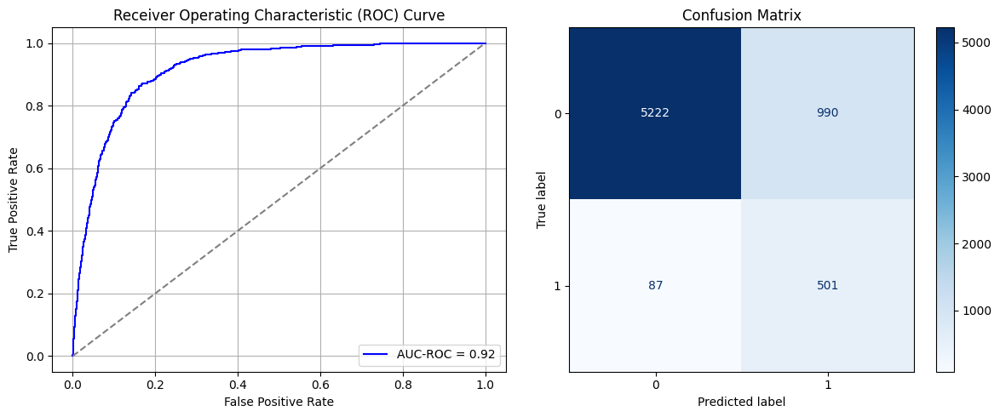

Best threshold based on F1-score: 0.7654193043708801
False Negative Rate: 0.14795918367346939
Time elapsed (performance): 1.7171756369989453
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/step - AUC: 0.7822 - loss: 0.5560 - val_AUC: 0.8889 - val_loss: 0.4291
Epoch 2/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8837 - loss: 0.4301 - val_AUC: 0.8931 - val_loss: 0.4157
Epoch 3/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 9s 3ms/step - AUC: 0.8928 - loss: 0.4115 - val_AUC: 0.9007 - val_loss: 0.3963
Epoch 4/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8974 - loss: 0.4017 - val_AUC: 0.9044 - val_loss: 0.3869
Epoch 5/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9008 - loss: 0.3944 - val_AUC: 0.9079 - val_loss: 0.3910
Epoch 6/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9071 - loss: 0.3826 - val_AUC: 0.9121 - val_loss: 0.3758
Epoch 7/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.9114 - loss: 0.3727 - val_AUC: 0.9151 - val_loss: 0.3721
Epoch 8/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9129 - loss: 0.3689 - val_AUC: 0.9175 - val_loss: 0.3575
Epoch 9/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/st

<ipython-input-76-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
AUC-ROC: 0.9284509682817106
Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.89      0.93      6212
           1       0.41      0.78      0.54       588

    accuracy                           0.88      6800
   macro avg       0.69      0.84      0.73      6800
weighted avg       0.93      0.88      0.90      6800

FPR 0.10769478428847393 TPR: 0.782312925170068 FNR: 0.21768707482993196 TNR: 0.8923052157115261


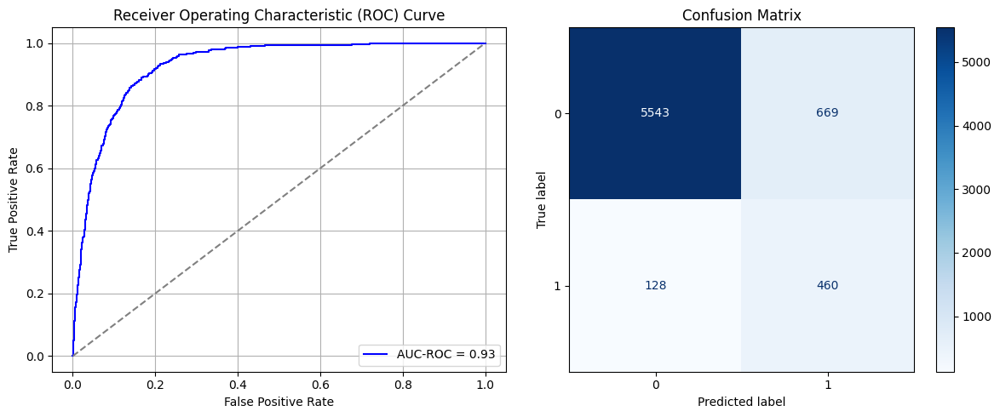

Best threshold based on F1-score: 0.9896990060806274
False Negative Rate: 0.21768707482993196
Time elapsed (performance): 1.0278191630004585
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/step - AUC: 0.7912 - loss: 0.5524 - val_AUC: 0.8866 - val_loss: 0.4285
Epoch 2/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8842 - loss: 0.4284 - val_AUC: 0.8924 - val_loss: 0.4124
Epoch 3/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 8s 3ms/step - AUC: 0.8908 - loss: 0.4138 - val_AUC: 0.8982 - val_loss: 0.3993
Epoch 4/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - AUC: 0.8960 - loss: 0.4037 - val_AUC: 0.9021 - val_loss: 0.3955
Epoch 5/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9030 - loss: 0.3896 - val_AUC: 0.9061 - val_loss: 0.3962
Epoch 6/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9068 - loss: 0.3812 - val_AUC: 0.9104 - val_loss: 0.3729
Epoch 7/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.9104 - loss: 0.3726 - val_AUC: 0.9120 - val_loss: 0.3684
Epoch 8/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9107 - loss: 0.3710 - val_AUC: 0.9132 - val_loss: 0.3648
Epoch 9/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/st

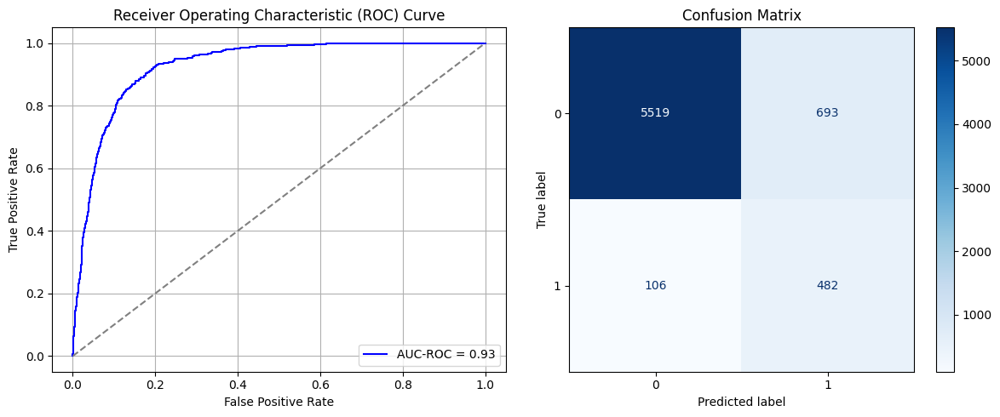

Best threshold based on F1-score: 0.6522173881530762
False Negative Rate: 0.18027210884353742
Time elapsed (performance): 1.0533920699999726
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1279/1279 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - AUC: 0.7873 - loss: 0.5491 - val_AUC: 0.8851 - val_loss: 0.4343
Epoch 2/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 9s 3ms/step - AUC: 0.8877 - loss: 0.4209 - val_AUC: 0.8917 - val_loss: 0.4174
Epoch 3/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - AUC: 0.8962 - loss: 0.4046 - val_AUC: 0.8969 - val_loss: 0.4020
Epoch 4/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 8s 3ms/step - AUC: 0.8993 - loss: 0.3973 - val_AUC: 0.9021 - val_loss: 0.3919
Epoch 5/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.9008 - loss: 0.3928 - val_AUC: 0.9061 - val_loss: 0.3845
Epoch 6/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.9070 - loss: 0.3803 - val_AUC: 0.9084 - val_loss: 0.3764
Epoch 7/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9086 - loss: 0.3754 - val_AUC: 0.9108 - val_loss: 0.3708
Epoch 8/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9139 - loss: 0.3642 - val_AUC: 0.9140 - val_loss: 0.3632
Epoch 9/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/st

<ipython-input-76-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
AUC-ROC: 0.9298461174553531
Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.86      0.92      6212
           1       0.37      0.87      0.52       588

    accuracy                           0.86      6800
   macro avg       0.68      0.87      0.72      6800
weighted avg       0.93      0.86      0.89      6800

FPR 0.13844172569220864 TPR: 0.8707482993197279 FNR: 0.1292517006802721 TNR: 0.8615582743077914


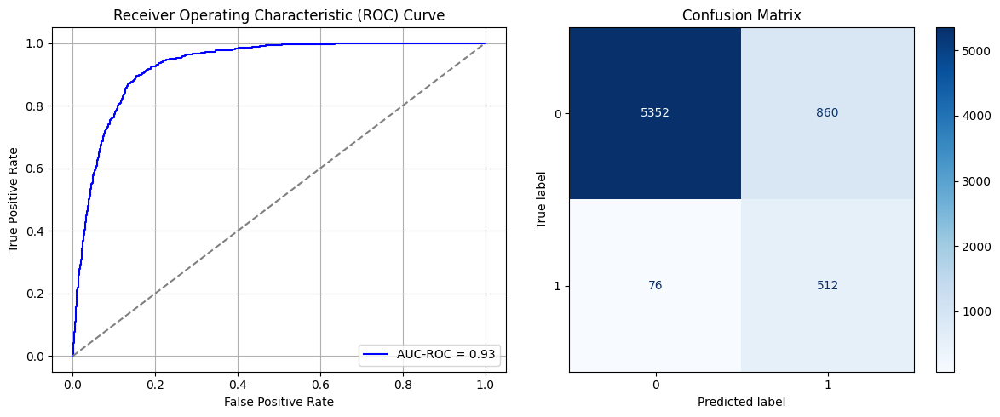

Best threshold based on F1-score: 0.730378270149231
False Negative Rate: 0.1292517006802721
Time elapsed (performance): 1.0257408279994706
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/step - AUC: 0.7802 - loss: 0.5589 - val_AUC: 0.8853 - val_loss: 0.4349
Epoch 2/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8852 - loss: 0.4312 - val_AUC: 0.8918 - val_loss: 0.4175
Epoch 3/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8896 - loss: 0.4186 - val_AUC: 0.8958 - val_loss: 0.4092
Epoch 4/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8932 - loss: 0.4109 - val_AUC: 0.9000 - val_loss: 0.3971
Epoch 5/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8965 - loss: 0.4025 - val_AUC: 0.9053 - val_loss: 0.3963
Epoch 6/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9006 - loss: 0.3941 - val_AUC: 0.9085 - val_loss: 0.3805
Epoch 7/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.9070 - loss: 0.3813 - val_AUC: 0.9091 - val_loss: 0.3758
Epoch 8/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9118 - loss: 0.3724 - val_AUC: 0.9117 - val_loss: 0.3741
Epoch 9/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/st

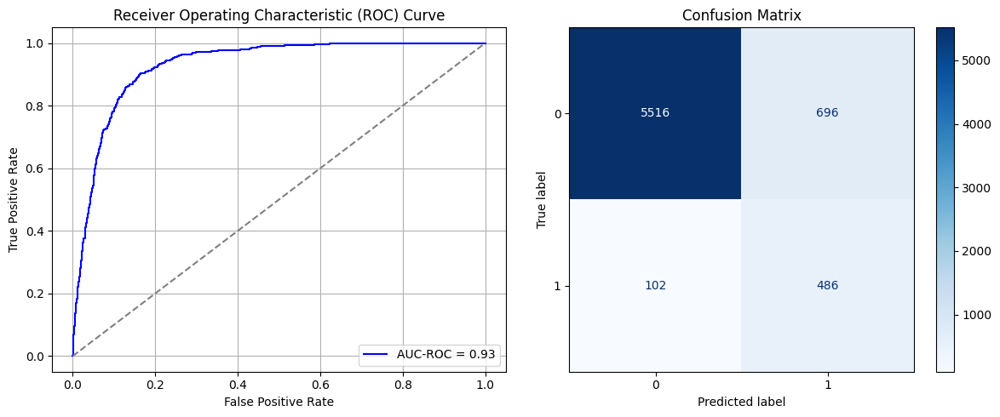

Best threshold based on F1-score: 0.6669421792030334
False Negative Rate: 0.17346938775510204
Time elapsed (performance): 1.064994550000847
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/step - AUC: 0.7771 - loss: 0.5616 - val_AUC: 0.8848 - val_loss: 0.4365
Epoch 2/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8797 - loss: 0.4379 - val_AUC: 0.8918 - val_loss: 0.4178
Epoch 3/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 9s 3ms/step - AUC: 0.8907 - loss: 0.4173 - val_AUC: 0.8999 - val_loss: 0.3989
Epoch 4/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9003 - loss: 0.3976 - val_AUC: 0.9043 - val_loss: 0.3897
Epoch 5/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9047 - loss: 0.3859 - val_AUC: 0.9072 - val_loss: 0.3828
Epoch 6/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9076 - loss: 0.3796 - val_AUC: 0.9131 - val_loss: 0.3711
Epoch 7/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.9125 - loss: 0.3678 - val_AUC: 0.9147 - val_loss: 0.3677
Epoch 8/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 10s 4ms/step - AUC: 0.9156 - loss: 0.3620 - val_AUC: 0.9156 - val_loss: 0.3637
Epoch 9/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/s

<ipython-input-76-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
AUC-ROC: 0.929681305877148
Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.87      0.92      6212
           1       0.38      0.86      0.53       588

    accuracy                           0.87      6800
   macro avg       0.68      0.87      0.73      6800
weighted avg       0.93      0.87      0.89      6800

FPR 0.1311976819059884 TPR: 0.8622448979591837 FNR: 0.1377551020408163 TNR: 0.8688023180940116


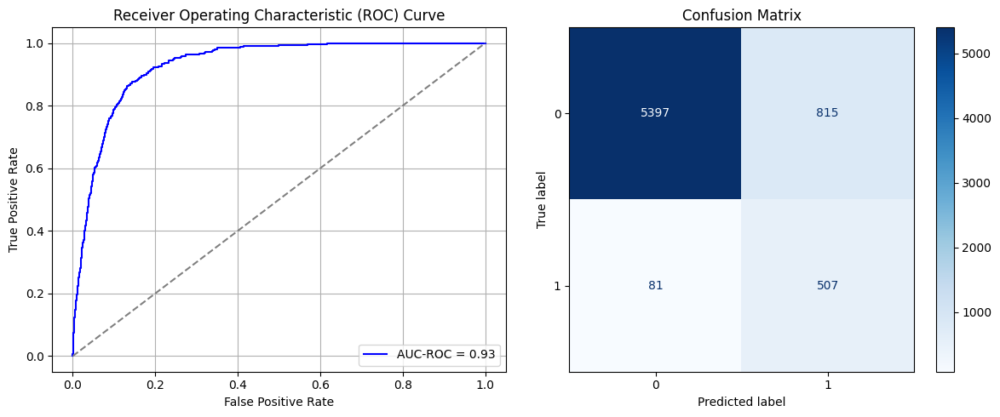

Best threshold based on F1-score: 0.6533302664756775
False Negative Rate: 0.1377551020408163
Time elapsed (performance): 0.8446631070000876
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1279/1279 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - AUC: 0.7885 - loss: 0.5513 - val_AUC: 0.8861 - val_loss: 0.4352
Epoch 2/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8809 - loss: 0.4347 - val_AUC: 0.8911 - val_loss: 0.4171
Epoch 3/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8857 - loss: 0.4253 - val_AUC: 0.8955 - val_loss: 0.4089
Epoch 4/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 9s 3ms/step - AUC: 0.8929 - loss: 0.4105 - val_AUC: 0.8992 - val_loss: 0.3982
Epoch 5/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8928 - loss: 0.4079 - val_AUC: 0.9035 - val_loss: 0.3874
Epoch 6/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 9s 3ms/step - AUC: 0.8980 - loss: 0.3981 - val_AUC: 0.9062 - val_loss: 0.3843
Epoch 7/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.9029 - loss: 0.3880 - val_AUC: 0.9117 - val_loss: 0.3706
Epoch 8/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9038 - loss: 0.3852 - val_AUC: 0.9131 - val_loss: 0.3668
Epoch 9/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/st

<ipython-input-76-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
AUC-ROC: 0.924077438444792
Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.87      0.92      6212
           1       0.38      0.85      0.52       588

    accuracy                           0.87      6800
   macro avg       0.68      0.86      0.72      6800
weighted avg       0.93      0.87      0.89      6800

FPR 0.131841596909208 TPR: 0.8486394557823129 FNR: 0.15136054421768708 TNR: 0.8681584030907921


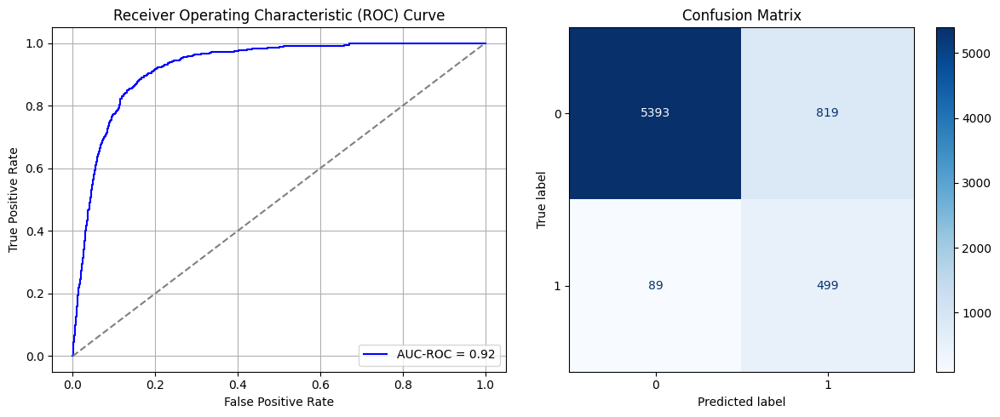

Best threshold based on F1-score: 0.9887380003929138
False Negative Rate: 0.15136054421768708
Time elapsed (performance): 0.8800390659998811
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1279/1279 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - AUC: 0.7913 - loss: 0.5500 - val_AUC: 0.8834 - val_loss: 0.4326
Epoch 2/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8860 - loss: 0.4265 - val_AUC: 0.8915 - val_loss: 0.4154
Epoch 3/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8900 - loss: 0.4169 - val_AUC: 0.8940 - val_loss: 0.4097
Epoch 4/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8937 - loss: 0.4093 - val_AUC: 0.8986 - val_loss: 0.4049
Epoch 5/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 9s 3ms/step - AUC: 0.8979 - loss: 0.4003 - val_AUC: 0.9029 - val_loss: 0.3993
Epoch 6/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - AUC: 0.9020 - loss: 0.3929 - val_AUC: 0.9076 - val_loss: 0.3903
Epoch 7/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 9s 3ms/step - AUC: 0.9045 - loss: 0.3858 - val_AUC: 0.9084 - val_loss: 0.3791
Epoch 8/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - AUC: 0.9105 - loss: 0.3739 - val_AUC: 0.9110 - val_loss: 0.3716
Epoch 9/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/st

<ipython-input-76-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
AUC-ROC: 0.9266985448397002
Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.88      0.93      6212
           1       0.39      0.80      0.52       588

    accuracy                           0.87      6800
   macro avg       0.68      0.84      0.73      6800
weighted avg       0.93      0.87      0.89      6800

FPR 0.11944623309723117 TPR: 0.804421768707483 FNR: 0.195578231292517 TNR: 0.8805537669027689


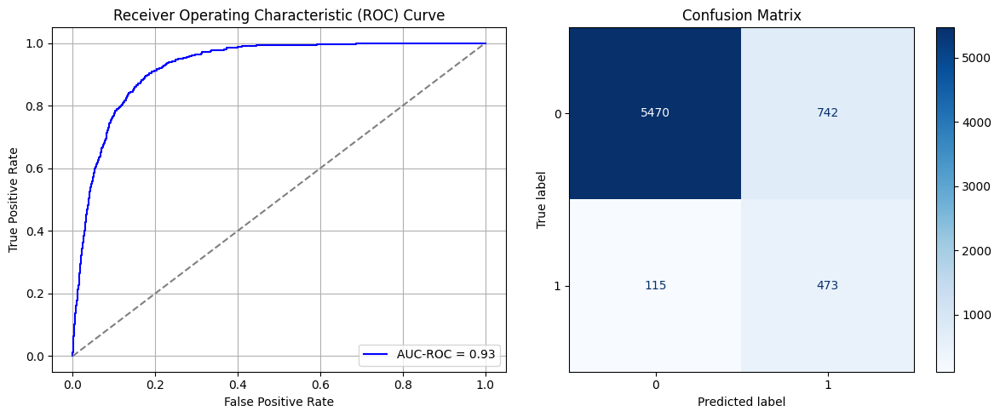

Best threshold based on F1-score: 0.6072978973388672
False Negative Rate: 0.195578231292517
Time elapsed (performance): 1.3047693759999675
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/step - AUC: 0.7962 - loss: 0.5472 - val_AUC: 0.8841 - val_loss: 0.4319
Epoch 2/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8825 - loss: 0.4320 - val_AUC: 0.8880 - val_loss: 0.4315
Epoch 3/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8867 - loss: 0.4236 - val_AUC: 0.8944 - val_loss: 0.4272
Epoch 4/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8967 - loss: 0.4030 - val_AUC: 0.9006 - val_loss: 0.4030
Epoch 5/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8973 - loss: 0.4007 - val_AUC: 0.9035 - val_loss: 0.3894
Epoch 6/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9036 - loss: 0.3880 - val_AUC: 0.9072 - val_loss: 0.3804
Epoch 7/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9081 - loss: 0.3780 - val_AUC: 0.9103 - val_loss: 0.3779
Epoch 8/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.9094 - loss: 0.3771 - val_AUC: 0.9110 - val_loss: 0.3701
Epoch 9/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/st

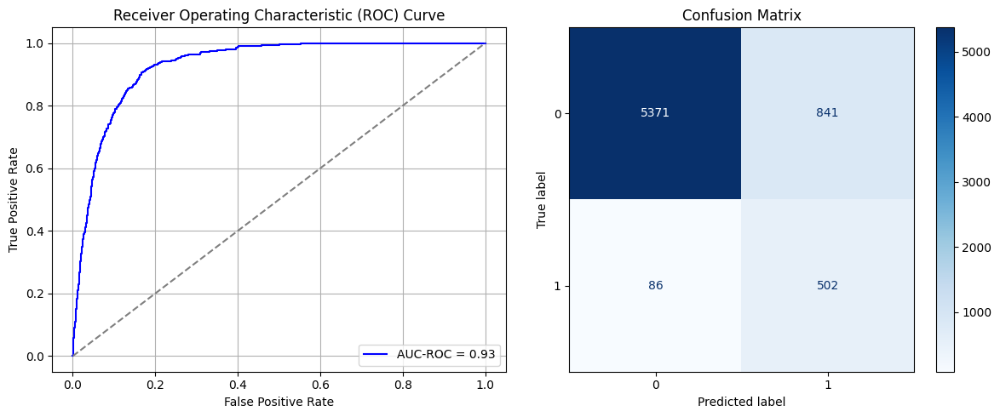

Best threshold based on F1-score: 0.9872663617134094
False Negative Rate: 0.14625850340136054
Time elapsed (performance): 1.101660839998658
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.7954 - loss: 0.5444 - val_AUC: 0.8828 - val_loss: 0.4320
Epoch 2/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8864 - loss: 0.4243 - val_AUC: 0.8890 - val_loss: 0.4182
Epoch 3/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 9s 3ms/step - AUC: 0.8920 - loss: 0.4119 - val_AUC: 0.8957 - val_loss: 0.4063
Epoch 4/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8957 - loss: 0.4046 - val_AUC: 0.8980 - val_loss: 0.3975
Epoch 5/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9005 - loss: 0.3947 - val_AUC: 0.9013 - val_loss: 0.3914
Epoch 6/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9058 - loss: 0.3841 - val_AUC: 0.9077 - val_loss: 0.3789
Epoch 7/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.9068 - loss: 0.3805 - val_AUC: 0.9112 - val_loss: 0.3723
Epoch 8/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 9s 3ms/step - AUC: 0.9136 - loss: 0.3663 - val_AUC: 0.9120 - val_loss: 0.3690
Epoch 9/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/st

<ipython-input-76-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
AUC-ROC: 0.9320850362037926
Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.84      0.91      6212
           1       0.35      0.90      0.50       588

    accuracy                           0.85      6800
   macro avg       0.67      0.87      0.71      6800
weighted avg       0.93      0.85      0.87      6800

FPR 0.15792015453960076 TPR: 0.8962585034013606 FNR: 0.10374149659863946 TNR: 0.8420798454603993


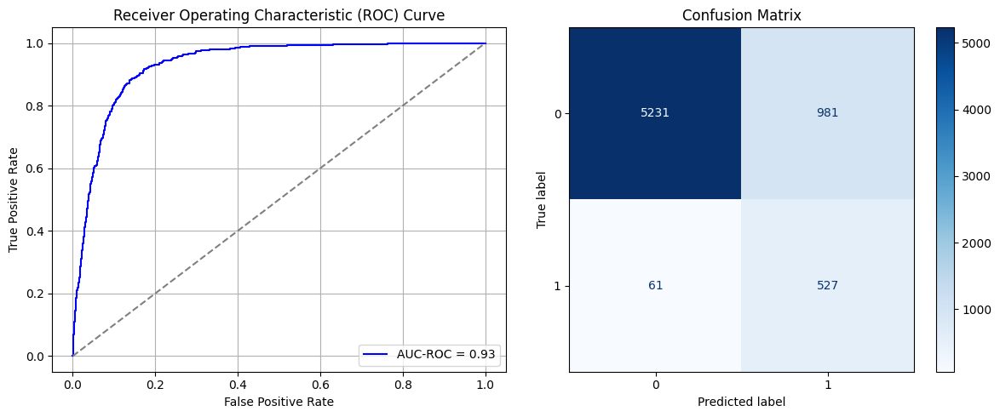

Best threshold based on F1-score: 0.9881823062896729
False Negative Rate: 0.10374149659863946
Time elapsed (performance): 1.3354908990004333
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.7970 - loss: 0.5462 - val_AUC: 0.8881 - val_loss: 0.4274
Epoch 2/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8807 - loss: 0.4372 - val_AUC: 0.8934 - val_loss: 0.4167
Epoch 3/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8905 - loss: 0.4161 - val_AUC: 0.8996 - val_loss: 0.4079
Epoch 4/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8998 - loss: 0.3981 - val_AUC: 0.9065 - val_loss: 0.3852
Epoch 5/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9076 - loss: 0.3816 - val_AUC: 0.9114 - val_loss: 0.3750
Epoch 6/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9089 - loss: 0.3779 - val_AUC: 0.9151 - val_loss: 0.3693
Epoch 7/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9127 - loss: 0.3696 - val_AUC: 0.9173 - val_loss: 0.3623
Epoch 8/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - AUC: 0.9162 - loss: 0.3617 - val_AUC: 0.9176 - val_loss: 0.3555
Epoch 9/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 8s 3ms/st

<ipython-input-76-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
AUC-ROC: 0.9331413908126032
Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.83      0.90      6212
           1       0.34      0.91      0.49       588

    accuracy                           0.84      6800
   macro avg       0.66      0.87      0.70      6800
weighted avg       0.93      0.84      0.87      6800

FPR 0.17128139085640695 TPR: 0.9132653061224489 FNR: 0.08673469387755102 TNR: 0.8287186091435931


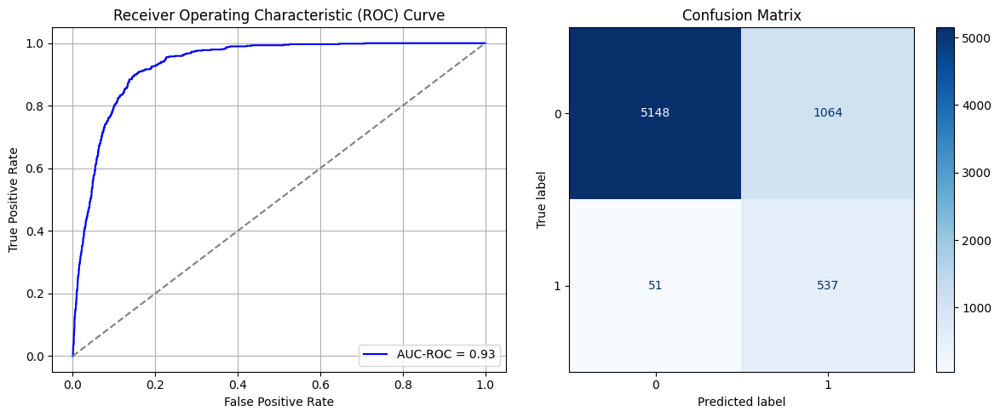

Best threshold based on F1-score: 0.7657292485237122
False Negative Rate: 0.08673469387755102
Time elapsed (performance): 0.9123316179993708
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/step - AUC: 0.7900 - loss: 0.5527 - val_AUC: 0.8835 - val_loss: 0.4361
Epoch 2/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8819 - loss: 0.4333 - val_AUC: 0.8885 - val_loss: 0.4364
Epoch 3/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 9s 3ms/step - AUC: 0.8901 - loss: 0.4158 - val_AUC: 0.8961 - val_loss: 0.4058
Epoch 4/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - AUC: 0.8955 - loss: 0.4043 - val_AUC: 0.9024 - val_loss: 0.3888
Epoch 5/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9032 - loss: 0.3883 - val_AUC: 0.9055 - val_loss: 0.3841
Epoch 6/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9056 - loss: 0.3822 - val_AUC: 0.9086 - val_loss: 0.3948
Epoch 7/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.9087 - loss: 0.3761 - val_AUC: 0.9116 - val_loss: 0.3730
Epoch 8/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9107 - loss: 0.3715 - val_AUC: 0.9138 - val_loss: 0.3662
Epoch 9/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/st

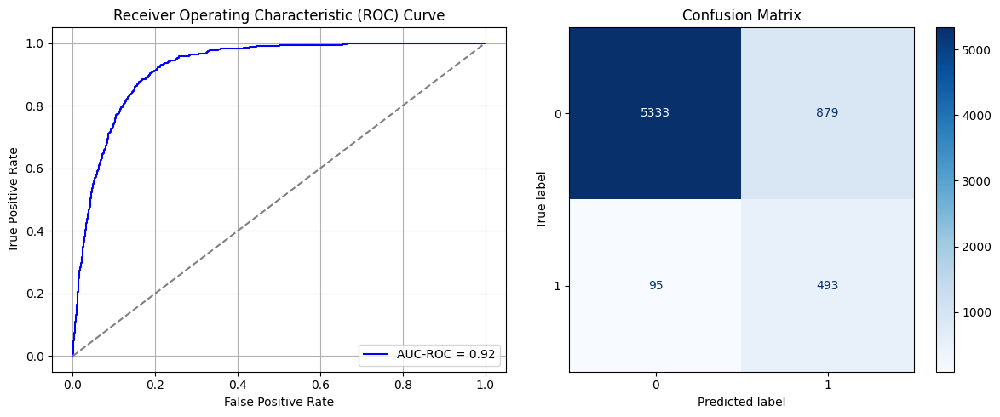

Best threshold based on F1-score: 0.6732211112976074
False Negative Rate: 0.16156462585034015
Time elapsed (performance): 6.061609333999513
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1279/1279 ━━━━━━━━━━━━━━━━━━━━ 8s 5ms/step - AUC: 0.7960 - loss: 0.5467 - val_AUC: 0.8852 - val_loss: 0.4280
Epoch 2/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8887 - loss: 0.4203 - val_AUC: 0.8918 - val_loss: 0.4154
Epoch 3/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 12s 5ms/step - AUC: 0.8947 - loss: 0.4073 - val_AUC: 0.8958 - val_loss: 0.4051
Epoch 4/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8969 - loss: 0.4033 - val_AUC: 0.8973 - val_loss: 0.4002
Epoch 5/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 11s 4ms/step - AUC: 0.8999 - loss: 0.3969 - val_AUC: 0.9028 - val_loss: 0.3896
Epoch 6/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9050 - loss: 0.3864 - val_AUC: 0.9052 - val_loss: 0.3899
Epoch 7/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 10s 4ms/step - AUC: 0.9059 - loss: 0.3842 - val_AUC: 0.9077 - val_loss: 0.3830
Epoch 8/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.9097 - loss: 0.3766 - val_AUC: 0.9088 - val_loss: 0.3962
Epoch 9/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms

<ipython-input-76-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
AUC-ROC: 0.9339598363492209
Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.81      0.89      6212
           1       0.32      0.93      0.47       588

    accuracy                           0.82      6800
   macro avg       0.66      0.87      0.68      6800
weighted avg       0.93      0.82      0.86      6800

FPR 0.18721828718609143 TPR: 0.9268707482993197 FNR: 0.07312925170068027 TNR: 0.8127817128139085


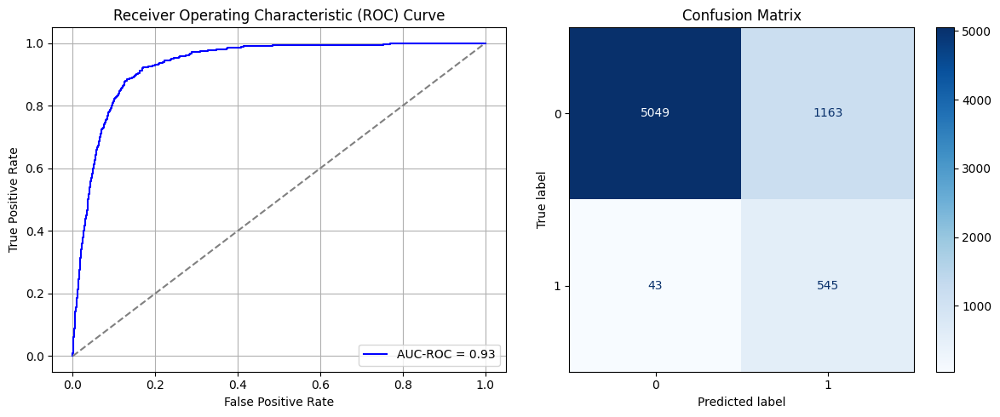

Best threshold based on F1-score: 0.78464674949646
False Negative Rate: 0.07312925170068027
Time elapsed (performance): 0.9496688540002651
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1279/1279 ━━━━━━━━━━━━━━━━━━━━ 8s 5ms/step - AUC: 0.7719 - loss: 0.5613 - val_AUC: 0.8862 - val_loss: 0.4292
Epoch 2/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - AUC: 0.8803 - loss: 0.4364 - val_AUC: 0.8927 - val_loss: 0.4152
Epoch 3/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - AUC: 0.8922 - loss: 0.4123 - val_AUC: 0.8978 - val_loss: 0.4080
Epoch 4/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - AUC: 0.8908 - loss: 0.4144 - val_AUC: 0.9009 - val_loss: 0.3936
Epoch 5/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8979 - loss: 0.4004 - val_AUC: 0.9068 - val_loss: 0.3834
Epoch 6/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - AUC: 0.9029 - loss: 0.3904 - val_AUC: 0.9076 - val_loss: 0.3838
Epoch 7/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 9s 5ms/step - AUC: 0.9069 - loss: 0.3816 - val_AUC: 0.9104 - val_loss: 0.3723
Epoch 8/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 11s 5ms/step - AUC: 0.9093 - loss: 0.3758 - val_AUC: 0.9146 - val_loss: 0.3711
Epoch 9/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/s

<ipython-input-76-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
AUC-ROC: 0.9298047776741091
Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.83      0.90      6212
           1       0.33      0.90      0.49       588

    accuracy                           0.84      6800
   macro avg       0.66      0.86      0.69      6800
weighted avg       0.93      0.84      0.87      6800

FPR 0.1703155183515776 TPR: 0.8996598639455782 FNR: 0.10034013605442177 TNR: 0.8296844816484223


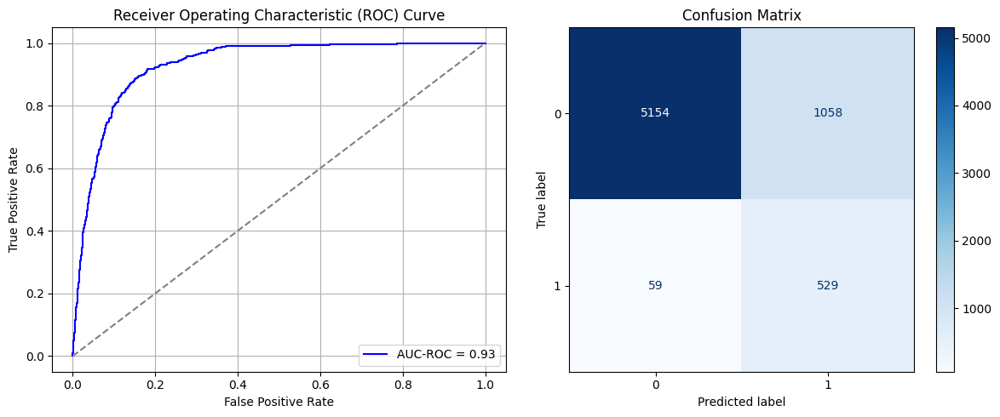

Best threshold based on F1-score: 0.7628999948501587
False Negative Rate: 0.10034013605442177
Time elapsed (performance): 0.8969138820011722
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1279/1279 ━━━━━━━━━━━━━━━━━━━━ 8s 5ms/step - AUC: 0.7844 - loss: 0.5550 - val_AUC: 0.8874 - val_loss: 0.4288
Epoch 2/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - AUC: 0.8826 - loss: 0.4317 - val_AUC: 0.8927 - val_loss: 0.4126
Epoch 3/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8911 - loss: 0.4142 - val_AUC: 0.9015 - val_loss: 0.3962
Epoch 4/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - AUC: 0.8962 - loss: 0.4015 - val_AUC: 0.9072 - val_loss: 0.3791
Epoch 5/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.9068 - loss: 0.3811 - val_AUC: 0.9104 - val_loss: 0.3744
Epoch 6/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9111 - loss: 0.3726 - val_AUC: 0.9137 - val_loss: 0.3678
Epoch 7/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.9113 - loss: 0.3709 - val_AUC: 0.9156 - val_loss: 0.3639
Epoch 8/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - AUC: 0.9140 - loss: 0.3648 - val_AUC: 0.9168 - val_loss: 0.3583
Epoch 9/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/st

<ipython-input-76-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
AUC-ROC: 0.9271527348866141
Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.86      0.92      6212
           1       0.37      0.86      0.51       588

    accuracy                           0.86      6800
   macro avg       0.68      0.86      0.72      6800
weighted avg       0.93      0.86      0.88      6800

FPR 0.139407598197038 TPR: 0.8554421768707483 FNR: 0.1445578231292517 TNR: 0.860592401802962


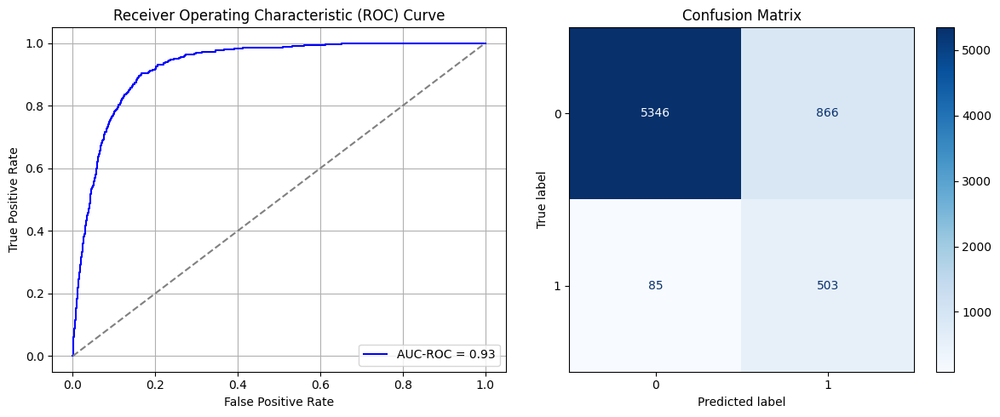

Best threshold based on F1-score: 0.9838312268257141
False Negative Rate: 0.1445578231292517
Time elapsed (performance): 1.2700926479992631
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1279/1279 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - AUC: 0.7873 - loss: 0.5555 - val_AUC: 0.8848 - val_loss: 0.4352
Epoch 2/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 11s 4ms/step - AUC: 0.8849 - loss: 0.4313 - val_AUC: 0.8905 - val_loss: 0.4202
Epoch 3/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 11s 5ms/step - AUC: 0.8873 - loss: 0.4226 - val_AUC: 0.8937 - val_loss: 0.4169
Epoch 4/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - AUC: 0.8938 - loss: 0.4092 - val_AUC: 0.8989 - val_loss: 0.3989
Epoch 5/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8966 - loss: 0.4033 - val_AUC: 0.9023 - val_loss: 0.3903
Epoch 6/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9017 - loss: 0.3924 - val_AUC: 0.9069 - val_loss: 0.3799
Epoch 7/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.9051 - loss: 0.3842 - val_AUC: 0.9098 - val_loss: 0.3789
Epoch 8/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - AUC: 0.9074 - loss: 0.3795 - val_AUC: 0.9122 - val_loss: 0.3673
Epoch 9/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/

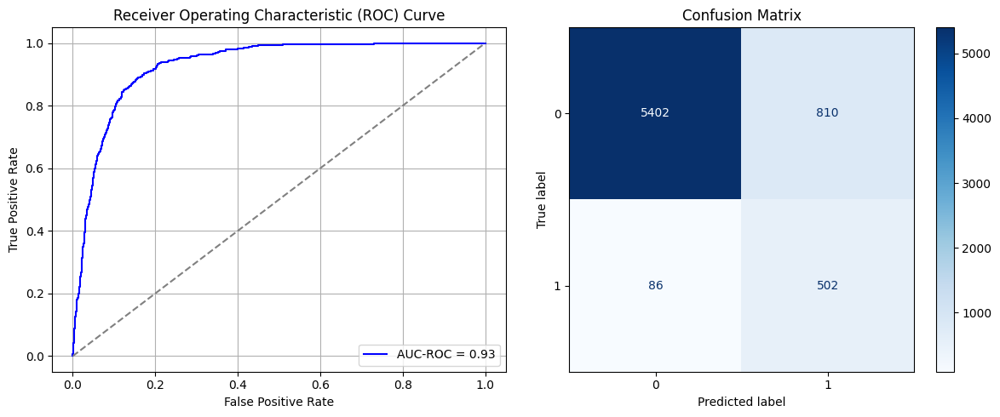

Best threshold based on F1-score: 0.7586460113525391
False Negative Rate: 0.14625850340136054
Time elapsed (performance): 2.104211400001077
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1279/1279 ━━━━━━━━━━━━━━━━━━━━ 9s 6ms/step - AUC: 0.7894 - loss: 0.5560 - val_AUC: 0.8841 - val_loss: 0.4379
Epoch 2/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 8s 4ms/step - AUC: 0.8851 - loss: 0.4294 - val_AUC: 0.8919 - val_loss: 0.4168
Epoch 3/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 11s 5ms/step - AUC: 0.8873 - loss: 0.4225 - val_AUC: 0.8981 - val_loss: 0.4020
Epoch 4/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - AUC: 0.8951 - loss: 0.4065 - val_AUC: 0.9007 - val_loss: 0.3955
Epoch 5/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - AUC: 0.9007 - loss: 0.3954 - val_AUC: 0.9075 - val_loss: 0.3848
Epoch 6/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - AUC: 0.9037 - loss: 0.3884 - val_AUC: 0.9101 - val_loss: 0.3779
Epoch 7/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.9083 - loss: 0.3789 - val_AUC: 0.9138 - val_loss: 0.3664
Epoch 8/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 10s 5ms/step - AUC: 0.9136 - loss: 0.3686 - val_AUC: 0.9160 - val_loss: 0.3684
Epoch 9/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/

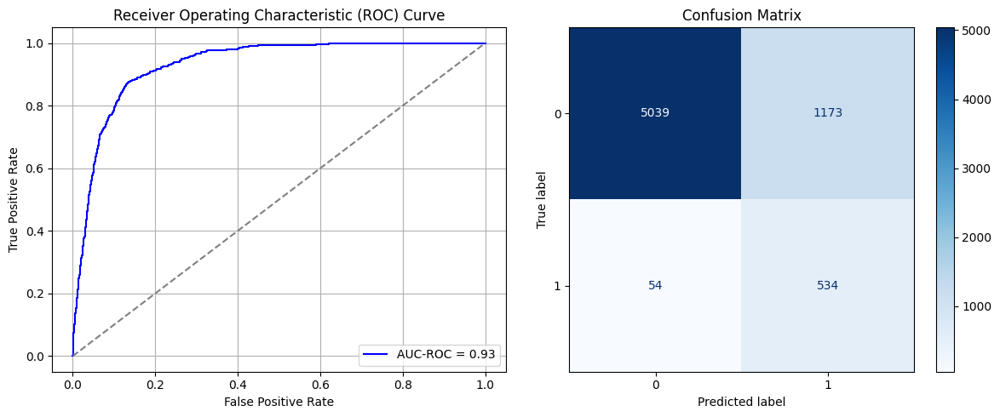

Best threshold based on F1-score: 0.8238975405693054
False Negative Rate: 0.09183673469387756
Time elapsed (performance): 1.0625945659994613
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1279/1279 ━━━━━━━━━━━━━━━━━━━━ 8s 5ms/step - AUC: 0.7885 - loss: 0.5517 - val_AUC: 0.8854 - val_loss: 0.4310
Epoch 2/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 8s 4ms/step - AUC: 0.8829 - loss: 0.4318 - val_AUC: 0.8949 - val_loss: 0.4083
Epoch 3/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - AUC: 0.8963 - loss: 0.4059 - val_AUC: 0.9018 - val_loss: 0.4001
Epoch 4/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - AUC: 0.8980 - loss: 0.4006 - val_AUC: 0.9054 - val_loss: 0.3862
Epoch 5/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.9026 - loss: 0.3913 - val_AUC: 0.9077 - val_loss: 0.3782
Epoch 6/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.9062 - loss: 0.3818 - val_AUC: 0.9123 - val_loss: 0.3828
Epoch 7/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 10s 4ms/step - AUC: 0.9082 - loss: 0.3784 - val_AUC: 0.9131 - val_loss: 0.3704
Epoch 8/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 10s 4ms/step - AUC: 0.9112 - loss: 0.3709 - val_AUC: 0.9165 - val_loss: 0.3580
Epoch 9/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/

<ipython-input-76-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
AUC-ROC: 0.9294335409630692
Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.84      0.91      6212
           1       0.35      0.89      0.50       588

    accuracy                           0.85      6800
   macro avg       0.67      0.87      0.71      6800
weighted avg       0.93      0.85      0.88      6800

FPR 0.15566645202833226 TPR: 0.8894557823129252 FNR: 0.11054421768707483 TNR: 0.8443335479716677


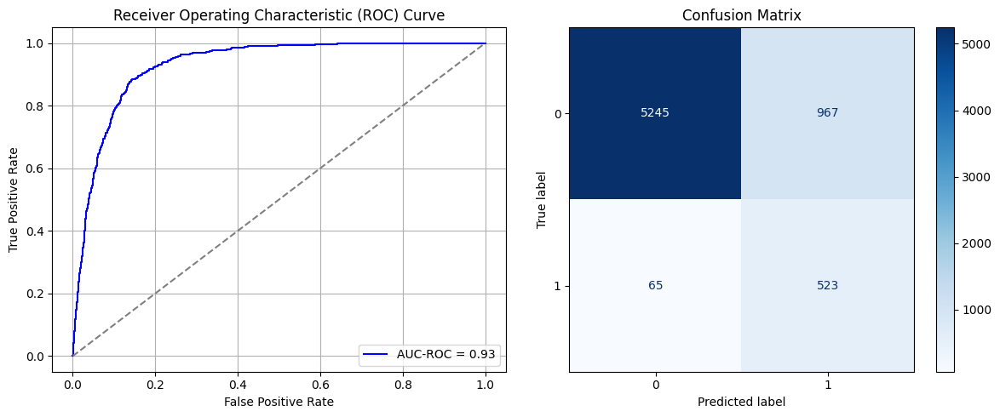

Best threshold based on F1-score: 0.7841909527778625
False Negative Rate: 0.11054421768707483
Time elapsed (performance): 1.070008033000704
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1279/1279 ━━━━━━━━━━━━━━━━━━━━ 8s 5ms/step - AUC: 0.7967 - loss: 0.5470 - val_AUC: 0.8849 - val_loss: 0.4295
Epoch 2/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - AUC: 0.8840 - loss: 0.4287 - val_AUC: 0.8916 - val_loss: 0.4137
Epoch 3/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8895 - loss: 0.4182 - val_AUC: 0.8953 - val_loss: 0.4089
Epoch 4/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - AUC: 0.8918 - loss: 0.4113 - val_AUC: 0.8981 - val_loss: 0.3991
Epoch 5/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - AUC: 0.8993 - loss: 0.3967 - val_AUC: 0.9018 - val_loss: 0.3954
Epoch 6/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - AUC: 0.9037 - loss: 0.3881 - val_AUC: 0.9063 - val_loss: 0.3835
Epoch 7/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.9077 - loss: 0.3797 - val_AUC: 0.9091 - val_loss: 0.3763
Epoch 8/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - AUC: 0.9097 - loss: 0.3751 - val_AUC: 0.9110 - val_loss: 0.3709
Epoch 9/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/st

<ipython-input-76-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
AUC-ROC: 0.9306767459076355
Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.79      0.88      6212
           1       0.30      0.93      0.45       588

    accuracy                           0.81      6800
   macro avg       0.65      0.86      0.67      6800
weighted avg       0.93      0.81      0.84      6800

FPR 0.20669671603348358 TPR: 0.9336734693877551 FNR: 0.0663265306122449 TNR: 0.7933032839665164


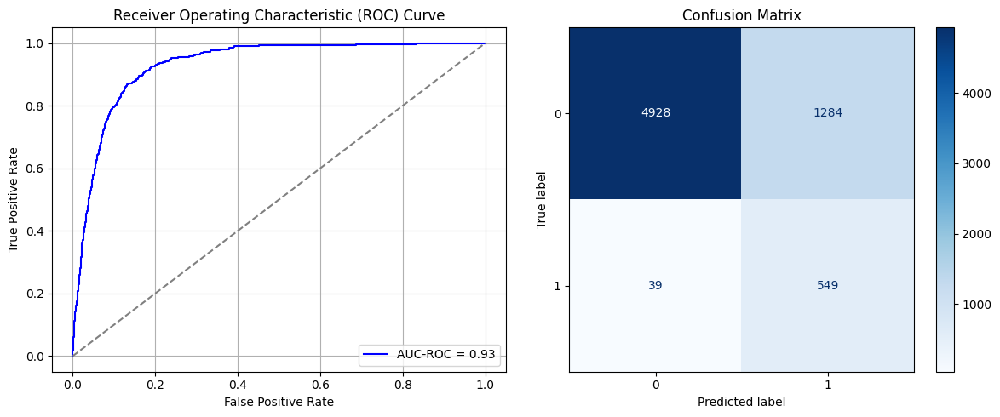

Best threshold based on F1-score: 0.7700578570365906
False Negative Rate: 0.0663265306122449
Time elapsed (performance): 1.3103942019988608
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1279/1279 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - AUC: 0.7921 - loss: 0.5495 - val_AUC: 0.8878 - val_loss: 0.4484
Epoch 2/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 10s 4ms/step - AUC: 0.8821 - loss: 0.4298 - val_AUC: 0.8955 - val_loss: 0.4066
Epoch 3/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 11s 5ms/step - AUC: 0.8930 - loss: 0.4099 - val_AUC: 0.9013 - val_loss: 0.3955
Epoch 4/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - AUC: 0.8987 - loss: 0.3990 - val_AUC: 0.9064 - val_loss: 0.3849
Epoch 5/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.9059 - loss: 0.3826 - val_AUC: 0.9112 - val_loss: 0.3838
Epoch 6/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.9074 - loss: 0.3800 - val_AUC: 0.9143 - val_loss: 0.3646
Epoch 7/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.9120 - loss: 0.3691 - val_AUC: 0.9168 - val_loss: 0.3641
Epoch 8/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 10s 4ms/step - AUC: 0.9154 - loss: 0.3612 - val_AUC: 0.9190 - val_loss: 0.3554
Epoch 9/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms

<ipython-input-76-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
AUC-ROC: 0.9197058250215734
Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.86      0.92      6212
           1       0.36      0.84      0.51       588

    accuracy                           0.86      6800
   macro avg       0.67      0.85      0.71      6800
weighted avg       0.93      0.86      0.88      6800

FPR 0.1395685769478429 TPR: 0.8418367346938775 FNR: 0.15816326530612246 TNR: 0.8604314230521571


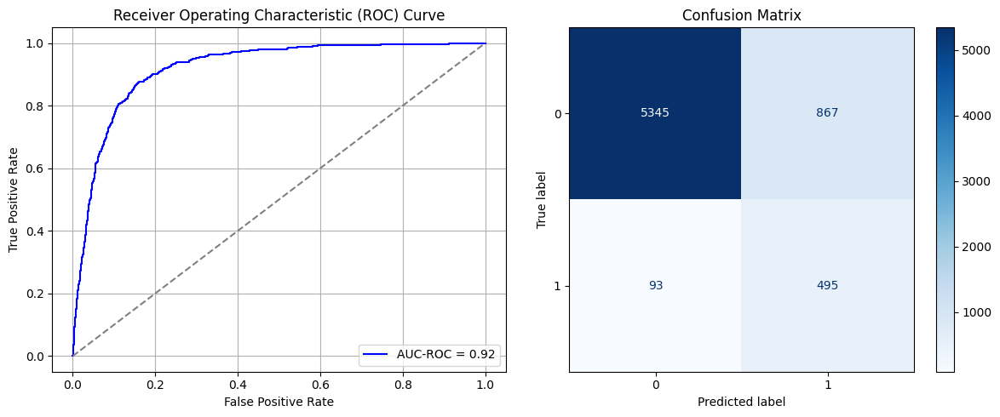

Best threshold based on F1-score: 0.79619961977005
False Negative Rate: 0.15816326530612246
Time elapsed (performance): 1.3321686090002913
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1279/1279 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - AUC: 0.7881 - loss: 0.5517 - val_AUC: 0.8855 - val_loss: 0.4313
Epoch 2/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8832 - loss: 0.4322 - val_AUC: 0.8944 - val_loss: 0.4164
Epoch 3/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - AUC: 0.8943 - loss: 0.4089 - val_AUC: 0.9007 - val_loss: 0.3968
Epoch 4/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8973 - loss: 0.4009 - val_AUC: 0.9031 - val_loss: 0.3910
Epoch 5/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.9043 - loss: 0.3881 - val_AUC: 0.9074 - val_loss: 0.3807
Epoch 6/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 11s 5ms/step - AUC: 0.9071 - loss: 0.3809 - val_AUC: 0.9110 - val_loss: 0.3727
Epoch 7/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 10s 5ms/step - AUC: 0.9078 - loss: 0.3780 - val_AUC: 0.9134 - val_loss: 0.3668
Epoch 8/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - AUC: 0.9148 - loss: 0.3635 - val_AUC: 0.9156 - val_loss: 0.3603
Epoch 9/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/

<ipython-input-76-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
AUC-ROC: 0.9271771007179432
Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.82      0.90      6212
           1       0.33      0.90      0.48       588

    accuracy                           0.83      6800
   macro avg       0.66      0.86      0.69      6800
weighted avg       0.93      0.83      0.86      6800

FPR 0.1773985833869929 TPR: 0.903061224489796 FNR: 0.09693877551020408 TNR: 0.8226014166130071


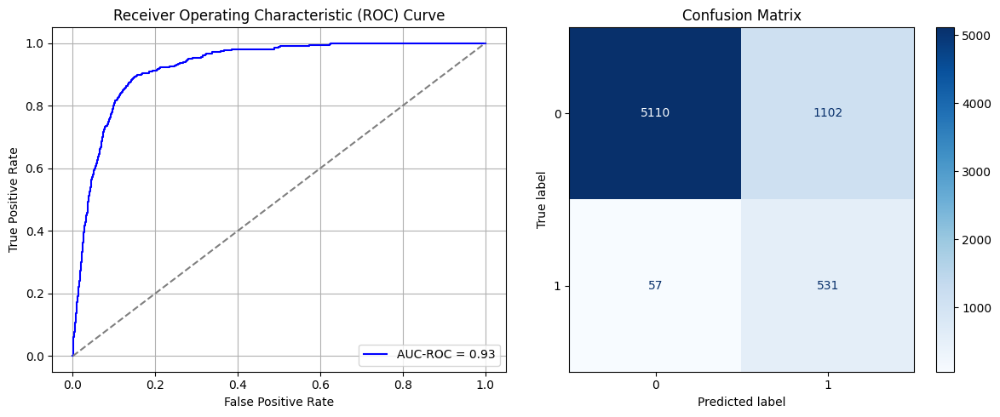

Best threshold based on F1-score: 0.7694767117500305
False Negative Rate: 0.09693877551020408
Time elapsed (performance): 0.9329988089994004
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1279/1279 ━━━━━━━━━━━━━━━━━━━━ 9s 5ms/step - AUC: 0.7955 - loss: 0.5462 - val_AUC: 0.8885 - val_loss: 0.4235
Epoch 2/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8841 - loss: 0.4281 - val_AUC: 0.8946 - val_loss: 0.4060
Epoch 3/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8913 - loss: 0.4130 - val_AUC: 0.9004 - val_loss: 0.4009
Epoch 4/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8976 - loss: 0.4006 - val_AUC: 0.9067 - val_loss: 0.3822
Epoch 5/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - AUC: 0.9047 - loss: 0.3868 - val_AUC: 0.9100 - val_loss: 0.3744
Epoch 6/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.9065 - loss: 0.3815 - val_AUC: 0.9124 - val_loss: 0.3717
Epoch 7/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - AUC: 0.9105 - loss: 0.3731 - val_AUC: 0.9142 - val_loss: 0.3644
Epoch 8/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 10s 4ms/step - AUC: 0.9127 - loss: 0.3686 - val_AUC: 0.9171 - val_loss: 0.3560
Epoch 9/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/s

<ipython-input-76-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
AUC-ROC: 0.9278511307935925
Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.84      0.91      6212
           1       0.34      0.90      0.50       588

    accuracy                           0.84      6800
   macro avg       0.67      0.87      0.70      6800
weighted avg       0.93      0.84      0.87      6800

FPR 0.16113972955569864 TPR: 0.8962585034013606 FNR: 0.10374149659863946 TNR: 0.8388602704443013


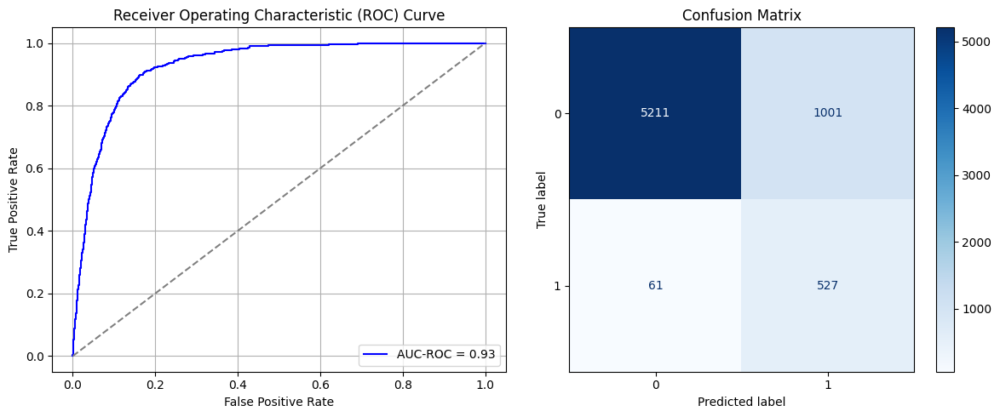

Best threshold based on F1-score: 0.7545025944709778
False Negative Rate: 0.10374149659863946
Time elapsed (performance): 1.9476876150001772
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1279/1279 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - AUC: 0.7896 - loss: 0.5522 - val_AUC: 0.8869 - val_loss: 0.4278
Epoch 2/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8810 - loss: 0.4348 - val_AUC: 0.8944 - val_loss: 0.4114
Epoch 3/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8910 - loss: 0.4150 - val_AUC: 0.8988 - val_loss: 0.3999
Epoch 4/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8948 - loss: 0.4059 - val_AUC: 0.9026 - val_loss: 0.3911
Epoch 5/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - AUC: 0.9002 - loss: 0.3959 - val_AUC: 0.9064 - val_loss: 0.3932
Epoch 6/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 10s 5ms/step - AUC: 0.9043 - loss: 0.3874 - val_AUC: 0.9092 - val_loss: 0.3779
Epoch 7/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.9061 - loss: 0.3826 - val_AUC: 0.9110 - val_loss: 0.3732
Epoch 8/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.9131 - loss: 0.3682 - val_AUC: 0.9137 - val_loss: 0.3694
Epoch 9/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/s

<ipython-input-76-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
AUC-ROC: 0.9280063603032971
Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.84      0.91      6212
           1       0.34      0.87      0.49       588

    accuracy                           0.84      6800
   macro avg       0.66      0.86      0.70      6800
weighted avg       0.93      0.84      0.87      6800

FPR 0.15792015453960076 TPR: 0.8741496598639455 FNR: 0.12585034013605442 TNR: 0.8420798454603993


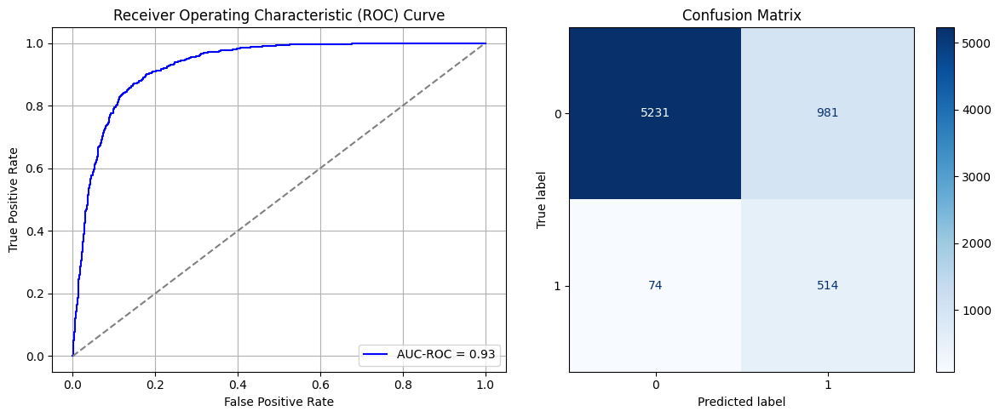

Best threshold based on F1-score: 0.9880474805831909
False Negative Rate: 0.12585034013605442
Time elapsed (performance): 1.1033755939988623
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1279/1279 ━━━━━━━━━━━━━━━━━━━━ 8s 5ms/step - AUC: 0.7918 - loss: 0.5467 - val_AUC: 0.8894 - val_loss: 0.4288
Epoch 2/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - AUC: 0.8858 - loss: 0.4260 - val_AUC: 0.8956 - val_loss: 0.4090
Epoch 3/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8953 - loss: 0.4066 - val_AUC: 0.9019 - val_loss: 0.4328
Epoch 4/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9003 - loss: 0.3961 - val_AUC: 0.9073 - val_loss: 0.3825
Epoch 5/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 11s 5ms/step - AUC: 0.9060 - loss: 0.3838 - val_AUC: 0.9111 - val_loss: 0.3724
Epoch 6/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9092 - loss: 0.3755 - val_AUC: 0.9122 - val_loss: 0.3839
Epoch 7/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 10s 4ms/step - AUC: 0.9133 - loss: 0.3665 - val_AUC: 0.9167 - val_loss: 0.3580
Epoch 8/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9168 - loss: 0.3589 - val_AUC: 0.9181 - val_loss: 0.3544
Epoch 9/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/

<ipython-input-76-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
AUC-ROC: 0.9224009871173195
Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.87      0.92      6212
           1       0.38      0.84      0.52       588

    accuracy                           0.87      6800
   macro avg       0.68      0.85      0.72      6800
weighted avg       0.93      0.87      0.89      6800

FPR 0.13071474565357372 TPR: 0.8350340136054422 FNR: 0.1649659863945578 TNR: 0.8692852543464262


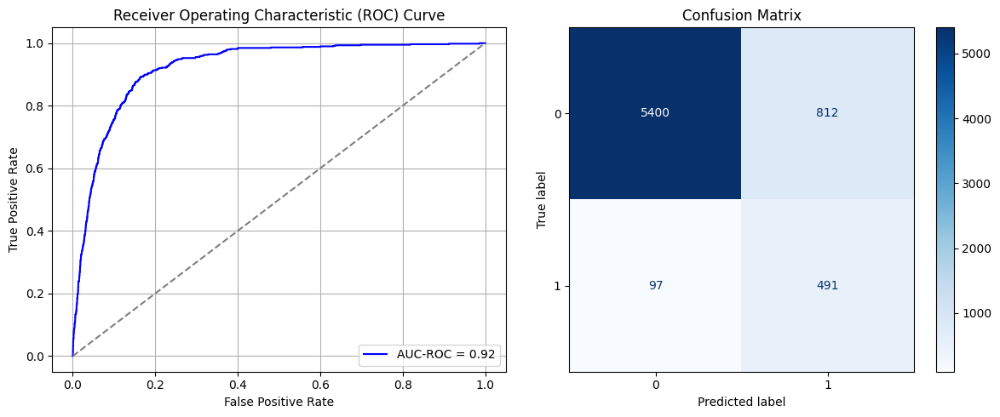

Best threshold based on F1-score: 0.988860011100769
False Negative Rate: 0.1649659863945578
Time elapsed (performance): 1.8593113040005846
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1279/1279 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - AUC: 0.7899 - loss: 0.5542 - val_AUC: 0.8855 - val_loss: 0.4418
Epoch 2/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 11s 5ms/step - AUC: 0.8828 - loss: 0.4321 - val_AUC: 0.8926 - val_loss: 0.4347
Epoch 3/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 10s 5ms/step - AUC: 0.8887 - loss: 0.4193 - val_AUC: 0.8969 - val_loss: 0.4036
Epoch 4/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - AUC: 0.8943 - loss: 0.4084 - val_AUC: 0.9028 - val_loss: 0.3928
Epoch 5/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.9008 - loss: 0.3948 - val_AUC: 0.9067 - val_loss: 0.3970
Epoch 6/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - AUC: 0.9028 - loss: 0.3891 - val_AUC: 0.9093 - val_loss: 0.3758
Epoch 7/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 11s 5ms/step - AUC: 0.9086 - loss: 0.3774 - val_AUC: 0.9122 - val_loss: 0.3701
Epoch 8/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.9107 - loss: 0.3720 - val_AUC: 0.9151 - val_loss: 0.3652
Epoch 9/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms

<ipython-input-76-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
AUC-ROC: 0.9311558493326499
Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.87      0.92      6212
           1       0.38      0.86      0.52       588

    accuracy                           0.86      6800
   macro avg       0.68      0.86      0.72      6800
weighted avg       0.93      0.86      0.89      6800

FPR 0.13473921442369607 TPR: 0.858843537414966 FNR: 0.141156462585034 TNR: 0.8652607855763039


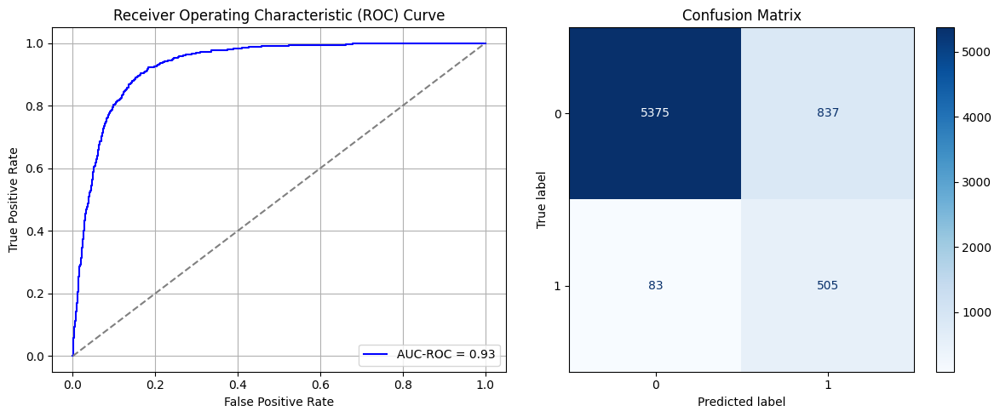

Best threshold based on F1-score: 0.6857607364654541
False Negative Rate: 0.141156462585034
Time elapsed (performance): 1.0895165049987554
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1279/1279 ━━━━━━━━━━━━━━━━━━━━ 8s 5ms/step - AUC: 0.7875 - loss: 0.5540 - val_AUC: 0.8869 - val_loss: 0.4301
Epoch 2/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - AUC: 0.8824 - loss: 0.4329 - val_AUC: 0.8942 - val_loss: 0.4136
Epoch 3/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 10s 4ms/step - AUC: 0.8924 - loss: 0.4127 - val_AUC: 0.9011 - val_loss: 0.3982
Epoch 4/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8968 - loss: 0.4030 - val_AUC: 0.9077 - val_loss: 0.3811
Epoch 5/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 10s 4ms/step - AUC: 0.9041 - loss: 0.3881 - val_AUC: 0.9101 - val_loss: 0.3825
Epoch 6/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 10s 4ms/step - AUC: 0.9076 - loss: 0.3793 - val_AUC: 0.9129 - val_loss: 0.3742
Epoch 7/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.9099 - loss: 0.3746 - val_AUC: 0.9144 - val_loss: 0.3771
Epoch 8/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9117 - loss: 0.3714 - val_AUC: 0.9162 - val_loss: 0.3593
Epoch 9/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 11s 5m

<ipython-input-76-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
AUC-ROC: 0.9244575727908679
Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.88      0.93      6212
           1       0.40      0.82      0.54       588

    accuracy                           0.88      6800
   macro avg       0.69      0.85      0.73      6800
weighted avg       0.93      0.88      0.89      6800

FPR 0.1186413393432067 TPR: 0.8231292517006803 FNR: 0.17687074829931973 TNR: 0.8813586606567934


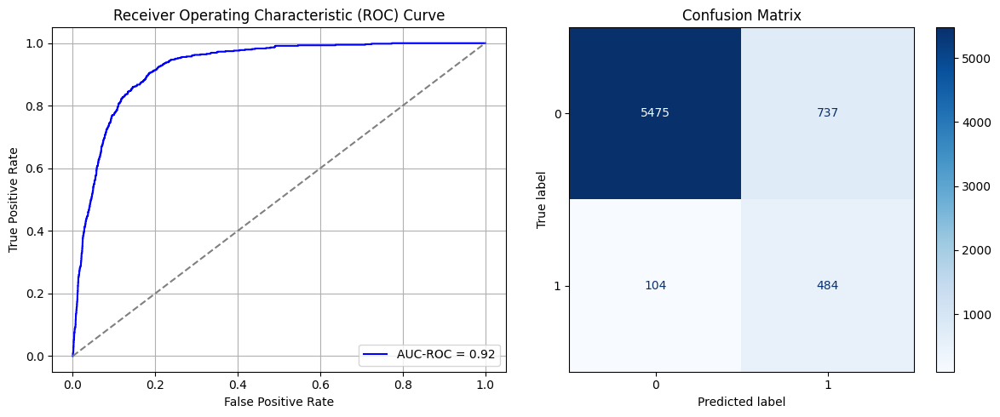

Best threshold based on F1-score: 0.6653924584388733
False Negative Rate: 0.17687074829931973
Time elapsed (performance): 1.066387062001013
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1279/1279 ━━━━━━━━━━━━━━━━━━━━ 8s 5ms/step - AUC: 0.7883 - loss: 0.5506 - val_AUC: 0.8877 - val_loss: 0.4240
Epoch 2/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 10s 5ms/step - AUC: 0.8865 - loss: 0.4238 - val_AUC: 0.8947 - val_loss: 0.4094
Epoch 3/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8958 - loss: 0.4051 - val_AUC: 0.9008 - val_loss: 0.3962
Epoch 4/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8984 - loss: 0.3981 - val_AUC: 0.9042 - val_loss: 0.3861
Epoch 5/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.9023 - loss: 0.3897 - val_AUC: 0.9055 - val_loss: 0.3902
Epoch 6/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9026 - loss: 0.3882 - val_AUC: 0.9083 - val_loss: 0.3802
Epoch 7/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.9078 - loss: 0.3778 - val_AUC: 0.9096 - val_loss: 0.3726
Epoch 8/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.9098 - loss: 0.3728 - val_AUC: 0.9136 - val_loss: 0.3649
Epoch 9/10
1279/1279 ━━━━━━━━━━━━━━━━━━━━ 11s 5ms/

<ipython-input-76-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
AUC-ROC: 0.9292590104296711
Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.84      0.91      6212
           1       0.35      0.89      0.50       588

    accuracy                           0.85      6800
   macro avg       0.67      0.87      0.70      6800
weighted avg       0.93      0.85      0.87      6800

FPR 0.1595299420476497 TPR: 0.8945578231292517 FNR: 0.1054421768707483 TNR: 0.8404700579523503


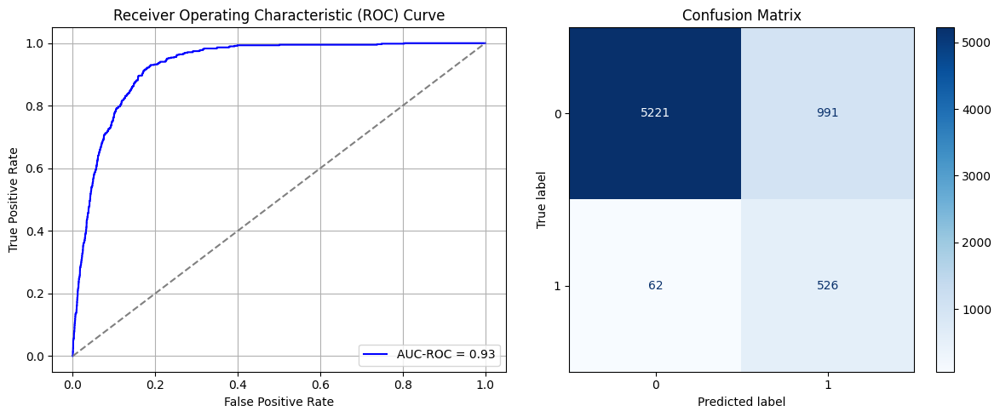

Best threshold based on F1-score: 0.9793867468833923
False Negative Rate: 0.1054421768707483
Time elapsed (performance): 1.2294493459994555


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


In [102]:
times = 50

Training_time = []
FPR = []
TPR = []
FNR = []
TNR = []
TL_time = []


for i in range(times):
    data_S_min_ros = data_S_minority.sample(n=oversample_size - undersample_size, replace=True)
    data_S_SRS_ROS = pd.concat([data_S_majority, data_S_min_ros, data_S_minority])
    X_S_SRS_ROS = data_S_SRS_ROS.iloc[:, :-1]
    y_S_SRS_ROS = data_S_SRS_ROS.iloc[:, -1]
    X_S_train, X_S_test, y_S_train, y_S_test = train_test_split(X_S_SRS_ROS, y_S_SRS_ROS, test_size=0.20, random_state=0)
    model_SRS_ROS = create_dnn_model(X_S_train.shape[1])
    result_SRS_ROS = train_and_evaluate(model_SRS_ROS, X_S_train, X_S_test, y_S_train, y_S_test, "Source")
    result_TL_SRS_ROS = Transductive_TL(model_SRS_ROS, X_T_full, y_T_full, "Target")

    Training_time.append(result_SRS_ROS)
    FPR.append(result_TL_SRS_ROS[0])
    TNR.append(result_TL_SRS_ROS[1])
    FNR.append(result_TL_SRS_ROS[2])
    TPR.append(result_TL_SRS_ROS[3])
    TL_time.append(result_TL_SRS_ROS[4])

ParamFit = pd.DataFrame([Training_time, FPR, TNR, FNR, TPR, TL_time]).T
ParamFit.columns=['Source time', 'FPR', 'TNR', 'FNR', 'TPR', 'Target time']
# print(ParamFit)

In [103]:
print(ParamFit)
ParamFit.to_csv('SRS_ROS2.csv')

    Source time       FPR       TNR       FNR       TPR  Target time
0     48.135461  0.154540  0.845460  0.112245  0.887755     0.782490
1     49.020401  0.168062  0.831938  0.086735  0.913265     0.782192
2     48.054486  0.115744  0.884256  0.173469  0.826531     0.795895
3     48.051297  0.144559  0.855441  0.134354  0.865646     1.067404
4     47.424791  0.158403  0.841597  0.124150  0.875850     0.788236
5     49.038305  0.157920  0.842080  0.120748  0.879252     1.058434
6     45.786287  0.199936  0.800064  0.081633  0.918367     0.906373
7     51.893914  0.149066  0.850934  0.108844  0.891156     1.228171
8     47.570362  0.174984  0.825016  0.090136  0.909864     1.203296
9     51.066700  0.138603  0.861397  0.139456  0.860544     1.090020
10    54.630590  0.165808  0.834192  0.103741  0.896259     0.839265
11    44.477317  0.144559  0.855441  0.122449  0.877551     1.072217
12    47.695018  0.151964  0.848036  0.124150  0.875850     1.210262
13    49.106985  0.137154  0.86284

## Systematic Resampling:

In this case, we examine the possibility of performing Random Oversampling on the minority class using systematic sampling. For this purpose, taking a sampling interval of $k$, we would compile a total of $k*\frac{N_0-N_1}{N_1}$ systematic samples from the minority class in order to balance the dataset. We sample the starting point from 1 to $k$ *with replacement*, since a highly imbalanced dataset will require sampling with replacement in order to achieve a balanced dataset.

In particular, taking $k=10$ yields a number of samples of $k*\frac{N_0-N_1}{N_1}= 11.05 \approx 11$, so we take $k=10$.

In [104]:
data_S
data_S_majority = data_S[data_S['Y'].isin([0])]
data_S_minority = data_S[data_S['Y'].isin([1])]

undersample_size = data_S_minority['Y'].size
oversample_size = data_S_majority['Y'].size

print(undersample_size)
print(oversample_size)

4433
31960


Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1278/1278 ━━━━━━━━━━━━━━━━━━━━ 8s 4ms/step - AUC: 0.7867 - loss: 0.5545 - val_AUC: 0.8843 - val_loss: 0.4329
Epoch 2/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8800 - loss: 0.4360 - val_AUC: 0.8896 - val_loss: 0.4272
Epoch 3/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8895 - loss: 0.4180 - val_AUC: 0.8959 - val_loss: 0.4080
Epoch 4/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/step - AUC: 0.8952 - loss: 0.4055 - val_AUC: 0.9016 - val_loss: 0.3920
Epoch 5/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9007 - loss: 0.3946 - val_AUC: 0.9044 - val_loss: 0.3965
Epoch 6/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9070 - loss: 0.3820 - val_AUC: 0.9074 - val_loss: 0.3841
Epoch 7/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/step - AUC: 0.9079 - loss: 0.3797 - val_AUC: 0.9102 - val_loss: 0.3735
Epoch 8/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9106 - loss: 0.3722 - val_AUC: 0.9122 - val_loss: 0.3708
Epoch 9/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/st

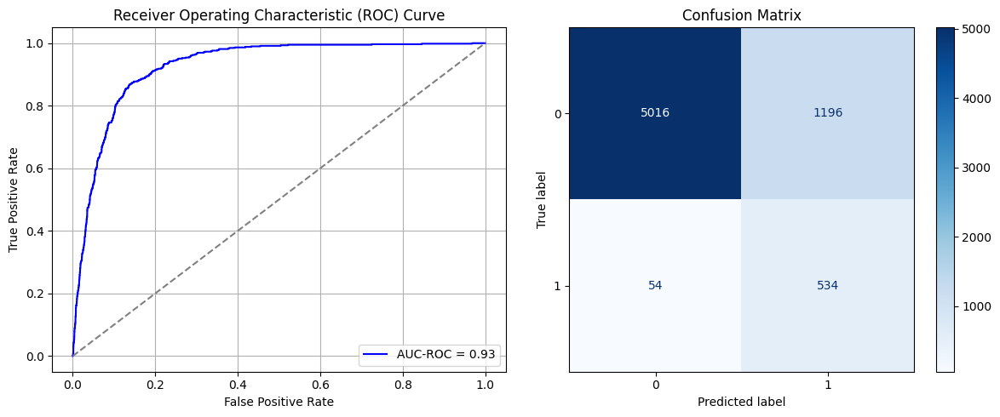

Best threshold based on F1-score: 0.9894818067550659
False Negative Rate: 0.09183673469387756
Time elapsed (performance): 0.7847972899999149
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.7825 - loss: 0.5566 - val_AUC: 0.8892 - val_loss: 0.4274
Epoch 2/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8841 - loss: 0.4304 - val_AUC: 0.8989 - val_loss: 0.4004
Epoch 3/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8917 - loss: 0.4144 - val_AUC: 0.9052 - val_loss: 0.3889
Epoch 4/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/step - AUC: 0.9001 - loss: 0.3967 - val_AUC: 0.9089 - val_loss: 0.3805
Epoch 5/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9046 - loss: 0.3870 - val_AUC: 0.9109 - val_loss: 0.3747
Epoch 6/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9055 - loss: 0.3844 - val_AUC: 0.9110 - val_loss: 0.3715
Epoch 7/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9086 - loss: 0.3771 - val_AUC: 0.9142 - val_loss: 0.3864
Epoch 8/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9092 - loss: 0.3744 - val_AUC: 0.9150 - val_loss: 0.3741
Epoch 9/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/st

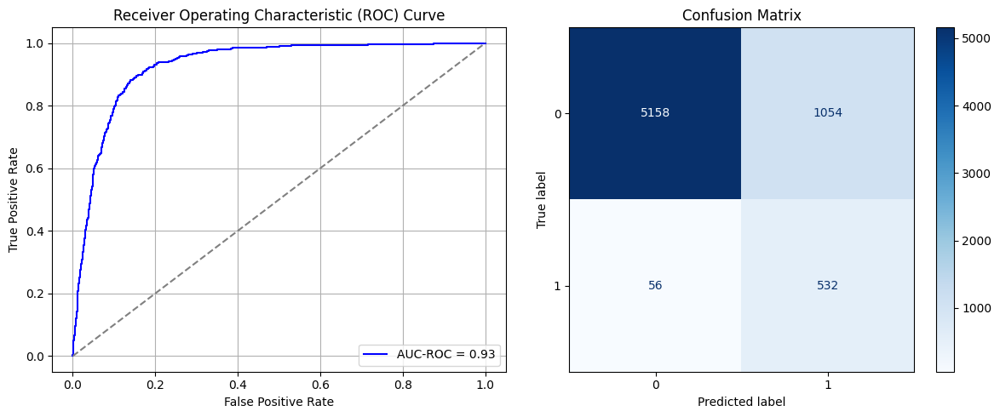

Best threshold based on F1-score: 0.7647650241851807
False Negative Rate: 0.09523809523809523
Time elapsed (performance): 2.5142321820003417
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1278/1278 ━━━━━━━━━━━━━━━━━━━━ 10s 3ms/step - AUC: 0.7848 - loss: 0.5533 - val_AUC: 0.8871 - val_loss: 0.4348
Epoch 2/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8809 - loss: 0.4337 - val_AUC: 0.8922 - val_loss: 0.4284
Epoch 3/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/step - AUC: 0.8935 - loss: 0.4096 - val_AUC: 0.8997 - val_loss: 0.4019
Epoch 4/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8976 - loss: 0.4007 - val_AUC: 0.9061 - val_loss: 0.3924
Epoch 5/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.9033 - loss: 0.3893 - val_AUC: 0.9093 - val_loss: 0.3804
Epoch 6/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9076 - loss: 0.3798 - val_AUC: 0.9129 - val_loss: 0.3813
Epoch 7/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9096 - loss: 0.3745 - val_AUC: 0.9152 - val_loss: 0.3647
Epoch 8/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9137 - loss: 0.3661 - val_AUC: 0.9168 - val_loss: 0.3592
Epoch 9/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/s

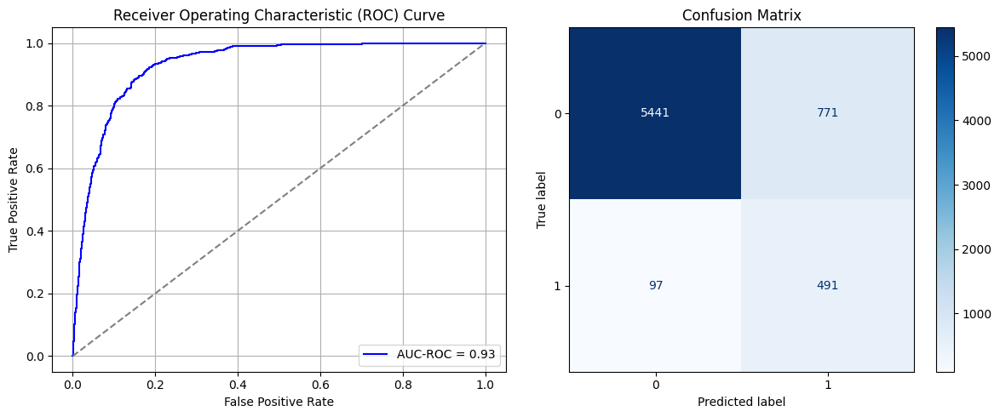

Best threshold based on F1-score: 0.6564128398895264
False Negative Rate: 0.1649659863945578
Time elapsed (performance): 0.8021832480008015
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.7894 - loss: 0.5504 - val_AUC: 0.8897 - val_loss: 0.4274
Epoch 2/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8842 - loss: 0.4303 - val_AUC: 0.8957 - val_loss: 0.4062
Epoch 3/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8929 - loss: 0.4106 - val_AUC: 0.9001 - val_loss: 0.3947
Epoch 4/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9002 - loss: 0.3950 - val_AUC: 0.9049 - val_loss: 0.3867
Epoch 5/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9014 - loss: 0.3921 - val_AUC: 0.9074 - val_loss: 0.3774
Epoch 6/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9090 - loss: 0.3767 - val_AUC: 0.9108 - val_loss: 0.3738
Epoch 7/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.9099 - loss: 0.3717 - val_AUC: 0.9126 - val_loss: 0.3653
Epoch 8/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9112 - loss: 0.3693 - val_AUC: 0.9155 - val_loss: 0.3624
Epoch 9/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/st

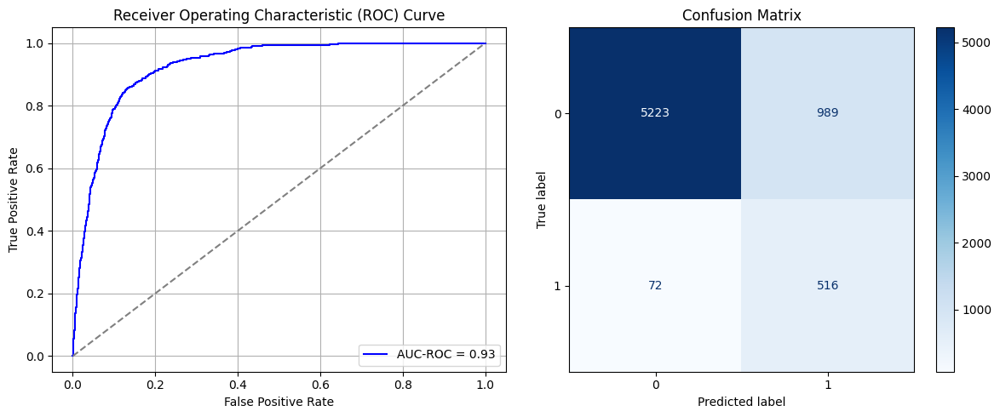

Best threshold based on F1-score: 0.9775181412696838
False Negative Rate: 0.12244897959183673
Time elapsed (performance): 0.8028153100003692
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/step - AUC: 0.7904 - loss: 0.5539 - val_AUC: 0.8878 - val_loss: 0.4261
Epoch 2/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8805 - loss: 0.4347 - val_AUC: 0.8979 - val_loss: 0.4134
Epoch 3/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8947 - loss: 0.4072 - val_AUC: 0.9046 - val_loss: 0.3883
Epoch 4/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9001 - loss: 0.3962 - val_AUC: 0.9069 - val_loss: 0.3811
Epoch 5/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.9022 - loss: 0.3900 - val_AUC: 0.9107 - val_loss: 0.3732
Epoch 6/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9053 - loss: 0.3833 - val_AUC: 0.9116 - val_loss: 0.3706
Epoch 7/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9113 - loss: 0.3707 - val_AUC: 0.9139 - val_loss: 0.3696
Epoch 8/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9089 - loss: 0.3754 - val_AUC: 0.9144 - val_loss: 0.3667
Epoch 9/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/st

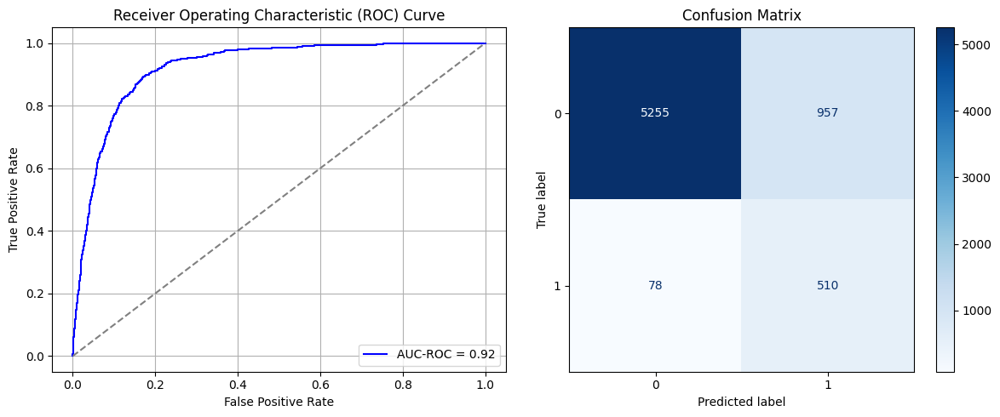

Best threshold based on F1-score: 0.7638863921165466
False Negative Rate: 0.1326530612244898
Time elapsed (performance): 1.0774932919994171
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/step - AUC: 0.7843 - loss: 0.5560 - val_AUC: 0.8905 - val_loss: 0.4229
Epoch 2/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8850 - loss: 0.4283 - val_AUC: 0.8970 - val_loss: 0.4106
Epoch 3/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - AUC: 0.8906 - loss: 0.4146 - val_AUC: 0.9022 - val_loss: 0.3926
Epoch 4/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9021 - loss: 0.3918 - val_AUC: 0.9059 - val_loss: 0.3847
Epoch 5/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9071 - loss: 0.3821 - val_AUC: 0.9117 - val_loss: 0.3721
Epoch 6/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9100 - loss: 0.3752 - val_AUC: 0.9146 - val_loss: 0.3695
Epoch 7/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9137 - loss: 0.3669 - val_AUC: 0.9172 - val_loss: 0.3590
Epoch 8/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9162 - loss: 0.3612 - val_AUC: 0.9181 - val_loss: 0.3557
Epoch 9/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/st

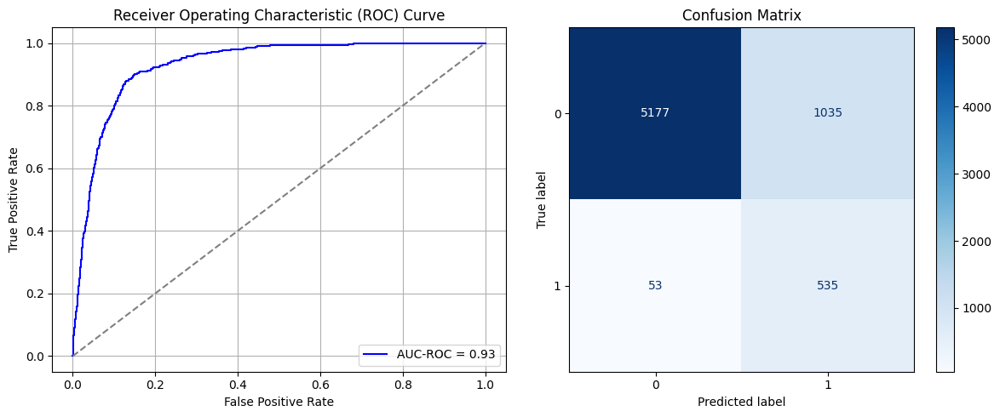

Best threshold based on F1-score: 0.9966382384300232
False Negative Rate: 0.09013605442176871
Time elapsed (performance): 0.7998171729996102
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1278/1278 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - AUC: 0.7902 - loss: 0.5531 - val_AUC: 0.8891 - val_loss: 0.4319
Epoch 2/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8806 - loss: 0.4356 - val_AUC: 0.8972 - val_loss: 0.4054
Epoch 3/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8904 - loss: 0.4155 - val_AUC: 0.9014 - val_loss: 0.3942
Epoch 4/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8997 - loss: 0.3971 - val_AUC: 0.9069 - val_loss: 0.3824
Epoch 5/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9013 - loss: 0.3934 - val_AUC: 0.9123 - val_loss: 0.3703
Epoch 6/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9067 - loss: 0.3819 - val_AUC: 0.9142 - val_loss: 0.3674
Epoch 7/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/step - AUC: 0.9109 - loss: 0.3730 - val_AUC: 0.9180 - val_loss: 0.3573
Epoch 8/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9141 - loss: 0.3670 - val_AUC: 0.9196 - val_loss: 0.3549
Epoch 9/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/st

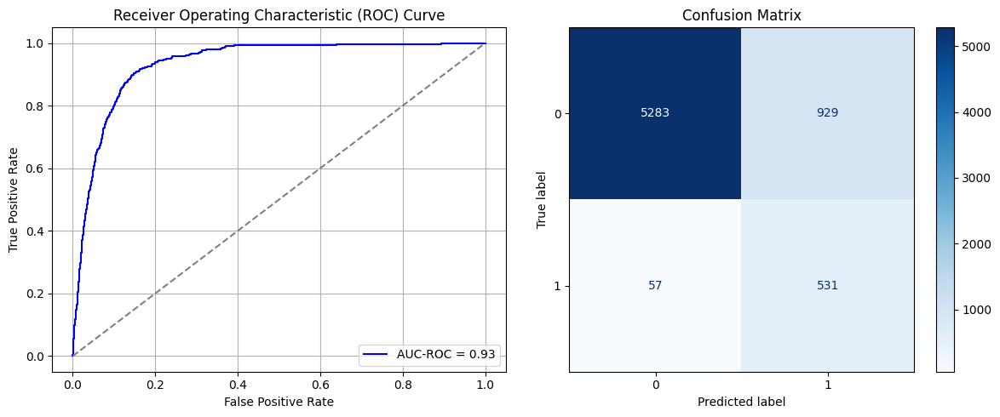

Best threshold based on F1-score: 0.7429359555244446
False Negative Rate: 0.09693877551020408
Time elapsed (performance): 0.8062441290003335
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1278/1278 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - AUC: 0.7804 - loss: 0.5584 - val_AUC: 0.8877 - val_loss: 0.4263
Epoch 2/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 9s 3ms/step - AUC: 0.8810 - loss: 0.4350 - val_AUC: 0.8950 - val_loss: 0.4082
Epoch 3/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8930 - loss: 0.4115 - val_AUC: 0.8987 - val_loss: 0.4014
Epoch 4/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8933 - loss: 0.4095 - val_AUC: 0.9015 - val_loss: 0.3922
Epoch 5/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8999 - loss: 0.3952 - val_AUC: 0.9070 - val_loss: 0.3812
Epoch 6/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9034 - loss: 0.3878 - val_AUC: 0.9102 - val_loss: 0.3778
Epoch 7/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9055 - loss: 0.3829 - val_AUC: 0.9132 - val_loss: 0.3670
Epoch 8/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9126 - loss: 0.3692 - val_AUC: 0.9147 - val_loss: 0.3625
Epoch 9/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/st

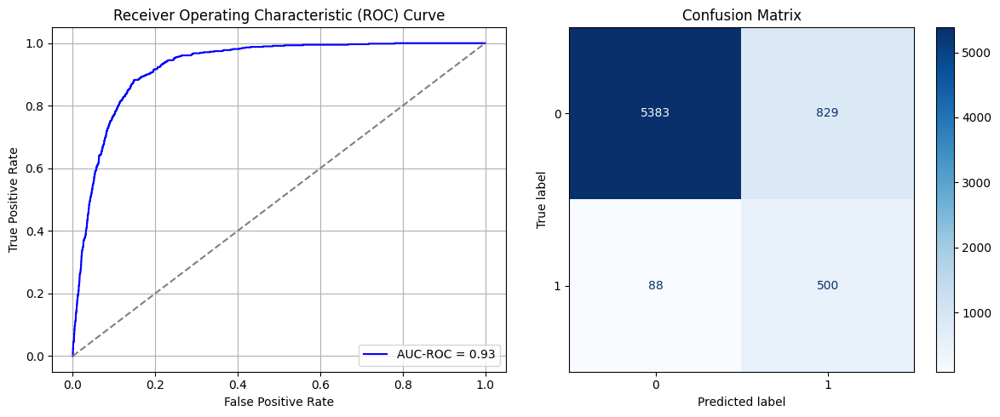

Best threshold based on F1-score: 0.6528979539871216
False Negative Rate: 0.14965986394557823
Time elapsed (performance): 0.7982006969996291
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.7893 - loss: 0.5522 - val_AUC: 0.8908 - val_loss: 0.4223
Epoch 2/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8888 - loss: 0.4216 - val_AUC: 0.8981 - val_loss: 0.4008
Epoch 3/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8934 - loss: 0.4103 - val_AUC: 0.9028 - val_loss: 0.4005
Epoch 4/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8963 - loss: 0.4020 - val_AUC: 0.9088 - val_loss: 0.3809
Epoch 5/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.9046 - loss: 0.3863 - val_AUC: 0.9125 - val_loss: 0.3736
Epoch 6/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9114 - loss: 0.3716 - val_AUC: 0.9149 - val_loss: 0.3628
Epoch 7/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.9148 - loss: 0.3645 - val_AUC: 0.9186 - val_loss: 0.3579
Epoch 8/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9133 - loss: 0.3650 - val_AUC: 0.9187 - val_loss: 0.3589
Epoch 9/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/st

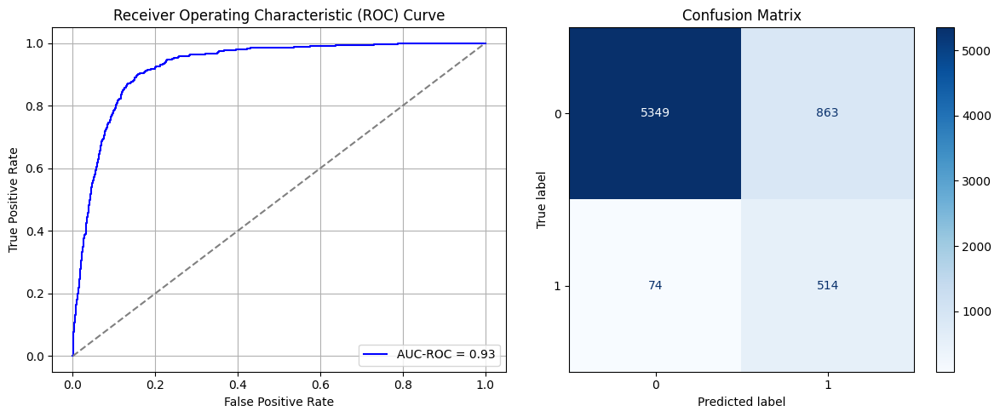

<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Best threshold based on F1-score: 0.9859991669654846
False Negative Rate: 0.12585034013605442
Time elapsed (performance): 1.2596624359994166
Epoch 1/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/step - AUC: 0.7880 - loss: 0.5558 - val_AUC: 0.8898 - val_loss: 0.4267
Epoch 2/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8836 - loss: 0.4313 - val_AUC: 0.8966 - val_loss: 0.4050
Epoch 3/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8903 - loss: 0.4158 - val_AUC: 0.8991 - val_loss: 0.4000
Epoch 4/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8961 - loss: 0.4040 - val_AUC: 0.9049 - val_loss: 0.3897
Epoch 5/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/step - AUC: 0.8993 - loss: 0.3958 - val_AUC: 0.9072 - val_loss: 0.3930
Epoch 6/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9049 - loss: 0.3843 - val_AUC: 0.9103 - val_loss: 0.3765
Epoch 7/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9090 - loss: 0.3755 - val_AUC: 0.9140 - val_loss: 0.3717
Epoch 8/10
1278/127

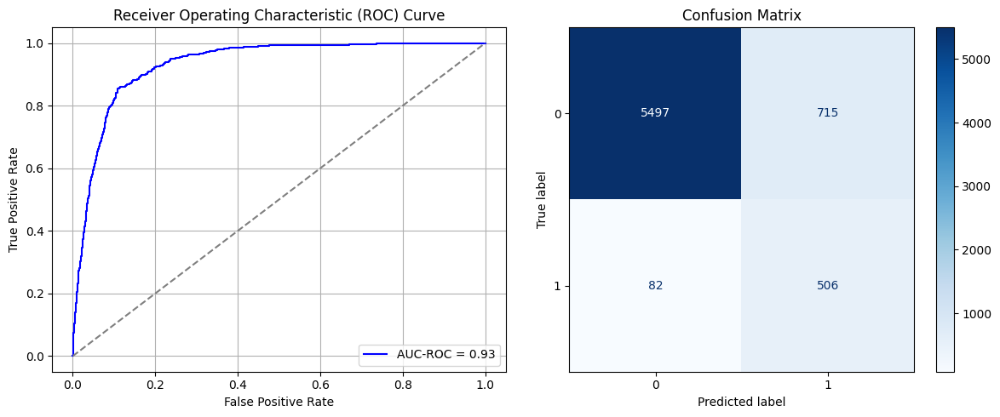

Best threshold based on F1-score: 0.6247404217720032
False Negative Rate: 0.13945578231292516
Time elapsed (performance): 1.2273150609998993
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/step - AUC: 0.7864 - loss: 0.5550 - val_AUC: 0.8887 - val_loss: 0.4309
Epoch 2/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8818 - loss: 0.4369 - val_AUC: 0.8936 - val_loss: 0.4127
Epoch 3/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8859 - loss: 0.4250 - val_AUC: 0.8992 - val_loss: 0.4043
Epoch 4/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8935 - loss: 0.4100 - val_AUC: 0.9023 - val_loss: 0.3943
Epoch 5/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8996 - loss: 0.3966 - val_AUC: 0.9067 - val_loss: 0.3805
Epoch 6/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9027 - loss: 0.3894 - val_AUC: 0.9099 - val_loss: 0.3742
Epoch 7/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9087 - loss: 0.3777 - val_AUC: 0.9112 - val_loss: 0.3716
Epoch 8/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9121 - loss: 0.3689 - val_AUC: 0.9139 - val_loss: 0.3660
Epoch 9/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/st

<ipython-input-76-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
AUC-ROC: 0.9184460567871707
Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.87      0.92      6212
           1       0.37      0.83      0.51       588

    accuracy                           0.86      6800
   macro avg       0.68      0.85      0.72      6800
weighted avg       0.93      0.86      0.89      6800

FPR 0.13296844816484224 TPR: 0.8299319727891157 FNR: 0.17006802721088435 TNR: 0.8670315518351578


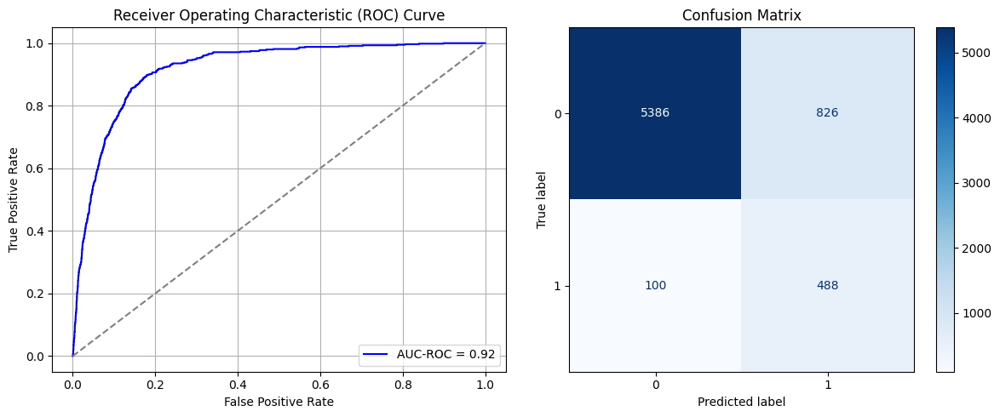

Best threshold based on F1-score: 0.6906383037567139
False Negative Rate: 0.17006802721088435
Time elapsed (performance): 1.0550226010000188
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1278/1278 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - AUC: 0.7839 - loss: 0.5569 - val_AUC: 0.8918 - val_loss: 0.4168
Epoch 2/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8827 - loss: 0.4293 - val_AUC: 0.8984 - val_loss: 0.4229
Epoch 3/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8902 - loss: 0.4142 - val_AUC: 0.9039 - val_loss: 0.3891
Epoch 4/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8988 - loss: 0.3982 - val_AUC: 0.9083 - val_loss: 0.3814
Epoch 5/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9006 - loss: 0.3935 - val_AUC: 0.9120 - val_loss: 0.3707
Epoch 6/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9021 - loss: 0.3905 - val_AUC: 0.9148 - val_loss: 0.3618
Epoch 7/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9105 - loss: 0.3724 - val_AUC: 0.9173 - val_loss: 0.3575
Epoch 8/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9111 - loss: 0.3714 - val_AUC: 0.9189 - val_loss: 0.3558
Epoch 9/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/st

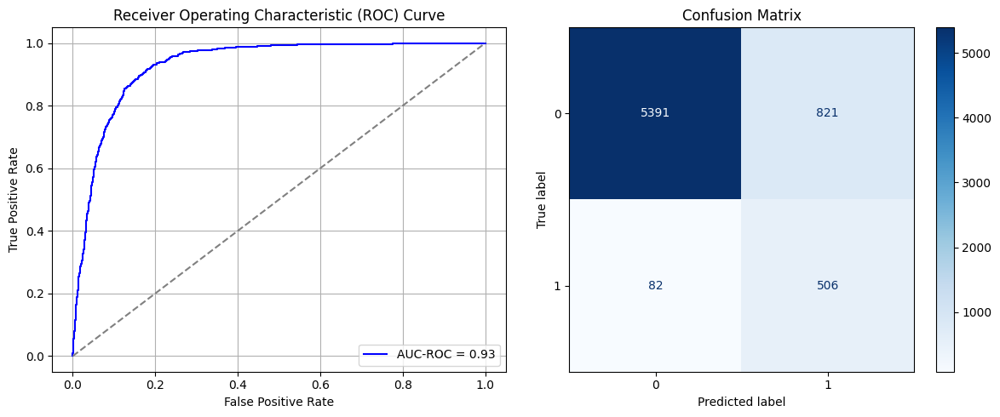

Best threshold based on F1-score: 0.7448816895484924
False Negative Rate: 0.13945578231292516
Time elapsed (performance): 1.061331317998338
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1278/1278 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - AUC: 0.7986 - loss: 0.5415 - val_AUC: 0.8924 - val_loss: 0.4172
Epoch 2/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8827 - loss: 0.4305 - val_AUC: 0.8974 - val_loss: 0.4021
Epoch 3/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8929 - loss: 0.4103 - val_AUC: 0.9029 - val_loss: 0.4052
Epoch 4/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8960 - loss: 0.4042 - val_AUC: 0.9070 - val_loss: 0.3820
Epoch 5/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9025 - loss: 0.3912 - val_AUC: 0.9106 - val_loss: 0.3747
Epoch 6/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9072 - loss: 0.3816 - val_AUC: 0.9126 - val_loss: 0.3682
Epoch 7/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9116 - loss: 0.3732 - val_AUC: 0.9152 - val_loss: 0.3628
Epoch 8/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9107 - loss: 0.3724 - val_AUC: 0.9165 - val_loss: 0.3675
Epoch 9/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/st

<ipython-input-76-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
AUC-ROC: 0.9295550963463299
Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.81      0.89      6212
           1       0.31      0.91      0.47       588

    accuracy                           0.82      6800
   macro avg       0.65      0.86      0.68      6800
weighted avg       0.93      0.82      0.85      6800

FPR 0.18915003219575016 TPR: 0.9098639455782312 FNR: 0.09013605442176871 TNR: 0.8108499678042498


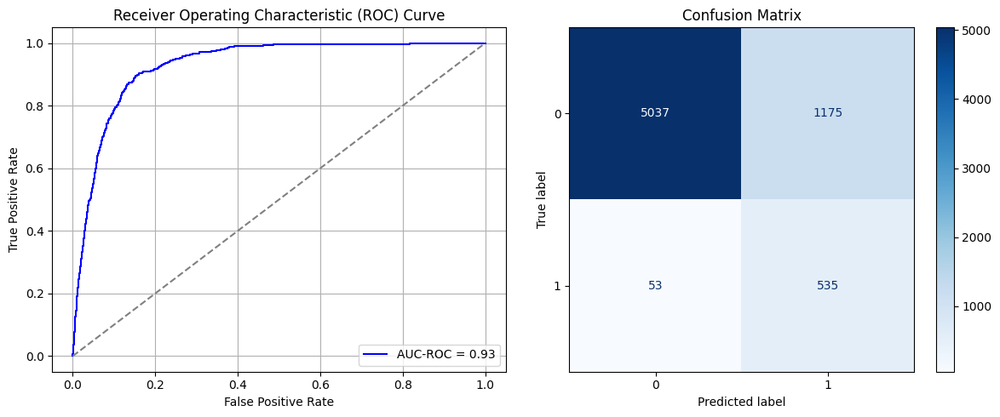

Best threshold based on F1-score: 0.7729502320289612
False Negative Rate: 0.09013605442176871
Time elapsed (performance): 0.8456026329986344
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1278/1278 ━━━━━━━━━━━━━━━━━━━━ 8s 5ms/step - AUC: 0.7938 - loss: 0.5494 - val_AUC: 0.8851 - val_loss: 0.4583
Epoch 2/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8842 - loss: 0.4292 - val_AUC: 0.8973 - val_loss: 0.4090
Epoch 3/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8925 - loss: 0.4130 - val_AUC: 0.9042 - val_loss: 0.3895
Epoch 4/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.9036 - loss: 0.3895 - val_AUC: 0.9058 - val_loss: 0.3888
Epoch 5/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9064 - loss: 0.3830 - val_AUC: 0.9104 - val_loss: 0.3763
Epoch 6/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9098 - loss: 0.3746 - val_AUC: 0.9133 - val_loss: 0.3679
Epoch 7/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/step - AUC: 0.9112 - loss: 0.3703 - val_AUC: 0.9145 - val_loss: 0.3695
Epoch 8/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9114 - loss: 0.3691 - val_AUC: 0.9172 - val_loss: 0.3575
Epoch 9/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/st

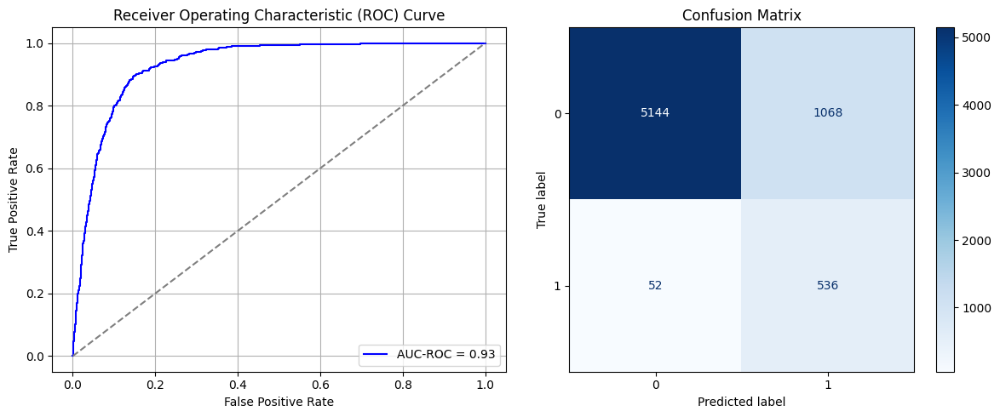

Best threshold based on F1-score: 0.9770066142082214
False Negative Rate: 0.08843537414965986
Time elapsed (performance): 0.810903394001798
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1278/1278 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - AUC: 0.7893 - loss: 0.5536 - val_AUC: 0.8918 - val_loss: 0.4190
Epoch 2/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8856 - loss: 0.4263 - val_AUC: 0.8987 - val_loss: 0.4062
Epoch 3/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8918 - loss: 0.4121 - val_AUC: 0.9037 - val_loss: 0.3898
Epoch 4/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8989 - loss: 0.3984 - val_AUC: 0.9074 - val_loss: 0.3798
Epoch 5/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9019 - loss: 0.3911 - val_AUC: 0.9105 - val_loss: 0.3819
Epoch 6/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9050 - loss: 0.3849 - val_AUC: 0.9129 - val_loss: 0.3696
Epoch 7/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9113 - loss: 0.3720 - val_AUC: 0.9151 - val_loss: 0.3656
Epoch 8/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9127 - loss: 0.3682 - val_AUC: 0.9164 - val_loss: 0.3594
Epoch 9/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/st

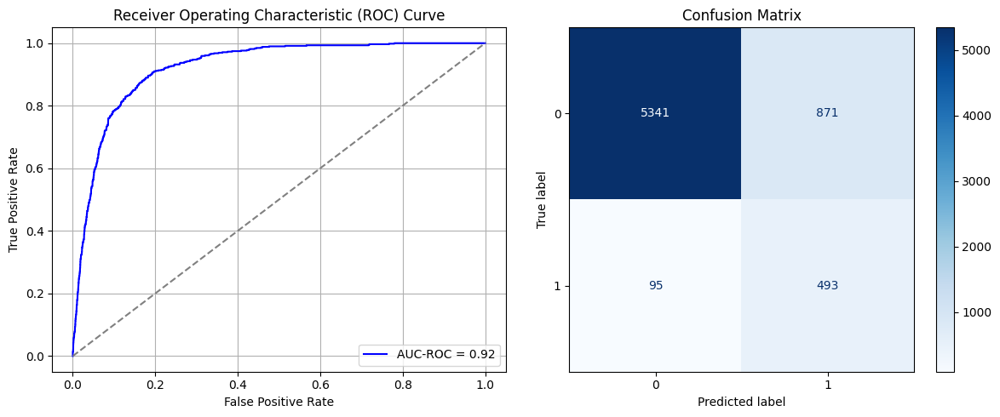

Best threshold based on F1-score: 0.6610610485076904
False Negative Rate: 0.16156462585034015
Time elapsed (performance): 0.8355863329998101
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.7876 - loss: 0.5546 - val_AUC: 0.8882 - val_loss: 0.4285
Epoch 2/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8842 - loss: 0.4293 - val_AUC: 0.8962 - val_loss: 0.4049
Epoch 3/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8897 - loss: 0.4168 - val_AUC: 0.8995 - val_loss: 0.3982
Epoch 4/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8964 - loss: 0.4047 - val_AUC: 0.9031 - val_loss: 0.3912
Epoch 5/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 9s 3ms/step - AUC: 0.9003 - loss: 0.3943 - val_AUC: 0.9060 - val_loss: 0.3883
Epoch 6/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.9032 - loss: 0.3878 - val_AUC: 0.9077 - val_loss: 0.3785
Epoch 7/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9044 - loss: 0.3856 - val_AUC: 0.9112 - val_loss: 0.3725
Epoch 8/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9063 - loss: 0.3805 - val_AUC: 0.9129 - val_loss: 0.3683
Epoch 9/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/st

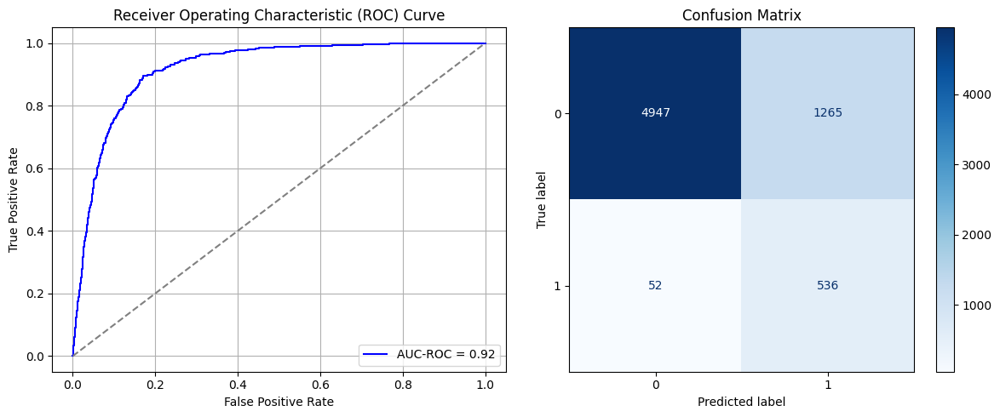

Best threshold based on F1-score: 0.9892251491546631
False Negative Rate: 0.08843537414965986
Time elapsed (performance): 1.0579409179990762
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/step - AUC: 0.7844 - loss: 0.5547 - val_AUC: 0.8883 - val_loss: 0.4349
Epoch 2/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8842 - loss: 0.4286 - val_AUC: 0.8935 - val_loss: 0.4126
Epoch 3/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8893 - loss: 0.4169 - val_AUC: 0.8993 - val_loss: 0.4002
Epoch 4/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8933 - loss: 0.4091 - val_AUC: 0.9013 - val_loss: 0.3931
Epoch 5/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - AUC: 0.8982 - loss: 0.3986 - val_AUC: 0.9056 - val_loss: 0.3897
Epoch 6/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 9s 3ms/step - AUC: 0.9017 - loss: 0.3899 - val_AUC: 0.9084 - val_loss: 0.3966
Epoch 7/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9052 - loss: 0.3841 - val_AUC: 0.9125 - val_loss: 0.3829
Epoch 8/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9143 - loss: 0.3658 - val_AUC: 0.9141 - val_loss: 0.3692
Epoch 9/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/st

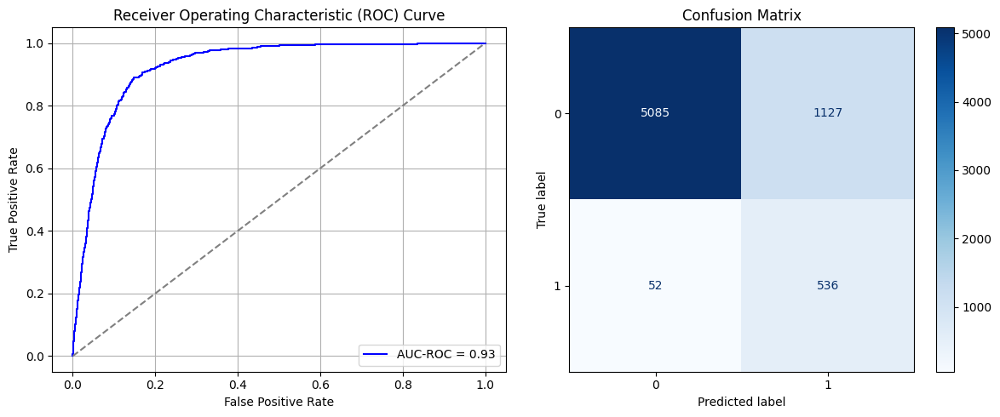

Best threshold based on F1-score: 0.7667482495307922
False Negative Rate: 0.08843537414965986
Time elapsed (performance): 1.0580756870003825
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1278/1278 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - AUC: 0.7915 - loss: 0.5480 - val_AUC: 0.8897 - val_loss: 0.4214
Epoch 2/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8818 - loss: 0.4319 - val_AUC: 0.8939 - val_loss: 0.4156
Epoch 3/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8897 - loss: 0.4170 - val_AUC: 0.8990 - val_loss: 0.4020
Epoch 4/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8955 - loss: 0.4044 - val_AUC: 0.9032 - val_loss: 0.3902
Epoch 5/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9009 - loss: 0.3933 - val_AUC: 0.9090 - val_loss: 0.3917
Epoch 6/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9070 - loss: 0.3816 - val_AUC: 0.9129 - val_loss: 0.3768
Epoch 7/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.9066 - loss: 0.3821 - val_AUC: 0.9144 - val_loss: 0.3638
Epoch 8/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9133 - loss: 0.3666 - val_AUC: 0.9161 - val_loss: 0.3757
Epoch 9/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/st

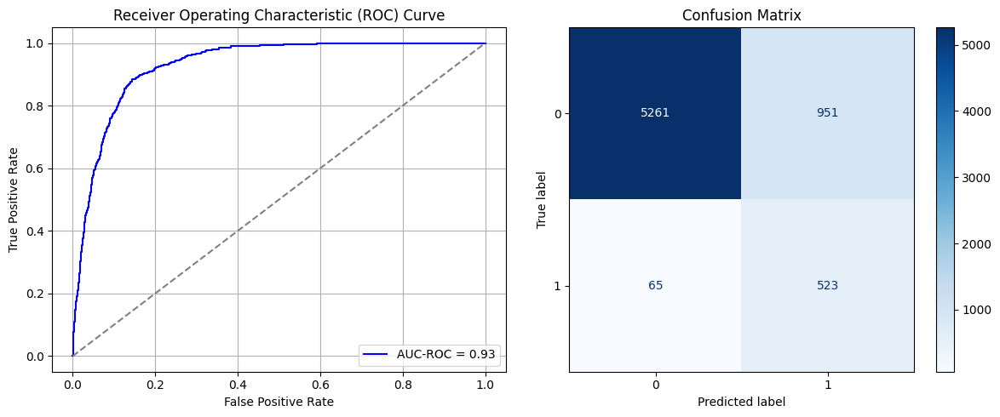

Best threshold based on F1-score: 0.9926885366439819
False Negative Rate: 0.11054421768707483
Time elapsed (performance): 1.0658203099992534
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/step - AUC: 0.7833 - loss: 0.5551 - val_AUC: 0.8901 - val_loss: 0.4219
Epoch 2/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8860 - loss: 0.4254 - val_AUC: 0.8972 - val_loss: 0.4042
Epoch 3/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8937 - loss: 0.4088 - val_AUC: 0.9033 - val_loss: 0.3905
Epoch 4/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8990 - loss: 0.3987 - val_AUC: 0.9069 - val_loss: 0.3832
Epoch 5/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9018 - loss: 0.3915 - val_AUC: 0.9119 - val_loss: 0.3698
Epoch 6/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 9s 3ms/step - AUC: 0.9101 - loss: 0.3748 - val_AUC: 0.9145 - val_loss: 0.3738
Epoch 7/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.9108 - loss: 0.3728 - val_AUC: 0.9178 - val_loss: 0.3644
Epoch 8/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 9s 3ms/step - AUC: 0.9155 - loss: 0.3626 - val_AUC: 0.9197 - val_loss: 0.3542
Epoch 9/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/st

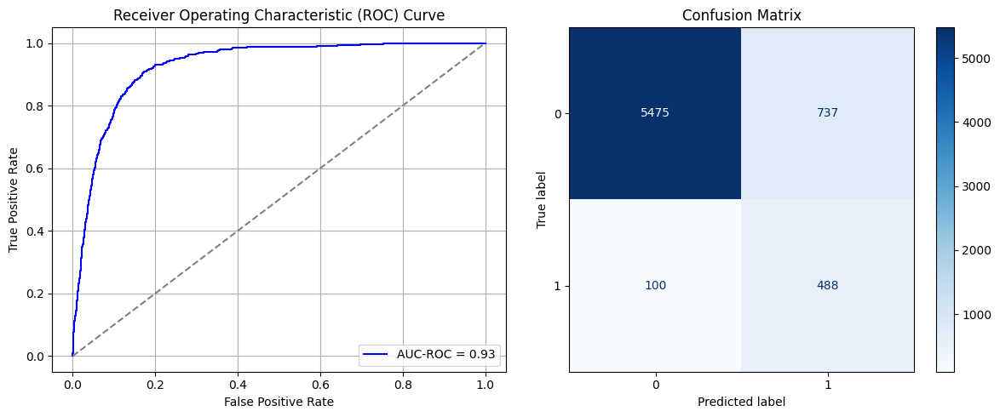

Best threshold based on F1-score: 0.6963268518447876
False Negative Rate: 0.17006802721088435
Time elapsed (performance): 0.8463493500021286
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1278/1278 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - AUC: 0.7986 - loss: 0.5440 - val_AUC: 0.8847 - val_loss: 0.4337
Epoch 2/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8837 - loss: 0.4288 - val_AUC: 0.8935 - val_loss: 0.4110
Epoch 3/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8899 - loss: 0.4162 - val_AUC: 0.8987 - val_loss: 0.4106
Epoch 4/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8988 - loss: 0.3998 - val_AUC: 0.9022 - val_loss: 0.3904
Epoch 5/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8996 - loss: 0.3965 - val_AUC: 0.9063 - val_loss: 0.3822
Epoch 6/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9047 - loss: 0.3856 - val_AUC: 0.9091 - val_loss: 0.3860
Epoch 7/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 9s 3ms/step - AUC: 0.9087 - loss: 0.3772 - val_AUC: 0.9114 - val_loss: 0.3716
Epoch 8/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.9122 - loss: 0.3691 - val_AUC: 0.9146 - val_loss: 0.3628
Epoch 9/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/st

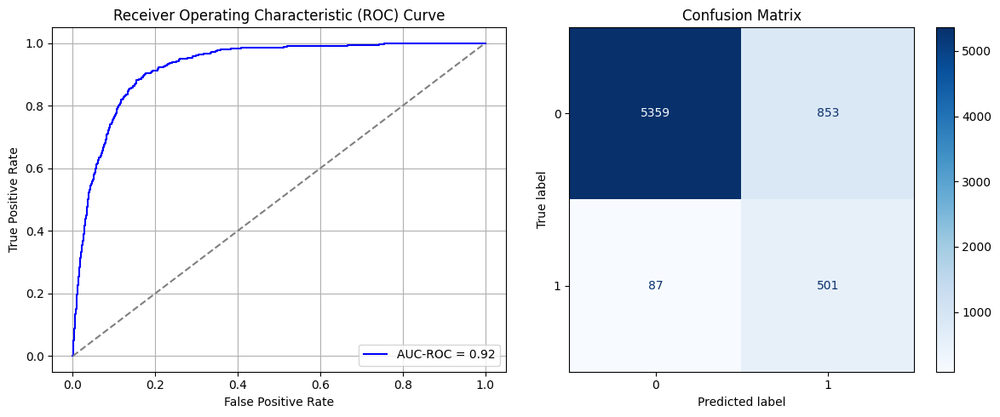

Best threshold based on F1-score: 0.7549628615379333
False Negative Rate: 0.14795918367346939
Time elapsed (performance): 1.2314657850001822
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/step - AUC: 0.7931 - loss: 0.5483 - val_AUC: 0.8884 - val_loss: 0.4426
Epoch 2/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8814 - loss: 0.4379 - val_AUC: 0.8928 - val_loss: 0.4154
Epoch 3/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 9s 3ms/step - AUC: 0.8901 - loss: 0.4188 - val_AUC: 0.8989 - val_loss: 0.4004
Epoch 4/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8982 - loss: 0.4017 - val_AUC: 0.9035 - val_loss: 0.3907
Epoch 5/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9034 - loss: 0.3899 - val_AUC: 0.9065 - val_loss: 0.3864
Epoch 6/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9077 - loss: 0.3809 - val_AUC: 0.9102 - val_loss: 0.3846
Epoch 7/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.9120 - loss: 0.3719 - val_AUC: 0.9127 - val_loss: 0.3764
Epoch 8/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9154 - loss: 0.3641 - val_AUC: 0.9133 - val_loss: 0.3798
Epoch 9/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/st

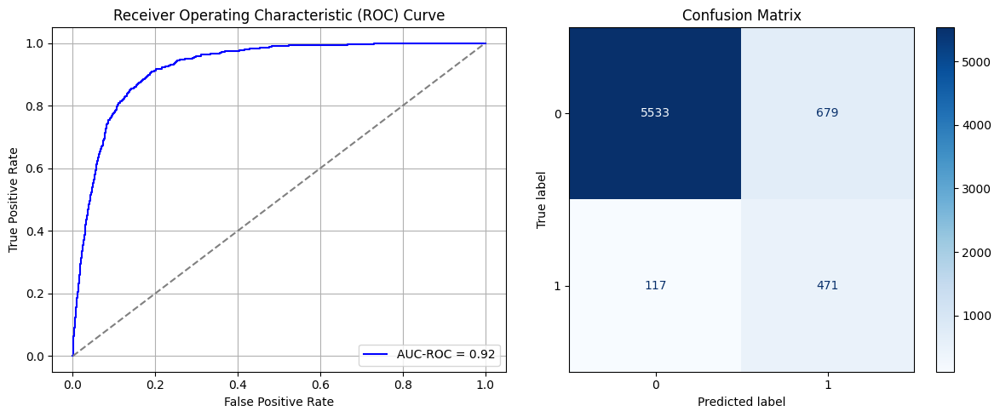

Best threshold based on F1-score: 0.5949008464813232
False Negative Rate: 0.1989795918367347
Time elapsed (performance): 0.8408112699980848
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1278/1278 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - AUC: 0.8003 - loss: 0.5452 - val_AUC: 0.8898 - val_loss: 0.4350
Epoch 2/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 9s 3ms/step - AUC: 0.8827 - loss: 0.4339 - val_AUC: 0.8954 - val_loss: 0.4099
Epoch 3/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - AUC: 0.8913 - loss: 0.4148 - val_AUC: 0.9012 - val_loss: 0.4013
Epoch 4/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8955 - loss: 0.4051 - val_AUC: 0.9039 - val_loss: 0.3876
Epoch 5/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.9014 - loss: 0.3936 - val_AUC: 0.9087 - val_loss: 0.3798
Epoch 6/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/step - AUC: 0.9070 - loss: 0.3819 - val_AUC: 0.9110 - val_loss: 0.3724
Epoch 7/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9076 - loss: 0.3787 - val_AUC: 0.9150 - val_loss: 0.3680
Epoch 8/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.9116 - loss: 0.3719 - val_AUC: 0.9150 - val_loss: 0.3816
Epoch 9/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 9s 3ms/st

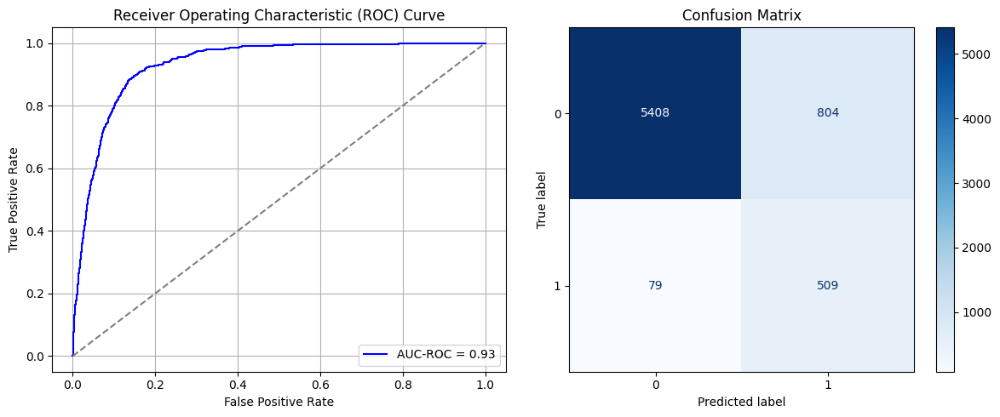

Best threshold based on F1-score: 0.6981437802314758
False Negative Rate: 0.13435374149659865
Time elapsed (performance): 1.0738315859998693


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 1/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 8s 5ms/step - AUC: 0.7955 - loss: 0.5485 - val_AUC: 0.8906 - val_loss: 0.4217
Epoch 2/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8822 - loss: 0.4328 - val_AUC: 0.8957 - val_loss: 0.4076
Epoch 3/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8910 - loss: 0.4146 - val_AUC: 0.9001 - val_loss: 0.3974
Epoch 4/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8958 - loss: 0.4050 - val_AUC: 0.9058 - val_loss: 0.3872
Epoch 5/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 9s 3ms/step - AUC: 0.9005 - loss: 0.3956 - val_AUC: 0.9086 - val_loss: 0.3785
Epoch 6/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.9055 - loss: 0.3846 - val_AUC: 0.9120 - val_loss: 0.3720
Epoch 7/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9068 - loss: 0.3807 - val_AUC: 0.9153 - val_loss: 0.3795
Epoch 8/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.9114 - loss: 0.3705 - val_AUC: 0.9170 - val_loss: 0.3598
Epoch 9/10
1278/1278 ━━━━━━━━━━━━━━━━━━━

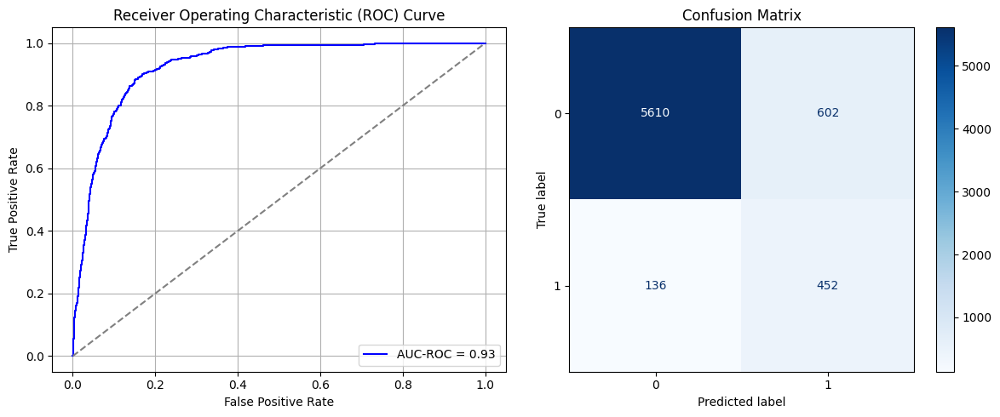

Best threshold based on F1-score: 0.6671731472015381
False Negative Rate: 0.23129251700680273
Time elapsed (performance): 1.0879707940002845
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1278/1278 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - AUC: 0.7881 - loss: 0.5499 - val_AUC: 0.8929 - val_loss: 0.4234
Epoch 2/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - AUC: 0.8849 - loss: 0.4265 - val_AUC: 0.8991 - val_loss: 0.4014
Epoch 3/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8924 - loss: 0.4110 - val_AUC: 0.9050 - val_loss: 0.3849
Epoch 4/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.9010 - loss: 0.3954 - val_AUC: 0.9111 - val_loss: 0.3728
Epoch 5/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9065 - loss: 0.3830 - val_AUC: 0.9146 - val_loss: 0.3660
Epoch 6/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 11s 5ms/step - AUC: 0.9112 - loss: 0.3720 - val_AUC: 0.9188 - val_loss: 0.3608
Epoch 7/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - AUC: 0.9128 - loss: 0.3685 - val_AUC: 0.9181 - val_loss: 0.3575
Epoch 8/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.9150 - loss: 0.3638 - val_AUC: 0.9210 - val_loss: 0.3487
Epoch 9/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 9s 3ms/s

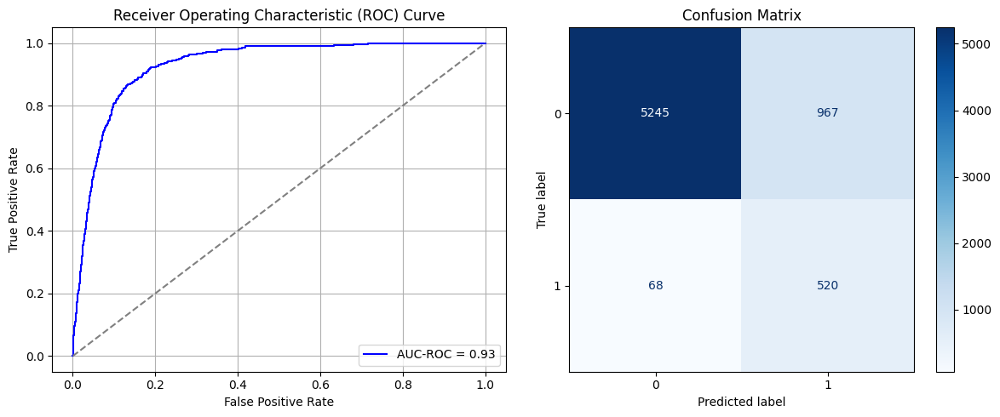

Best threshold based on F1-score: 0.9897446036338806
False Negative Rate: 0.11564625850340136
Time elapsed (performance): 0.8961942470014037
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1278/1278 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - AUC: 0.7866 - loss: 0.5535 - val_AUC: 0.8859 - val_loss: 0.4291
Epoch 2/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8842 - loss: 0.4285 - val_AUC: 0.8950 - val_loss: 0.4079
Epoch 3/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 10s 4ms/step - AUC: 0.8918 - loss: 0.4133 - val_AUC: 0.8999 - val_loss: 0.4140
Epoch 4/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 10s 4ms/step - AUC: 0.8987 - loss: 0.3990 - val_AUC: 0.9054 - val_loss: 0.3915
Epoch 5/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - AUC: 0.9040 - loss: 0.3885 - val_AUC: 0.9077 - val_loss: 0.3831
Epoch 6/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - AUC: 0.9065 - loss: 0.3825 - val_AUC: 0.9110 - val_loss: 0.3718
Epoch 7/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.9087 - loss: 0.3773 - val_AUC: 0.9133 - val_loss: 0.3794
Epoch 8/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 10s 4ms/step - AUC: 0.9132 - loss: 0.3686 - val_AUC: 0.9148 - val_loss: 0.3626
Epoch 9/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms

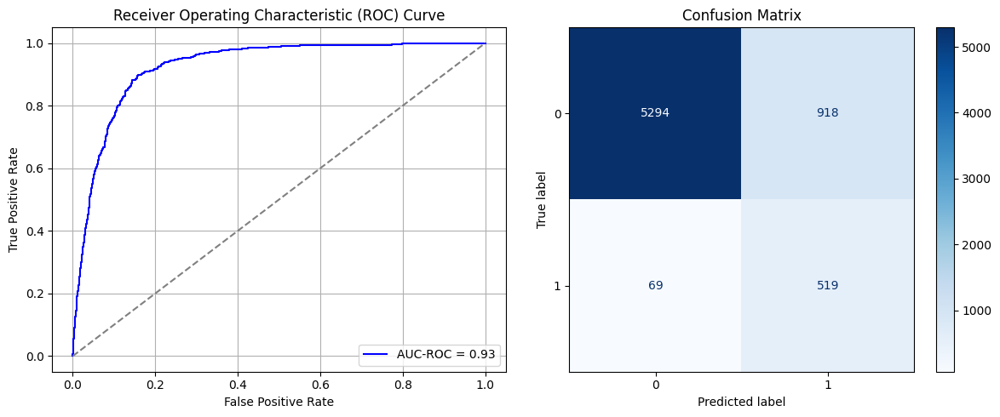

Best threshold based on F1-score: 0.7182603478431702
False Negative Rate: 0.11734693877551021
Time elapsed (performance): 0.9052619020003476
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1278/1278 ━━━━━━━━━━━━━━━━━━━━ 8s 5ms/step - AUC: 0.7890 - loss: 0.5518 - val_AUC: 0.8829 - val_loss: 0.4374
Epoch 2/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 8s 4ms/step - AUC: 0.8821 - loss: 0.4332 - val_AUC: 0.8894 - val_loss: 0.4342
Epoch 3/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - AUC: 0.8897 - loss: 0.4167 - val_AUC: 0.8964 - val_loss: 0.4055
Epoch 4/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8953 - loss: 0.4053 - val_AUC: 0.9013 - val_loss: 0.3930
Epoch 5/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 10s 4ms/step - AUC: 0.9029 - loss: 0.3903 - val_AUC: 0.9065 - val_loss: 0.3820
Epoch 6/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 11s 5ms/step - AUC: 0.9063 - loss: 0.3819 - val_AUC: 0.9099 - val_loss: 0.3761
Epoch 7/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - AUC: 0.9110 - loss: 0.3718 - val_AUC: 0.9118 - val_loss: 0.3714
Epoch 8/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.9132 - loss: 0.3676 - val_AUC: 0.9137 - val_loss: 0.3663
Epoch 9/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/

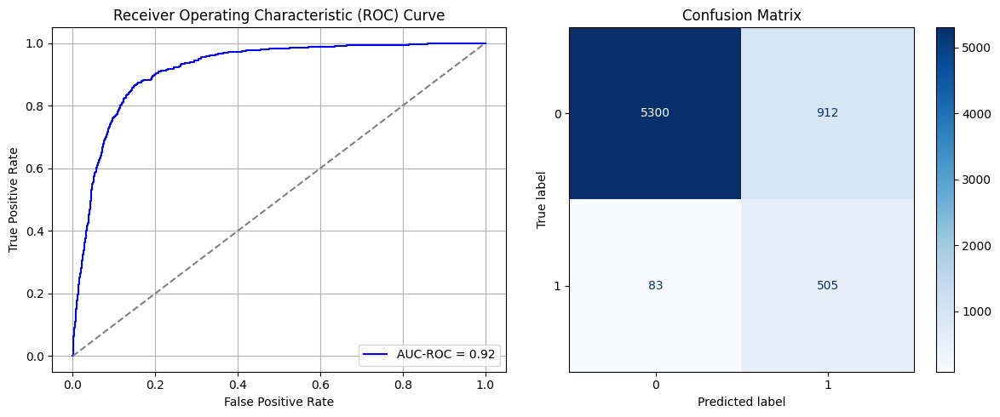

Best threshold based on F1-score: 0.9838832020759583
False Negative Rate: 0.141156462585034
Time elapsed (performance): 1.7475657420000061
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1278/1278 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - AUC: 0.7817 - loss: 0.5561 - val_AUC: 0.8906 - val_loss: 0.4338
Epoch 2/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8846 - loss: 0.4294 - val_AUC: 0.8975 - val_loss: 0.4043
Epoch 3/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - AUC: 0.8907 - loss: 0.4139 - val_AUC: 0.9006 - val_loss: 0.3985
Epoch 4/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - AUC: 0.8978 - loss: 0.4013 - val_AUC: 0.9048 - val_loss: 0.3873
Epoch 5/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9004 - loss: 0.3948 - val_AUC: 0.9089 - val_loss: 0.3806
Epoch 6/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.9043 - loss: 0.3871 - val_AUC: 0.9123 - val_loss: 0.3700
Epoch 7/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - AUC: 0.9083 - loss: 0.3767 - val_AUC: 0.9150 - val_loss: 0.3645
Epoch 8/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - AUC: 0.9096 - loss: 0.3754 - val_AUC: 0.9175 - val_loss: 0.3581
Epoch 9/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/st

<ipython-input-76-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
AUC-ROC: 0.9306950887244789
Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.83      0.90      6212
           1       0.33      0.90      0.48       588

    accuracy                           0.83      6800
   macro avg       0.66      0.87      0.69      6800
weighted avg       0.93      0.83      0.86      6800

FPR 0.17369607211848037 TPR: 0.9047619047619048 FNR: 0.09523809523809523 TNR: 0.8263039278815196


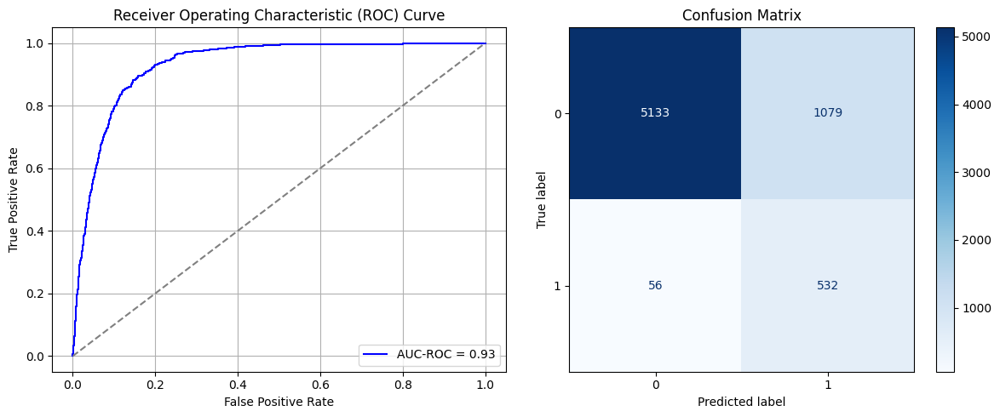

Best threshold based on F1-score: 0.7972902655601501
False Negative Rate: 0.09523809523809523
Time elapsed (performance): 0.9474638670035347
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1278/1278 ━━━━━━━━━━━━━━━━━━━━ 8s 5ms/step - AUC: 0.7962 - loss: 0.5469 - val_AUC: 0.8886 - val_loss: 0.4241
Epoch 2/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 8s 4ms/step - AUC: 0.8845 - loss: 0.4278 - val_AUC: 0.8943 - val_loss: 0.4209
Epoch 3/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - AUC: 0.8897 - loss: 0.4155 - val_AUC: 0.9001 - val_loss: 0.4059
Epoch 4/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 8s 4ms/step - AUC: 0.8963 - loss: 0.4026 - val_AUC: 0.9032 - val_loss: 0.3936
Epoch 5/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - AUC: 0.8990 - loss: 0.3977 - val_AUC: 0.9054 - val_loss: 0.3854
Epoch 6/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9026 - loss: 0.3903 - val_AUC: 0.9081 - val_loss: 0.3793
Epoch 7/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9058 - loss: 0.3840 - val_AUC: 0.9119 - val_loss: 0.3698
Epoch 8/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 11s 5ms/step - AUC: 0.9093 - loss: 0.3762 - val_AUC: 0.9096 - val_loss: 0.3742
Epoch 9/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/s

<ipython-input-76-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
AUC-ROC: 0.9282905370776772
Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.83      0.90      6212
           1       0.34      0.89      0.49       588

    accuracy                           0.84      6800
   macro avg       0.66      0.86      0.70      6800
weighted avg       0.93      0.84      0.87      6800

FPR 0.16580811332904058 TPR: 0.891156462585034 FNR: 0.10884353741496598 TNR: 0.8341918866709594


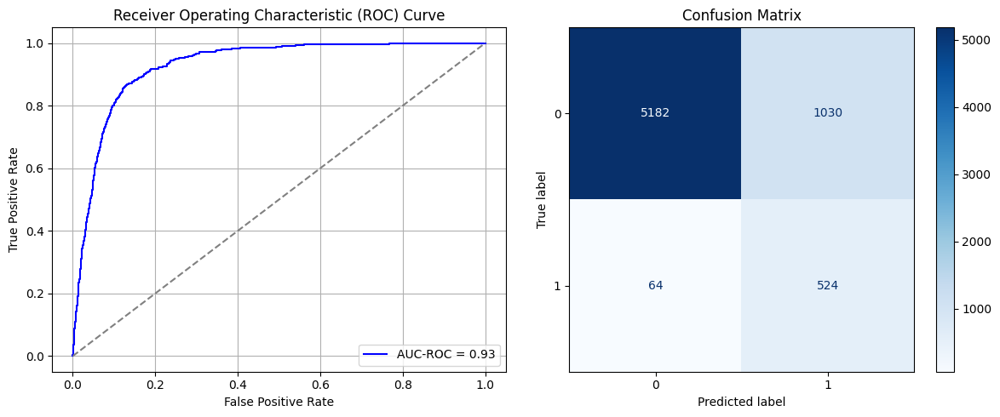

Best threshold based on F1-score: 0.7486352920532227
False Negative Rate: 0.10884353741496598
Time elapsed (performance): 0.9197402540012263
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1278/1278 ━━━━━━━━━━━━━━━━━━━━ 8s 4ms/step - AUC: 0.7967 - loss: 0.5465 - val_AUC: 0.8889 - val_loss: 0.4213
Epoch 2/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 11s 5ms/step - AUC: 0.8835 - loss: 0.4292 - val_AUC: 0.8926 - val_loss: 0.4133
Epoch 3/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8867 - loss: 0.4222 - val_AUC: 0.8982 - val_loss: 0.4002
Epoch 4/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8923 - loss: 0.4105 - val_AUC: 0.9002 - val_loss: 0.4039
Epoch 5/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8935 - loss: 0.4078 - val_AUC: 0.9028 - val_loss: 0.3887
Epoch 6/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9007 - loss: 0.3944 - val_AUC: 0.9075 - val_loss: 0.3789
Epoch 7/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - AUC: 0.9017 - loss: 0.3905 - val_AUC: 0.9097 - val_loss: 0.3757
Epoch 8/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - AUC: 0.9065 - loss: 0.3811 - val_AUC: 0.9123 - val_loss: 0.3691
Epoch 9/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/s

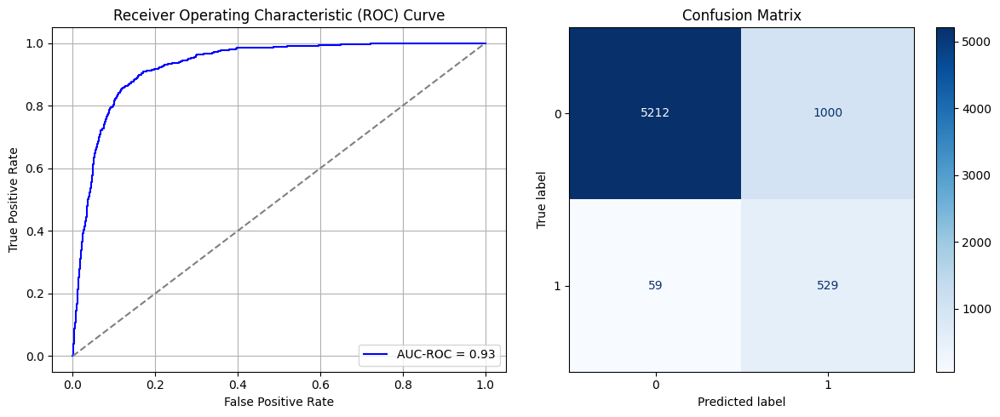

Best threshold based on F1-score: 0.9856288433074951
False Negative Rate: 0.10034013605442177
Time elapsed (performance): 1.0829096469969954
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1278/1278 ━━━━━━━━━━━━━━━━━━━━ 8s 5ms/step - AUC: 0.7867 - loss: 0.5530 - val_AUC: 0.8883 - val_loss: 0.4276
Epoch 2/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - AUC: 0.8850 - loss: 0.4270 - val_AUC: 0.8913 - val_loss: 0.4186
Epoch 3/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - AUC: 0.8881 - loss: 0.4187 - val_AUC: 0.8959 - val_loss: 0.4064
Epoch 4/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - AUC: 0.8970 - loss: 0.4015 - val_AUC: 0.9003 - val_loss: 0.3958
Epoch 5/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 8s 4ms/step - AUC: 0.8977 - loss: 0.3993 - val_AUC: 0.9030 - val_loss: 0.3888
Epoch 6/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.9020 - loss: 0.3911 - val_AUC: 0.9069 - val_loss: 0.3799
Epoch 7/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 8s 4ms/step - AUC: 0.9052 - loss: 0.3834 - val_AUC: 0.9118 - val_loss: 0.3711
Epoch 8/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.9090 - loss: 0.3766 - val_AUC: 0.9145 - val_loss: 0.3641
Epoch 9/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/st

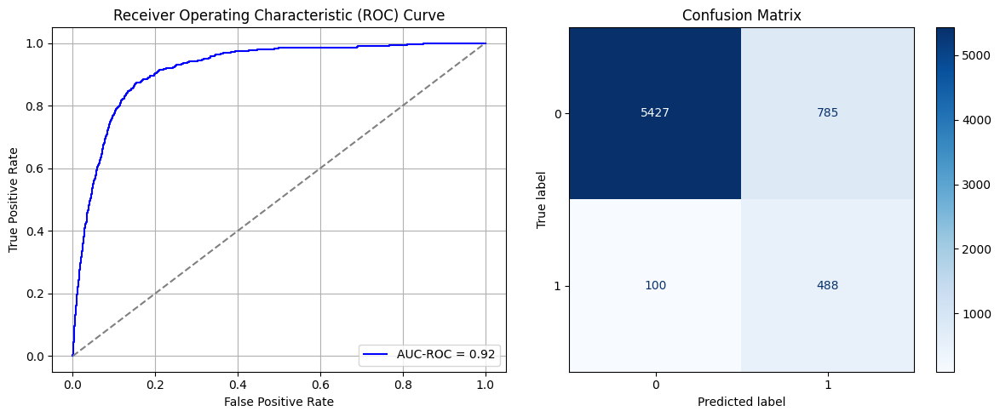

Best threshold based on F1-score: 0.6258212327957153
False Negative Rate: 0.17006802721088435
Time elapsed (performance): 0.8723099559974798
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1278/1278 ━━━━━━━━━━━━━━━━━━━━ 8s 5ms/step - AUC: 0.7850 - loss: 0.5548 - val_AUC: 0.8912 - val_loss: 0.4191
Epoch 2/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8847 - loss: 0.4268 - val_AUC: 0.8985 - val_loss: 0.4108
Epoch 3/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8922 - loss: 0.4127 - val_AUC: 0.9055 - val_loss: 0.3855
Epoch 4/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 8s 6ms/step - AUC: 0.8998 - loss: 0.3966 - val_AUC: 0.9108 - val_loss: 0.3739
Epoch 5/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9087 - loss: 0.3785 - val_AUC: 0.9138 - val_loss: 0.3669
Epoch 6/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - AUC: 0.9099 - loss: 0.3758 - val_AUC: 0.9162 - val_loss: 0.3597
Epoch 7/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9128 - loss: 0.3683 - val_AUC: 0.9193 - val_loss: 0.3553
Epoch 8/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9157 - loss: 0.3621 - val_AUC: 0.9203 - val_loss: 0.3537
Epoch 9/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/st

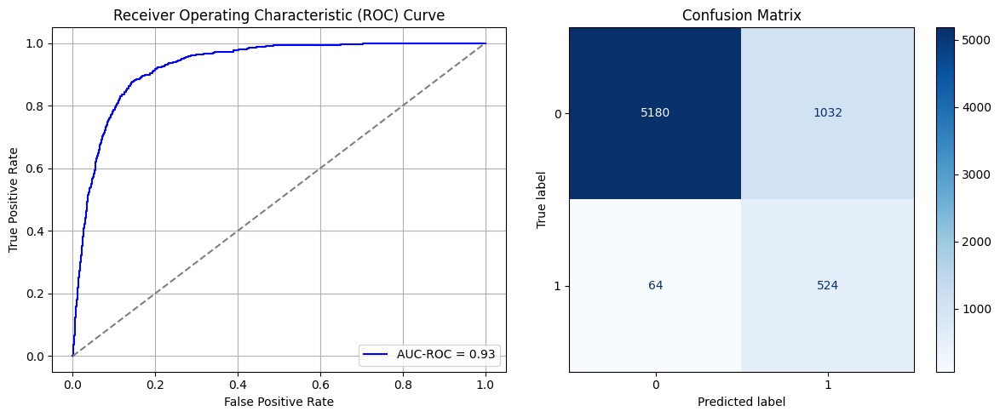

Best threshold based on F1-score: 0.9915437698364258
False Negative Rate: 0.10884353741496598
Time elapsed (performance): 1.0714177669979108
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1278/1278 ━━━━━━━━━━━━━━━━━━━━ 9s 5ms/step - AUC: 0.7773 - loss: 0.5607 - val_AUC: 0.8863 - val_loss: 0.4296
Epoch 2/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 8s 4ms/step - AUC: 0.8836 - loss: 0.4306 - val_AUC: 0.8903 - val_loss: 0.4243
Epoch 3/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8867 - loss: 0.4215 - val_AUC: 0.8945 - val_loss: 0.4124
Epoch 4/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8935 - loss: 0.4079 - val_AUC: 0.8995 - val_loss: 0.4022
Epoch 5/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8985 - loss: 0.3979 - val_AUC: 0.9032 - val_loss: 0.3891
Epoch 6/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 10s 4ms/step - AUC: 0.9028 - loss: 0.3889 - val_AUC: 0.9062 - val_loss: 0.3827
Epoch 7/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - AUC: 0.9049 - loss: 0.3845 - val_AUC: 0.9076 - val_loss: 0.3861
Epoch 8/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - AUC: 0.9059 - loss: 0.3813 - val_AUC: 0.9109 - val_loss: 0.3783
Epoch 9/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/s

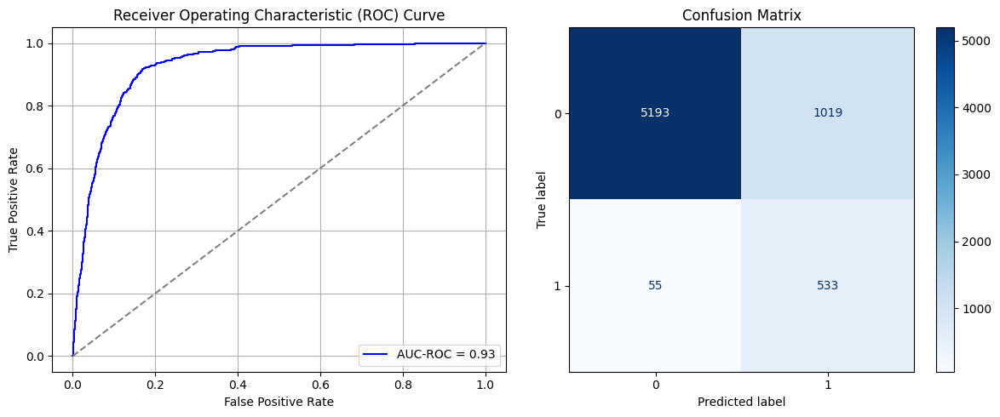

Best threshold based on F1-score: 0.7819944024085999
False Negative Rate: 0.0935374149659864
Time elapsed (performance): 1.7396674680021533
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1278/1278 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - AUC: 0.7819 - loss: 0.5592 - val_AUC: 0.8848 - val_loss: 0.4331
Epoch 2/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8826 - loss: 0.4333 - val_AUC: 0.8890 - val_loss: 0.4259
Epoch 3/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8877 - loss: 0.4209 - val_AUC: 0.8943 - val_loss: 0.4152
Epoch 4/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 11s 5ms/step - AUC: 0.8936 - loss: 0.4081 - val_AUC: 0.8979 - val_loss: 0.3997
Epoch 5/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - AUC: 0.8958 - loss: 0.4028 - val_AUC: 0.9023 - val_loss: 0.3907
Epoch 6/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - AUC: 0.9018 - loss: 0.3905 - val_AUC: 0.9060 - val_loss: 0.3836
Epoch 7/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9048 - loss: 0.3842 - val_AUC: 0.9089 - val_loss: 0.3807
Epoch 8/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 10s 7ms/step - AUC: 0.9077 - loss: 0.3784 - val_AUC: 0.9099 - val_loss: 0.3741
Epoch 9/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 7s 6ms/

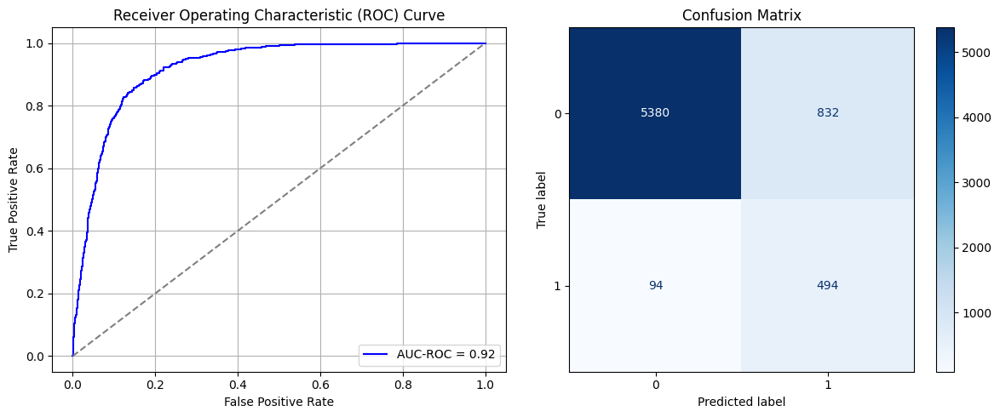

<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Best threshold based on F1-score: 0.9910763502120972
False Negative Rate: 0.1598639455782313
Time elapsed (performance): 1.2797382360004121
Epoch 1/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 8s 4ms/step - AUC: 0.7783 - loss: 0.5597 - val_AUC: 0.8885 - val_loss: 0.4272
Epoch 2/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8848 - loss: 0.4288 - val_AUC: 0.8938 - val_loss: 0.4114
Epoch 3/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 10s 4ms/step - AUC: 0.8929 - loss: 0.4121 - val_AUC: 0.8994 - val_loss: 0.4073
Epoch 4/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - AUC: 0.8959 - loss: 0.4048 - val_AUC: 0.9045 - val_loss: 0.3876
Epoch 5/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - AUC: 0.9020 - loss: 0.3929 - val_AUC: 0.9066 - val_loss: 0.3859
Epoch 6/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - AUC: 0.9061 - loss: 0.3840 - val_AUC: 0.9109 - val_loss: 0.3767
Epoch 7/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - AUC: 0.9091 - loss: 0.3761 - val_AUC: 0.9130 - val_loss: 0.3674
Epoch 8/10
1278/127

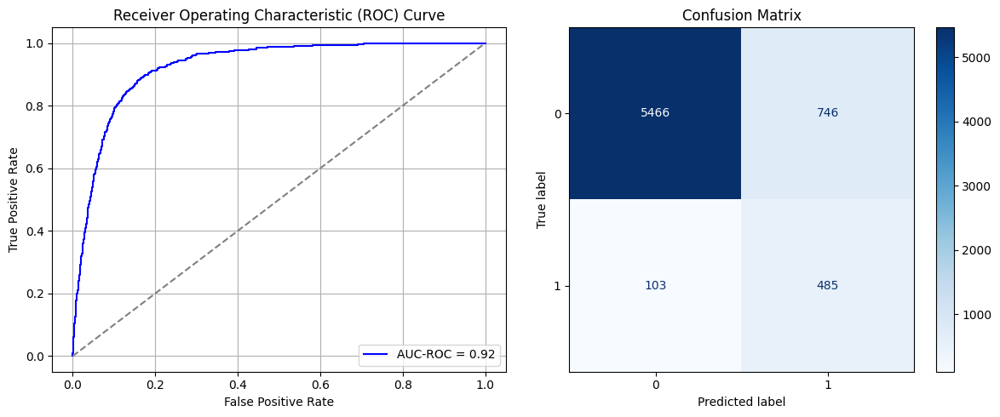

Best threshold based on F1-score: 0.664498507976532
False Negative Rate: 0.17517006802721088
Time elapsed (performance): 1.121855567998864
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1278/1278 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - AUC: 0.7838 - loss: 0.5550 - val_AUC: 0.8900 - val_loss: 0.4262
Epoch 2/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 10s 4ms/step - AUC: 0.8839 - loss: 0.4305 - val_AUC: 0.8954 - val_loss: 0.4080
Epoch 3/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8916 - loss: 0.4134 - val_AUC: 0.8995 - val_loss: 0.3978
Epoch 4/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8960 - loss: 0.4033 - val_AUC: 0.9040 - val_loss: 0.3883
Epoch 5/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9016 - loss: 0.3926 - val_AUC: 0.9095 - val_loss: 0.3771
Epoch 6/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.9054 - loss: 0.3840 - val_AUC: 0.9122 - val_loss: 0.3670
Epoch 7/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - AUC: 0.9076 - loss: 0.3782 - val_AUC: 0.9150 - val_loss: 0.3614
Epoch 8/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.9118 - loss: 0.3688 - val_AUC: 0.9156 - val_loss: 0.3750
Epoch 9/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/s

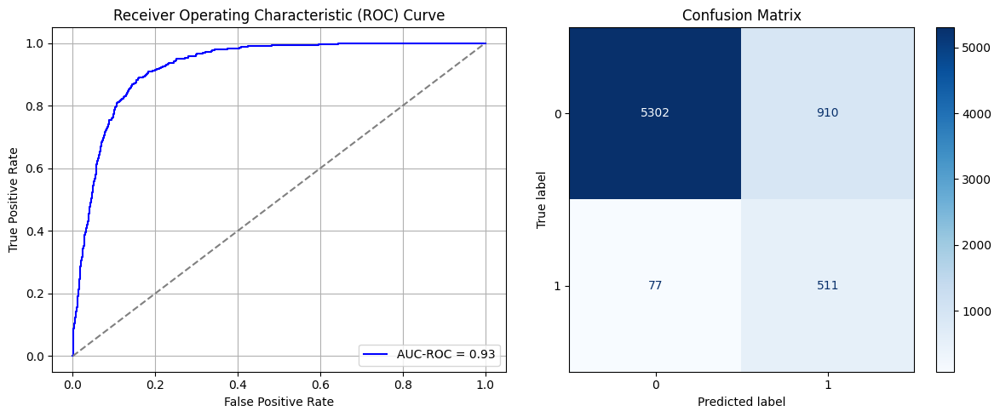

Best threshold based on F1-score: 0.7544677257537842
False Negative Rate: 0.13095238095238096
Time elapsed (performance): 1.2522876580005686
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1278/1278 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - AUC: 0.7953 - loss: 0.5478 - val_AUC: 0.8898 - val_loss: 0.4278
Epoch 2/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8825 - loss: 0.4342 - val_AUC: 0.8949 - val_loss: 0.4679
Epoch 3/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8911 - loss: 0.4175 - val_AUC: 0.8996 - val_loss: 0.3992
Epoch 4/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8987 - loss: 0.3998 - val_AUC: 0.9047 - val_loss: 0.3881
Epoch 5/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - AUC: 0.9010 - loss: 0.3940 - val_AUC: 0.9069 - val_loss: 0.3926
Epoch 6/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.9053 - loss: 0.3854 - val_AUC: 0.9096 - val_loss: 0.3794
Epoch 7/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - AUC: 0.9113 - loss: 0.3730 - val_AUC: 0.9125 - val_loss: 0.3711
Epoch 8/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - AUC: 0.9123 - loss: 0.3696 - val_AUC: 0.9142 - val_loss: 0.3667
Epoch 9/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 8s 4ms/st

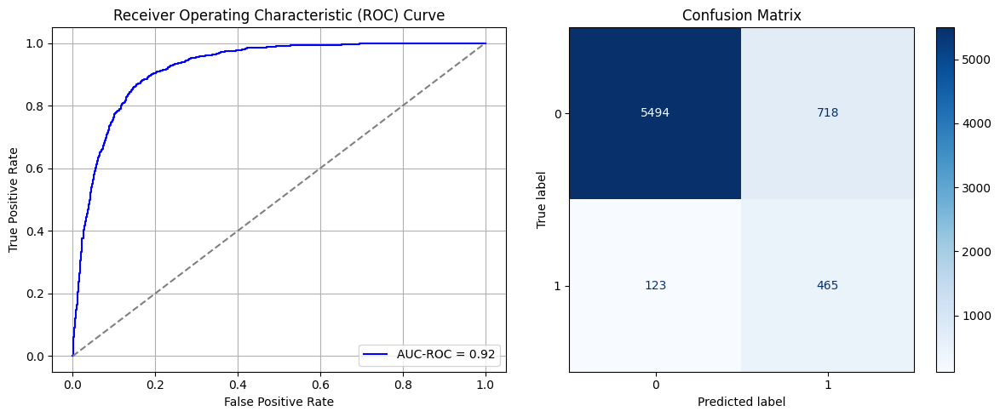

Best threshold based on F1-score: 0.7361454367637634
False Negative Rate: 0.20918367346938777
Time elapsed (performance): 0.8716240239991748
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1278/1278 ━━━━━━━━━━━━━━━━━━━━ 8s 5ms/step - AUC: 0.7829 - loss: 0.5572 - val_AUC: 0.8896 - val_loss: 0.4234
Epoch 2/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8832 - loss: 0.4311 - val_AUC: 0.8957 - val_loss: 0.4062
Epoch 3/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8918 - loss: 0.4132 - val_AUC: 0.9009 - val_loss: 0.3933
Epoch 4/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - AUC: 0.8964 - loss: 0.4032 - val_AUC: 0.9080 - val_loss: 0.3793
Epoch 5/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.9021 - loss: 0.3907 - val_AUC: 0.9102 - val_loss: 0.3774
Epoch 6/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - AUC: 0.9053 - loss: 0.3848 - val_AUC: 0.9137 - val_loss: 0.3684
Epoch 7/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.9098 - loss: 0.3749 - val_AUC: 0.9144 - val_loss: 0.3777
Epoch 8/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9111 - loss: 0.3723 - val_AUC: 0.9158 - val_loss: 0.3772
Epoch 9/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/st

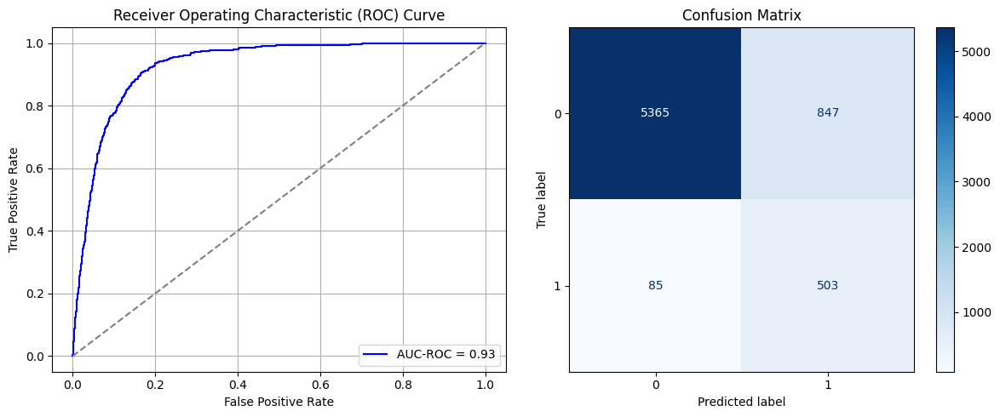

Best threshold based on F1-score: 0.718261182308197
False Negative Rate: 0.1445578231292517
Time elapsed (performance): 1.9371477170025173
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1278/1278 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - AUC: 0.7975 - loss: 0.5462 - val_AUC: 0.8874 - val_loss: 0.4353
Epoch 2/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8845 - loss: 0.4316 - val_AUC: 0.8921 - val_loss: 0.4148
Epoch 3/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 10s 4ms/step - AUC: 0.8919 - loss: 0.4147 - val_AUC: 0.8977 - val_loss: 0.4219
Epoch 4/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8973 - loss: 0.4032 - val_AUC: 0.9031 - val_loss: 0.3903
Epoch 5/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9019 - loss: 0.3929 - val_AUC: 0.9073 - val_loss: 0.3841
Epoch 6/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9067 - loss: 0.3840 - val_AUC: 0.9117 - val_loss: 0.3719
Epoch 7/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - AUC: 0.9111 - loss: 0.3731 - val_AUC: 0.9139 - val_loss: 0.3685
Epoch 8/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - AUC: 0.9140 - loss: 0.3664 - val_AUC: 0.9159 - val_loss: 0.3598
Epoch 9/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/s

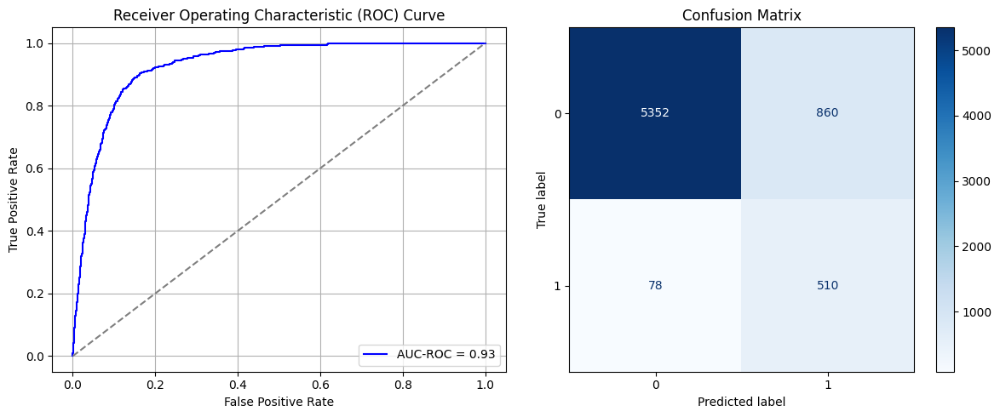

Best threshold based on F1-score: 0.7191545367240906
False Negative Rate: 0.1326530612244898
Time elapsed (performance): 1.275695853997604
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1278/1278 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - AUC: 0.7800 - loss: 0.5592 - val_AUC: 0.8867 - val_loss: 0.4324
Epoch 2/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 10s 4ms/step - AUC: 0.8810 - loss: 0.4359 - val_AUC: 0.8934 - val_loss: 0.4128
Epoch 3/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 11s 5ms/step - AUC: 0.8878 - loss: 0.4216 - val_AUC: 0.8976 - val_loss: 0.4012
Epoch 4/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 8s 4ms/step - AUC: 0.8932 - loss: 0.4097 - val_AUC: 0.9047 - val_loss: 0.3866
Epoch 5/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - AUC: 0.9042 - loss: 0.3886 - val_AUC: 0.9089 - val_loss: 0.3765
Epoch 6/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - AUC: 0.9068 - loss: 0.3821 - val_AUC: 0.9128 - val_loss: 0.3780
Epoch 7/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9104 - loss: 0.3748 - val_AUC: 0.9132 - val_loss: 0.3843
Epoch 8/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 11s 5ms/step - AUC: 0.9133 - loss: 0.3686 - val_AUC: 0.9150 - val_loss: 0.3619
Epoch 9/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms

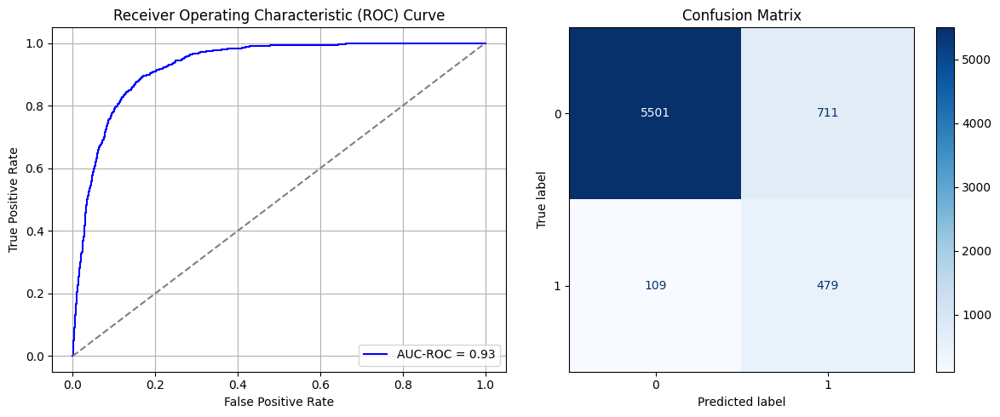

Best threshold based on F1-score: 0.697119414806366
False Negative Rate: 0.18537414965986396
Time elapsed (performance): 0.9648560470013763
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1278/1278 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - AUC: 0.7850 - loss: 0.5565 - val_AUC: 0.8886 - val_loss: 0.4241
Epoch 2/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 10s 4ms/step - AUC: 0.8839 - loss: 0.4306 - val_AUC: 0.8939 - val_loss: 0.4188
Epoch 3/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8868 - loss: 0.4224 - val_AUC: 0.8994 - val_loss: 0.4060
Epoch 4/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8920 - loss: 0.4123 - val_AUC: 0.9039 - val_loss: 0.3966
Epoch 5/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 10s 4ms/step - AUC: 0.8995 - loss: 0.3980 - val_AUC: 0.9080 - val_loss: 0.3841
Epoch 6/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 10s 4ms/step - AUC: 0.9010 - loss: 0.3945 - val_AUC: 0.9115 - val_loss: 0.3731
Epoch 7/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - AUC: 0.9078 - loss: 0.3805 - val_AUC: 0.9145 - val_loss: 0.3669
Epoch 8/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - AUC: 0.9121 - loss: 0.3717 - val_AUC: 0.9162 - val_loss: 0.3622
Epoch 9/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms

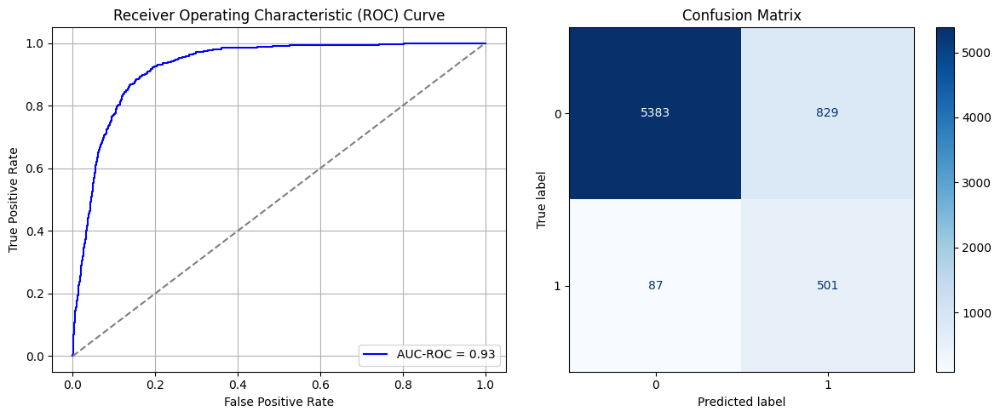

Best threshold based on F1-score: 0.7427000999450684
False Negative Rate: 0.14795918367346939
Time elapsed (performance): 0.9456949980012723
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1278/1278 ━━━━━━━━━━━━━━━━━━━━ 9s 5ms/step - AUC: 0.7885 - loss: 0.5524 - val_AUC: 0.8881 - val_loss: 0.4233
Epoch 2/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8840 - loss: 0.4283 - val_AUC: 0.8928 - val_loss: 0.4394
Epoch 3/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - AUC: 0.8900 - loss: 0.4163 - val_AUC: 0.8963 - val_loss: 0.4066
Epoch 4/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 8s 4ms/step - AUC: 0.8938 - loss: 0.4084 - val_AUC: 0.9006 - val_loss: 0.3934
Epoch 5/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.9008 - loss: 0.3948 - val_AUC: 0.9041 - val_loss: 0.3876
Epoch 6/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - AUC: 0.9018 - loss: 0.3914 - val_AUC: 0.9083 - val_loss: 0.3783
Epoch 7/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - AUC: 0.9047 - loss: 0.3841 - val_AUC: 0.9099 - val_loss: 0.3743
Epoch 8/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9071 - loss: 0.3812 - val_AUC: 0.9134 - val_loss: 0.3650
Epoch 9/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/st

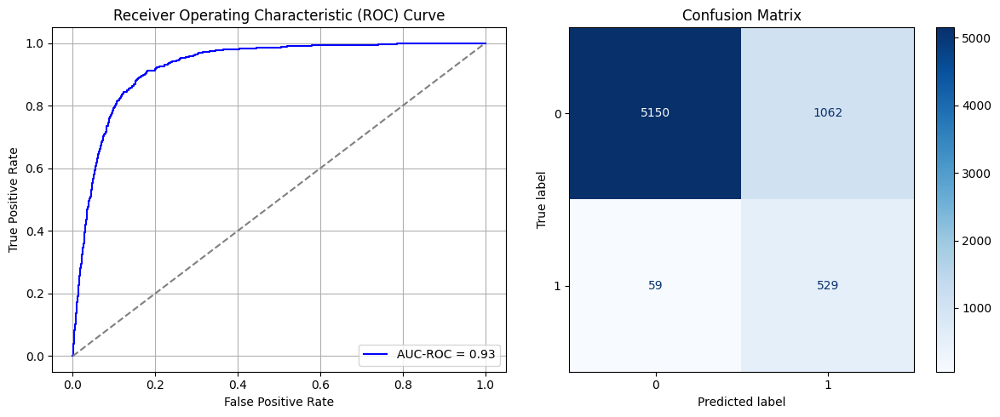

Best threshold based on F1-score: 0.7420137524604797
False Negative Rate: 0.10034013605442177
Time elapsed (performance): 1.2937444719973428
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1278/1278 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - AUC: 0.7699 - loss: 0.5671 - val_AUC: 0.8843 - val_loss: 0.4419
Epoch 2/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8827 - loss: 0.4350 - val_AUC: 0.8934 - val_loss: 0.4229
Epoch 3/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8907 - loss: 0.4170 - val_AUC: 0.8988 - val_loss: 0.3999
Epoch 4/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 10s 5ms/step - AUC: 0.8946 - loss: 0.4072 - val_AUC: 0.9051 - val_loss: 0.3890
Epoch 5/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - AUC: 0.8998 - loss: 0.3962 - val_AUC: 0.9090 - val_loss: 0.3960
Epoch 6/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.9081 - loss: 0.3794 - val_AUC: 0.9141 - val_loss: 0.3656
Epoch 7/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - AUC: 0.9101 - loss: 0.3738 - val_AUC: 0.9165 - val_loss: 0.3613
Epoch 8/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - AUC: 0.9128 - loss: 0.3686 - val_AUC: 0.9172 - val_loss: 0.3601
Epoch 9/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/s

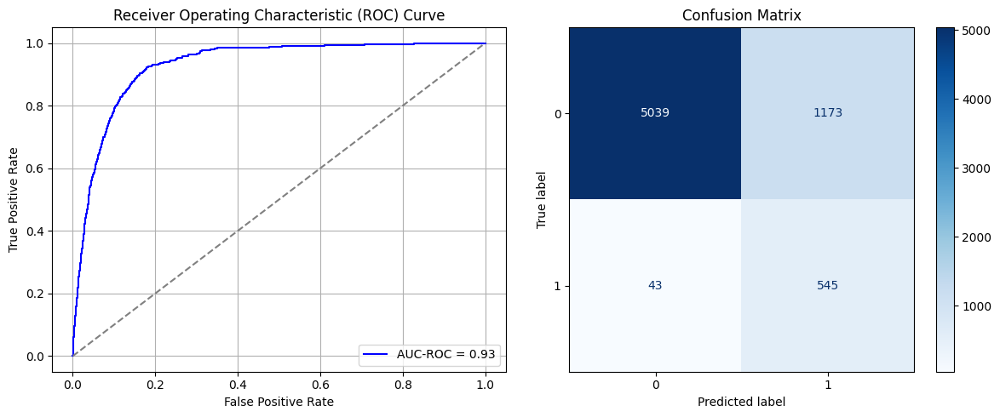

<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Best threshold based on F1-score: 0.9931551218032837
False Negative Rate: 0.07312925170068027
Time elapsed (performance): 1.2678854980003962
Epoch 1/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - AUC: 0.7961 - loss: 0.5469 - val_AUC: 0.8905 - val_loss: 0.4249
Epoch 2/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 11s 5ms/step - AUC: 0.8842 - loss: 0.4321 - val_AUC: 0.8980 - val_loss: 0.4066
Epoch 3/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8936 - loss: 0.4117 - val_AUC: 0.9022 - val_loss: 0.3933
Epoch 4/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8979 - loss: 0.4021 - val_AUC: 0.9085 - val_loss: 0.3814
Epoch 5/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - AUC: 0.9044 - loss: 0.3876 - val_AUC: 0.9105 - val_loss: 0.3764
Epoch 6/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - AUC: 0.9086 - loss: 0.3779 - val_AUC: 0.9129 - val_loss: 0.3676
Epoch 7/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.9082 - loss: 0.3793 - val_AUC: 0.9156 - val_loss: 0.3719
Epoch 8/10
1278/12

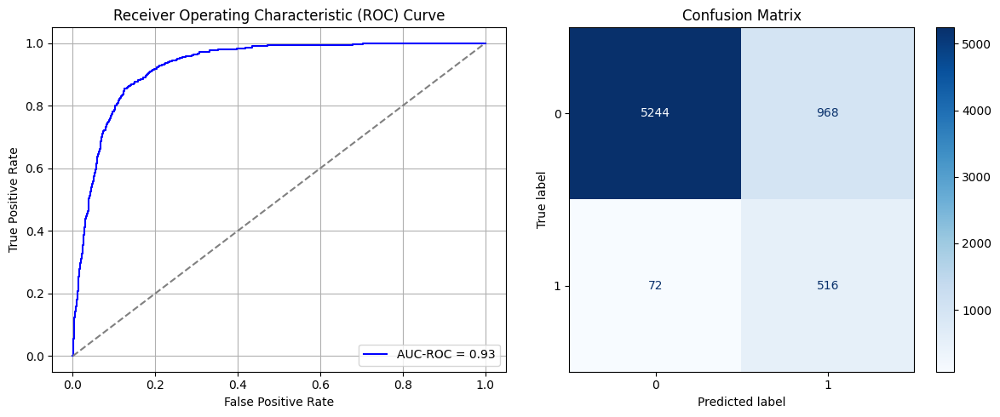

Best threshold based on F1-score: 0.7358750104904175
False Negative Rate: 0.12244897959183673
Time elapsed (performance): 1.060477715000161
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1278/1278 ━━━━━━━━━━━━━━━━━━━━ 8s 5ms/step - AUC: 0.7952 - loss: 0.5472 - val_AUC: 0.8901 - val_loss: 0.4219
Epoch 2/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 8s 4ms/step - AUC: 0.8833 - loss: 0.4295 - val_AUC: 0.8948 - val_loss: 0.4261
Epoch 3/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - AUC: 0.8935 - loss: 0.4091 - val_AUC: 0.9011 - val_loss: 0.3930
Epoch 4/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8980 - loss: 0.3987 - val_AUC: 0.9034 - val_loss: 0.3882
Epoch 5/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 11s 5ms/step - AUC: 0.9015 - loss: 0.3922 - val_AUC: 0.9085 - val_loss: 0.3781
Epoch 6/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 10s 5ms/step - AUC: 0.9066 - loss: 0.3815 - val_AUC: 0.9110 - val_loss: 0.3711
Epoch 7/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.9085 - loss: 0.3771 - val_AUC: 0.9122 - val_loss: 0.3804
Epoch 8/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9099 - loss: 0.3742 - val_AUC: 0.9144 - val_loss: 0.3640
Epoch 9/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/

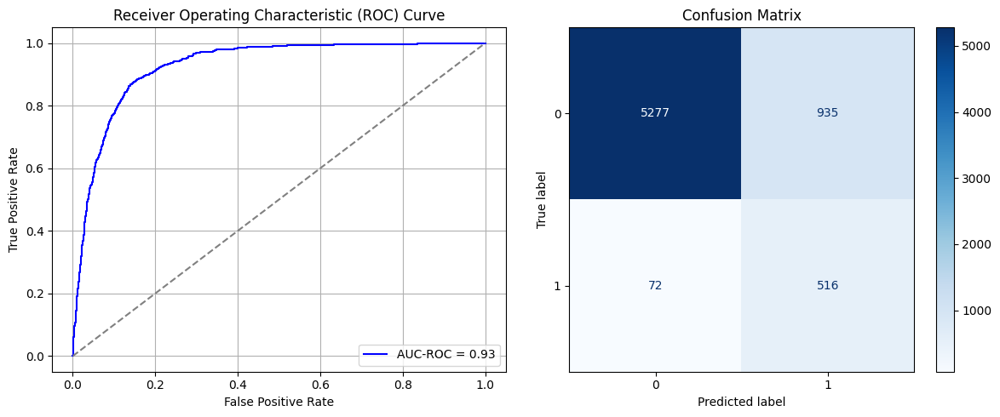

<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Best threshold based on F1-score: 0.9808072447776794
False Negative Rate: 0.12244897959183673
Time elapsed (performance): 1.145879491999949
Epoch 1/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 8s 4ms/step - AUC: 0.7782 - loss: 0.5584 - val_AUC: 0.8875 - val_loss: 0.4622
Epoch 2/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8806 - loss: 0.4367 - val_AUC: 0.8916 - val_loss: 0.4228
Epoch 3/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 10s 4ms/step - AUC: 0.8898 - loss: 0.4177 - val_AUC: 0.8943 - val_loss: 0.4089
Epoch 4/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8937 - loss: 0.4087 - val_AUC: 0.8995 - val_loss: 0.3994
Epoch 5/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - AUC: 0.8960 - loss: 0.4039 - val_AUC: 0.9024 - val_loss: 0.3951
Epoch 6/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8994 - loss: 0.3978 - val_AUC: 0.9054 - val_loss: 0.3850
Epoch 7/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.9017 - loss: 0.3919 - val_AUC: 0.9069 - val_loss: 0.3959
Epoch 8/10
1278/127

<ipython-input-76-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
AUC-ROC: 0.9271493127192925
Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.83      0.90      6212
           1       0.33      0.91      0.49       588

    accuracy                           0.83      6800
   macro avg       0.66      0.87      0.69      6800
weighted avg       0.93      0.83      0.87      6800

FPR 0.1725692208628461 TPR: 0.9098639455782312 FNR: 0.09013605442176871 TNR: 0.8274307791371539


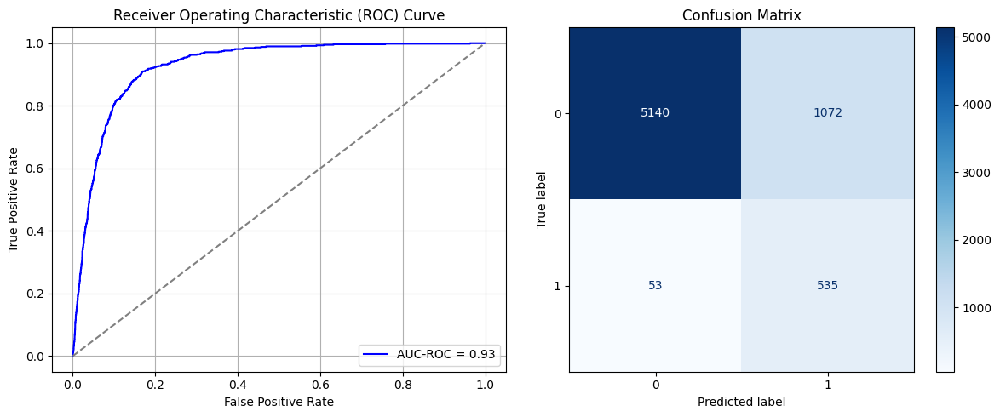

Best threshold based on F1-score: 0.7545726895332336
False Negative Rate: 0.09013605442176871
Time elapsed (performance): 1.2490573769973707
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1278/1278 ━━━━━━━━━━━━━━━━━━━━ 8s 5ms/step - AUC: 0.7773 - loss: 0.5629 - val_AUC: 0.8900 - val_loss: 0.4213
Epoch 2/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8825 - loss: 0.4331 - val_AUC: 0.8985 - val_loss: 0.4093
Epoch 3/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 11s 5ms/step - AUC: 0.8926 - loss: 0.4117 - val_AUC: 0.9057 - val_loss: 0.3876
Epoch 4/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8995 - loss: 0.3975 - val_AUC: 0.9120 - val_loss: 0.3710
Epoch 5/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 11s 5ms/step - AUC: 0.9058 - loss: 0.3830 - val_AUC: 0.9141 - val_loss: 0.3641
Epoch 6/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - AUC: 0.9114 - loss: 0.3706 - val_AUC: 0.9164 - val_loss: 0.3571
Epoch 7/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 10s 4ms/step - AUC: 0.9117 - loss: 0.3686 - val_AUC: 0.9164 - val_loss: 0.3706
Epoch 8/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 10s 4ms/step - AUC: 0.9139 - loss: 0.3643 - val_AUC: 0.9194 - val_loss: 0.3500
Epoch 9/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4m

<ipython-input-76-e44c5eb269c6>:62: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)


213/213 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
AUC-ROC: 0.9263437345318036
Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.86      0.92      6212
           1       0.37      0.85      0.51       588

    accuracy                           0.86      6800
   macro avg       0.67      0.86      0.71      6800
weighted avg       0.93      0.86      0.88      6800

FPR 0.14037347070186734 TPR: 0.8537414965986394 FNR: 0.14625850340136054 TNR: 0.8596265292981327


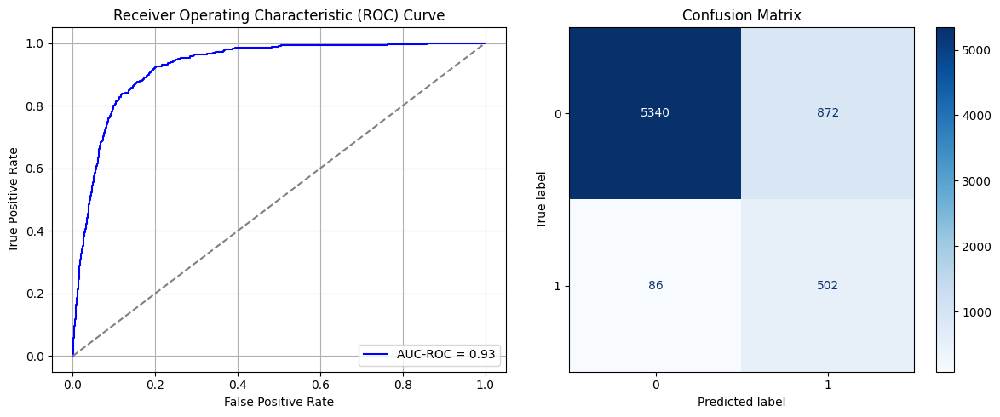

Best threshold based on F1-score: 0.7432240843772888
False Negative Rate: 0.14625850340136054
Time elapsed (performance): 1.0624903669995547
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1278/1278 ━━━━━━━━━━━━━━━━━━━━ 8s 5ms/step - AUC: 0.7938 - loss: 0.5487 - val_AUC: 0.8903 - val_loss: 0.4317
Epoch 2/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - AUC: 0.8873 - loss: 0.4231 - val_AUC: 0.9008 - val_loss: 0.3960
Epoch 3/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8972 - loss: 0.4015 - val_AUC: 0.9064 - val_loss: 0.3821
Epoch 4/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 10s 4ms/step - AUC: 0.9042 - loss: 0.3865 - val_AUC: 0.9094 - val_loss: 0.3806
Epoch 5/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 10s 4ms/step - AUC: 0.9072 - loss: 0.3792 - val_AUC: 0.9145 - val_loss: 0.3620
Epoch 6/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.9097 - loss: 0.3726 - val_AUC: 0.9155 - val_loss: 0.3604
Epoch 7/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - AUC: 0.9124 - loss: 0.3655 - val_AUC: 0.9174 - val_loss: 0.3626
Epoch 8/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.9173 - loss: 0.3554 - val_AUC: 0.9158 - val_loss: 0.3587
Epoch 9/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/

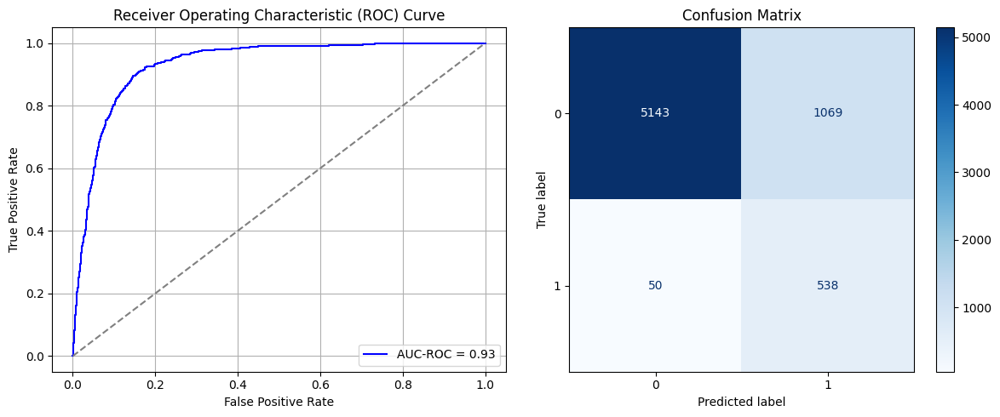

Best threshold based on F1-score: 0.7945399284362793
False Negative Rate: 0.08503401360544217
Time elapsed (performance): 1.0757685340031458
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1278/1278 ━━━━━━━━━━━━━━━━━━━━ 8s 5ms/step - AUC: 0.7900 - loss: 0.5526 - val_AUC: 0.8876 - val_loss: 0.4293
Epoch 2/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8799 - loss: 0.4375 - val_AUC: 0.8935 - val_loss: 0.4129
Epoch 3/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8892 - loss: 0.4182 - val_AUC: 0.8983 - val_loss: 0.4018
Epoch 4/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8950 - loss: 0.4070 - val_AUC: 0.9037 - val_loss: 0.3914
Epoch 5/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8987 - loss: 0.3983 - val_AUC: 0.9072 - val_loss: 0.3849
Epoch 6/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.9043 - loss: 0.3873 - val_AUC: 0.9082 - val_loss: 0.3778
Epoch 7/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - AUC: 0.9090 - loss: 0.3765 - val_AUC: 0.9133 - val_loss: 0.3662
Epoch 8/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.9101 - loss: 0.3750 - val_AUC: 0.9151 - val_loss: 0.3675
Epoch 9/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/st

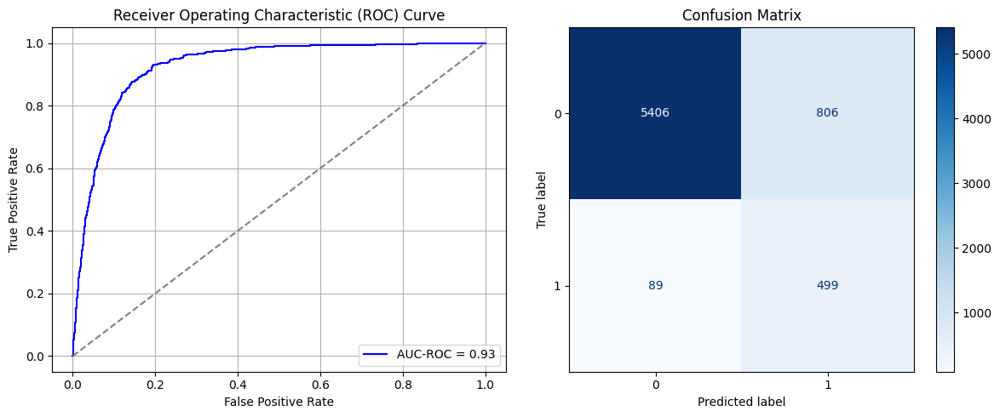

Best threshold based on F1-score: 0.6112444400787354
False Negative Rate: 0.15136054421768708
Time elapsed (performance): 0.9747273329994641
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1278/1278 ━━━━━━━━━━━━━━━━━━━━ 8s 5ms/step - AUC: 0.7933 - loss: 0.5486 - val_AUC: 0.8869 - val_loss: 0.4238
Epoch 2/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 8s 4ms/step - AUC: 0.8873 - loss: 0.4228 - val_AUC: 0.8964 - val_loss: 0.4065
Epoch 3/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8942 - loss: 0.4065 - val_AUC: 0.9014 - val_loss: 0.3924
Epoch 4/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 10s 4ms/step - AUC: 0.9005 - loss: 0.3928 - val_AUC: 0.9068 - val_loss: 0.3948
Epoch 5/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.9023 - loss: 0.3866 - val_AUC: 0.9103 - val_loss: 0.3916
Epoch 6/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - AUC: 0.9084 - loss: 0.3760 - val_AUC: 0.9112 - val_loss: 0.3772
Epoch 7/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 10s 4ms/step - AUC: 0.9111 - loss: 0.3694 - val_AUC: 0.9136 - val_loss: 0.3636
Epoch 8/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.9107 - loss: 0.3688 - val_AUC: 0.9142 - val_loss: 0.3637
Epoch 9/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/

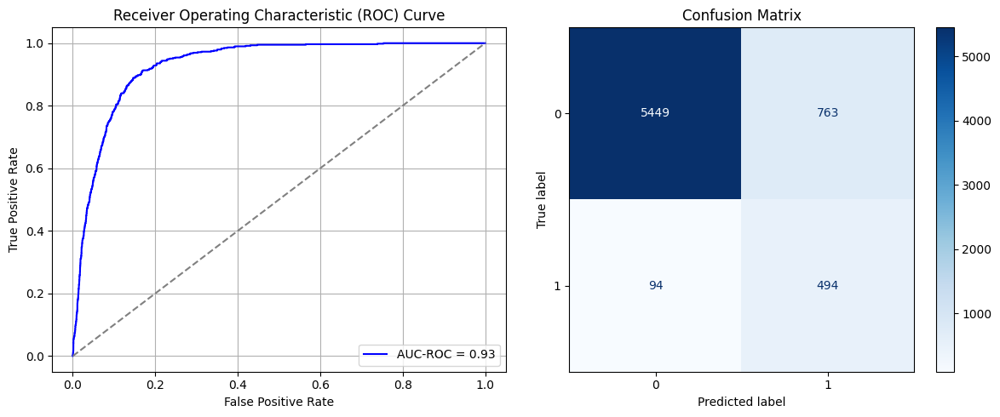

Best threshold based on F1-score: 0.9850767850875854
False Negative Rate: 0.1598639455782313
Time elapsed (performance): 0.942967980998219
Epoch 1/10


<ipython-input-77-64b595990d04>:54: RuntimeWarning: invalid value encountered in divide
  f1_scores = 2 * (precision * recall) / (precision + recall)
/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1278/1278 ━━━━━━━━━━━━━━━━━━━━ 8s 5ms/step - AUC: 0.7952 - loss: 0.5491 - val_AUC: 0.8874 - val_loss: 0.4279
Epoch 2/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 10s 4ms/step - AUC: 0.8833 - loss: 0.4304 - val_AUC: 0.8951 - val_loss: 0.4119
Epoch 3/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 10s 5ms/step - AUC: 0.8922 - loss: 0.4135 - val_AUC: 0.9008 - val_loss: 0.4063
Epoch 4/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 10s 4ms/step - AUC: 0.8963 - loss: 0.4032 - val_AUC: 0.9071 - val_loss: 0.3815
Epoch 5/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 10s 4ms/step - AUC: 0.9028 - loss: 0.3900 - val_AUC: 0.9105 - val_loss: 0.3773
Epoch 6/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 10s 5ms/step - AUC: 0.9095 - loss: 0.3747 - val_AUC: 0.9138 - val_loss: 0.3743
Epoch 7/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - AUC: 0.9111 - loss: 0.3726 - val_AUC: 0.9168 - val_loss: 0.3606
Epoch 8/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.9140 - loss: 0.3657 - val_AUC: 0.9183 - val_loss: 0.3561
Epoch 9/10
1278/1278 ━━━━━━━━━━━━━━━━━━━━ 9s 4

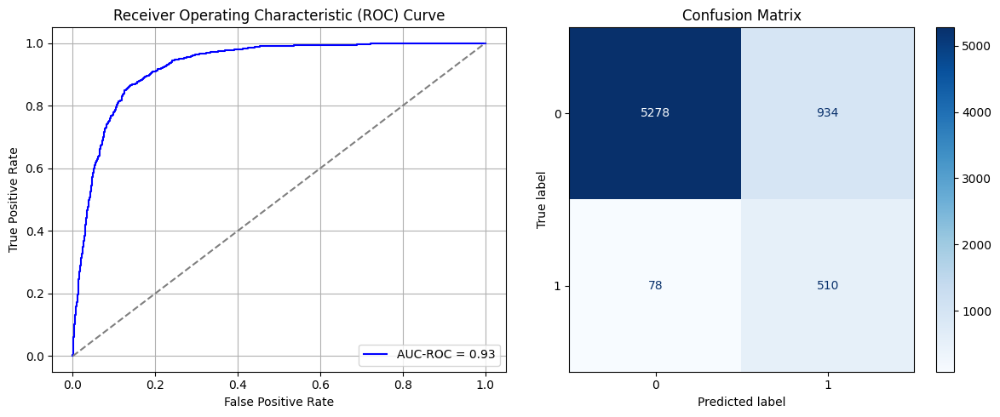

Best threshold based on F1-score: 0.7393606305122375
False Negative Rate: 0.1326530612244898
Time elapsed (performance): 1.076871552002558


In [106]:
times = 50

Training_time = []
FPR = []
TPR = []
FNR = []
TNR = []
TL_time = []

k = 10
Nsamples = k*(oversample_size-undersample_size)/undersample_size



for i in range(times):
    start = np.random.choice(int(k), int(Nsamples), replace=True)
    Row = []
    for j in range(len(start)):
      for i in range(int(undersample_size/k)):
        row = start[j]+int(k*i)-1
        Row.append(row)
    data_S_min_ros = pd.DataFrame()
    data_S_min_ros = data_S_minority.iloc[Row]
    data_S_Sy_ROS = pd.concat([data_S_majority, data_S_min_ros, data_S_minority])
    X_S_Sy_ROS = data_S_Sy_ROS.iloc[:, :-1]
    y_S_Sy_ROS = data_S_Sy_ROS.iloc[:, -1]
    X_S_train, X_S_test, y_S_train, y_S_test = train_test_split(X_S_Sy_ROS, y_S_Sy_ROS, test_size=0.20, random_state=0)
    model_Sy_ROS = create_dnn_model(X_S_train.shape[1])
    result_Sy_ROS = train_and_evaluate(model_Sy_ROS, X_S_train, X_S_test, y_S_train, y_S_test, "Source")
    result_TL_Sy_ROS = Transductive_TL(model_Sy_ROS, X_T_full, y_T_full, "Target")

    Training_time.append(result_Sy_ROS)
    FPR.append(result_TL_Sy_ROS[0])
    TNR.append(result_TL_Sy_ROS[1])
    FNR.append(result_TL_Sy_ROS[2])
    TPR.append(result_TL_Sy_ROS[3])
    TL_time.append(result_TL_Sy_ROS[4])

ParamFit = pd.DataFrame([Training_time, FPR, TNR, FNR, TPR, TL_time]).T
ParamFit.columns=['Source time', 'FPR', 'TNR', 'FNR', 'TPR', 'Target time']
# print(ParamFit)

In [107]:
print(ParamFit)
ParamFit.to_csv('Sy_ROS2.csv')

    Source time       FPR       TNR       FNR       TPR  Target time
0     50.025062  0.192531  0.807469  0.091837  0.908163     0.784797
1     50.876569  0.169672  0.830328  0.095238  0.904762     2.514232
2     55.105255  0.124115  0.875885  0.164966  0.835034     0.802183
3     48.945116  0.159208  0.840792  0.122449  0.877551     0.802815
4     44.156225  0.154057  0.845943  0.132653  0.867347     1.077493
5     47.169476  0.166613  0.833387  0.090136  0.909864     0.799817
6     50.905640  0.149549  0.850451  0.096939  0.903061     0.806244
7     58.505166  0.133451  0.866549  0.149660  0.850340     0.798201
8     46.168284  0.138925  0.861075  0.125850  0.874150     1.259662
9     47.922635  0.115100  0.884900  0.139456  0.860544     1.227315
10    49.470060  0.132968  0.867032  0.170068  0.829932     1.055023
11    45.316720  0.132164  0.867836  0.139456  0.860544     1.061331
12    49.937392  0.189150  0.810850  0.090136  0.909864     0.845603
13    53.732784  0.171925  0.82807